<a href="https://colab.research.google.com/github/jdmurilloa/TFM-Master-Big-Data-y-Data-Science/blob/main/TFM_Juan_Diego_Murillo_Arnez_VFDMA_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <center>TRABAJO DE FIN DE MASTER<center>
# <center>Predicción de Energía Fotovoltaica utilizando técnicas de Inteligencia Artificial<center>

**Nombre y apellidos:** Juan Diego Murillo Arnez

**Usuario VIU:**juan.murilloarnez

---
# 0. Resumen
---

El presente trabajo de grado se ha realizado con el objetivo de predecir la generación de energía fotovoltaica, utilizando técnicas de inteligencia artificial, basándose en los datos históricos de generación y meteorológicos, proporcionados por el laboratorio fotovoltaico Sunlab, perteneciente al Grupo EDP en Portugal.
En el trabajo se explica de manera detallada la descripción de las características, la selección, el preprocesado y la transformación de los datos de generación de energía fotovoltaica, realizado antes de utilizar las diferentes técnicas de inteligencia artificial. Posteriormente se expone el desarrollo de los diferentes algoritmos de aprendizaje automático (machine learning) y los modelos de redes neuronales del aprendizaje profundo (Deep Learning), utilizados para realizar la predicción.
Primeramente, para realizar una comparación de los métodos utilizados en la estadística tradicional y las técnicas de inteligencia artificial, se realizó la predicción de la generación de energía fotovoltaica a través del método estadístico de Regresión Lineal Multivariable.
En lo que respecta a las técnicas de inteligencia artificial, los algoritmos de aprendizaje automático utilizados, fueron Random Forest, Decision Tree y XGBoost. En cuanto a los modelos de aprendizaje profundo empleados, se basaron principalmente en redes neuronales recurrentes (RNN) y arquitecturas híbridas con redes neuronales convolucionales (CNN), utilizando LSTM (Long Short-Term Memory), GRU (Gated Recurrent Unit), CNN (Convolutional Neural Network) y Transformer, en diferentes estructuras.
La comparación de los diferentes modelos de predicción, se realizó mediante las métricas utilizadas para medir el rendimiento en modelos de regresión y pronóstico, tomando como medidas principales, el Coeficiente de determinación (R2) y Error Absoluto Medio (MAE), los cuales contribuyeron a identificar el modelo de predicción con la mayor precisión, superando a los métodos estadísticos tradicionales.

---



---
# 1. Preparación de los datos
---

En esta primera etapa, se cargarán los diferentes dataset proporcionados por el laboratorio Sunlab a Google Colab y aplicando la librería de pandas se realizará la conversión a dataframes.

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
import os

In [ ]:
dfmeteo_2014 = pd.read_excel('Sunlab-Faro-Meteo-2014.xlsx')
dfmeteo_2015 = pd.read_excel('Sunlab-Faro-Meteo-2015.xlsx')
dfmeteo_2016 = pd.read_excel('Sunlab-Faro-Meteo-2016.xlsx')
dfmeteo_2017 = pd.read_excel('Sunlab-Faro-Meteo-2017.xlsx')
dfPV_2014 = pd.read_excel('Sunlab-Faro-PV-2014.xlsx')
dfPV_2015 = pd.read_excel('Sunlab-Faro-PV-2015.xlsx')
dfPV_2016 = pd.read_excel('Sunlab-Faro-PV-2016.xlsx')
dfPV_2017 = pd.read_excel('Sunlab-Faro-PV-2017.xlsx')

Inicialmente para ver el tamaño del dataset, se concatena la totalidad de los datos

In [ ]:
dfMeteotot = pd.concat ([dfmeteo_2014, dfmeteo_2015, dfmeteo_2016, dfmeteo_2017], ignore_index=True)
dfPVtot = pd.concat ([dfPV_2014, dfPV_2015, dfPV_2016, dfPV_2017], ignore_index=True)

In [ ]:
dfPVtot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 889611 entries, 0 to 889610
Data columns (total 25 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   Datetime                          889611 non-null  object 
 1   A_Vertical - Voltage DC [V]       864055 non-null  float64
 2   A_Vertical - Current DC [A]       864055 non-null  float64
 3   A_Vertical - Power DC [W]         864055 non-null  float64
 4   A_Optimal - Voltage DC [V]        875353 non-null  float64
 5   A_Optimal - Current DC [A]        875353 non-null  float64
 6   A_Optimal - Power DC [W]          875353 non-null  float64
 7   A_Horizontal - Voltage DC [V]     873826 non-null  float64
 8   A_Horizontal - Current DC [A]     873826 non-null  float64
 9   A_Horizontal - Power DC [W]       873826 non-null  float64
 10  A_Vertical - Temperature [ÂºC]    889611 non-null  float64
 11  A_Optimal - Temperature [ÂºC]     889611 non-null  f

In [ ]:
dfMeteotot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1886656 entries, 0 to 1886655
Data columns (total 10 columns):
 #   Column                      Dtype  
---  ------                      -----  
 0   Datetime                    object 
 1   Ambient Temperature [ÂºC]   float64
 2   Global Radiation [W/m2]     float64
 3   Diffuse Radiation [W/m2]    float64
 4   Ultraviolet [W/m2]          float64
 5   Wind Velocity [m/s]         float64
 6   Wind Direction [Âº]         float64
 7   Precipitation [mm]          float64
 8   Atmospheric pressure [hPa]  float64
 9   Direct Radiation [W/m2]     float64
dtypes: float64(9), object(1)
memory usage: 143.9+ MB


Para fines prácticos y trabajos posteriores se concatena sin el año 2017

In [ ]:
dfMeteo = pd.concat ([dfmeteo_2014, dfmeteo_2015, dfmeteo_2016], ignore_index=True)
dfPV = pd.concat ([dfPV_2014, dfPV_2015, dfPV_2016], ignore_index=True)

A continucación, se realizará una exploración de los datos

In [ ]:
dfmeteo_2017.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 524890 entries, 0 to 524889
Data columns (total 9 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Datetime                    524890 non-null  object 
 1   Ambient Temperature [ÂºC]   524890 non-null  float64
 2   Global Radiation [W/m2]     524890 non-null  float64
 3   Diffuse Radiation [W/m2]    524890 non-null  float64
 4   Ultraviolet [W/m2]          524890 non-null  float64
 5   Wind Velocity [m/s]         524890 non-null  float64
 6   Wind Direction [Âº]         524890 non-null  float64
 7   Precipitation [mm]          524890 non-null  float64
 8   Atmospheric pressure [hPa]  524890 non-null  float64
dtypes: float64(8), object(1)
memory usage: 36.0+ MB


In [ ]:
dfPV_2017.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 206959 entries, 0 to 206958
Data columns (total 25 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   Datetime                          206959 non-null  object 
 1   A_Vertical - Voltage DC [V]       200693 non-null  float64
 2   A_Vertical - Current DC [A]       200693 non-null  float64
 3   A_Vertical - Power DC [W]         200693 non-null  float64
 4   A_Optimal - Voltage DC [V]        202862 non-null  float64
 5   A_Optimal - Current DC [A]        202862 non-null  float64
 6   A_Optimal - Power DC [W]          202862 non-null  float64
 7   A_Horizontal - Voltage DC [V]     202601 non-null  float64
 8   A_Horizontal - Current DC [A]     202601 non-null  float64
 9   A_Horizontal - Power DC [W]       202601 non-null  float64
 10  A_Vertical - Temperature [ÂºC]    206959 non-null  float64
 11  A_Optimal - Temperature [ÂºC]     206959 non-null  f

In [ ]:
dfMeteo.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1361766 entries, 0 to 1361765
Data columns (total 10 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   Datetime                    1361766 non-null  object 
 1   Ambient Temperature [ÂºC]   1361766 non-null  float64
 2   Global Radiation [W/m2]     1361766 non-null  float64
 3   Diffuse Radiation [W/m2]    962022 non-null   float64
 4   Ultraviolet [W/m2]          1361766 non-null  float64
 5   Wind Velocity [m/s]         1361766 non-null  float64
 6   Wind Direction [Âº]         1361766 non-null  float64
 7   Precipitation [mm]          60743 non-null    float64
 8   Atmospheric pressure [hPa]  60743 non-null    float64
 9   Direct Radiation [W/m2]     399744 non-null   float64
dtypes: float64(9), object(1)
memory usage: 103.9+ MB


In [ ]:
dfPV.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 682652 entries, 0 to 682651
Data columns (total 25 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   Datetime                          682652 non-null  object 
 1   A_Vertical - Voltage DC [V]       663362 non-null  float64
 2   A_Vertical - Current DC [A]       663362 non-null  float64
 3   A_Vertical - Power DC [W]         663362 non-null  float64
 4   A_Optimal - Voltage DC [V]        672491 non-null  float64
 5   A_Optimal - Current DC [A]        672491 non-null  float64
 6   A_Optimal - Power DC [W]          672491 non-null  float64
 7   A_Horizontal - Voltage DC [V]     671225 non-null  float64
 8   A_Horizontal - Current DC [A]     671225 non-null  float64
 9   A_Horizontal - Power DC [W]       671225 non-null  float64
 10  A_Vertical - Temperature [ÂºC]    682652 non-null  float64
 11  A_Optimal - Temperature [ÂºC]     682652 non-null  f

In [ ]:
dfMeteo

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],Precipitation [mm],Atmospheric pressure [hPa],Direct Radiation [W/m2]
0,2014-01-10T23:38:00+00:00,21.600000,1.540657,1.697001,0.508240,0.450000,64.881104,NaN,NaN,NaN
1,2014-09-30T13:36:00+00:00,25.766664,389.889200,354.913600,28.350150,4.516667,138.169560,NaN,NaN,NaN
2,2014-09-30T13:49:00+00:00,25.716668,365.723600,327.017340,27.791006,3.050000,136.986820,NaN,NaN,NaN
3,2014-09-30T13:53:00+00:00,26.050002,400.164960,325.706580,29.505240,2.116667,127.982940,NaN,NaN,NaN
4,2014-09-30T13:54:00+00:00,26.150000,420.375160,329.520240,30.324196,2.550000,134.672980,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
1361761,2016-09-05T01:53:00+00:00,24.800002,1.262502,NaN,0.514818,1.100000,356.825840,NaN,NaN,1.724827
1361762,2016-09-05T01:57:00+00:00,24.900000,1.303514,NaN,0.511915,0.583333,320.330320,NaN,NaN,1.723435
1361763,2016-09-05T02:03:00+00:00,24.900000,1.272775,NaN,0.510205,0.633333,288.164520,NaN,NaN,1.720427
1361764,2016-09-05T02:07:00+00:00,24.900000,1.128395,NaN,0.509499,0.733333,315.166540,NaN,NaN,1.715595


In [ ]:
dfPV

,Datetime,A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],A_Optimal - Voltage DC [V],A_Optimal - Current DC [A],A_Optimal - Power DC [W],A_Horizontal - Voltage DC [V],A_Horizontal - Current DC [A],A_Horizontal - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2014-11-15T13:21:00+00:00,28.70,6.0100,172.487000,27.85,7.0300,195.785500,29.00,4.4125,127.962500,...,178.211625,27.50,7.0425,193.668750,28.45,4.3750,124.468750,36.4,36.4,29.5
1,2014-11-15T13:23:00+00:00,28.40,6.0375,171.465000,27.85,7.0200,195.507000,29.00,4.3925,127.382500,...,179.733000,27.30,7.0725,193.079250,28.35,4.3675,123.818625,36.7,36.9,29.6
2,2014-11-15T13:26:00+00:00,28.70,5.9975,172.128250,28.05,6.9925,196.139625,28.85,4.4025,127.012125,...,179.918125,27.60,7.0150,193.614000,28.35,4.3575,123.535125,35.3,36.0,28.7
3,2014-11-15T13:29:00+00:00,28.80,5.9300,170.784000,28.15,6.9300,195.079500,29.15,4.3175,125.855125,...,178.730625,27.60,6.9525,191.889000,28.45,4.2975,122.263875,34.5,35.0,28.1
4,2014-11-15T13:32:00+00:00,28.80,5.8050,167.184000,28.95,6.5525,189.694875,29.15,4.2200,123.013000,...,174.942500,27.75,6.7650,187.728750,28.35,4.2125,119.424375,34.3,34.7,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
682647,2016-12-17T12:33:00+00:00,29.45,6.5075,191.645875,28.95,7.1450,206.847750,29.85,4.1475,123.802875,...,199.604000,28.25,7.1475,201.916875,29.05,4.0575,117.870375,29.7,28.6,23.8
682648,2016-12-17T12:52:00+00:00,29.15,6.5175,189.985125,28.65,7.1825,205.778625,28.75,4.3225,124.271875,...,198.170500,28.05,7.1550,200.697750,28.75,4.1225,118.521875,32.6,30.7,24.8
682649,2016-10-01T16:03:00+00:00,28.00,1.4575,40.810000,28.20,2.2175,62.533500,27.90,2.0825,58.101750,...,40.409625,27.60,2.2025,60.789000,27.80,2.0300,56.434000,38.5,40.7,36.6
682650,2016-10-01T16:10:00+00:00,27.10,1.4275,38.685250,28.50,2.0200,57.570000,27.55,1.8750,51.656250,...,38.745000,27.60,2.0100,55.476000,27.30,1.8325,50.027250,36.8,38.3,34.6


A continuación, se transformara la variable "Datetime" que inicialmente es de tipo Object a tipo datetime en formato UTC, para facilitar la combinacion de los dataframe

In [ ]:
dfMeteo['Datetime']=pd.to_datetime(dfMeteo['Datetime'],utc='True')
dfPV['Datetime']=pd.to_datetime(dfPV['Datetime'])
dfmeteo_2017['Datetime']=pd.to_datetime(dfmeteo_2017['Datetime'],utc='True')
dfPV_2017['Datetime']=pd.to_datetime(dfPV_2017['Datetime'])
print(dfMeteo['Datetime'].dtype)
print(dfPV['Datetime'].dtype)
print(dfmeteo_2017['Datetime'].dtype)
print(dfPV_2017['Datetime'].dtype)

datetime64[ns, UTC]
datetime64[ns, UTC]
datetime64[ns, UTC]
datetime64[ns, UTC]


Con la finalidad de contar con un solo dataframe con los datos meteorológicos y de generación, se combinarán ambos dataframes en función de la columna Datetime, que se tiene en común, tomándose únicamente las filas con valores coincidentes en ambas tablas.

In [ ]:
df_Test_Generacion2017 = pd.merge(dfmeteo_2017,dfPV_2017,on='Datetime',how='inner')
df_Test_Generacion2017

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],Precipitation [mm],Atmospheric pressure [hPa],A_Vertical - Voltage DC [V],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2017-02-22 07:18:00+00:00,10.600000,8.418510,8.234067,1.011680,1.733333,331.49664,0.0,1013.8666,NaN,...,NaN,14.75,0.0700,1.032500,NaN,NaN,NaN,11.5,10.3,9.6
1,2017-02-22 07:27:00+00:00,10.500000,17.795586,17.300662,1.491880,2.216667,318.66364,0.0,1013.8834,19.10,...,1.927000,14.75,0.1425,2.101875,15.00,0.1300,1.950000,11.5,10.5,9.7
2,2017-02-22 07:29:00+00:00,10.500000,19.952904,18.903226,1.614739,2.183334,322.66678,0.0,1013.9000,18.90,...,2.220750,14.95,0.1625,2.429375,14.95,0.1500,2.242500,11.6,10.5,9.8
3,2017-02-22 07:39:00+00:00,10.400002,31.102372,28.188776,2.327395,2.016667,315.83350,0.0,1013.9000,19.00,...,3.915500,14.95,0.2725,4.073875,15.00,0.2350,3.525000,11.9,10.7,10.0
4,2017-02-22 07:47:00+00:00,10.400002,40.725744,36.325428,2.992586,2.100000,301.65310,0.0,1014.0000,18.80,...,5.286375,14.50,0.3675,5.328750,14.80,0.3100,4.588000,12.3,11.0,10.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206952,2017-06-21 17:44:00+00:00,24.100000,144.080360,50.034856,8.450380,3.916667,250.72408,0.0,1012.9500,26.85,...,15.235875,27.30,1.1625,31.736250,27.75,2.2625,62.784375,33.0,33.3,34.3
206953,2017-06-21 18:25:00+00:00,23.699998,39.552868,27.144328,3.084209,3.016667,273.16302,0.0,1013.0500,26.80,...,10.179000,27.20,0.4125,11.220000,29.15,1.1200,32.648000,30.4,30.6,32.6
206954,2017-06-21 18:28:00+00:00,23.600000,34.982212,26.213500,2.798427,3.500000,264.50256,0.0,1013.0168,26.85,...,9.865375,27.15,0.3825,10.384875,27.35,1.1450,31.315750,30.4,30.5,32.4
206955,2017-06-21 18:30:00+00:00,23.600000,30.661392,24.742172,2.609985,2.766667,277.89734,0.0,1013.0834,26.85,...,9.611250,27.20,0.3650,9.928000,27.20,1.0950,29.784000,30.4,30.6,32.4


In [ ]:
df_Generacion_fil = pd.merge(dfMeteo,dfPV,on='Datetime',how='inner')
df_Generacion_fil

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],Precipitation [mm],Atmospheric pressure [hPa],Direct Radiation [W/m2],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2014-09-30 13:36:00+00:00,25.766664,389.889200,354.91360,28.350150,4.516667,138.16956,NaN,NaN,NaN,...,53.341875,27.85,3.0250,84.246250,27.95,2.9150,81.47425,34.6,34.7,33.1
1,2014-09-30 13:49:00+00:00,25.716668,365.723600,327.01734,27.791006,3.050000,136.98682,NaN,NaN,NaN,...,60.835625,27.80,3.3650,93.547000,27.90,3.1050,86.62950,34.6,35.3,34.9
2,2014-09-30 13:53:00+00:00,26.050002,400.164960,325.70658,29.505240,2.116667,127.98294,NaN,NaN,NaN,...,61.229875,28.10,3.3225,93.362250,28.00,3.0700,85.96000,34.9,35.4,34.8
3,2014-09-30 13:54:00+00:00,26.150000,420.375160,329.52024,30.324196,2.550000,134.67298,NaN,NaN,NaN,...,81.892375,28.10,4.3350,121.813500,27.95,3.8750,108.30625,34.9,35.5,34.9
4,2014-09-30 13:58:00+00:00,26.300002,469.160760,324.93082,32.575062,3.300000,114.97556,NaN,NaN,NaN,...,89.516875,26.95,4.8750,131.381250,28.00,4.1475,116.13000,34.8,35.4,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
626716,2016-09-04 18:23:00+00:00,31.183334,50.420680,NaN,3.315419,1.983333,275.49900,NaN,NaN,41.461972,...,3.643750,23.80,0.2175,5.176500,26.60,0.2100,5.58600,38.7,39.4,38.4
626717,2016-09-04 18:24:00+00:00,31.100000,48.567244,NaN,3.211449,1.466667,294.55596,NaN,NaN,40.525020,...,3.498000,26.05,0.1800,4.689000,26.55,0.1950,5.17725,38.6,39.2,38.3
626718,2016-09-04 18:26:00+00:00,31.050002,43.214872,NaN,3.015724,1.850000,291.38412,NaN,NaN,37.568724,...,2.909500,25.60,0.1625,4.160000,26.50,0.1700,4.50500,38.2,38.7,37.7
626719,2016-09-04 18:32:00+00:00,30.783332,29.976686,NaN,2.453131,1.916667,282.66284,NaN,NaN,28.256678,...,2.409750,28.35,0.0325,0.921375,22.30,0.1450,3.23350,37.8,37.9,37.0


In [ ]:
df_Generacion_fil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 626721 entries, 0 to 626720
Data columns (total 34 columns):
 #   Column                            Non-Null Count   Dtype              
---  ------                            --------------   -----              
 0   Datetime                          626721 non-null  datetime64[ns, UTC]
 1   Ambient Temperature [ÂºC]         626721 non-null  float64            
 2   Global Radiation [W/m2]           626721 non-null  float64            
 3   Diffuse Radiation [W/m2]          487641 non-null  float64            
 4   Ultraviolet [W/m2]                626721 non-null  float64            
 5   Wind Velocity [m/s]               626721 non-null  float64            
 6   Wind Direction [Âº]               626721 non-null  float64            
 7   Precipitation [mm]                24027 non-null   float64            
 8   Atmospheric pressure [hPa]        24027 non-null   float64            
 9   Direct Radiation [W/m2]           139080 non-nul

In [ ]:
df_Test_Generacion2017.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 206957 entries, 0 to 206956
Data columns (total 33 columns):
 #   Column                            Non-Null Count   Dtype              
---  ------                            --------------   -----              
 0   Datetime                          206957 non-null  datetime64[ns, UTC]
 1   Ambient Temperature [ÂºC]         206957 non-null  float64            
 2   Global Radiation [W/m2]           206957 non-null  float64            
 3   Diffuse Radiation [W/m2]          206957 non-null  float64            
 4   Ultraviolet [W/m2]                206957 non-null  float64            
 5   Wind Velocity [m/s]               206957 non-null  float64            
 6   Wind Direction [Âº]               206957 non-null  float64            
 7   Precipitation [mm]                206957 non-null  float64            
 8   Atmospheric pressure [hPa]        206957 non-null  float64            
 9   A_Vertical - Voltage DC [V]       200691 non-nul

---
# 2. Limpieza de los datos
---

**2.1. Tratamiento con los tipos de los datos**

El anterior apartado, se ha adelantado el tratamiento con los tipos de los datos, realizando la conversión del atributo Datetime de tipo Object, a tipo datetime en formato UTC, para fines de manipular las fechas de manera eficiente y acceder a diversas funciones de procesamiento temporal

**2.2. Tratamiento de missing values**

A continuación, se verificará la cantidad de valores nulos que se tienen en los dataframe

In [ ]:
nulos_test = df_Test_Generacion2017.isnull().sum()
nulos_test

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
Precipitation [mm],0
Atmospheric pressure [hPa],0
A_Vertical - Voltage DC [V],6266


In [ ]:
porcentaje_nulos_test=(nulos_test/len(df_Test_Generacion2017))*100
porcentaje_nulos_test

,0
Datetime,0.000000
Ambient Temperature [ÂºC],0.000000
Global Radiation [W/m2],0.000000
Diffuse Radiation [W/m2],0.000000
Ultraviolet [W/m2],0.000000
Wind Velocity [m/s],0.000000
Wind Direction [Âº],0.000000
Precipitation [mm],0.000000
Atmospheric pressure [hPa],0.000000
A_Vertical - Voltage DC [V],3.027682


En el caso del dataframe correspondiente al año 2017, dado que será considerado el conjunto de prueba, se eliminaron los valores nulos

In [ ]:
df_Test_Generacion_2017 = df_Test_Generacion2017.dropna()

In [ ]:
nulos_test=df_Test_Generacion_2017.isnull().sum()
nulos_test

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
Precipitation [mm],0
Atmospheric pressure [hPa],0
A_Vertical - Voltage DC [V],0


In [ ]:
nulos = df_Generacion_fil.isnull().sum()
nulos

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],139080
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
Precipitation [mm],602694
Atmospheric pressure [hPa],602694
Direct Radiation [W/m2],487641


In [ ]:
porcentaje_nulos=(nulos/len(df_Generacion_fil))*100
porcentaje_nulos

,0
Datetime,0.000000
Ambient Temperature [ÂºC],0.000000
Global Radiation [W/m2],0.000000
Diffuse Radiation [W/m2],22.191693
Ultraviolet [W/m2],0.000000
Wind Velocity [m/s],0.000000
Wind Direction [Âº],0.000000
Precipitation [mm],96.166237
Atmospheric pressure [hPa],96.166237
Direct Radiation [W/m2],77.808307


In [ ]:
df_Generacion_fil.describe()

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],Precipitation [mm],Atmospheric pressure [hPa],Direct Radiation [W/m2],A_Vertical - Voltage DC [V],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
count,6.267210e+05,626721.000000,487641.000000,626721.000000,6.267210e+05,626721.000000,24027.000000,24027.000000,139080.000000,609670.000000,...,613398.000000,618630.000000,618630.000000,618630.000000,612375.000000,612375.000000,612375.000000,626721.000000,626721.000000,626721.000000
mean,-4.765977e+03,446.794959,125.244335,27.151790,-4.784229e+03,200.007531,0.002445,1019.655830,113.191415,26.304098,...,60.303685,26.353959,3.591688,98.122851,26.335028,3.181195,87.292466,28.904614,30.258394,28.453167
std,2.679593e+06,318.479703,102.929171,19.520783,2.679593e+06,86.815406,0.037917,7.216342,88.088238,4.347489,...,53.897943,3.540114,2.640801,72.371805,3.810535,2.296646,63.532319,7.605771,9.793423,9.325015
min,-1.500000e+09,0.876493,1.591053,0.500673,-1.500000e+09,0.000000,0.000000,999.066640,1.745721,10.600000,...,0.000000,10.200000,0.000000,0.000000,10.800000,0.000000,0.000000,3.200000,2.300000,1.600000
25%,1.650000e+01,151.669360,58.512496,9.658726,1.616667e+00,125.612700,0.000000,1013.900000,55.716913,26.600000,...,14.335125,26.700000,1.025000,25.527562,26.750000,1.085000,26.180000,23.100000,22.200000,21.000000
50%,2.090000e+01,417.973280,96.724368,24.098876,2.500000e+00,219.964260,0.000000,1020.200000,88.920716,27.950000,...,45.567000,27.350000,3.307500,93.325625,27.400000,2.880000,82.131500,29.700000,30.300000,28.200000
75%,2.500000e+01,719.298880,157.623260,43.140804,3.433333e+00,268.339560,0.000000,1025.283400,145.242055,29.200000,...,92.713094,28.050000,6.170000,168.597000,28.350000,5.137500,143.378500,34.800000,38.200000,36.000000
max,3.830000e+01,1438.887200,776.552080,84.266016,1.228333e+01,359.999160,2.040000,1033.800000,714.390160,36.800000,...,255.985500,36.550000,10.237500,303.030000,36.000000,10.237500,300.982500,55.100000,62.000000,105.800000


In [ ]:
max=len(df_Generacion_fil)

for i in range (0, max):
  if not np.isnan(df_Generacion_fil.loc[i,'Direct Radiation [W/m2]']):
    df_Generacion_fil.loc[i,'Diffuse Radiation [W/m2]'] = df_Generacion_fil.loc[i,'Global Radiation [W/m2]'] - df_Generacion_fil.loc[i,'Direct Radiation [W/m2]']
df_Generacion_fil


,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],Precipitation [mm],Atmospheric pressure [hPa],Direct Radiation [W/m2],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2014-09-30 13:36:00+00:00,25.766664,389.889200,354.913600,28.350150,4.516667,138.16956,NaN,NaN,NaN,...,53.341875,27.85,3.0250,84.246250,27.95,2.9150,81.47425,34.6,34.7,33.1
1,2014-09-30 13:49:00+00:00,25.716668,365.723600,327.017340,27.791006,3.050000,136.98682,NaN,NaN,NaN,...,60.835625,27.80,3.3650,93.547000,27.90,3.1050,86.62950,34.6,35.3,34.9
2,2014-09-30 13:53:00+00:00,26.050002,400.164960,325.706580,29.505240,2.116667,127.98294,NaN,NaN,NaN,...,61.229875,28.10,3.3225,93.362250,28.00,3.0700,85.96000,34.9,35.4,34.8
3,2014-09-30 13:54:00+00:00,26.150000,420.375160,329.520240,30.324196,2.550000,134.67298,NaN,NaN,NaN,...,81.892375,28.10,4.3350,121.813500,27.95,3.8750,108.30625,34.9,35.5,34.9
4,2014-09-30 13:58:00+00:00,26.300002,469.160760,324.930820,32.575062,3.300000,114.97556,NaN,NaN,NaN,...,89.516875,26.95,4.8750,131.381250,28.00,4.1475,116.13000,34.8,35.4,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
626716,2016-09-04 18:23:00+00:00,31.183334,50.420680,8.958708,3.315419,1.983333,275.49900,NaN,NaN,41.461972,...,3.643750,23.80,0.2175,5.176500,26.60,0.2100,5.58600,38.7,39.4,38.4
626717,2016-09-04 18:24:00+00:00,31.100000,48.567244,8.042224,3.211449,1.466667,294.55596,NaN,NaN,40.525020,...,3.498000,26.05,0.1800,4.689000,26.55,0.1950,5.17725,38.6,39.2,38.3
626718,2016-09-04 18:26:00+00:00,31.050002,43.214872,5.646148,3.015724,1.850000,291.38412,NaN,NaN,37.568724,...,2.909500,25.60,0.1625,4.160000,26.50,0.1700,4.50500,38.2,38.7,37.7
626719,2016-09-04 18:32:00+00:00,30.783332,29.976686,1.720008,2.453131,1.916667,282.66284,NaN,NaN,28.256678,...,2.409750,28.35,0.0325,0.921375,22.30,0.1450,3.23350,37.8,37.9,37.0


In [ ]:
nulos2 = df_Generacion_fil.isnull().sum()
nulos2

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
Precipitation [mm],602694
Atmospheric pressure [hPa],602694
Direct Radiation [W/m2],487641


En el caso de los valores faltantes de los atributos Direct Radiation [W/m2], Precipitation [mm] y Atmospheric pressure [hPa], al ser un porcentaje elevado de datos faltantes, por encima del 70%, se procede a eliminar los atributos

In [ ]:
df_Generacion_fil=df_Generacion_fil.drop(['Direct Radiation [W/m2]','Precipitation [mm]','Atmospheric pressure [hPa]'], axis=1)
df_Generacion_fil


,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2014-09-30 13:36:00+00:00,25.766664,389.889200,354.913600,28.350150,4.516667,138.16956,27.20,1.8925,51.476000,...,53.341875,27.85,3.0250,84.246250,27.95,2.9150,81.47425,34.6,34.7,33.1
1,2014-09-30 13:49:00+00:00,25.716668,365.723600,327.017340,27.791006,3.050000,136.98682,27.45,2.1450,58.880250,...,60.835625,27.80,3.3650,93.547000,27.90,3.1050,86.62950,34.6,35.3,34.9
2,2014-09-30 13:53:00+00:00,26.050002,400.164960,325.706580,29.505240,2.116667,127.98294,29.10,2.0600,59.946000,...,61.229875,28.10,3.3225,93.362250,28.00,3.0700,85.96000,34.9,35.4,34.8
3,2014-09-30 13:54:00+00:00,26.150000,420.375160,329.520240,30.324196,2.550000,134.67298,29.20,2.7350,79.862000,...,81.892375,28.10,4.3350,121.813500,27.95,3.8750,108.30625,34.9,35.5,34.9
4,2014-09-30 13:58:00+00:00,26.300002,469.160760,324.930820,32.575062,3.300000,114.97556,28.90,3.0000,86.700000,...,89.516875,26.95,4.8750,131.381250,28.00,4.1475,116.13000,34.8,35.4,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
626716,2016-09-04 18:23:00+00:00,31.183334,50.420680,8.958708,3.315419,1.983333,275.49900,26.40,0.1575,4.158000,...,3.643750,23.80,0.2175,5.176500,26.60,0.2100,5.58600,38.7,39.4,38.4
626717,2016-09-04 18:24:00+00:00,31.100000,48.567244,8.042224,3.211449,1.466667,294.55596,26.40,0.1500,3.960000,...,3.498000,26.05,0.1800,4.689000,26.55,0.1950,5.17725,38.6,39.2,38.3
626718,2016-09-04 18:26:00+00:00,31.050002,43.214872,5.646148,3.015724,1.850000,291.38412,26.35,0.1325,3.491375,...,2.909500,25.60,0.1625,4.160000,26.50,0.1700,4.50500,38.2,38.7,37.7
626719,2016-09-04 18:32:00+00:00,30.783332,29.976686,1.720008,2.453131,1.916667,282.66284,23.10,0.1100,2.541000,...,2.409750,28.35,0.0325,0.921375,22.30,0.1450,3.23350,37.8,37.9,37.0


In [ ]:
df_Test_Generacion_2017=df_Test_Generacion_2017.drop(['Precipitation [mm]','Atmospheric pressure [hPa]'], axis=1)
df_Test_Generacion_2017

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
1,2017-02-22 07:27:00+00:00,10.500000,17.795586,17.300662,1.491880,2.216667,318.66364,19.10,0.1075,2.053250,...,1.927000,14.75,0.1425,2.101875,15.00,0.1300,1.950000,11.5,10.5,9.7
2,2017-02-22 07:29:00+00:00,10.500000,19.952904,18.903226,1.614739,2.183334,322.66678,18.90,0.1300,2.457000,...,2.220750,14.95,0.1625,2.429375,14.95,0.1500,2.242500,11.6,10.5,9.8
3,2017-02-22 07:39:00+00:00,10.400002,31.102372,28.188776,2.327395,2.016667,315.83350,19.00,0.2175,4.132500,...,3.915500,14.95,0.2725,4.073875,15.00,0.2350,3.525000,11.9,10.7,10.0
4,2017-02-22 07:47:00+00:00,10.400002,40.725744,36.325428,2.992586,2.100000,301.65310,18.80,0.3000,5.640000,...,5.286375,14.50,0.3675,5.328750,14.80,0.3100,4.588000,12.3,11.0,10.3
5,2017-02-22 07:49:00+00:00,10.400002,43.029392,39.033704,3.169965,1.933333,306.00048,19.00,0.3200,6.080000,...,5.619750,14.70,0.3875,5.696250,14.50,0.3325,4.821250,12.4,11.1,10.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206952,2017-06-21 17:44:00+00:00,24.100000,144.080360,50.034856,8.450380,3.916667,250.72408,26.85,0.6525,17.519625,...,15.235875,27.30,1.1625,31.736250,27.75,2.2625,62.784375,33.0,33.3,34.3
206953,2017-06-21 18:25:00+00:00,23.699998,39.552868,27.144328,3.084209,3.016667,273.16302,26.80,0.4675,12.529000,...,10.179000,27.20,0.4125,11.220000,29.15,1.1200,32.648000,30.4,30.6,32.6
206954,2017-06-21 18:28:00+00:00,23.600000,34.982212,26.213500,2.798427,3.500000,264.50256,26.85,0.4575,12.283875,...,9.865375,27.15,0.3825,10.384875,27.35,1.1450,31.315750,30.4,30.5,32.4
206955,2017-06-21 18:30:00+00:00,23.600000,30.661392,24.742172,2.609985,2.766667,277.89734,26.85,0.4475,12.015375,...,9.611250,27.20,0.3650,9.928000,27.20,1.0950,29.784000,30.4,30.6,32.4


In [ ]:
max=len(df_Generacion_fil)

for i in range (0, max):
  if (np.isnan(df_Generacion_fil.loc[i, 'A_Vertical - Voltage DC [V]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Vertical - Current DC [A]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Vertical - Power DC [W]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Optimal - Voltage DC [V]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Optimal - Current DC [A]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Optimal - Power DC [W]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Horizontal - Voltage DC [V]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Horizontal - Current DC [A]']) and
        np.isnan(df_Generacion_fil.loc[i, 'A_Horizontal - Power DC [W]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Vertical - Voltage DC [V]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Vertical - Current DC [A]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Vertical - Power DC [W]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Optimal - Voltage DC [V]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Optimal - Current DC [A]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Optimal - Power DC [W]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Horizontal - Voltage DC [V]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Horizontal - Current DC [A]']) and
        np.isnan(df_Generacion_fil.loc[i, 'B_Horizontal - Power DC [W]'])):
      df_Generacion_fil.drop(index=i, inplace=True)
df_Generacion_fil.reset_index(drop=True, inplace=True)
df_Generacion_fil


,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2014-09-30 13:36:00+00:00,25.766664,389.889200,354.913600,28.350150,4.516667,138.16956,27.20,1.8925,51.476000,...,53.341875,27.85,3.0250,84.246250,27.95,2.9150,81.47425,34.6,34.7,33.1
1,2014-09-30 13:49:00+00:00,25.716668,365.723600,327.017340,27.791006,3.050000,136.98682,27.45,2.1450,58.880250,...,60.835625,27.80,3.3650,93.547000,27.90,3.1050,86.62950,34.6,35.3,34.9
2,2014-09-30 13:53:00+00:00,26.050002,400.164960,325.706580,29.505240,2.116667,127.98294,29.10,2.0600,59.946000,...,61.229875,28.10,3.3225,93.362250,28.00,3.0700,85.96000,34.9,35.4,34.8
3,2014-09-30 13:54:00+00:00,26.150000,420.375160,329.520240,30.324196,2.550000,134.67298,29.20,2.7350,79.862000,...,81.892375,28.10,4.3350,121.813500,27.95,3.8750,108.30625,34.9,35.5,34.9
4,2014-09-30 13:58:00+00:00,26.300002,469.160760,324.930820,32.575062,3.300000,114.97556,28.90,3.0000,86.700000,...,89.516875,26.95,4.8750,131.381250,28.00,4.1475,116.13000,34.8,35.4,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
621839,2016-09-04 18:23:00+00:00,31.183334,50.420680,8.958708,3.315419,1.983333,275.49900,26.40,0.1575,4.158000,...,3.643750,23.80,0.2175,5.176500,26.60,0.2100,5.58600,38.7,39.4,38.4
621840,2016-09-04 18:24:00+00:00,31.100000,48.567244,8.042224,3.211449,1.466667,294.55596,26.40,0.1500,3.960000,...,3.498000,26.05,0.1800,4.689000,26.55,0.1950,5.17725,38.6,39.2,38.3
621841,2016-09-04 18:26:00+00:00,31.050002,43.214872,5.646148,3.015724,1.850000,291.38412,26.35,0.1325,3.491375,...,2.909500,25.60,0.1625,4.160000,26.50,0.1700,4.50500,38.2,38.7,37.7
621842,2016-09-04 18:32:00+00:00,30.783332,29.976686,1.720008,2.453131,1.916667,282.66284,23.10,0.1100,2.541000,...,2.409750,28.35,0.0325,0.921375,22.30,0.1450,3.23350,37.8,37.9,37.0


In [ ]:
nulos3 = df_Generacion_fil.isnull().sum()
nulos3

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],12174
A_Vertical - Current DC [A],12174
A_Vertical - Power DC [W],12174


In [ ]:
porcentaje_nulos3=(nulos3/len(df_Generacion_fil))*100
porcentaje_nulos3

,0
Datetime,0.000000
Ambient Temperature [ÂºC],0.000000
Global Radiation [W/m2],0.000000
Diffuse Radiation [W/m2],0.000000
Ultraviolet [W/m2],0.000000
Wind Velocity [m/s],0.000000
Wind Direction [Âº],0.000000
A_Vertical - Voltage DC [V],1.957726
A_Vertical - Current DC [A],1.957726
A_Vertical - Power DC [W],1.957726


•	En el caso del atributo de la potencia generada (Power DC [W]), en los tres ángulos de inclinación, en ambos módulos (A y B), se ha realizado la estimación de los valores faltantes, de manera inicial mediante el cálculo con la formula:
Potencia = Corriente x Voltaje


In [ ]:
max=len(df_Generacion_fil)

for i in range (0, max):
  if (np.isnan(df_Generacion_fil.loc[i, 'A_Vertical - Power DC [W]']) and
      not np.isnan(df_Generacion_fil.loc[i, 'A_Vertical - Voltage DC [V]']) and
        not np.isnan(df_Generacion_fil.loc[i, 'A_Vertical - Current DC [A]'])):
    df_Generacion_fil.loc[i,'A_Vertical - Power DC [W]'] = df_Generacion_fil.loc[i,'A_Vertical - Voltage DC [V]'] * df_Generacion_fil.loc[i,'A_Vertical - Current DC [A]']

  if (np.isnan(df_Generacion_fil.loc[i, 'B_Vertical - Power DC [W]']) and
      not np.isnan(df_Generacion_fil.loc[i, 'B_Vertical - Voltage DC [V]']) and
        not np.isnan(df_Generacion_fil.loc[i, 'B_Vertical - Current DC [A]'])):
    df_Generacion_fil.loc[i,'B_Vertical - Power DC [W]'] = df_Generacion_fil.loc[i,'B_Vertical - Voltage DC [V]'] * df_Generacion_fil.loc[i,'B_Vertical - Current DC [A]']

  if (np.isnan(df_Generacion_fil.loc[i, 'A_Horizontal - Power DC [W]']) and
      not np.isnan(df_Generacion_fil.loc[i, 'A_Horizontal - Voltage DC [V]']) and
        not np.isnan(df_Generacion_fil.loc[i, 'A_Horizontal - Current DC [A]'])):
    df_Generacion_fil.loc[i,'A_Horizontal - Power DC [W]'] = df_Generacion_fil.loc[i,'A_Horizontal - Voltage DC [V]'] * df_Generacion_fil.loc[i,'A_Horizontal - Current DC [A]']

  if (np.isnan(df_Generacion_fil.loc[i, 'B_Horizontal - Power DC [W]']) and
      not np.isnan(df_Generacion_fil.loc[i, 'B_Horizontal - Voltage DC [V]']) and
        not np.isnan(df_Generacion_fil.loc[i, 'B_Horizontal - Current DC [A]'])):
    df_Generacion_fil.loc[i,'B_Horizontal - Power DC [W]'] = df_Generacion_fil.loc[i,'B_Horizontal - Voltage DC [V]'] * df_Generacion_fil.loc[i,'B_Horizontal - Current DC [A]']

  if (np.isnan(df_Generacion_fil.loc[i, 'A_Optimal - Power DC [W]']) and
      not np.isnan(df_Generacion_fil.loc[i, 'A_Optimal - Voltage DC [V]']) and
        not np.isnan(df_Generacion_fil.loc[i, 'A_Optimal - Current DC [A]'])):
    df_Generacion_fil.loc[i,'A_Optimal - Power DC [W]'] = df_Generacion_fil.loc[i,'A_Optimal - Voltage DC [V]'] * df_Generacion_fil.loc[i,'A_Optimal - Current DC [A]']

  if (np.isnan(df_Generacion_fil.loc[i, 'B_Optimal - Power DC [W]']) and
      not np.isnan(df_Generacion_fil.loc[i, 'B_Optimal - Voltage DC [V]']) and
        not np.isnan(df_Generacion_fil.loc[i, 'B_Optimal - Current DC [A]'])):
    df_Generacion_fil.loc[i,'B_Optimal - Power DC [W]'] = df_Generacion_fil.loc[i,'B_Optimal - Voltage DC [V]'] * df_Generacion_fil.loc[i,'B_Optimal - Current DC [A]']

nulos4 = df_Generacion_fil.isnull().sum()
nulos4

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],12174
A_Vertical - Current DC [A],12174
A_Vertical - Power DC [W],12174


Se procede a ordenamos los dataframe por fecha para facilitar las posteriores imputaciones

In [ ]:
df_Generacion_fil = df_Generacion_fil.sort_values(by='Datetime')
df_Test_Generacion_2017=df_Test_Generacion_2017.sort_values(by='Datetime')
df_Generacion_fil

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
235426,2014-01-01 07:41:00+00:00,9.700000,7.131149,6.929149,0.751824,0.700000,275.333840,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.2,9.7,8.8
160430,2014-01-01 07:42:00+00:00,9.700000,7.040442,6.847878,0.781930,0.666667,278.503060,NaN,NaN,NaN,...,NaN,18.30,0.130512,2.388366,NaN,NaN,NaN,10.2,9.7,8.8
235424,2014-01-01 07:43:00+00:00,9.700000,6.594407,6.672844,0.813929,0.616667,284.667120,19.00,0.0475,0.90250,...,NaN,22.35,0.052500,1.173375,NaN,NaN,NaN,10.2,9.7,8.8
160433,2014-01-01 07:44:00+00:00,9.700000,7.358729,6.752742,0.849919,0.666667,278.666660,18.65,0.0500,0.93250,...,0.900375,24.35,0.052500,1.278375,NaN,NaN,NaN,10.3,9.7,8.8
219448,2014-01-01 07:45:00+00:00,9.700000,7.470711,7.181158,0.886891,0.633333,272.666360,18.65,0.0550,1.02575,...,0.992250,25.25,0.052500,1.325625,NaN,NaN,NaN,10.3,9.7,8.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
585819,2016-12-29 17:23:00+00:00,15.316668,8.755578,0.251044,0.998767,1.233333,87.009664,25.75,0.0300,0.77250,...,0.682500,26.05,0.027500,0.716375,24.35,0.0325,0.791375,16.8,15.5,15.0
533364,2016-12-29 17:24:00+00:00,15.300000,8.054794,0.455081,0.959046,1.016667,88.903272,24.65,0.0300,0.73950,...,0.656500,25.25,0.027500,0.694375,22.90,0.0350,0.801500,16.7,15.4,14.9
550573,2016-12-29 17:25:00+00:00,15.300000,7.471079,0.476495,0.913300,1.150000,94.489216,NaN,NaN,NaN,...,NaN,24.20,0.027500,0.665500,15.65,0.0375,0.586875,16.7,15.4,14.8
533365,2016-12-29 17:26:00+00:00,15.283334,7.122303,0.550218,0.868734,0.933333,82.362288,NaN,NaN,NaN,...,NaN,22.50,0.032500,0.731250,24.40,0.0225,0.549000,16.6,15.3,14.8


In [ ]:
df_Generacion_fil.reset_index(drop=True, inplace=True)
df_Test_Generacion_2017.reset_index(drop=True, inplace=True)
df_Generacion_fil

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2014-01-01 07:41:00+00:00,9.700000,7.131149,6.929149,0.751824,0.700000,275.333840,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.2,9.7,8.8
1,2014-01-01 07:42:00+00:00,9.700000,7.040442,6.847878,0.781930,0.666667,278.503060,NaN,NaN,NaN,...,NaN,18.30,0.130512,2.388366,NaN,NaN,NaN,10.2,9.7,8.8
2,2014-01-01 07:43:00+00:00,9.700000,6.594407,6.672844,0.813929,0.616667,284.667120,19.00,0.0475,0.90250,...,NaN,22.35,0.052500,1.173375,NaN,NaN,NaN,10.2,9.7,8.8
3,2014-01-01 07:44:00+00:00,9.700000,7.358729,6.752742,0.849919,0.666667,278.666660,18.65,0.0500,0.93250,...,0.900375,24.35,0.052500,1.278375,NaN,NaN,NaN,10.3,9.7,8.8
4,2014-01-01 07:45:00+00:00,9.700000,7.470711,7.181158,0.886891,0.633333,272.666360,18.65,0.0550,1.02575,...,0.992250,25.25,0.052500,1.325625,NaN,NaN,NaN,10.3,9.7,8.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
621839,2016-12-29 17:23:00+00:00,15.316668,8.755578,0.251044,0.998767,1.233333,87.009664,25.75,0.0300,0.77250,...,0.682500,26.05,0.027500,0.716375,24.35,0.0325,0.791375,16.8,15.5,15.0
621840,2016-12-29 17:24:00+00:00,15.300000,8.054794,0.455081,0.959046,1.016667,88.903272,24.65,0.0300,0.73950,...,0.656500,25.25,0.027500,0.694375,22.90,0.0350,0.801500,16.7,15.4,14.9
621841,2016-12-29 17:25:00+00:00,15.300000,7.471079,0.476495,0.913300,1.150000,94.489216,NaN,NaN,NaN,...,NaN,24.20,0.027500,0.665500,15.65,0.0375,0.586875,16.7,15.4,14.8
621842,2016-12-29 17:26:00+00:00,15.283334,7.122303,0.550218,0.868734,0.933333,82.362288,NaN,NaN,NaN,...,NaN,22.50,0.032500,0.731250,24.40,0.0225,0.549000,16.6,15.3,14.8


A continuacion, se realiza la estimación de los valores faltantes de la potencia generada, mediante en metodo de K vecinos mas cercanos, tomando como referencia los 5 vecinos mas cercanos.

In [ ]:
from sklearn.impute import KNNImputer

fill_na = KNNImputer(n_neighbors=5)
atributos = [ "A_Vertical - Power DC [W]",
              "A_Optimal - Power DC [W]",
              "A_Horizontal - Power DC [W]",
              "B_Vertical - Power DC [W]",
              "B_Optimal - Power DC [W]",
              "B_Horizontal - Power DC [W]",
              ]
df_Generacion_fil[atributos] = fill_na.fit_transform(df_Generacion_fil[atributos])
df_Generacion_fil.isnull().sum()

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],12174
A_Vertical - Current DC [A],12174
A_Vertical - Power DC [W],0


**2.3. Tratamiento de datos inconsistentes**

Se identifica la cantidad los valores negativos en los dataframes

In [ ]:
df_Generacion_fil_nodate=df_Generacion_fil.drop(['Datetime'], axis=1)
negativos = (df_Generacion_fil_nodate < 0).sum()
negativos

,0
Ambient Temperature [ÂºC],2
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],4161
Ultraviolet [W/m2],0
Wind Velocity [m/s],2
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],0
A_Vertical - Current DC [A],0
A_Vertical - Power DC [W],0
A_Optimal - Voltage DC [V],0


In [ ]:
df_Test_Generacion_2017_nodate=df_Test_Generacion_2017.drop(['Datetime'], axis=1)
negativos_test = (df_Test_Generacion_2017_nodate < 0).sum()
negativos_test

,0
Ambient Temperature [ÂºC],1
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],1
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],0
A_Vertical - Current DC [A],0
A_Vertical - Power DC [W],0
A_Optimal - Voltage DC [V],0


Dado que la radiacion difusa no puede llevar números negativos, se modificarán los valores a 0.

In [ ]:
max=len(df_Generacion_fil)

for i in range (0, max):
  if df_Generacion_fil.loc[i,'Diffuse Radiation [W/m2]'] < 0:
    df_Generacion_fil.loc[i,'Diffuse Radiation [W/m2]'] = 0
df_Generacion_fil

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
0,2014-01-01 07:41:00+00:00,9.700000,7.131149,6.929149,0.751824,0.700000,275.333840,NaN,NaN,1.54525,...,1.613875,NaN,NaN,2.160700,NaN,NaN,2.508175,10.2,9.7,8.8
1,2014-01-01 07:42:00+00:00,9.700000,7.040442,6.847878,0.781930,0.666667,278.503060,NaN,NaN,1.62840,...,1.607850,18.30,0.130512,2.388366,NaN,NaN,2.073850,10.2,9.7,8.8
2,2014-01-01 07:43:00+00:00,9.700000,6.594407,6.672844,0.813929,0.616667,284.667120,19.00,0.0475,0.90250,...,0.815650,22.35,0.052500,1.173375,NaN,NaN,1.247725,10.2,9.7,8.8
3,2014-01-01 07:44:00+00:00,9.700000,7.358729,6.752742,0.849919,0.666667,278.666660,18.65,0.0500,0.93250,...,0.900375,24.35,0.052500,1.278375,NaN,NaN,1.264850,10.3,9.7,8.8
4,2014-01-01 07:45:00+00:00,9.700000,7.470711,7.181158,0.886891,0.633333,272.666360,18.65,0.0550,1.02575,...,0.992250,25.25,0.052500,1.325625,NaN,NaN,1.324825,10.3,9.7,8.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
621839,2016-12-29 17:23:00+00:00,15.316668,8.755578,0.251044,0.998767,1.233333,87.009664,25.75,0.0300,0.77250,...,0.682500,26.05,0.027500,0.716375,24.35,0.0325,0.791375,16.8,15.5,15.0
621840,2016-12-29 17:24:00+00:00,15.300000,8.054794,0.455081,0.959046,1.016667,88.903272,24.65,0.0300,0.73950,...,0.656500,25.25,0.027500,0.694375,22.90,0.0350,0.801500,16.7,15.4,14.9
621841,2016-12-29 17:25:00+00:00,15.300000,7.471079,0.476495,0.913300,1.150000,94.489216,NaN,NaN,0.64755,...,0.650675,24.20,0.027500,0.665500,15.65,0.0375,0.586875,16.7,15.4,14.8
621842,2016-12-29 17:26:00+00:00,15.283334,7.122303,0.550218,0.868734,0.933333,82.362288,NaN,NaN,0.75820,...,0.858800,22.50,0.032500,0.731250,24.40,0.0225,0.549000,16.6,15.3,14.8


In [ ]:
df_Generacion_fil_nodate=df_Generacion_fil.drop(['Datetime'], axis=1)
negativos = (df_Generacion_fil_nodate < 0).sum()
negativos

,0
Ambient Temperature [ÂºC],2
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],2
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],0
A_Vertical - Current DC [A],0
A_Vertical - Power DC [W],0
A_Optimal - Voltage DC [V],0


In [ ]:
filas_con_negativos = df_Generacion_fil_nodate[(df_Generacion_fil_nodate < 0).any(axis=1)]
filas_con_negativos

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],A_Optimal - Voltage DC [V],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
227274,-1.500000e+09,23.345124,23.363770,2.431392,-1.500000e+09,249.14702,26.65,0.1600,4.264000,26.9,...,4.02225,27.00,0.1900,5.130000,26.70,0.1625,4.338750,24.0,22.8,22.2
287216,-1.500000e+09,25.927230,25.650498,4.161949,-1.500000e+09,273.36688,18.95,0.1525,2.889875,23.4,...,2.16775,19.25,0.2075,3.994375,19.05,0.2075,3.952875,11.6,10.7,10.0


En el caso de los atributos de la temperatura ambiente y de la velocidad del viento, los valores negativos serán modificados a valores nulo, para posteriormente realizar una imputación a través del algoritmo K-Nearest Neighbors (KNN), con los cinco vecinos más cercanos

In [ ]:
columnas_negativos = ['Ambient Temperature [ÂºC]', 'Wind Velocity [m/s]']
df_Generacion_fil[columnas_negativos] = df_Generacion_fil[columnas_negativos].where(df_Generacion_fil[columnas_negativos] >= 0, np.nan)
df_Generacion_fil.isnull().sum()

,0
Datetime,0
Ambient Temperature [ÂºC],2
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],2
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],12174
A_Vertical - Current DC [A],12174
A_Vertical - Power DC [W],0


In [ ]:
columnas_negativos_test = ['Ambient Temperature [ÂºC]', 'Wind Velocity [m/s]']
df_Test_Generacion_2017[columnas_negativos_test] = df_Test_Generacion_2017[columnas_negativos_test].where(df_Test_Generacion_2017[columnas_negativos_test] >= 0, np.nan)
df_Test_Generacion_2017.isnull().sum()

,0
Datetime,0
Ambient Temperature [ÂºC],1
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],1
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],0
A_Vertical - Current DC [A],0
A_Vertical - Power DC [W],0


In [ ]:
from sklearn.impute import KNNImputer

fill_na2 = KNNImputer(n_neighbors=5)
atributos = ['Ambient Temperature [ÂºC]', 'Wind Velocity [m/s]']
df_Generacion_fil[atributos] = fill_na2.fit_transform(df_Generacion_fil[atributos])
df_Test_Generacion_2017[atributos] = fill_na2.fit_transform(df_Test_Generacion_2017[atributos])
df_Generacion_fil.isnull().sum()

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],12174
A_Vertical - Current DC [A],12174
A_Vertical - Power DC [W],0


**2.3. Tratamiento de datos duplicados**

A continuación, verificamos la existencia de datos duplicados en el atributo Datetime

In [ ]:
duplicados = df_Generacion_fil[df_Generacion_fil.duplicated(subset=['Datetime'], keep=False)]
duplicados

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
368003,2015-05-31 15:45:00+00:00,28.000000,729.84776,93.727128,43.417868,5.800000,269.00000,27.0,1.1375,30.7125,...,29.279,27.55,4.4625,122.941875,27.6,5.075,140.07,35.0,42.8,41.9
368004,2015-05-31 15:45:00+00:00,27.933334,732.47712,93.449712,43.673412,2.883333,251.70844,27.0,1.1375,30.7125,...,29.279,27.55,4.4625,122.941875,27.6,5.075,140.07,35.0,42.8,41.9


Eliminamos una de las filas duplicadas

In [ ]:
df_Generacion_fil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 621844 entries, 0 to 621843
Data columns (total 31 columns):
 #   Column                            Non-Null Count   Dtype              
---  ------                            --------------   -----              
 0   Datetime                          621844 non-null  datetime64[ns, UTC]
 1   Ambient Temperature [ÂºC]         621844 non-null  float64            
 2   Global Radiation [W/m2]           621844 non-null  float64            
 3   Diffuse Radiation [W/m2]          621844 non-null  float64            
 4   Ultraviolet [W/m2]                621844 non-null  float64            
 5   Wind Velocity [m/s]               621844 non-null  float64            
 6   Wind Direction [Âº]               621844 non-null  float64            
 7   A_Vertical - Voltage DC [V]       609670 non-null  float64            
 8   A_Vertical - Current DC [A]       609670 non-null  float64            
 9   A_Vertical - Power DC [W]         621844 non-nul

In [ ]:
df_Generacion_fil=df_Generacion_fil.drop_duplicates(subset='Datetime', keep='first')
df_Generacion_fil.reset_index(drop=True, inplace=True)
duplicados = df_Generacion_fil[df_Generacion_fil.duplicated(subset=['Datetime'], keep=False)]
duplicados

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]


In [ ]:
duplicados2 = df_Test_Generacion_2017[df_Test_Generacion_2017.duplicated(subset=['Datetime'], keep=False)]
duplicados2

,Datetime,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]


**2.3. Tratamiento de outliers**

In [ ]:
df_Generacion_fil.describe()

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],A_Optimal - Voltage DC [V],...,B_Vertical - Power DC [W],B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC]
count,621843.000000,621843.000000,621843.000000,621843.000000,621843.000000,621843.000000,609669.000000,609669.000000,621843.000000,617861.000000,...,621843.000000,618629.000000,618629.000000,621843.000000,612374.000000,612374.000000,621843.000000,621843.000000,621843.000000,621843.000000
mean,20.867169,450.225132,170.651931,27.355787,2.596502,199.863302,26.304097,2.108530,58.829676,27.519432,...,59.497886,26.353957,3.591687,97.910834,26.335026,3.181192,87.030971,28.972822,30.345810,28.529352
std,5.567424,317.320840,185.664747,19.458435,1.314206,86.673878,4.347492,1.727208,51.598664,2.388627,...,53.971815,3.540116,2.640803,72.435468,3.810538,2.296647,63.604372,7.567343,9.760902,9.298620
min,3.400000,0.876493,0.000000,0.500673,0.000000,0.000000,10.600000,0.000000,0.000000,10.100000,...,0.000000,10.200000,0.000000,0.000000,10.800000,0.000000,0.000000,3.500000,2.600000,2.000000
25%,16.500000,156.942410,57.098174,9.950395,1.633333,125.664040,26.600000,0.672500,14.365250,27.000000,...,13.584500,26.700000,1.025000,25.181625,26.750000,1.085000,25.802000,23.200000,22.300000,21.100000
50%,20.900000,422.268200,103.934360,24.350036,2.516667,219.812340,27.950000,1.677500,45.324750,27.850000,...,44.332750,27.350000,3.307500,92.989500,27.400000,2.880000,81.775750,29.800000,30.400000,28.200000
75%,25.000000,722.051960,208.098760,43.323696,3.433334,267.948440,29.200000,3.160000,90.683000,28.950000,...,91.764750,28.050000,6.170000,168.465750,28.350000,5.137500,143.177125,34.800000,38.300000,36.100000
max,38.300000,1438.887200,985.486096,84.266016,12.283334,359.999160,36.800000,8.105000,245.176250,36.900000,...,255.985500,36.550000,10.237500,303.030000,36.000000,10.237500,300.982500,55.100000,62.000000,105.800000


<Figure size 600x400 with 0 Axes>

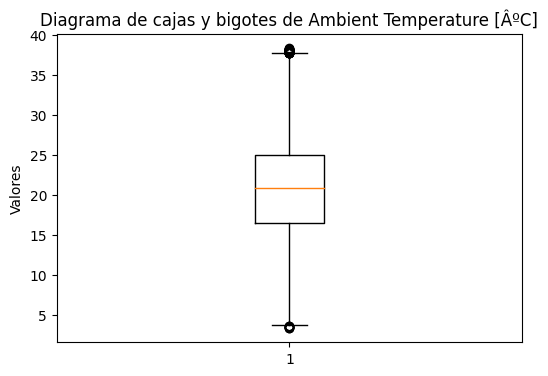

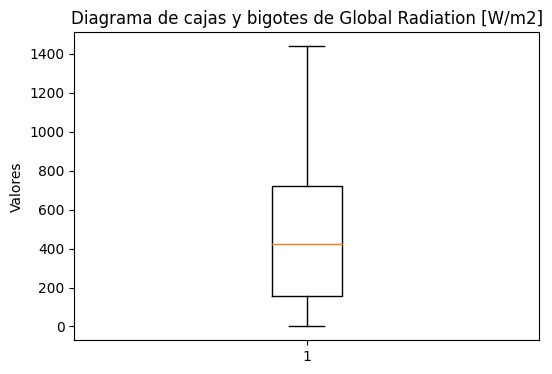

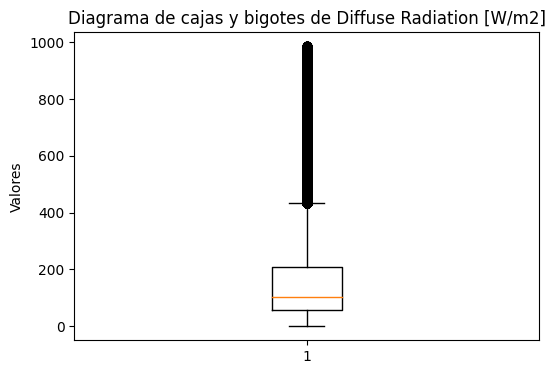

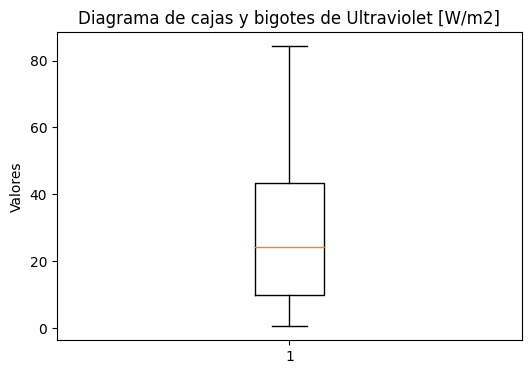

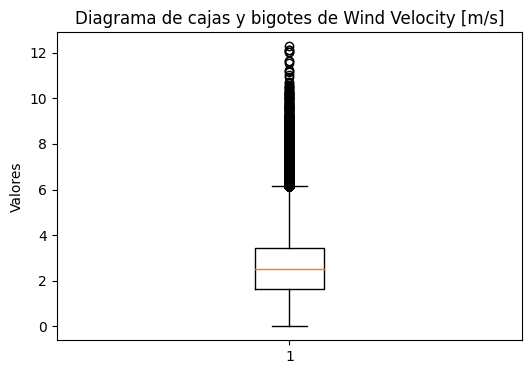

...

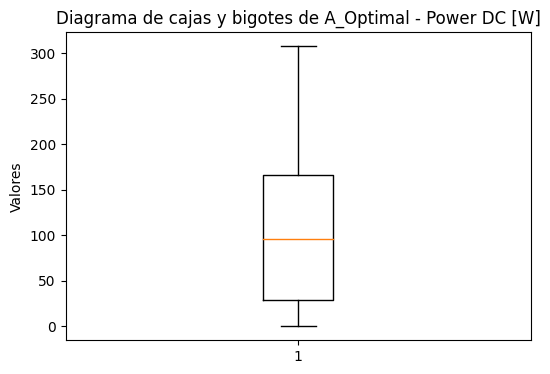

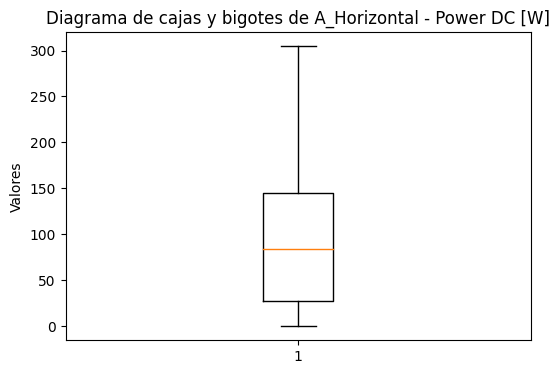

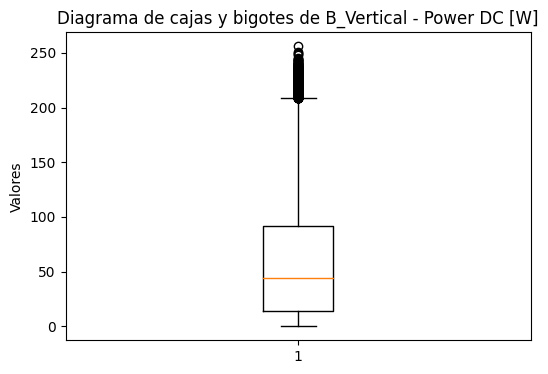

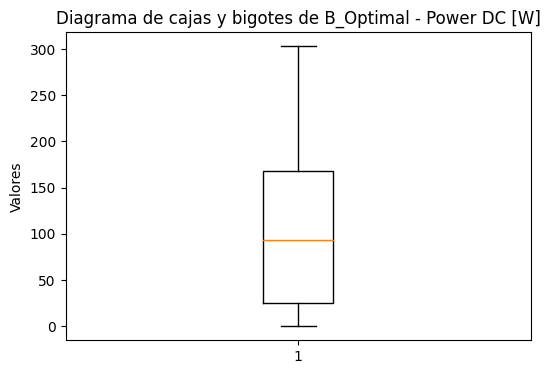

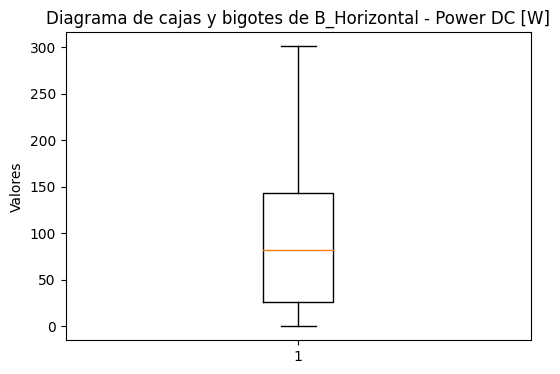

In [ ]:
plt.figure(figsize=(6, 4))

atributos = ("A_Vertical - Voltage DC [V]",	"A_Vertical - Current DC [A]",
             "B_Vertical - Voltage DC [V]",	"B_Vertical - Current DC [A]",
             "B_Optimal - Voltage DC [V]",	"B_Optimal - Current DC [A]",
             "A_Optimal - Voltage DC [V]",	"A_Optimal - Current DC [A]",
             "A_Horizontal - Voltage DC [V]",	"A_Horizontal - Current DC [A]",
             "B_Horizontal - Voltage DC [V]",	"B_Horizontal - Current DC [A]",
             "B_Vertical - Temperature [ÂºC]",	"B_Optimal - Temperature [ÂºC]",
             "B_Horizontal - Temperature [ÂºC]", "A_Vertical - Temperature [ÂºC]",
             "A_Optimal - Temperature [ÂºC]", "A_Horizontal - Temperature [ÂºC]", "Datetime")

for columna in df_Generacion_fil.columns:
    if columna not in atributos:
      plt.figure(figsize=(6, 4))
      plt.boxplot(df_Generacion_fil[columna])
      plt.title(f'Diagrama de cajas y bigotes de {columna}')
      plt.ylabel('Valores')
      plt.show()

En referencia a los valores fuera de rango, se identificaron en los atributos Diffuse Radiation [W/m2], Wind Velocity [m/s], A_Vertical - Power DC [W] y B_Vertical - Power DC [W]. No obstante, con la finalidad de no perder información que puede generar patrones importantes en la predicción, no se eliminaron los valores fuera de rango.

---
# 3. Transformación de los datos
---

En la transformación de los datos, se creará un atributo denominado Total Power DC [W], que corresponderá al valor total de la potencia generada, que se calculará mediante la suma de los valores de las potencias de generación, en las tres inclinaciones de los paneles y los dos módulos (A y B).

In [ ]:
df_Generacion_fil = df_Generacion_fil.copy()
df_Generacion_fil['Total Power DC [W]']=(df_Generacion_fil['A_Vertical - Power DC [W]']+df_Generacion_fil['A_Optimal - Power DC [W]']+
                                        df_Generacion_fil['A_Horizontal - Power DC [W]']+df_Generacion_fil['B_Vertical - Power DC [W]']+
                                        df_Generacion_fil['B_Optimal - Power DC [W]']+df_Generacion_fil['B_Horizontal - Power DC [W]'])
df_Generacion_fil.isnull().sum()

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],12174
A_Vertical - Current DC [A],12174
A_Vertical - Power DC [W],0


In [ ]:
df_Test_Generacion_2017['Total Power DC [W]']= (df_Test_Generacion_2017['A_Vertical - Power DC [W]']+
                                              df_Test_Generacion_2017['A_Optimal - Power DC [W]']+
                                              df_Test_Generacion_2017['A_Horizontal - Power DC [W]']+
                                              df_Test_Generacion_2017['B_Vertical - Power DC [W]']+
                                              df_Test_Generacion_2017['B_Optimal - Power DC [W]']+
                                              df_Test_Generacion_2017['B_Horizontal - Power DC [W]'])
df_Test_Generacion_2017.isnull().sum()

,0
Datetime,0
Ambient Temperature [ÂºC],0
Global Radiation [W/m2],0
Diffuse Radiation [W/m2],0
Ultraviolet [W/m2],0
Wind Velocity [m/s],0
Wind Direction [Âº],0
A_Vertical - Voltage DC [V],0
A_Vertical - Current DC [A],0
A_Vertical - Power DC [W],0


In [ ]:
df_Generacion_fil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 621843 entries, 0 to 621842
Data columns (total 32 columns):
 #   Column                            Non-Null Count   Dtype              
---  ------                            --------------   -----              
 0   Datetime                          621843 non-null  datetime64[ns, UTC]
 1   Ambient Temperature [ÂºC]         621843 non-null  float64            
 2   Global Radiation [W/m2]           621843 non-null  float64            
 3   Diffuse Radiation [W/m2]          621843 non-null  float64            
 4   Ultraviolet [W/m2]                621843 non-null  float64            
 5   Wind Velocity [m/s]               621843 non-null  float64            
 6   Wind Direction [Âº]               621843 non-null  float64            
 7   A_Vertical - Voltage DC [V]       609669 non-null  float64            
 8   A_Vertical - Current DC [A]       609669 non-null  float64            
 9   A_Vertical - Power DC [W]         621843 non-nul

A continuación, el atributo Datetime se utilizará como índice en el dataframe debido a que facilita el análisis y manipulación de datos basados en tiempo

In [ ]:
df_Generacion_fil.set_index('Datetime', inplace=True)
df_Generacion_fil

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],A_Optimal - Voltage DC [V],...,B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC],Total Power DC [W]
Datetime,,,,,,,,,,,,,,,,,,,,,
2014-01-01 07:41:00+00:00,9.700000,7.131149,6.929149,0.751824,0.700000,275.333840,NaN,NaN,1.54525,14.6,...,NaN,NaN,2.160700,NaN,NaN,2.508175,10.2,9.7,8.8,13.048796
2014-01-01 07:42:00+00:00,9.700000,7.040442,6.847878,0.781930,0.666667,278.503060,NaN,NaN,1.62840,23.1,...,18.30,0.130512,2.388366,NaN,NaN,2.073850,10.2,9.7,8.8,11.640416
2014-01-01 07:43:00+00:00,9.700000,6.594407,6.672844,0.813929,0.616667,284.667120,19.00,0.0475,0.90250,23.1,...,22.35,0.052500,1.173375,NaN,NaN,1.247725,10.2,9.7,8.8,7.087175
2014-01-01 07:44:00+00:00,9.700000,7.358729,6.752742,0.849919,0.666667,278.666660,18.65,0.0500,0.93250,23.1,...,24.35,0.052500,1.278375,NaN,NaN,1.264850,10.3,9.7,8.8,7.774502
2014-01-01 07:45:00+00:00,9.700000,7.470711,7.181158,0.886891,0.633333,272.666360,18.65,0.0550,1.02575,22.2,...,25.25,0.052500,1.325625,NaN,NaN,1.324825,10.3,9.7,8.9,7.740650
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-29 17:23:00+00:00,15.316668,8.755578,0.251044,0.998767,1.233333,87.009664,25.75,0.0300,0.77250,27.5,...,26.05,0.027500,0.716375,24.35,0.0325,0.791375,16.8,15.5,15.0,4.651250
2016-12-29 17:24:00+00:00,15.300000,8.054794,0.455081,0.959046,1.016667,88.903272,24.65,0.0300,0.73950,26.9,...,25.25,0.027500,0.694375,22.90,0.0350,0.801500,16.7,15.4,14.9,4.538125
2016-12-29 17:25:00+00:00,15.300000,7.471079,0.476495,0.913300,1.150000,94.489216,NaN,NaN,0.64755,26.1,...,24.20,0.027500,0.665500,15.65,0.0375,0.586875,16.7,15.4,14.8,4.128100


In [ ]:
df_Generacion_fil.index = df_Generacion_fil.index.tz_localize(None)
df_Generacion_fil.to_excel('datasetgeneracionlimpionoindex.xlsx',index=True)

In [ ]:
df_Test_Generacion_2017.set_index('Datetime', inplace=True)
df_Test_Generacion_2017

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],A_Optimal - Voltage DC [V],...,B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC],Total Power DC [W]
Datetime,,,,,,,,,,,,,,,,,,,,,
2017-01-20 07:52:00+00:00,4.900000,7.267174,6.914082,1.353073,3.600000,331.65972,19.25,0.0750,1.443750,21.60,...,21.50,0.0825,1.773750,21.45,0.10753,2.306519,4.8,4.1,3.2,10.391019
2017-01-20 07:53:00+00:00,4.983333,8.119104,7.055244,1.416638,3.900000,330.66696,19.25,0.0850,1.636250,32.15,...,20.95,0.0925,1.937875,19.70,0.07750,1.526750,4.9,4.3,3.4,9.422625
2017-01-20 07:54:00+00:00,5.000000,8.641460,8.173192,1.483865,3.550000,330.99438,19.20,0.1175,2.256000,32.75,...,31.65,0.0250,0.791250,19.75,0.08500,1.678750,5.1,4.5,3.6,9.448000
2017-01-20 07:55:00+00:00,5.000000,9.611446,8.830058,1.548960,3.500000,330.83166,19.30,0.2775,5.355750,32.95,...,33.30,0.0225,0.749250,31.25,0.02000,0.625000,5.3,4.7,3.8,16.026250
2017-01-20 07:56:00+00:00,5.000000,12.314148,10.599564,1.618800,4.316667,332.66656,19.20,0.4900,9.408000,30.15,...,29.80,0.3700,11.026000,23.00,0.10750,2.472500,5.4,4.9,3.9,40.680500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-12-31 16:54:00+00:00,16.866666,13.530808,13.048542,1.384731,5.066667,297.14698,27.25,0.0275,0.749375,29.40,...,28.50,0.0275,0.783750,18.75,0.09250,1.734375,19.6,18.8,18.7,6.708500
2017-12-31 16:57:00+00:00,16.800002,14.352264,13.914030,1.323520,5.100000,298.50012,26.70,0.0300,0.801000,29.45,...,28.50,0.0275,0.783750,18.75,0.10000,1.875000,19.6,18.8,18.6,6.924500
2017-12-31 16:58:00+00:00,16.800002,13.566784,13.608252,1.285211,3.850001,276.45834,26.35,0.0300,0.790500,29.30,...,28.40,0.0275,0.781000,18.65,0.09500,1.771750,19.5,18.7,18.5,6.812250


In [ ]:
df_Test_Generacion_2017.index = df_Test_Generacion_2017.index.tz_localize(None)
df_Test_Generacion_2017.to_excel('dataset_test.xlsx',index=True)

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
import os

In [ ]:
df_Generacion_fil = pd.read_excel('datasetgeneracionlimpionoindex.xlsx')

In [ ]:
df_Test_Generacion_2017 = pd.read_excel('dataset_test.xlsx')

In [ ]:
df_Generacion_fil['Datetime'] = pd.to_datetime(df_Generacion_fil['Datetime'])
df_Test_Generacion_2017['Datetime'] = pd.to_datetime(df_Test_Generacion_2017['Datetime'])
df_Generacion_fil.set_index('Datetime', inplace=True)
df_Test_Generacion_2017.set_index('Datetime', inplace=True)

In [ ]:
df_Generacion_fil

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Wind Direction [Âº],A_Vertical - Voltage DC [V],A_Vertical - Current DC [A],A_Vertical - Power DC [W],A_Optimal - Voltage DC [V],...,B_Optimal - Voltage DC [V],B_Optimal - Current DC [A],B_Optimal - Power DC [W],B_Horizontal - Voltage DC [V],B_Horizontal - Current DC [A],B_Horizontal - Power DC [W],B_Vertical - Temperature [ÂºC],B_Optimal - Temperature [ÂºC],B_Horizontal - Temperature [ÂºC],Total Power DC [W]
Datetime,,,,,,,,,,,,,,,,,,,,,
2014-01-01 07:41:00,9.700000,7.131149,6.929149,0.751824,0.700000,275.333840,18.17,0.3940,7.086325,14.6,...,17.68,0.120953,2.043297,17.48,0.26800,4.375050,10.2,9.7,8.8,25.177283
2014-01-01 07:42:00,9.700000,7.040442,6.847878,0.781930,0.666667,278.503060,18.60,0.0620,1.154175,23.1,...,18.30,0.130512,2.388366,17.62,0.27850,4.460675,10.2,9.7,8.8,31.045764
2014-01-01 07:43:00,9.700000,6.594407,6.672844,0.813929,0.616667,284.667120,19.00,0.0475,0.902500,23.1,...,22.35,0.052500,1.173375,19.99,0.06850,1.364800,10.2,9.7,8.8,26.477740
2014-01-01 07:44:00,9.700000,7.358729,6.752742,0.849919,0.666667,278.666660,18.65,0.0500,0.932500,23.1,...,24.35,0.052500,1.278375,16.98,0.07000,1.184025,10.3,9.7,8.8,7.394430
2014-01-01 07:45:00,9.700000,7.470711,7.181158,0.886891,0.633333,272.666360,18.65,0.0550,1.025750,22.2,...,25.25,0.052500,1.325625,16.49,0.08575,1.376288,10.3,9.7,8.9,8.090356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-29 17:23:00,15.316668,8.755578,0.251044,0.998767,1.233333,87.009664,25.75,0.0300,0.772500,27.5,...,26.05,0.027500,0.716375,24.35,0.03250,0.791375,16.8,15.5,15.0,4.651250
2016-12-29 17:24:00,15.300000,8.054794,0.455081,0.959046,1.016667,88.903272,24.65,0.0300,0.739500,26.9,...,25.25,0.027500,0.694375,22.90,0.03500,0.801500,16.7,15.4,14.9,4.538125
2016-12-29 17:25:00,15.300000,7.471079,0.476495,0.913300,1.150000,94.489216,22.38,0.0155,0.350925,26.1,...,24.20,0.027500,0.665500,15.65,0.03750,0.586875,16.7,15.4,14.8,3.653025


Dado que los modelos de predicción de generación de energía fotovoltaica, se realizarán para predecir el total de la potencia de generación, se eliminaron todos los atributos relacionados a la corriente, voltaje y las temperaturas del panel

In [ ]:
df_Generacion_fil2=df_Generacion_fil.drop(['A_Vertical - Voltage DC [V]',
                                           'A_Vertical - Current DC [A]',	'A_Vertical - Power DC [W]',
                                           'A_Optimal - Voltage DC [V]', 'A_Optimal - Current DC [A]',
                                           'A_Optimal - Power DC [W]', 'A_Horizontal - Voltage DC [V]',
                                           'A_Horizontal - Current DC [A]', 'A_Horizontal - Power DC [W]',
                                           'A_Vertical - Temperature [ÂºC]',	'A_Optimal - Temperature [ÂºC]',
                                           'A_Horizontal - Temperature [ÂºC]',	'B_Vertical - Voltage DC [V]',
                                           'B_Vertical - Current DC [A]', 'B_Vertical - Power DC [W]',
                                           'B_Optimal - Voltage DC [V]',	'B_Optimal - Current DC [A]',
                                           'B_Optimal - Power DC [W]',	'B_Horizontal - Voltage DC [V]',
                                           'B_Horizontal - Current DC [A]', 'B_Horizontal - Power DC [W]',
                                           'B_Vertical - Temperature [ÂºC]',	'B_Optimal - Temperature [ÂºC]',
                                           'B_Horizontal - Temperature [ÂºC]'], axis=1)

In [ ]:
df_Test_Generacion_20172=df_Test_Generacion_2017.drop(['A_Vertical - Voltage DC [V]',
                                           'A_Vertical - Current DC [A]',	'A_Vertical - Power DC [W]',
                                           'A_Optimal - Voltage DC [V]', 'A_Optimal - Current DC [A]',
                                           'A_Optimal - Power DC [W]', 'A_Horizontal - Voltage DC [V]',
                                           'A_Horizontal - Current DC [A]', 'A_Horizontal - Power DC [W]',
                                           'A_Vertical - Temperature [ÂºC]',	'A_Optimal - Temperature [ÂºC]',
                                           'A_Horizontal - Temperature [ÂºC]',	'B_Vertical - Voltage DC [V]',
                                           'B_Vertical - Current DC [A]', 'B_Vertical - Power DC [W]',
                                           'B_Optimal - Voltage DC [V]',	'B_Optimal - Current DC [A]',
                                           'B_Optimal - Power DC [W]',	'B_Horizontal - Voltage DC [V]',
                                           'B_Horizontal - Current DC [A]', 'B_Horizontal - Power DC [W]',
                                           'B_Vertical - Temperature [ÂºC]',	'B_Optimal - Temperature [ÂºC]',
                                           'B_Horizontal - Temperature [ÂºC]'], axis=1)

A continuación, se realizará la codificación circular de las variables que componen el atributo Datetime y se crearan nuevos atributos (Year, Month_Sen, Month_Cos, Day, Hour_Sen, Hour_Cos, Minute, Day of the Week_Sen, Day of the Week_Cos, Wind_Dir_Sen, Wind_Dir_Cos)

In [ ]:
df_Generacion_fil2['Year']=df_Generacion_fil2.index.year
df_Generacion_fil2['Month']=df_Generacion_fil2.index.month
df_Generacion_fil2['Day']=df_Generacion_fil2.index.day
df_Generacion_fil2['Hour']=df_Generacion_fil2.index.hour
df_Generacion_fil2['Minute']=df_Generacion_fil2.index.minute
df_Generacion_fil2['Day of Week']=df_Generacion_fil2.index.dayofweek


df_Test_Generacion_20172['Year']=df_Test_Generacion_20172.index.year
df_Test_Generacion_20172['Month']=df_Test_Generacion_20172.index.month
df_Test_Generacion_20172['Day']=df_Test_Generacion_20172.index.day
df_Test_Generacion_20172['Hour']=df_Test_Generacion_20172.index.hour
df_Test_Generacion_20172['Minute']=df_Test_Generacion_20172.index.minute
df_Test_Generacion_20172['Day of Week']=df_Test_Generacion_20172.index.dayofweek


# Codificación circular para el mes del ano

df_Generacion_fil2['Month_Sen']=np.sin(2 * np.pi * df_Generacion_fil2['Month'] / 12)
df_Generacion_fil2['Month_Cos']=np.cos(2 * np.pi * df_Generacion_fil2['Month'] / 12)
df_Test_Generacion_20172['Month_Sen']=np.sin(2 * np.pi * df_Test_Generacion_20172['Month'] / 12)
df_Test_Generacion_20172['Month_Cos']=np.cos(2 * np.pi * df_Test_Generacion_20172['Month'] / 12)


# Codificación circular para la hora del día

df_Generacion_fil2['Hour_Sen']=np.sin(2 * np.pi * df_Generacion_fil2['Hour'] / 24)
df_Generacion_fil2['Hour_Cos']=np.cos(2 * np.pi * df_Generacion_fil2['Hour'] / 24)
df_Test_Generacion_20172['Hour_Sen']=np.sin(2 * np.pi * df_Test_Generacion_20172['Hour'] / 24)
df_Test_Generacion_20172['Hour_Cos']=np.cos(2 * np.pi * df_Test_Generacion_20172['Hour'] / 24)


# Codificación circular para el día de la semana

df_Generacion_fil2['Day of Week_Sen']=np.sin(2 * np.pi * df_Generacion_fil2['Day of Week'] / 7)
df_Generacion_fil2['Day of Week_Cos']=np.cos(2 * np.pi * df_Generacion_fil2['Day of Week'] / 7)
df_Test_Generacion_20172['Day of Week_Sen']=np.sin(2 * np.pi * df_Test_Generacion_20172['Day of Week'] / 7)
df_Test_Generacion_20172['Day of Week_Cos']=np.cos(2 * np.pi * df_Test_Generacion_20172['Day of Week'] / 7)

# Codificación circular para la direccion del viento

df_Generacion_fil2['Wind_Dir_Sen'] = np.sin(np.deg2rad(df_Generacion_fil2['Wind Direction [Âº]']))
df_Generacion_fil2['Wind_Dir_Cos'] = np.cos(np.deg2rad(df_Generacion_fil2['Wind Direction [Âº]']))
df_Test_Generacion_20172['Wind_Dir_Sen'] = np.sin(np.deg2rad(df_Test_Generacion_20172['Wind Direction [Âº]']))
df_Test_Generacion_20172['Wind_Dir_Cos'] = np.cos(np.deg2rad(df_Test_Generacion_20172['Wind Direction [Âº]']))


df_Generacion_fil2 = df_Generacion_fil2.drop(['Hour', 'Day of Week', 'Month','Wind Direction [Âº]'], axis=1)
df_Test_Generacion_20172 = df_Test_Generacion_20172.drop(['Hour', 'Day of Week', 'Month', 'Wind Direction [Âº]'], axis=1)
df_Generacion_fil2

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Total Power DC [W],Year,Day,Minute,Month_Sen,Month_Cos,Hour_Sen,Hour_Cos,Day of Week_Sen,Day of Week_Cos,Wind_Dir_Sen,Wind_Dir_Cos
Datetime,,,,,,,,,,,,,,,,,
2014-01-01 07:41:00+00:00,9.700000,7.131149,6.929149,0.751824,0.700000,13.048796,2014,1,41,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.995670,0.092959
2014-01-01 07:42:00+00:00,9.700000,7.040442,6.847878,0.781930,0.666667,11.640416,2014,1,42,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.989008,0.147862
2014-01-01 07:43:00+00:00,9.700000,6.594407,6.672844,0.813929,0.616667,7.087175,2014,1,43,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.967413,0.253203
2014-01-01 07:44:00+00:00,9.700000,7.358729,6.752742,0.849919,0.666667,7.774502,2014,1,44,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.988582,0.150686
2014-01-01 07:45:00+00:00,9.700000,7.470711,7.181158,0.886891,0.633333,7.740650,2014,1,45,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.998917,0.046520
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-29 17:23:00+00:00,15.316668,8.755578,0.251044,0.998767,1.233333,4.651250,2016,29,23,-2.449294e-16,1.000000,-0.965926,-0.258819,0.433884,-0.900969,0.998638,0.052168
2016-12-29 17:24:00+00:00,15.300000,8.054794,0.455081,0.959046,1.016667,4.538125,2016,29,24,-2.449294e-16,1.000000,-0.965926,-0.258819,0.433884,-0.900969,0.999817,0.019140
2016-12-29 17:25:00+00:00,15.300000,7.471079,0.476495,0.913300,1.150000,4.128100,2016,29,25,-2.449294e-16,1.000000,-0.965926,-0.258819,0.433884,-0.900969,0.996932,-0.078271


In [ ]:
df_Generacion_fil2.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 621843 entries, 2014-01-01 07:41:00 to 2016-12-29 17:27:00
Data columns (total 17 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   Ambient Temperature [ÂºC]  621843 non-null  float64
 1   Global Radiation [W/m2]    621843 non-null  float64
 2   Diffuse Radiation [W/m2]   621843 non-null  float64
 3   Ultraviolet [W/m2]         621843 non-null  float64
 4   Wind Velocity [m/s]        621843 non-null  float64
 5   Total Power DC [W]         621843 non-null  float64
 6   Year                       621843 non-null  int32  
 7   Day                        621843 non-null  int32  
 8   Minute                     621843 non-null  int32  
 9   Month_Sen                  621843 non-null  float64
 10  Month_Cos                  621843 non-null  float64
 11  Hour_Sen                   621843 non-null  float64
 12  Hour_Cos                   621843 non-null  float64


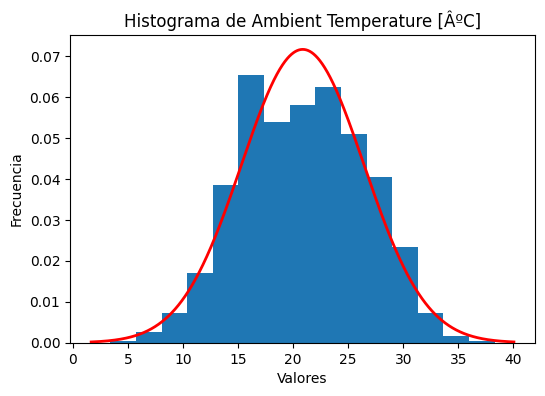

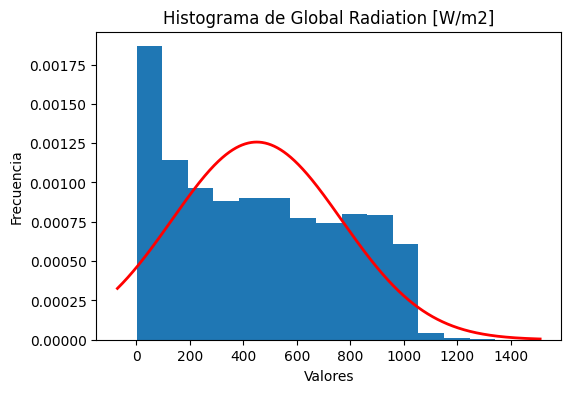

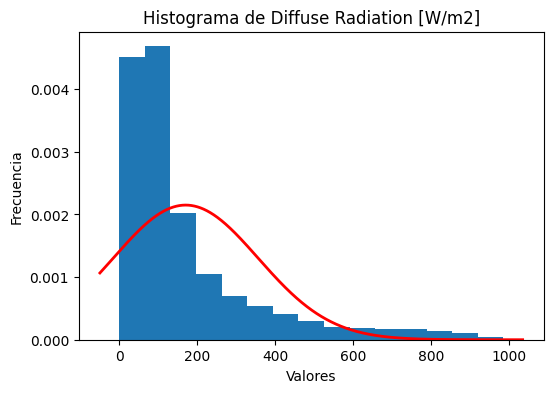

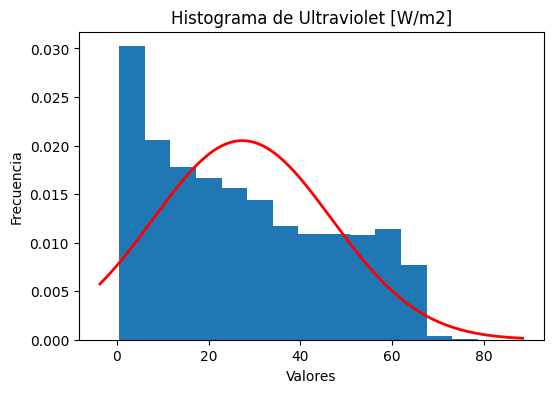

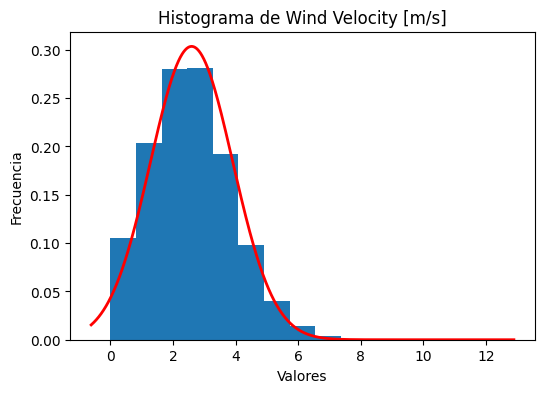

...

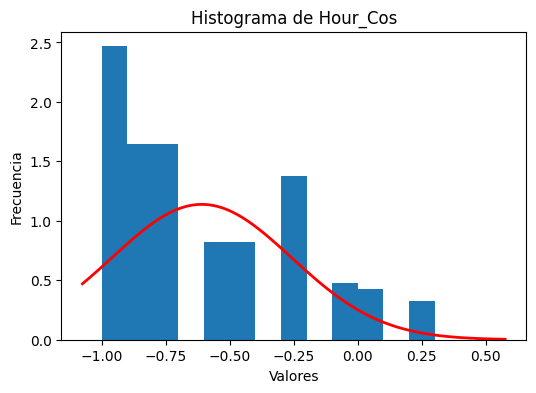

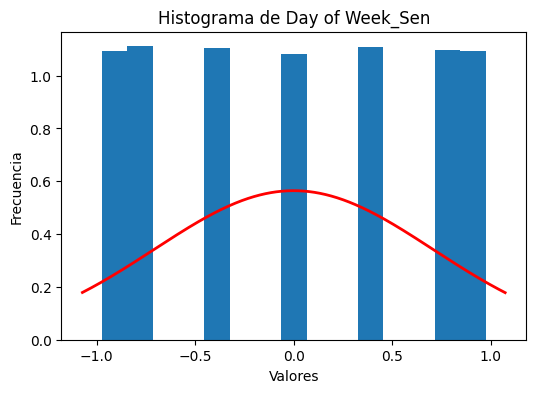

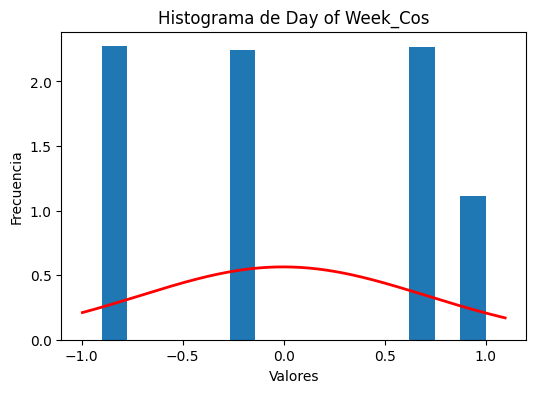

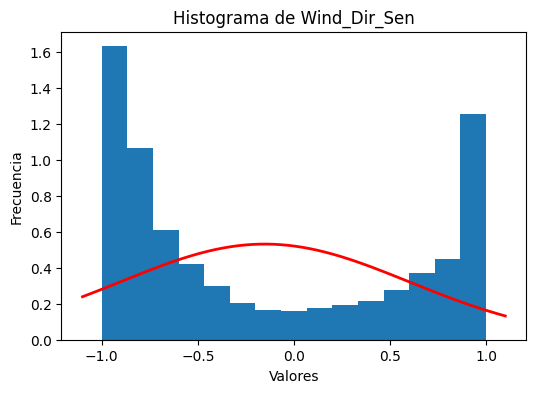

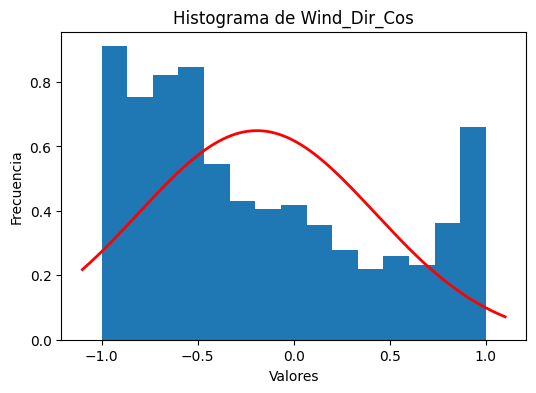

In [ ]:
from scipy.stats import norm

for columna in df_Generacion_fil2.columns:
    plt.figure(figsize=(6, 4))
    plt.hist(df_Generacion_fil2[columna], bins=15, density=True)
    media_pob, sigma = norm.fit(df_Generacion_fil2[columna])
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 1400)
    p = norm.pdf(x, media_pob, sigma)
    plt.plot(x, p, 'r', linewidth=2, label='Curva Gaussiana')
    plt.xlabel('Valores')
    plt.ylabel('Frecuencia')
    plt.title(f'Histograma de {columna}')
    plt.show()

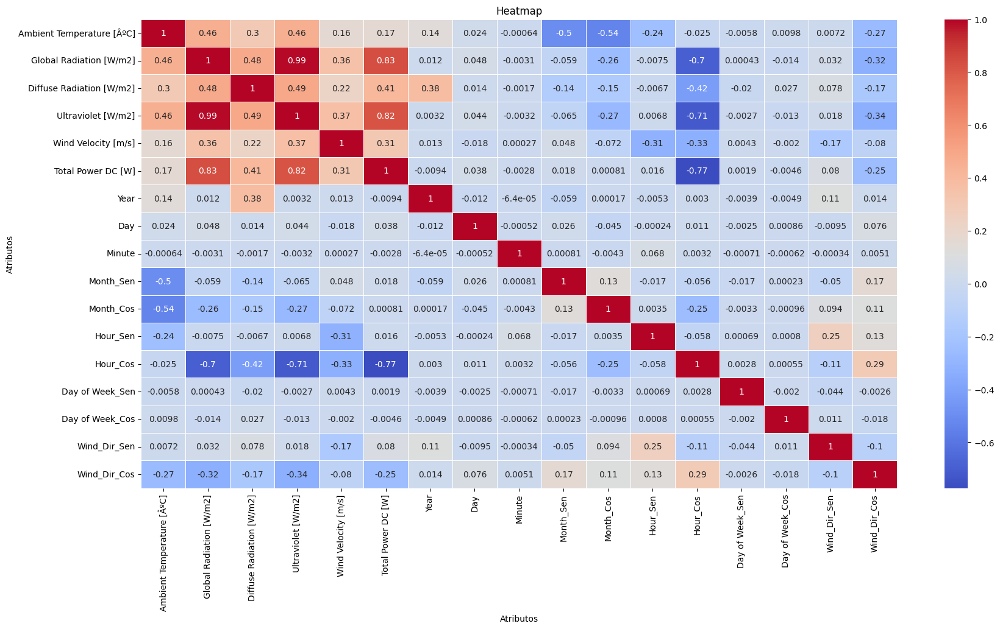

In [ ]:
correlacion=df_Generacion_fil2.corr()
plt.figure(figsize=(20, 10))
sns.heatmap(correlacion, annot=True, cmap='coolwarm', linewidths=0.5)
plt.xlabel('Atributos')
plt.ylabel('Atributos')
plt.title('Heatmap')
plt.show()

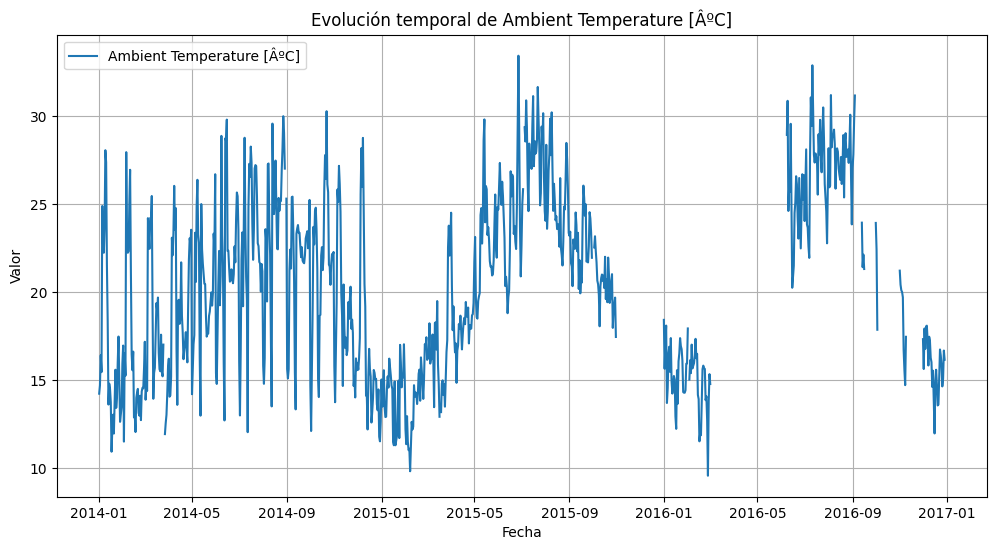

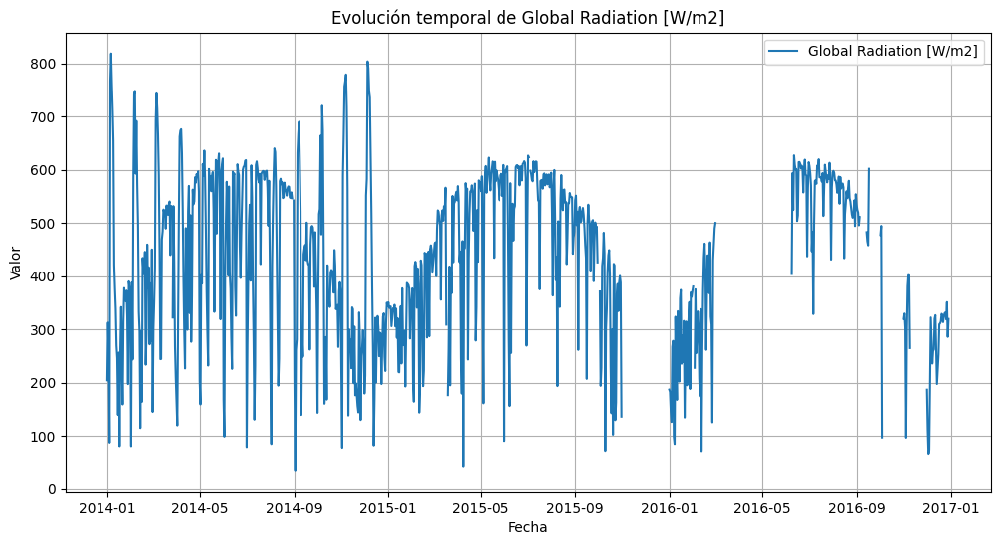

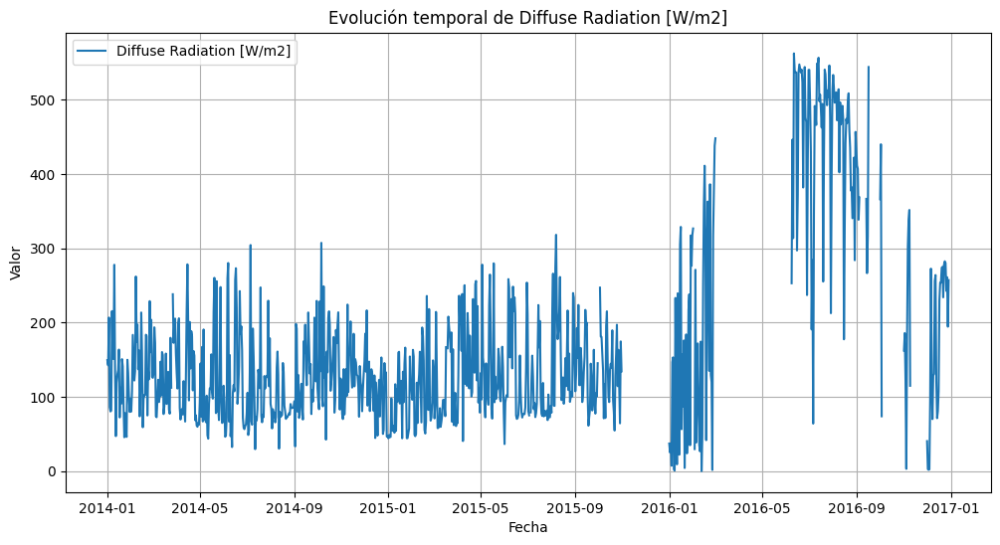

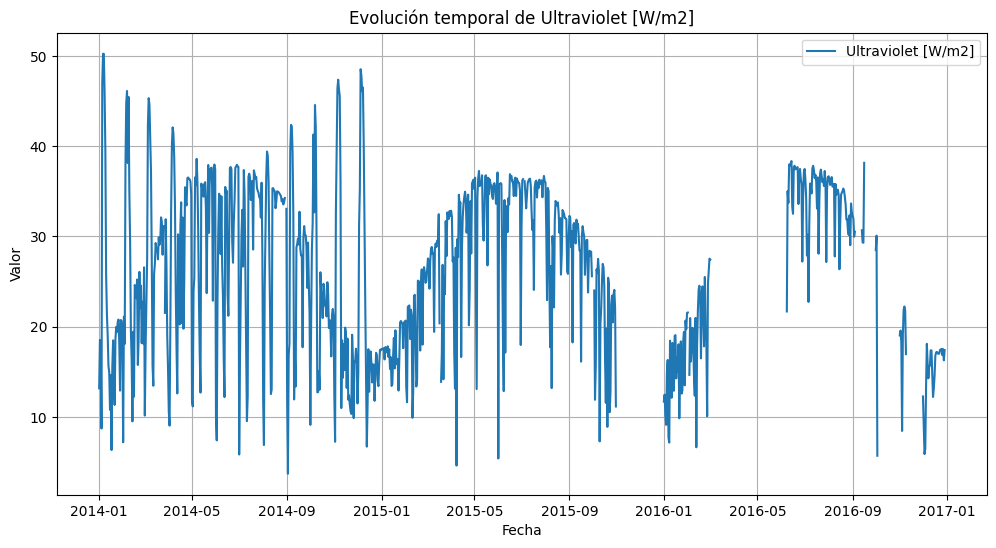

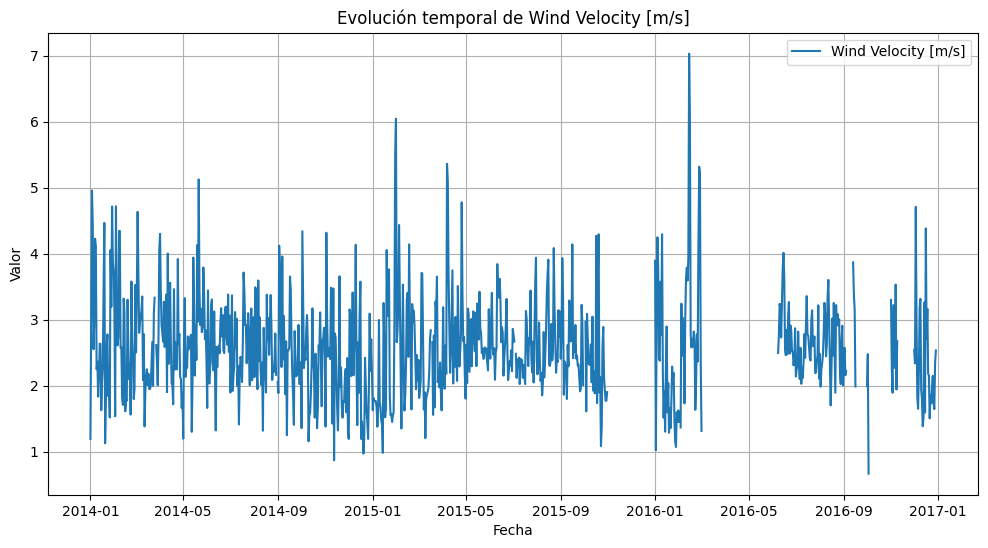

...

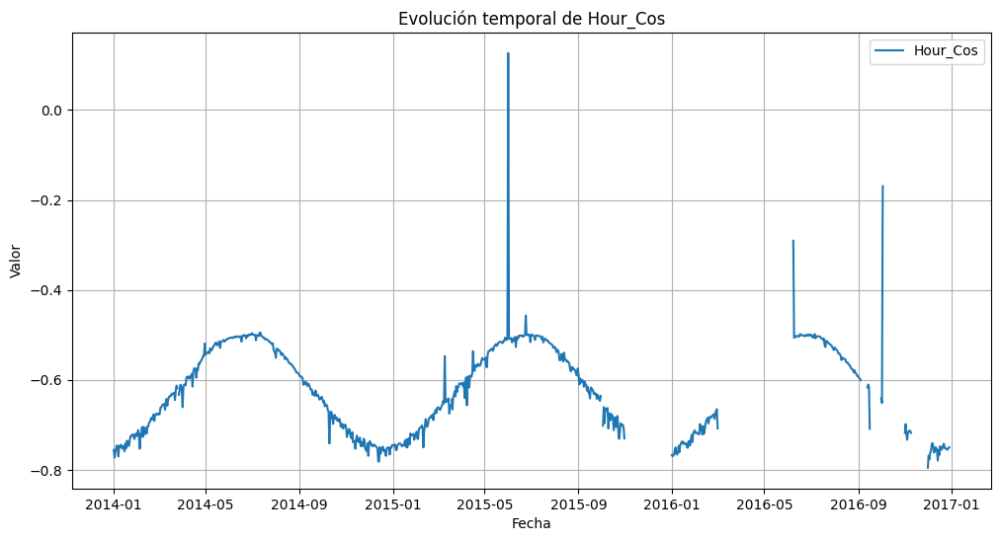

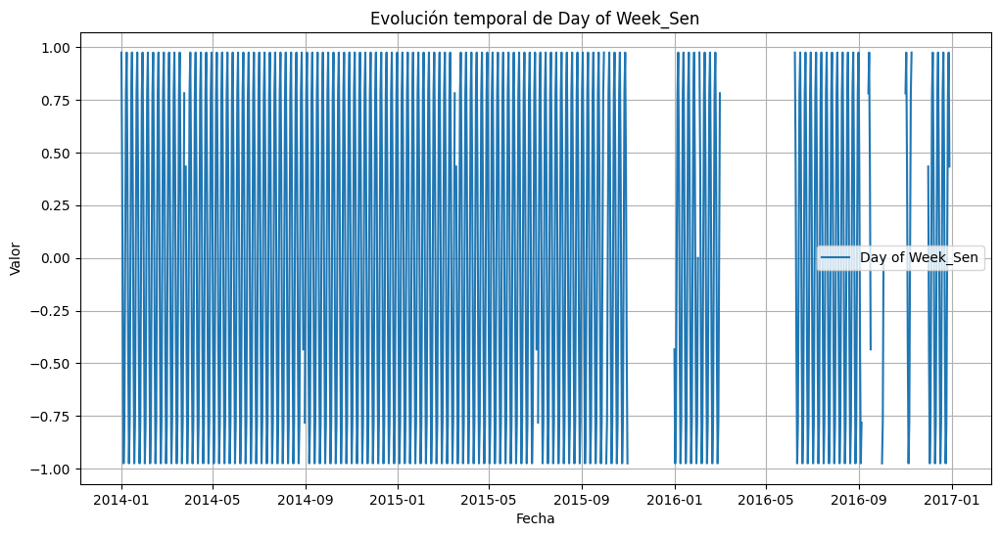

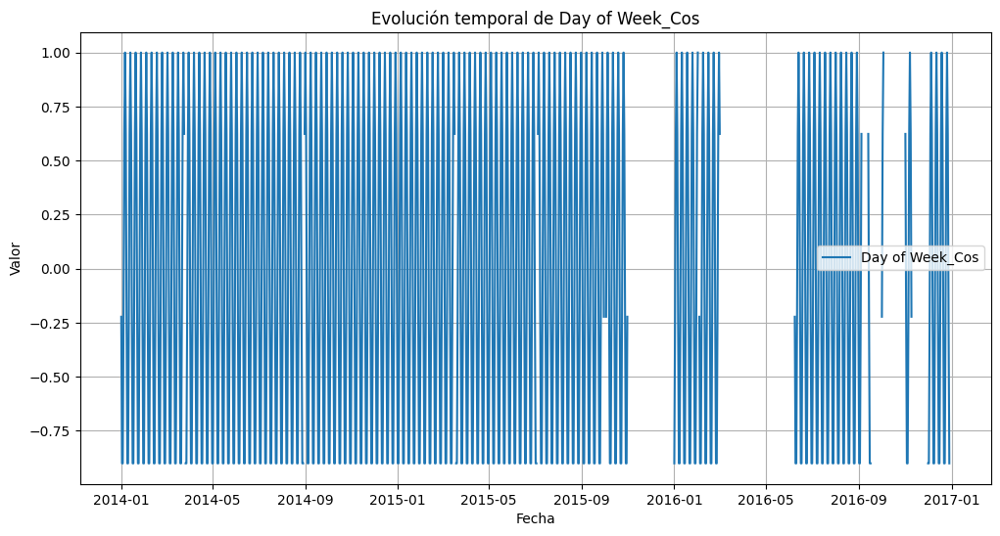

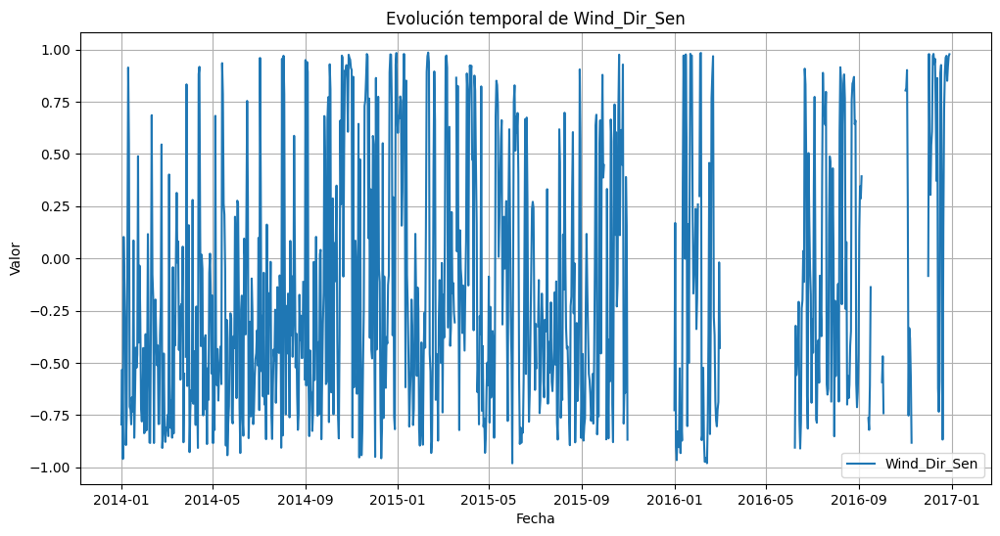

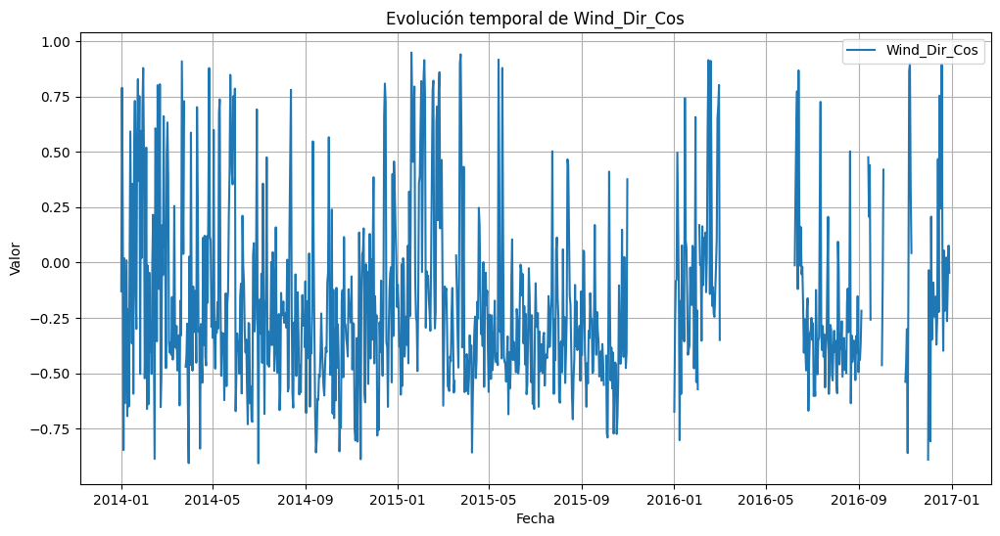

In [ ]:
from scipy.stats import norm
import matplotlib.pyplot as plt
df_resampled = df_Generacion_fil2.resample('D').mean()

for columna in df_resampled.columns:
    plt.figure(figsize=(12, 6))
    plt.plot(df_resampled.index, df_resampled[columna], label=columna)
    plt.xlabel('Fecha')
    plt.ylabel('Valor')
    plt.title(f'Evolución temporal de {columna}')
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
df_Generacion_fil2.index = df_Generacion_fil2.index.tz_localize(None)
df_Test_Generacion_20172.index = df_Test_Generacion_20172.index.tz_localize(None)
df_Generacion_fil2.to_excel('datasetgeneracionfil2.xlsx',index=True)
df_Test_Generacion_20172.to_excel('datasettest20172.xlsx',index=True)

**Análisis de reducción de la dimensionalidad mediante el uso del dataset transpuesto**

In [ ]:
from numpy import corrcoef, transpose, arange
from pylab import pcolor, show, colorbar, xticks, yticks
from sklearn.preprocessing import MinMaxScaler
from scipy import cluster
import sklearn.metrics

df_Generacion_fil_nodate=df_Generacion_fil2.drop(['Datetime'], axis=1, errors='ignore')
df_Generacion_filT = df_Generacion_fil_nodate.transpose()

nombres =  df_Generacion_filT.index

var_std=MinMaxScaler()
std_df_Generacion_filT=var_std.fit_transform(df_Generacion_filT)

dist = sklearn.metrics.DistanceMetric.get_metric('euclidean')
matdist= dist.pairwise(std_df_Generacion_filT)

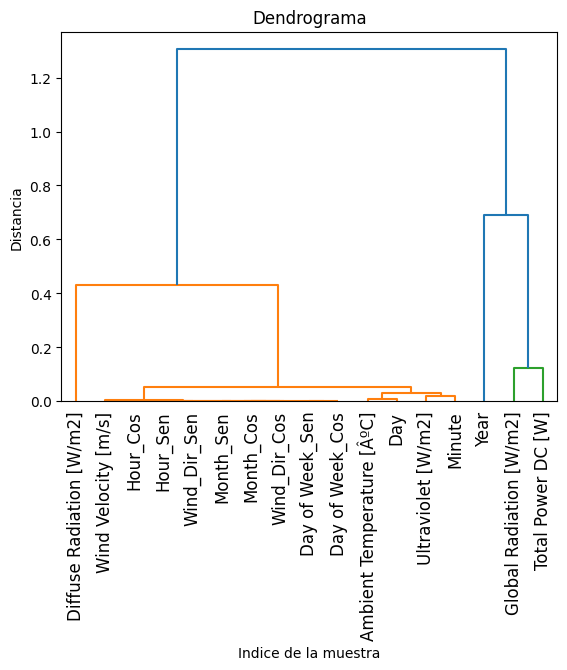

In [ ]:
import scipy.cluster.hierarchy as sch
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.preprocessing import normalize
from scipy.spatial.distance import pdist, squareform

# Normalizamos la matriz de distancia
matdist_std = normalize(matdist)

clustering_jerarquico2=linkage(matdist_std,method='complete')
dendrogram=sch.dendrogram(clustering_jerarquico2, color_threshold = 0.5, labels = nombres, leaf_rotation=90)
plt.title('Dendrograma')
plt.xlabel('Indice de la muestra')
plt.ylabel('Distancia')
plt.show()

In [ ]:
cut = 0.3  # !!!! ad-hoc
labels = cluster.hierarchy.fcluster(clustering_jerarquico2, cut , criterion = 'distance')
labels

array([1, 3, 2, 1, 1, 3, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=int32)

Componentes lineales:
 [[ 0.00118207  0.00118187  0.00118132 ...  0.00118026  0.0011802
   0.00118001]
 [-0.00188225 -0.00188563 -0.00189618 ... -0.00190648 -0.00190689
  -0.0019104 ]]

Ratio de variabilidad:  [0.94742011 0.04196646] 



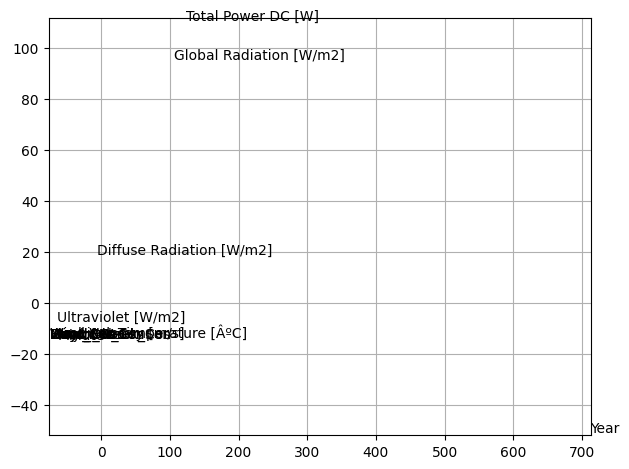

In [ ]:
from sklearn.decomposition import PCA

pca_comp=PCA(n_components=2)
generacion_PCA=pca_comp.fit_transform(std_df_Generacion_filT)
print("Componentes lineales:\n", pca_comp.components_)
print("\nRatio de variabilidad: ", pca_comp.explained_variance_ratio_, "\n")
fig, ax = plt.subplots()
for i in range(len(generacion_PCA)):
    plt.text(generacion_PCA[i][0], generacion_PCA[i][1], nombres[i])

plt.xlim(min(generacion_PCA[:, 0]) - 1, max(generacion_PCA[:, 0]) + 1)
plt.ylim(min(generacion_PCA[:, 1]) - 1, max(generacion_PCA[:, 1]) + 1)
ax.grid(True)
fig.tight_layout()
plt.show()

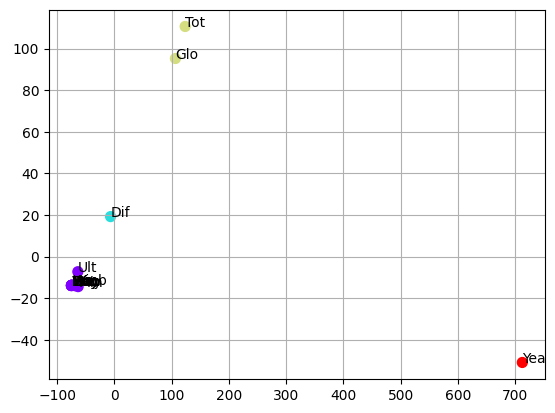

In [ ]:
plt.scatter(generacion_PCA[:,0], generacion_PCA[:,1], c=labels,s=50, cmap="rainbow")
for i in range(len(generacion_PCA)):
    plt.text(generacion_PCA[i][0], generacion_PCA[i][1], nombres[i][0:3])
plt.grid()
plt.show()

En función a los resultados obtenidos, la distribución de los clusters es de la siguiente forma:

•	**Clúster (1):** Se agruparon las características Global Radiation [W/m2] y Total Power DC [W]

•	**Clúster (2):** Se tiene la característica Year

•	**Clúster (3):** Se agruparon las características Ambient Temperature [ÂºC], Ultraviolet [W/m2], Wind Velocity [m/s], Day, Minute, Month_Sen, Month_Cos, Hour_Sen, Hour_Cos, Day of Week_Sen, Day of Week_Cos, Wind_Dir_Sen y Wind_Dir_Cos

•	**Clúster (4):** Se tiene la característica Diffuse Radiation [W/m2].

Si bien se puede notar que la distancia entre variables en el Clúster (3) es pequeña, se podrían eliminar algunas características como ser Ultraviolet [W/m2] y Wind Velocity [m/s] ya que estarían distantes de nuestra variable objetivo. En el sentido de que la predicción de energía solar fotovoltaica tiene una dependencia fuerte con la variabilidad de las condiciones climáticas, se tomó la decisión de no eliminar ninguna de las características, ya que pueden contribuir a identificar patrones ocultos, necesarios para obtener un rendimiento máximo en los modelos de predicción.


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
import os

In [ ]:
df_Generacion_fil2 = pd.read_excel('datasetgeneracionfil2.xlsx')

In [ ]:
df_Test_Generacion_20172 = pd.read_excel('datasettest20172.xlsx')

In [ ]:
df_Generacion_fil2['Datetime'] = pd.to_datetime(df_Generacion_fil2['Datetime'])
df_Test_Generacion_20172['Datetime'] = pd.to_datetime(df_Test_Generacion_20172['Datetime'])
df_Generacion_fil2.set_index('Datetime', inplace=True)
df_Test_Generacion_20172.set_index('Datetime', inplace=True)

In [ ]:
df_train = df_Generacion_fil2.loc['2014-01-01':'2015-12-31']
df_validacion = df_Generacion_fil2.loc['2016-01-01':'2016-12-31']
df_validacion

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Total Power DC [W],Year,Day,Minute,Month_Sen,Month_Cos,Hour_Sen,Hour_Cos,Day of Week_Sen,Day of Week_Cos,Wind_Dir_Sen,Wind_Dir_Cos
Datetime,,,,,,,,,,,,,,,,,
2016-01-01 07:54:00,17.400000,6.802897,0.000000,1.054553,2.250000,9.123092,2016,1,54,5.000000e-01,0.866025,0.965926,-0.258819,-0.433884,-0.900969,-0.613333,-0.789825
2016-01-01 07:55:00,17.400000,7.277417,0.322495,1.054957,2.033333,8.765246,2016,1,55,5.000000e-01,0.866025,0.965926,-0.258819,-0.433884,-0.900969,-0.608698,-0.793402
2016-01-01 07:56:00,17.483334,8.361360,0.605910,1.100667,2.350000,8.001143,2016,1,56,5.000000e-01,0.866025,0.965926,-0.258819,-0.433884,-0.900969,-0.715727,-0.698381
2016-01-01 07:57:00,17.500000,8.245383,0.210081,1.130672,2.716667,8.826625,2016,1,57,5.000000e-01,0.866025,0.965926,-0.258819,-0.433884,-0.900969,-0.816029,-0.578011
2016-01-01 07:58:00,17.500000,7.879491,0.407628,1.084760,2.750000,7.403579,2016,1,58,5.000000e-01,0.866025,0.965926,-0.258819,-0.433884,-0.900969,-0.746930,-0.664903
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-29 17:23:00,15.316668,8.755578,0.251044,0.998767,1.233333,4.651250,2016,29,23,-2.449294e-16,1.000000,-0.965926,-0.258819,0.433884,-0.900969,0.998638,0.052168
2016-12-29 17:24:00,15.300000,8.054794,0.455081,0.959046,1.016667,4.538125,2016,29,24,-2.449294e-16,1.000000,-0.965926,-0.258819,0.433884,-0.900969,0.999817,0.019140
2016-12-29 17:25:00,15.300000,7.471079,0.476495,0.913300,1.150000,4.128100,2016,29,25,-2.449294e-16,1.000000,-0.965926,-0.258819,0.433884,-0.900969,0.996932,-0.078271


In [ ]:
# Conjuntos para prueba eliminando la variable Ultraviolet [W/m2] según la colinealidad enontrada
X_train_su = df_train.drop(['Total Power DC [W]','Ultraviolet [W/m2]'], axis=1)
X_val_su = df_validacion.drop(['Total Power DC [W]','Ultraviolet [W/m2]'], axis=1)
X_test2017_su = df_Test_Generacion_20172.drop(['Total Power DC [W]','Ultraviolet [W/m2]'], axis=1)
X_train_su

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Wind Velocity [m/s],Year,Day,Minute,Month_Sen,Month_Cos,Hour_Sen,Hour_Cos,Day of Week_Sen,Day of Week_Cos,Wind_Dir_Sen,Wind_Dir_Cos
Datetime,,,,,,,,,,,,,,,
2014-01-01 07:41:00,9.7,7.131149,6.929149,0.700000,2014,1,41,0.500000,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.995670,0.092959
2014-01-01 07:42:00,9.7,7.040442,6.847878,0.666667,2014,1,42,0.500000,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.989008,0.147862
2014-01-01 07:43:00,9.7,6.594407,6.672844,0.616667,2014,1,43,0.500000,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.967413,0.253203
2014-01-01 07:44:00,9.7,7.358729,6.752742,0.666667,2014,1,44,0.500000,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.988582,0.150686
2014-01-01 07:45:00,9.7,7.470711,7.181158,0.633333,2014,1,45,0.500000,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.998917,0.046520
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-10-31 17:18:00,17.6,6.698633,6.371465,0.733333,2015,31,18,-0.866025,0.500000,-0.965926,-0.258819,-0.974928,-0.222521,-0.960472,0.278375
2015-10-31 17:19:00,17.6,6.729548,6.272078,0.716667,2015,31,19,-0.866025,0.500000,-0.965926,-0.258819,-0.974928,-0.222521,-0.944546,0.328379
2015-10-31 17:20:00,17.6,5.491494,5.659960,0.783333,2015,31,20,-0.866025,0.500000,-0.965926,-0.258819,-0.974928,-0.222521,-0.988585,0.150663


In [ ]:
# Conjuntos para prueba eliminando la variable Ultraviolet [W/m2] según la colinealidad enontrada y la baja relacion de Wind Velocity [m/s]
X_train_swu = df_train.drop(['Total Power DC [W]','Ultraviolet [W/m2]', "Wind Velocity [m/s]"], axis=1)
X_val_swu = df_validacion.drop(['Total Power DC [W]','Ultraviolet [W/m2]', "Wind Velocity [m/s]"], axis=1)
X_test2017_swu = df_Test_Generacion_20172.drop(['Total Power DC [W]','Ultraviolet [W/m2]', "Wind Velocity [m/s]"], axis=1)

In [ ]:
X_train = df_train.drop('Total Power DC [W]', axis=1)
X_val = df_validacion.drop('Total Power DC [W]', axis=1)
y_train = df_train ['Total Power DC [W]']
y_val = df_validacion ['Total Power DC [W]']

In [ ]:
X_test2017 = df_Test_Generacion_20172.drop('Total Power DC [W]', axis=1)
y_test2017 = df_Test_Generacion_20172['Total Power DC [W]']

In [ ]:
X_test2017_sus1 = X_test2017_su.loc['2017-01-20':'2017-01-28']
y_test2017_s1 = y_test2017.loc['2017-01-20':'2017-01-28']
X_test2017_s1 = X_test2017.loc['2017-01-20':'2017-01-28']
y_test2017_s1

,Total Power DC [W]
Datetime,
2017-01-20 07:52:00,10.391018
2017-01-20 07:53:00,9.422625
2017-01-20 07:54:00,9.448000
2017-01-20 07:55:00,16.026250
2017-01-20 07:56:00,40.680500
...,...
2017-01-28 17:39:00,6.081875
2017-01-28 17:40:00,4.941125
2017-01-28 17:41:00,5.055875


In [ ]:
X_test2017_sus2 = X_test2017_su.loc['2017-01-20':'2017-02-06']
y_test2017_s2 = y_test2017.loc['2017-01-20':'2017-02-06']
X_test2017_s2 = X_test2017.loc['2017-01-20':'2017-02-06']
y_test2017_s2

,Total Power DC [W]
Datetime,
2017-01-20 07:52:00,10.391018
2017-01-20 07:53:00,9.422625
2017-01-20 07:54:00,9.448000
2017-01-20 07:55:00,16.026250
2017-01-20 07:56:00,40.680500
...,...
2017-02-06 17:57:00,5.058000
2017-02-06 17:58:00,4.970625
2017-02-06 17:59:00,4.806125


In [ ]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 484510 entries, 2014-01-01 07:41:00 to 2015-10-31 17:22:00
Data columns (total 16 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   Ambient Temperature [ÂºC]  484510 non-null  float64
 1   Global Radiation [W/m2]    484510 non-null  float64
 2   Diffuse Radiation [W/m2]   484510 non-null  float64
 3   Ultraviolet [W/m2]         484510 non-null  float64
 4   Wind Velocity [m/s]        484510 non-null  float64
 5   Year                       484510 non-null  int64  
 6   Day                        484510 non-null  int64  
 7   Minute                     484510 non-null  int64  
 8   Month_Sen                  484510 non-null  float64
 9   Month_Cos                  484510 non-null  float64
 10  Hour_Sen                   484510 non-null  float64
 11  Hour_Cos                   484510 non-null  float64
 12  Day of Week_Sen            484510 non-null  float64


---
# 4. Modelos de Predicción
---

**4.1. Regresion Lineal Multivariable**

Evaluacion del modelo en el conjunto de entrenamiento:
MSE: 26257.873278201732, MAE: 116.04951361398807, R2: 0.7946185938587447
Evaluacion del modelo en el conjunto de validacion:
MSE: 26814.33558730499, MAE: 130.27997813189018, R2: 0.7696409969456679
Evaluacion del modelo en el conjunto de prueba:
MSE: 26186.82060709137, MAE: 128.95471456736155, R2: 0.786173329609382


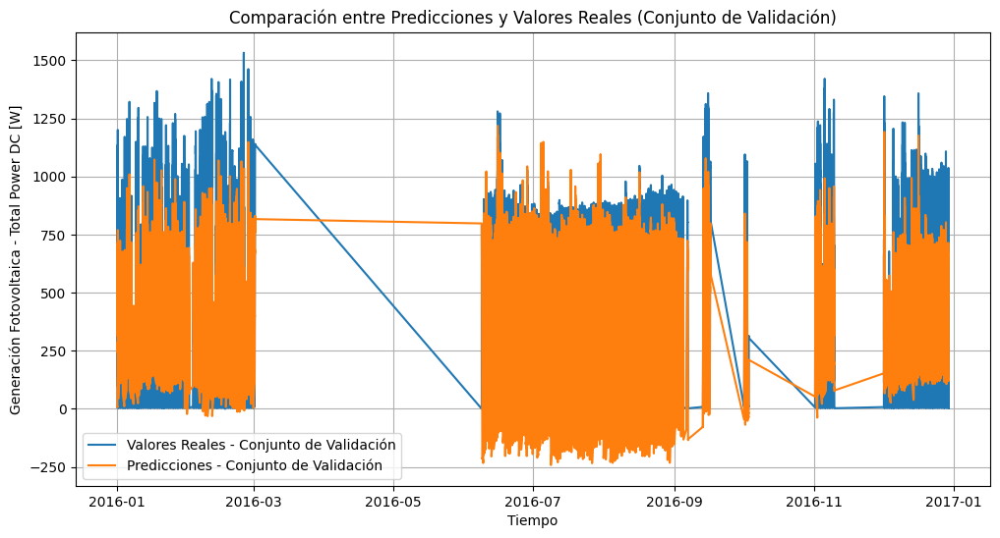

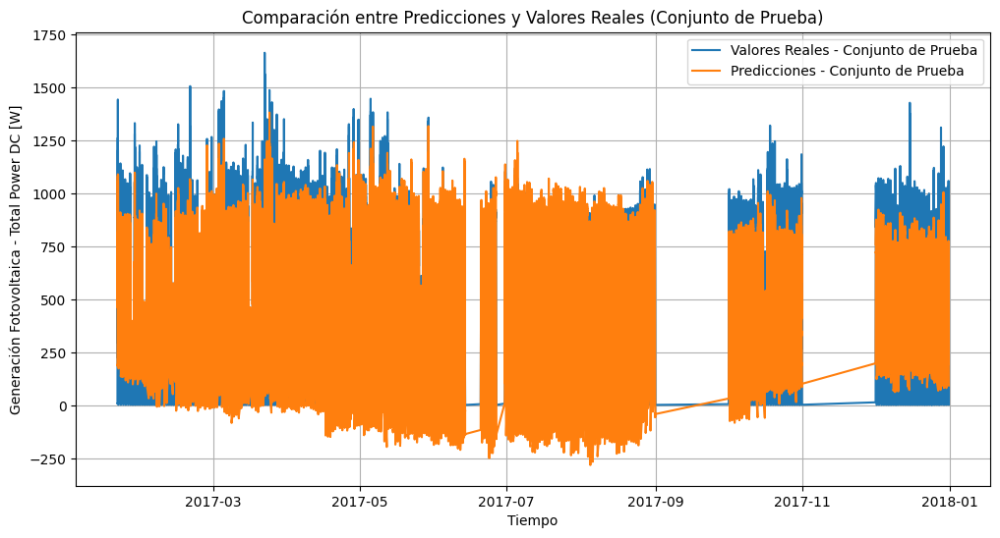

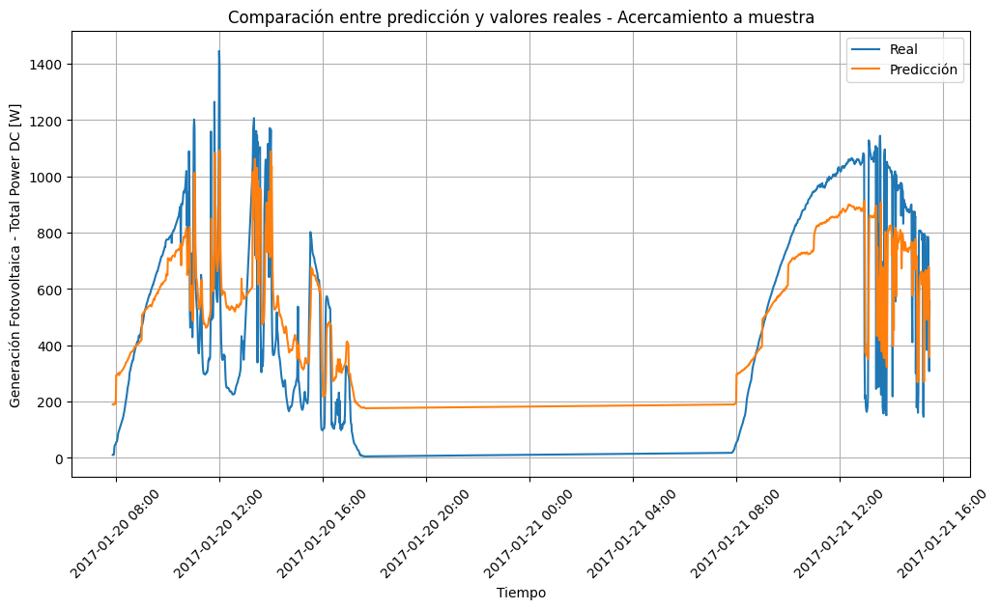

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import matplotlib.dates as mdates


std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

# Normalizacion de las variables de los conjuntos de entrenamiento, validacion y prueba

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo de regresion

regresion_multivariable = LinearRegression()
regresion_multivariable.fit(X_train_esc, y_train_esc)

# Predicciones de generacion electrica fotovoltaica para los tres conjuntos

y_train_pred = regresion_multivariable.predict(X_train_esc)
y_val_pred = regresion_multivariable.predict(X_val_esc)
y_test_pred2017 = regresion_multivariable.predict(X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_train_pred)
y_val_pred_rev = std_y.inverse_transform(y_val_pred)
y_test_pred2017_rev = std_y.inverse_transform(y_test_pred2017)


# Evaluación del modelo de regresion en el conjunto de entrenamiento

mse_train = mean_squared_error(y_train, y_train_pred_rev)
mae_train = mean_absolute_error(y_train, y_train_pred_rev)
r2_train = r2_score(y_train, y_train_pred_rev)

# Evaluación del modelo de regresion en el conjunto de validacion

mse_val = mean_squared_error(y_val, y_val_pred_rev)
mae_val = mean_absolute_error(y_val, y_val_pred_rev)
r2_val = r2_score(y_val, y_val_pred_rev)

# Evaluación del modelo de regresion en el conjunto de prueba

mse_test = mean_squared_error(y_test2017, y_test_pred2017_rev)
mae_test = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_test = r2_score(y_test2017, y_test_pred2017_rev)


print(f"Evaluacion del modelo en el conjunto de entrenamiento:")
print(f"MSE: {mse_train}, MAE: {mae_train}, R2: {r2_train}")

print(f"Evaluacion del modelo en el conjunto de validacion:")
print(f"MSE: {mse_val}, MAE: {mae_val}, R2: {r2_val}")

print(f"Evaluacion del modelo en el conjunto de prueba:")
print(f"MSE: {mse_test}, MAE: {mae_test}, R2: {r2_test}")

# Graficas de las predicciones vs valores reales


y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Validacion

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()


**4.2. Algoritmo Random Forest**

In [ ]:
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestRegressor
from scipy.stats import randint
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.tree import DecisionTreeRegressor
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from keras.layers import Input

**Random Search**

In [ ]:
model = RandomForestRegressor(random_state=42)
param_dist = {
    'n_estimators': randint(10, 40),
    'max_depth': [None, 10, 20],
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 10),
    'bootstrap': [True, False]
}
tscv = TimeSeriesSplit(n_splits=3)

rnd_regres = RandomizedSearchCV(model, param_distributions=param_dist, n_iter=20, cv=tscv, scoring='neg_mean_squared_error', random_state=42, n_jobs=-1)
rnd_regres.fit(X_train, y_train)
print("Mejores hiperparámetros encontrados:", rnd_regres.best_params_)
best_random = rnd_regres.best_estimator_
best_random.fit(X=X_train, y=y_train)
y_pred_random=best_random.predict(X=X_val)

mae = mean_absolute_error(y_val, y_pred_random)
print ('MAE', mae)



Mejores hiperparámetros encontrados: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 4, 'min_samples_split': 9, 'n_estimators': 33}
MAE 90.69461957877937


**4.2.1. Algoritmo Random Forest - Modelo 1**

MAE ENTRENAMIENTO RANDOM FOREST 17.766706863471455
R2 ENTRENAMIENTO RANDOM FOREST 0.9809488926255638
MAE VALIDACION RANDOM FOREST 98.30516458950636
R2 VALIDACION RANDOM FOREST 0.8095440588065836
MAE TEST RANDOM RANDOM FOREST 92.1682377808444
R2 TEST RANDOM RANDOM FOREST 0.8438630493040387


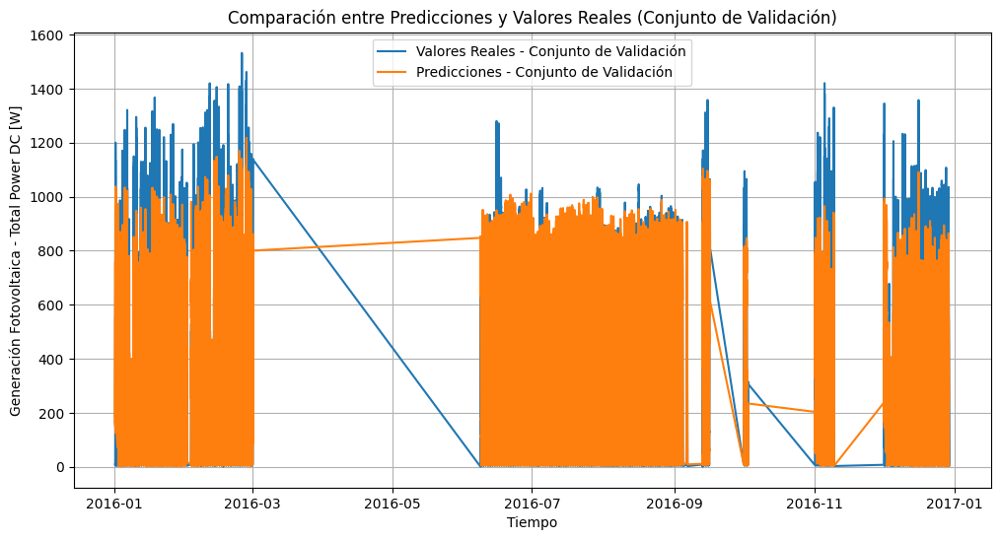

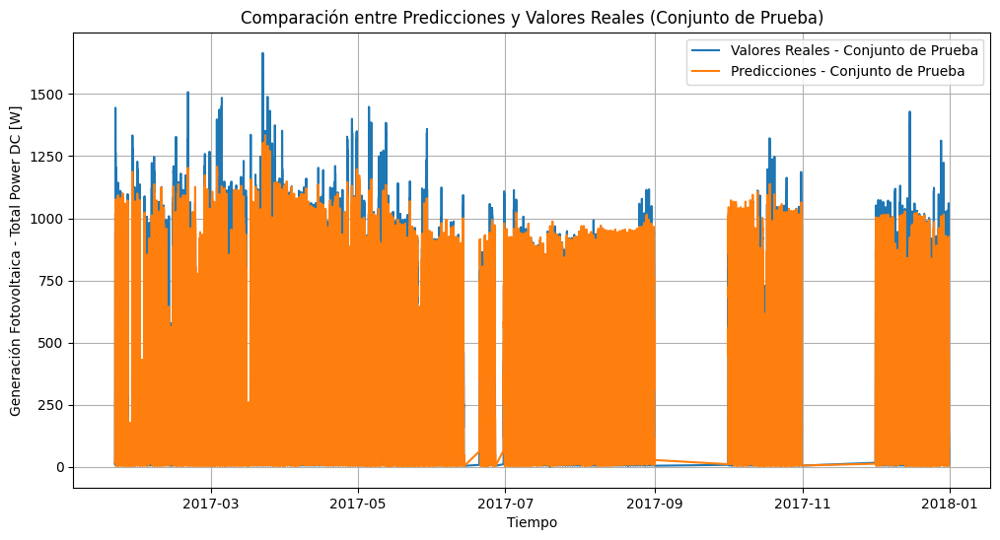

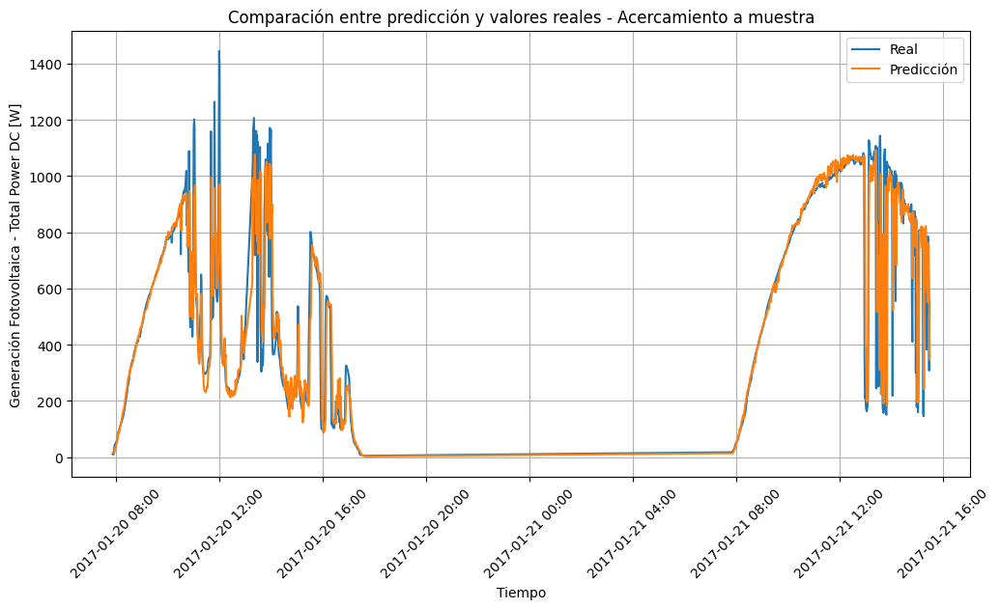

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= None,
                                  min_samples_leaf= 4,
                                  min_samples_split= 9,
                                  n_estimators = 33)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**Grid Search**

In [ ]:
model = RandomForestRegressor(random_state=42)

param_dist3 = {
    'n_estimators': [33,41],
    'max_depth': [None],
    'min_samples_split': [9,11],
    'min_samples_leaf': [4,11],
    'bootstrap': [True]
 }
tscv = TimeSeriesSplit(n_splits=3)
grid_regres = GridSearchCV(model, param_grid=param_dist3, cv=tscv, scoring='neg_mean_squared_error', n_jobs=-1)
grid_regres.fit(X_train, y_train)
print("Mejores hiperparámetros encontrados:", grid_regres.best_params_)
best_grid = grid_regres.best_estimator_
best_grid.fit(X=X_train, y=y_train)
y_pred_grid=best_grid.predict(X=X_val)
y_pred_gridtest=best_grid.predict(X=X_test2017)

mae_val_rf = mean_absolute_error(y_val, y_pred_grid)
mae_test_rf = mean_absolute_error(y_test2017, y_pred_gridtest)
r2_val_RF = r2_score(y_val, y_pred_grid)
r2_test_RF = r2_score(y_test2017, y_pred_gridtest)

print ('MAE VALIDACION RANDOM FOREST', mae_val_rf)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM FOREST', mae_test_rf)
print ('R2 TEST RANDOM FOREST', r2_test_RF)

###{'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 4, 'min_samples_split': 9, 'n_estimators': 33}

Mejores hiperparámetros encontrados: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 4, 'min_samples_split': 9, 'n_estimators': 41}
MAE 90.61179507146576


**4.2.2. Algoritmo Random Forest - Modelo 2**

MAE ENTRENAMIENTO RANDOM FOREST 17.66114450206251
R2 ENTRENAMIENTO RANDOM FOREST 0.9810778036433292
MAE VALIDACION RANDOM FOREST 98.78876450199378
R2 VALIDACION RANDOM FOREST 0.8079259930865623
MAE TEST RANDOM RANDOM FOREST 92.17324653668422
R2 TEST RANDOM RANDOM FOREST 0.8440572111795588


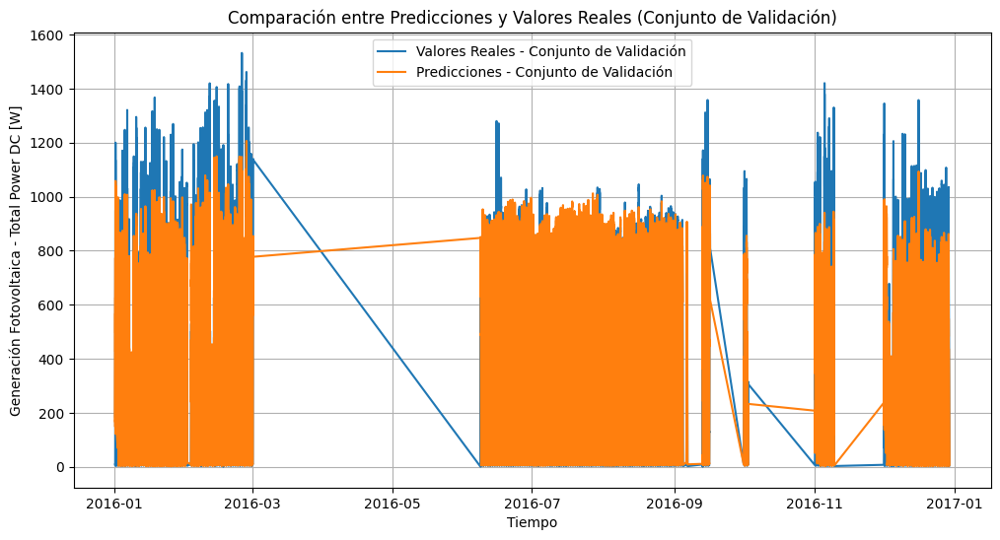

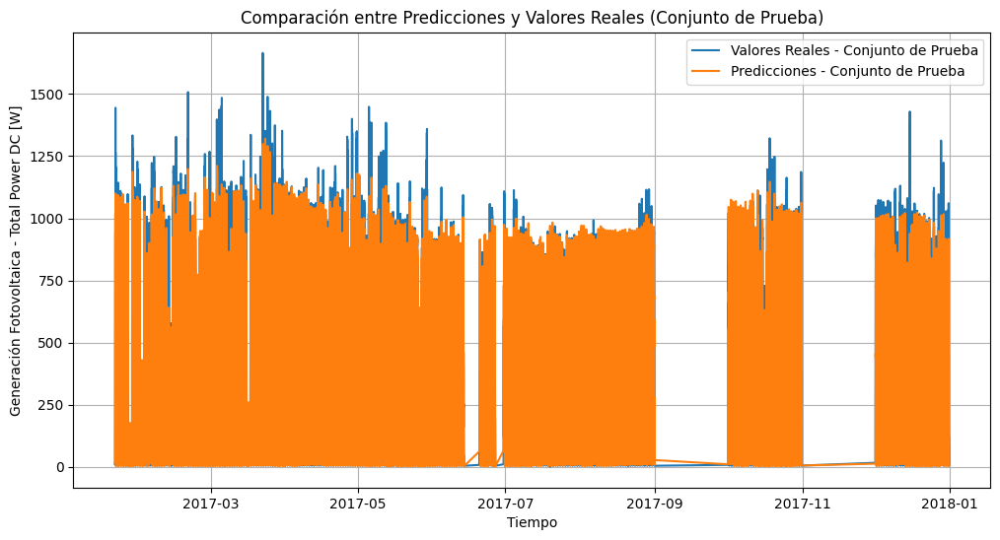

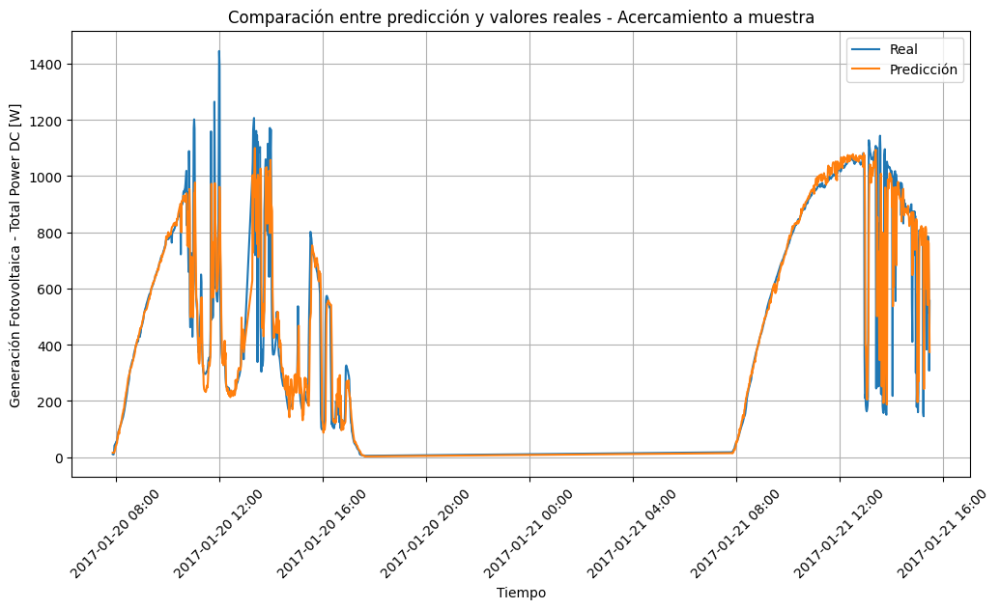

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= None,
                                  min_samples_leaf= 4,
                                  min_samples_split= 9,
                                  n_estimators = 41)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Se Tomaron los datos más recientes para el conjunto de entrenamiento
n = len(X_train)
recent_data_size = int(n * 0.40)
X_train_recent = X_train[-recent_data_size:]
y_train_recent = y_train[-recent_data_size:]

In [ ]:
model = RandomForestRegressor(random_state=42)
param_dist2 = {
    'n_estimators': randint(120, 170),
    'max_depth': [None, 25,50],
    'min_samples_split': randint(12, 30),
    'min_samples_leaf': randint(4, 16),
    'bootstrap': [True, False]
}
tscv = TimeSeriesSplit(n_splits=5)

rnd_regres2 = RandomizedSearchCV(model, param_distributions=param_dist2, n_iter=35, cv=tscv, scoring='neg_mean_squared_error', random_state=42, n_jobs=-1)

rnd_regres2.fit(X_train_recent, y_train_recent)
print("Mejores hiperparámetros encontrados:", rnd_regres2.best_params_)

Mejores hiperparámetros encontrados: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 7, 'min_samples_split': 15, 'n_estimators': 149}


**4.2.3. Algoritmo Random Forest - Modelo 3**

MAE ENTRENAMIENTO RANDOM FOREST 21.336410598754675
R2 ENTRENAMIENTO RANDOM FOREST 0.9741133928701418
MAE VALIDACION RANDOM FOREST 97.30369823067544
R2 VALIDACION RANDOM FOREST 0.8096011067907044
MAE TEST RANDOM RANDOM FOREST 91.64903560719694
R2 TEST RANDOM RANDOM FOREST 0.8458311728784146


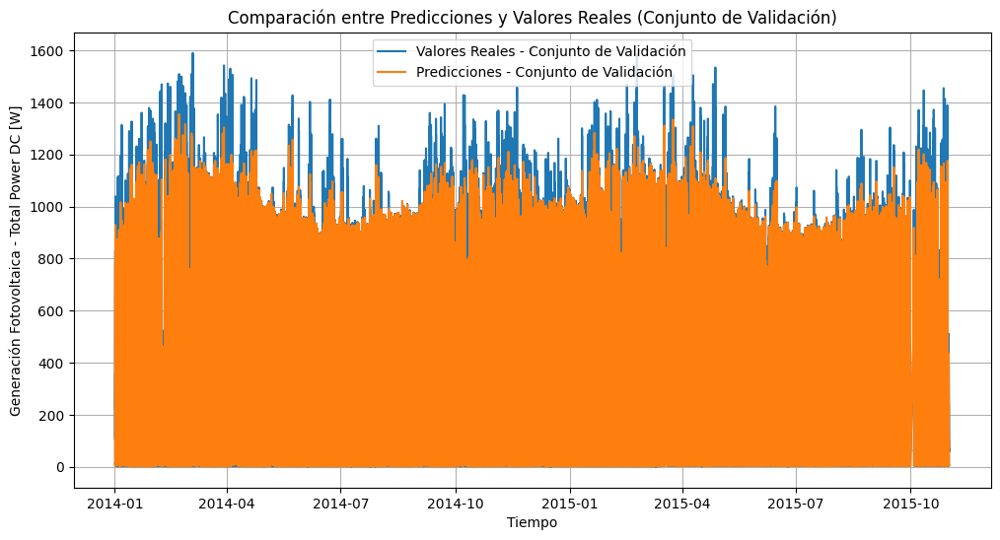

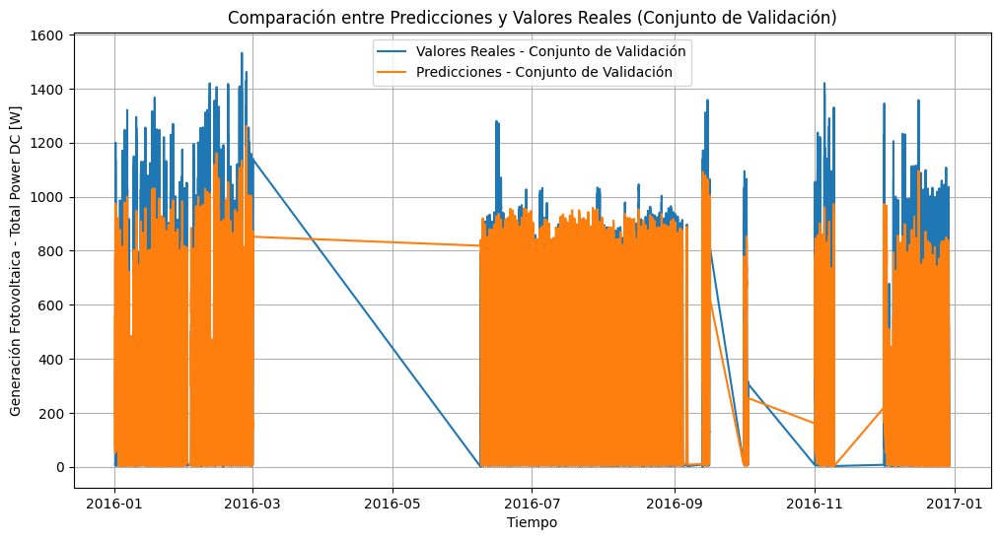

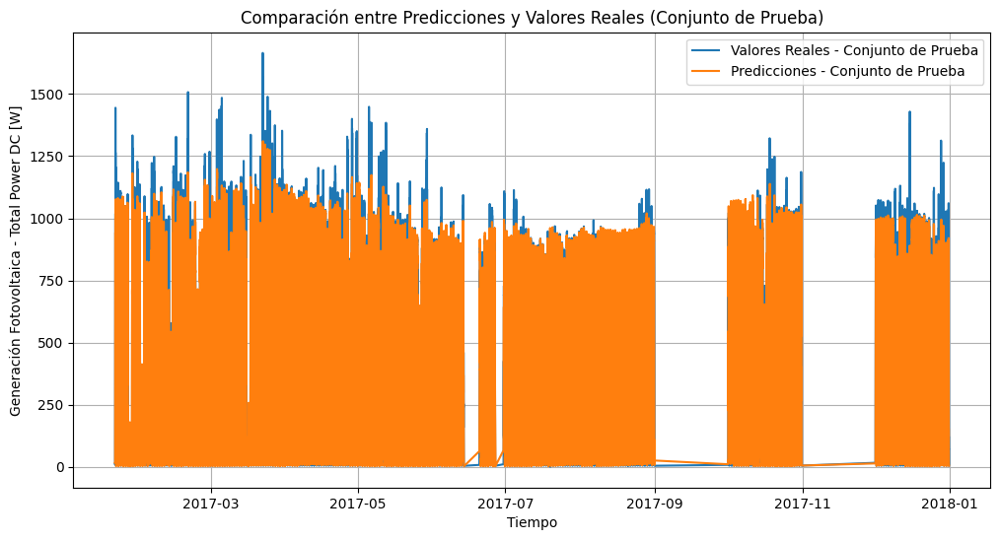

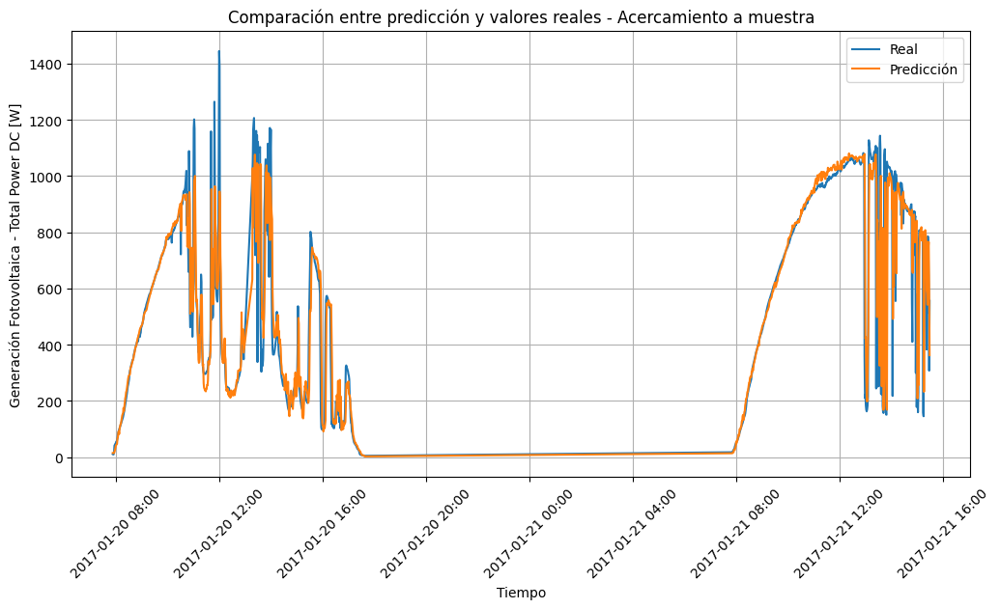

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= None,
                                  min_samples_leaf= 7,
                                  min_samples_split= 15,
                                  n_estimators = 149)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.2.4. Algoritmo Random Forest - Modelo 4**

MAE ENTRENAMIENTO RANDOM FOREST 29.235084455077942
R2 ENTRENAMIENTO RANDOM FOREST 0.9657282175840721
MAE VALIDACION RANDOM FOREST 97.85058222789299
R2 VALIDACION RANDOM FOREST 0.8071516357663931
MAE TEST RANDOM RANDOM FOREST 90.58195210906663
R2 TEST RANDOM RANDOM FOREST 0.8477586955359461


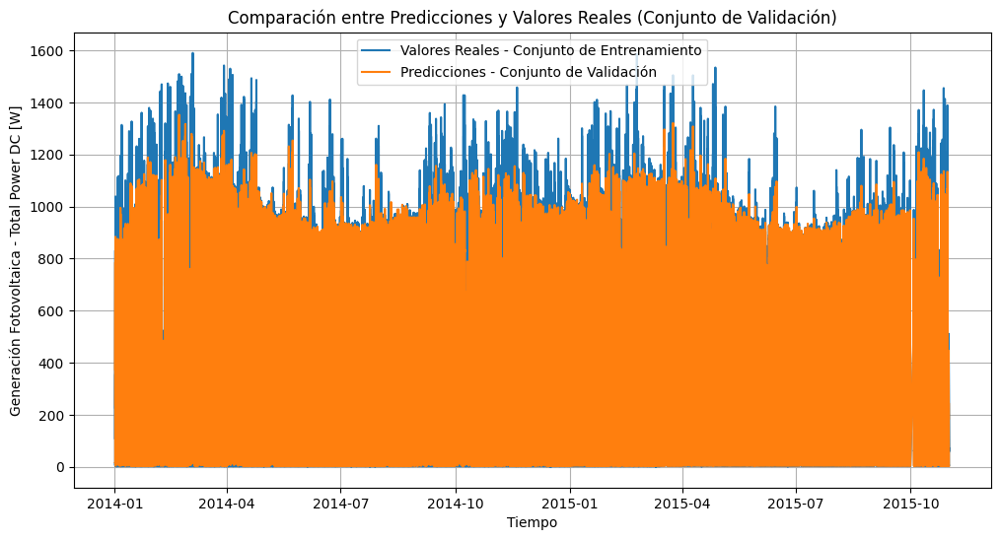

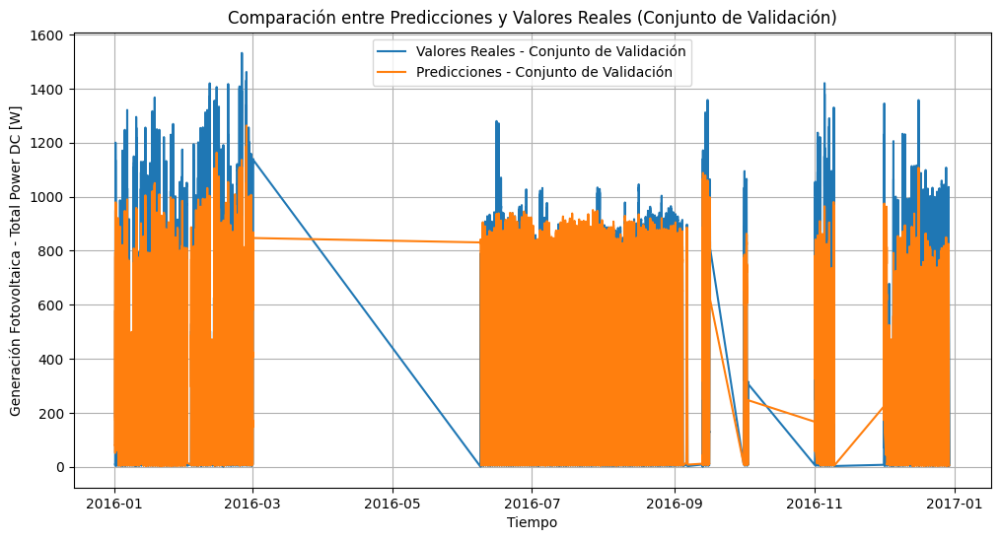

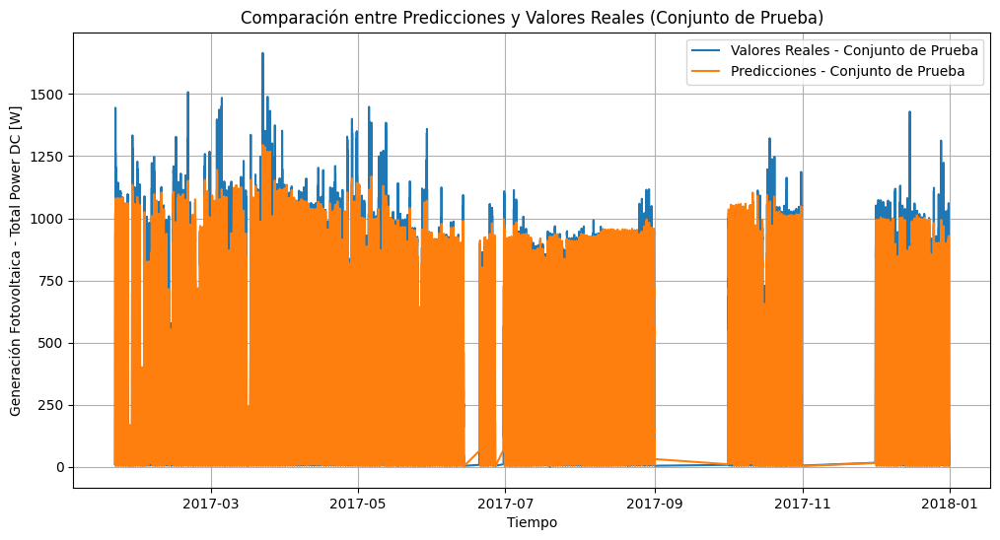

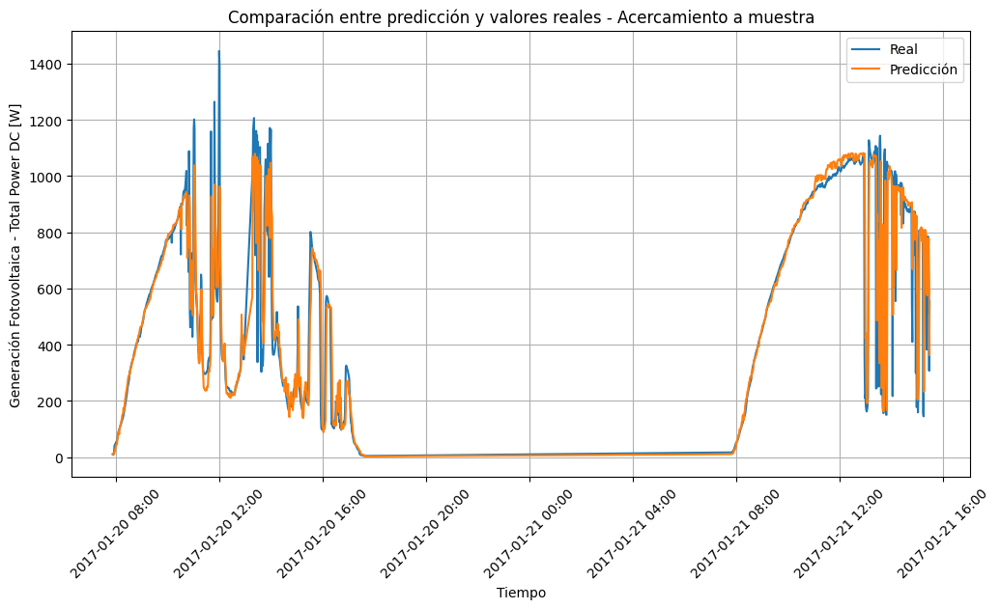

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= 15,
                                  min_samples_leaf= 7,
                                  min_samples_split= 15,
                                  n_estimators = 160)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.2.5. Algoritmo Random Forest - Modelo 5**

MAE ENTRENAMIENTO RANDOM FOREST 23.843353444961295
R2 ENTRENAMIENTO RANDOM FOREST 0.9694308547451644
MAE VALIDACION RANDOM FOREST 97.20278267571472
R2 VALIDACION RANDOM FOREST 0.8076829921067009
MAE TEST RANDOM RANDOM FOREST 90.95491249190493
R2 TEST RANDOM RANDOM FOREST 0.8477707171457194


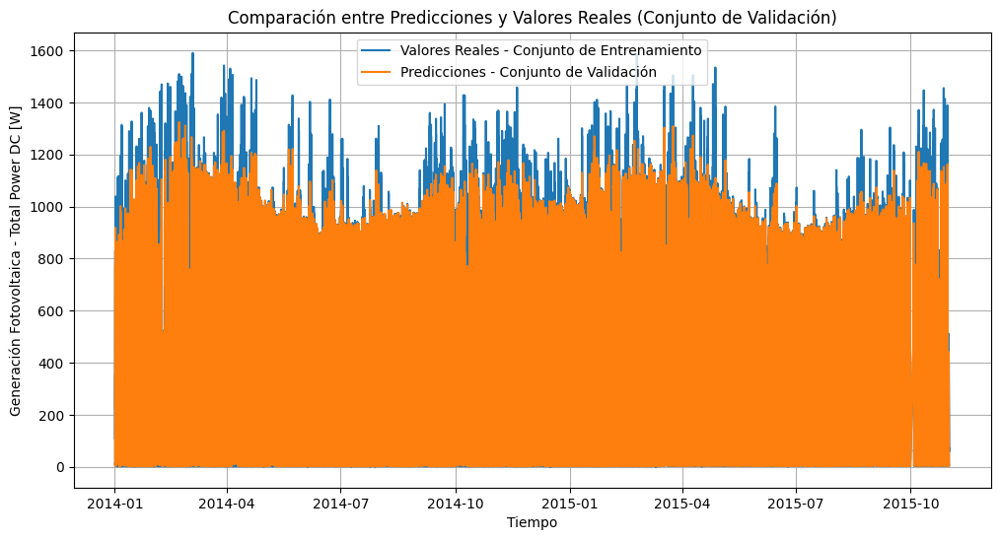

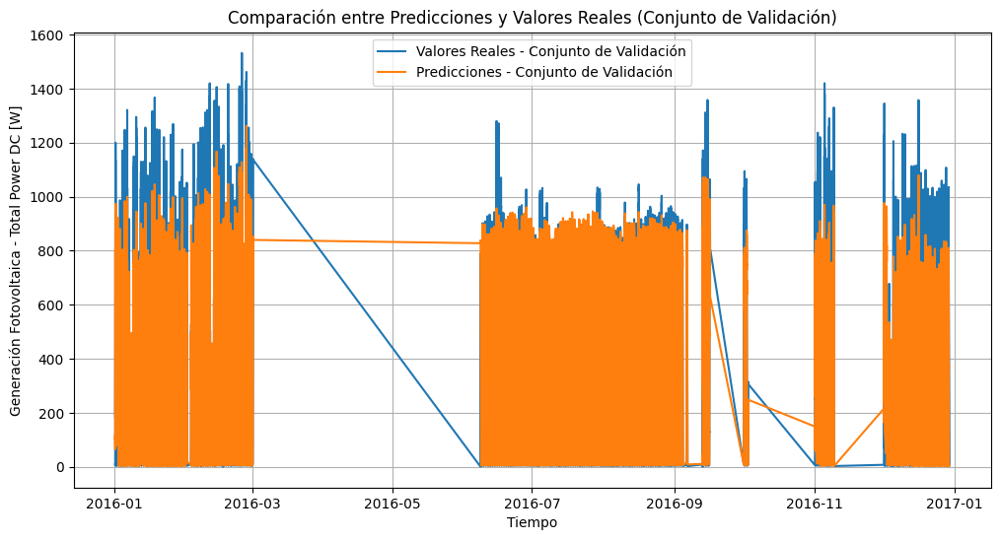

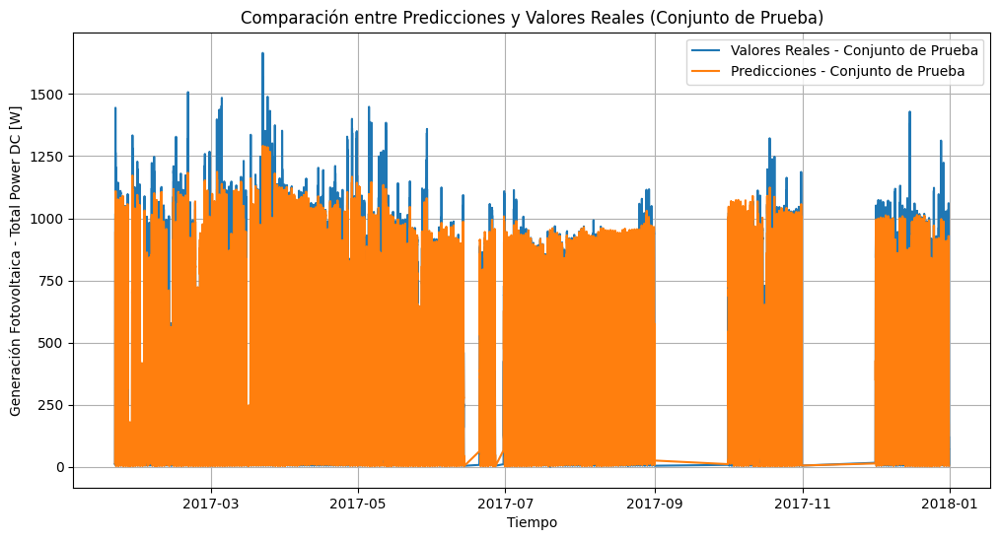

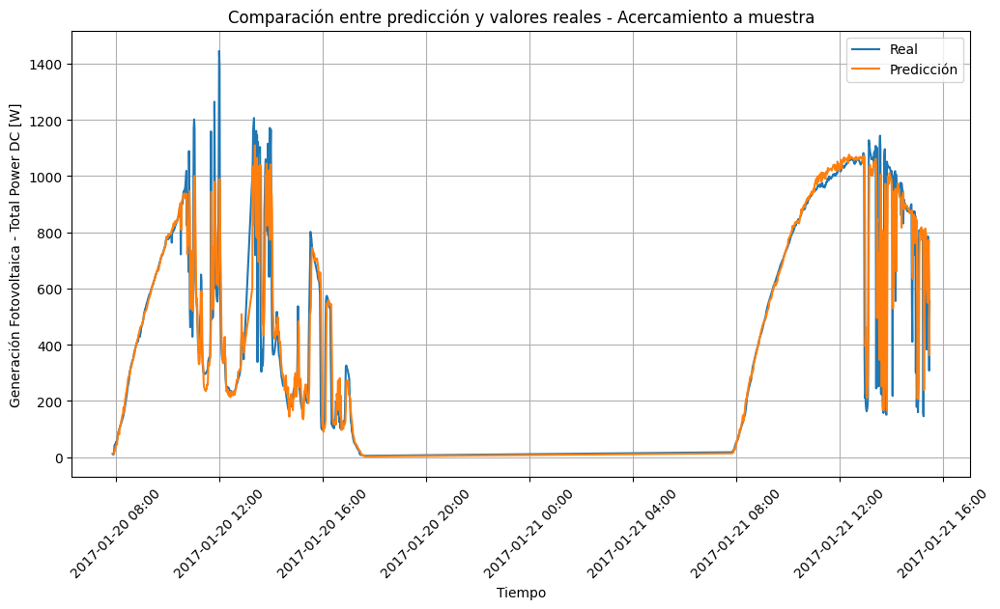

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= 30,
                                  min_samples_leaf= 10,
                                  min_samples_split= 15,
                                  n_estimators = 210)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Modelo 4 considerando la eliminación de la variable Ultraviolet [W/m2]

MAE ENTRENAMIENTO RANDOM FOREST 24.24836724424781
R2 ENTRENAMIENTO RANDOM FOREST 0.9687456002180909
MAE VALIDACION RANDOM FOREST 98.9777034396449
R2 VALIDACION RANDOM FOREST 0.7994722008542201
MAE TEST RANDOM RANDOM FOREST 88.74697031388176
R2 TEST RANDOM RANDOM FOREST 0.8502427352994764


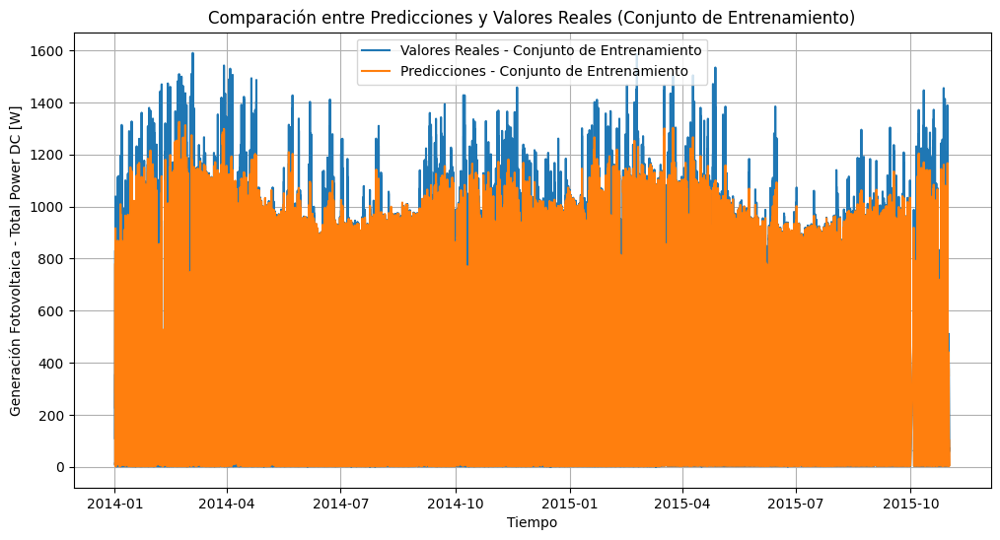

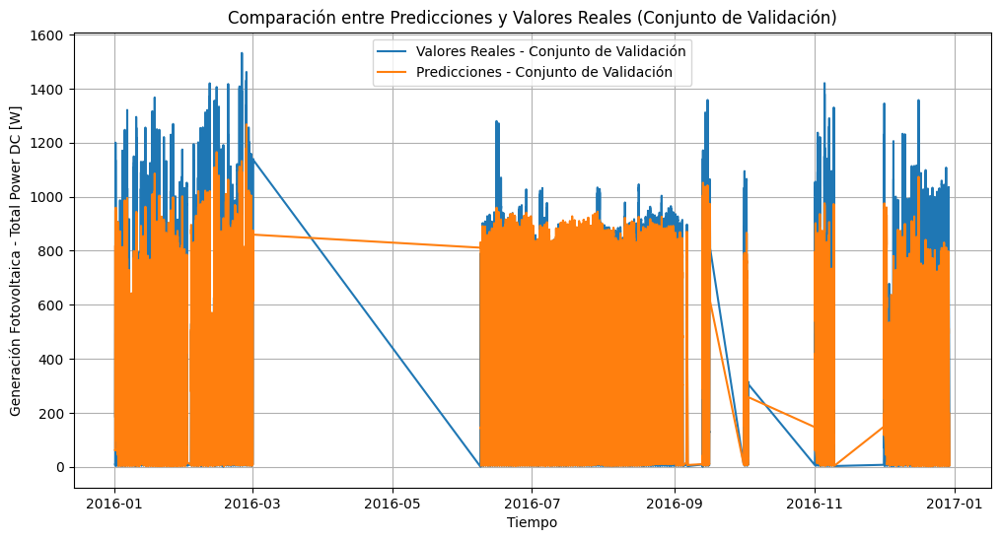

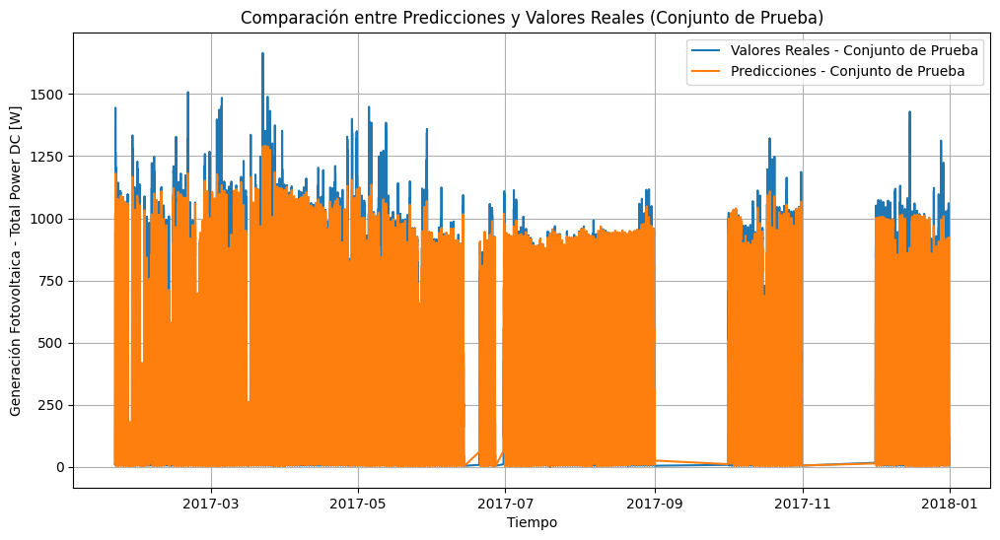

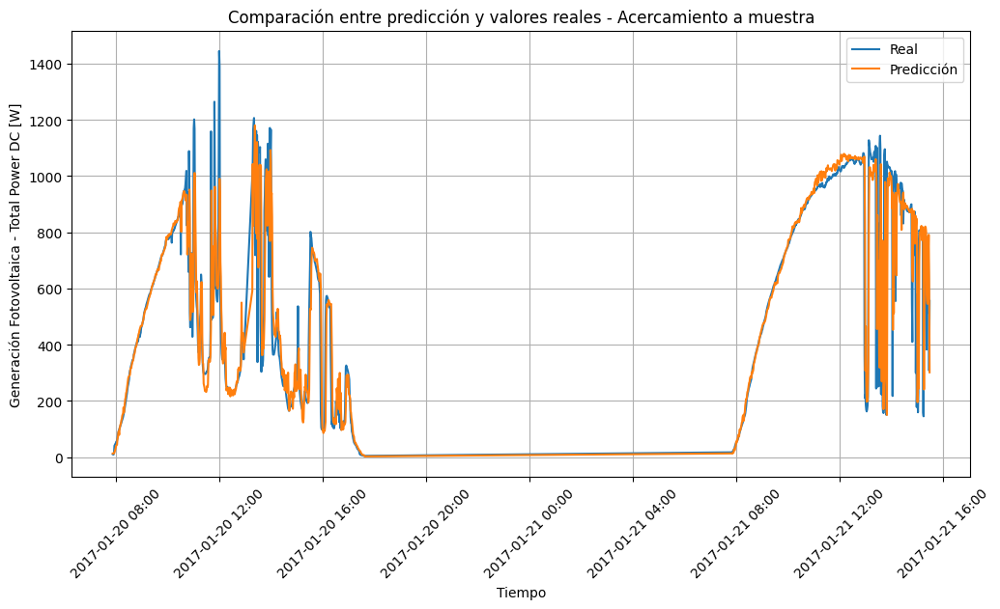

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_su)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= 30,
                                  min_samples_leaf= 10,
                                  min_samples_split= 15,
                                  n_estimators = 210)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Prediccion solo de la primera semana del 2017

MAE ENTRENAMIENTO RANDOM FOREST 24.24836724424781
R2 ENTRENAMIENTO RANDOM FOREST 0.9687456002180909
MAE VALIDACION RANDOM FOREST 98.9777034396449
R2 VALIDACION RANDOM FOREST 0.7994722008542201
MAE TEST RANDOM RANDOM FOREST 46.261055885721646
R2 TEST RANDOM RANDOM FOREST 0.92663620167084


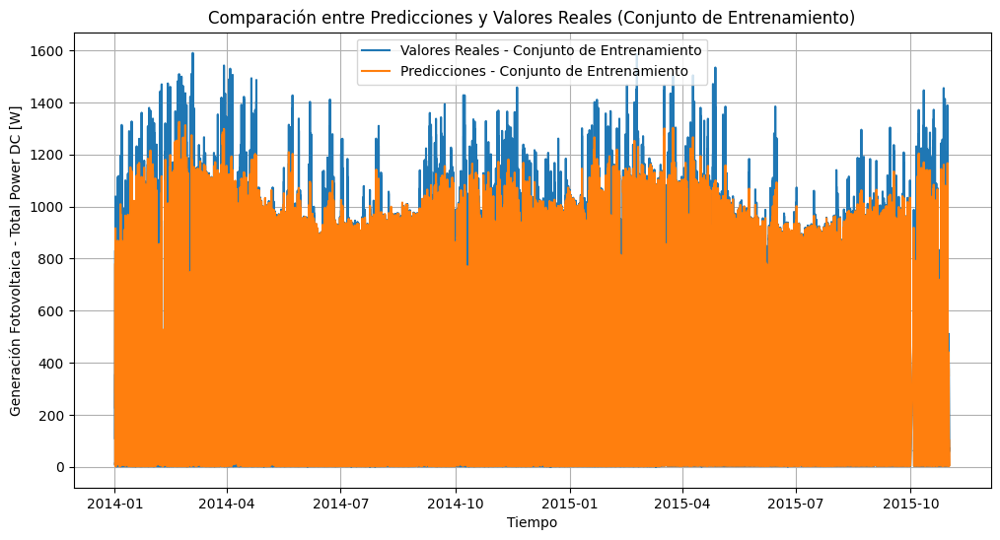

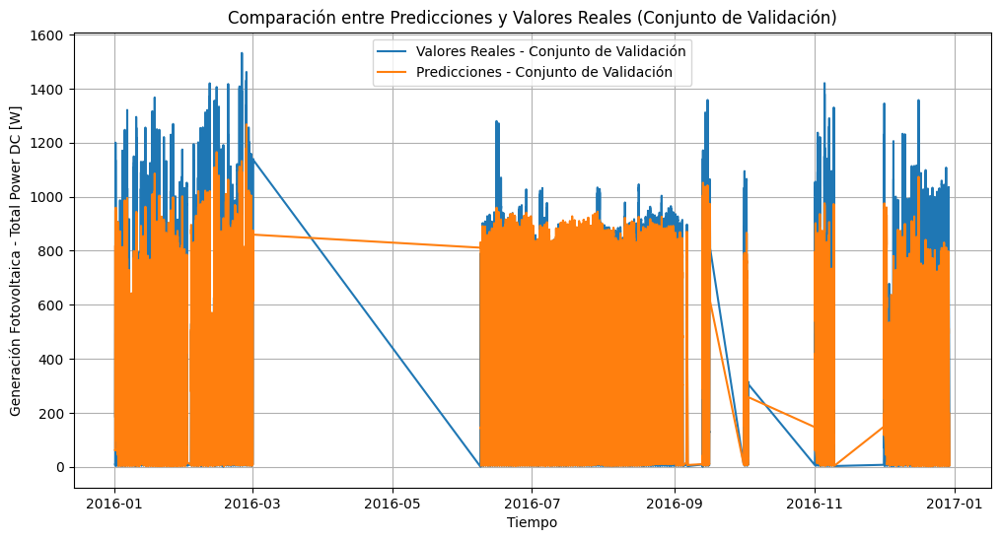

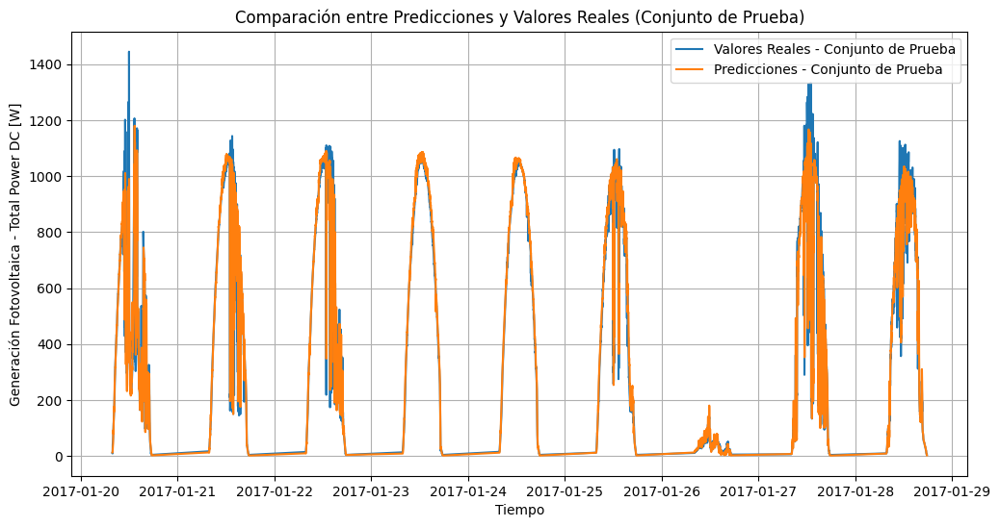

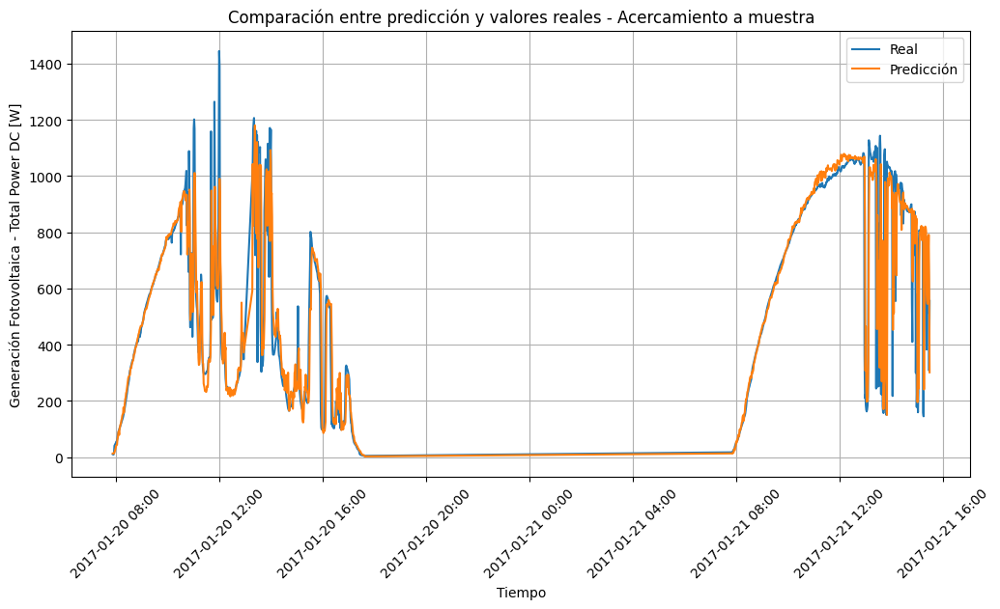

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_sus1)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017_s1.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= 30,
                                  min_samples_leaf= 10,
                                  min_samples_split= 15,
                                  n_estimators = 210)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017_s1, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017_s1, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017_s1.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

MAE ENTRENAMIENTO RANDOM FOREST 23.843353444961295
R2 ENTRENAMIENTO RANDOM FOREST 0.9694308547451644
MAE VALIDACION RANDOM FOREST 97.20278267571472
R2 VALIDACION RANDOM FOREST 0.8076829921067009
MAE TEST RANDOM RANDOM FOREST 44.74862291820456
R2 TEST RANDOM RANDOM FOREST 0.9289835898206353


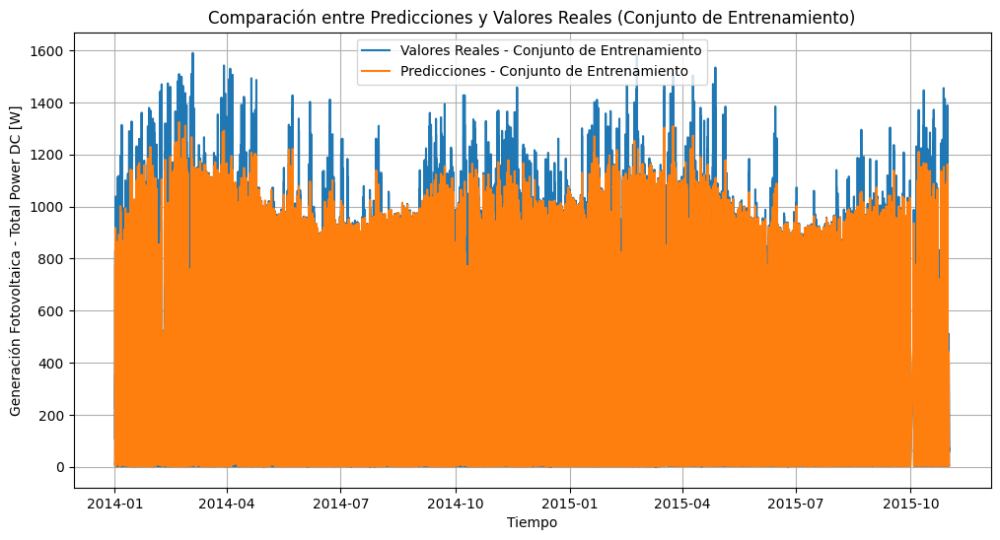

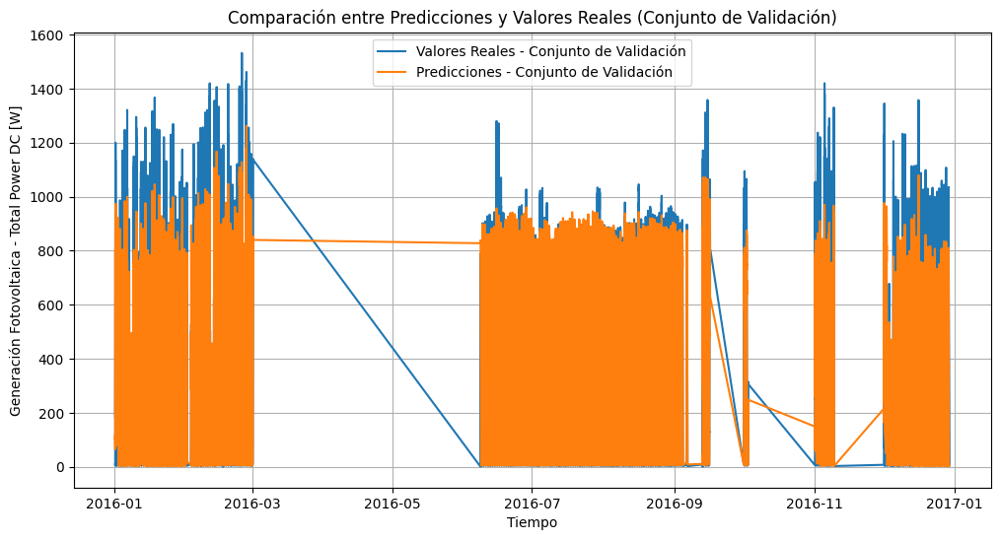

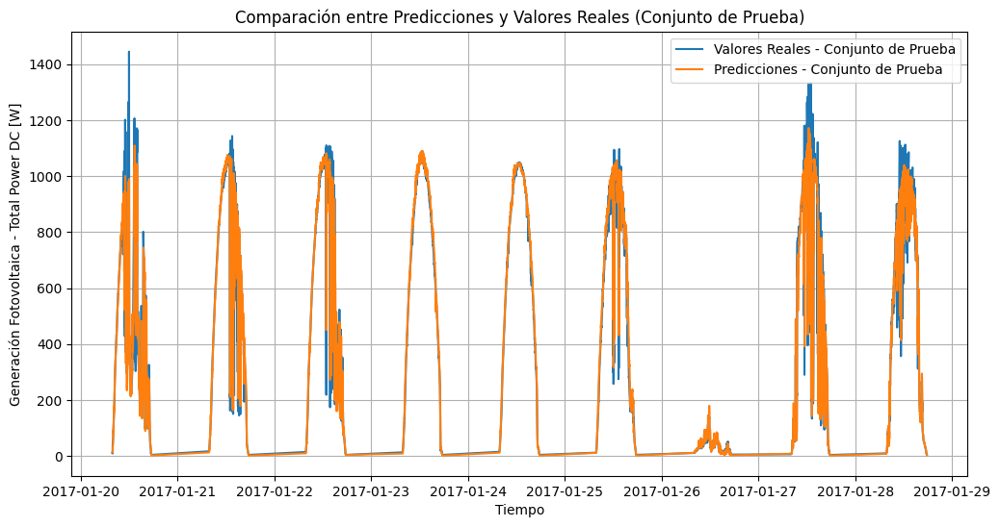

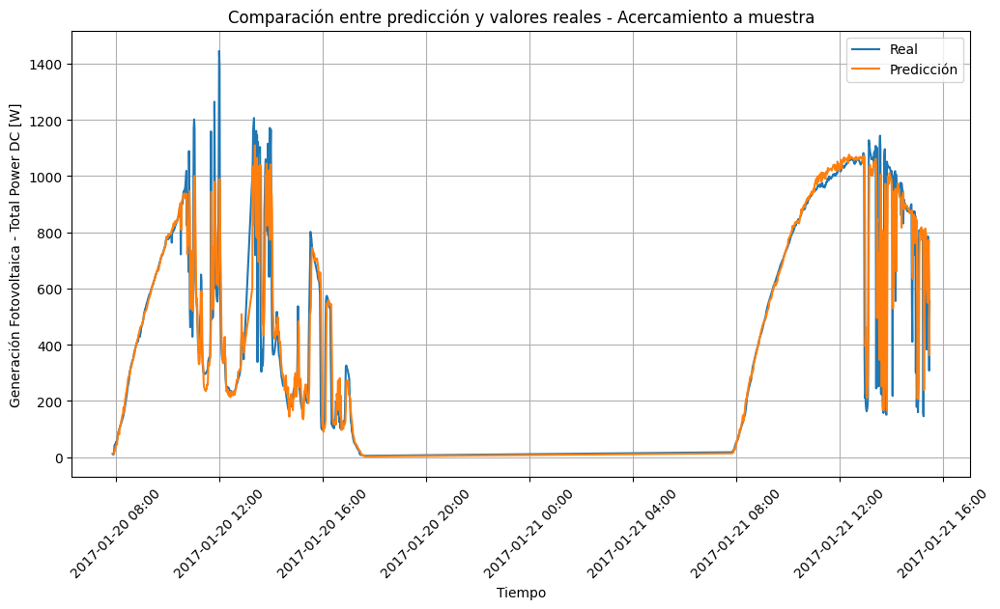

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017_s1)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017_s1.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= 30,
                                  min_samples_leaf= 10,
                                  min_samples_split= 15,
                                  n_estimators = 210)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017_s1, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017_s1, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017_s1.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

MAE ENTRENAMIENTO RANDOM FOREST 23.843353444961295
R2 ENTRENAMIENTO RANDOM FOREST 0.9694308547451644
MAE VALIDACION RANDOM FOREST 97.20278267571472
R2 VALIDACION RANDOM FOREST 0.8076829921067009
MAE TEST RANDOM RANDOM FOREST 57.13856283466983
R2 TEST RANDOM RANDOM FOREST 0.9100345832230736


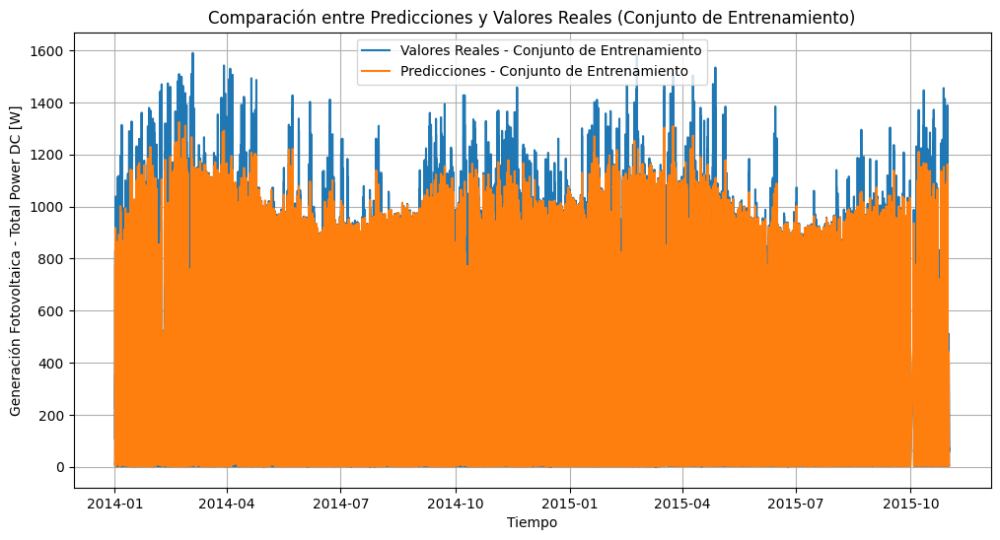

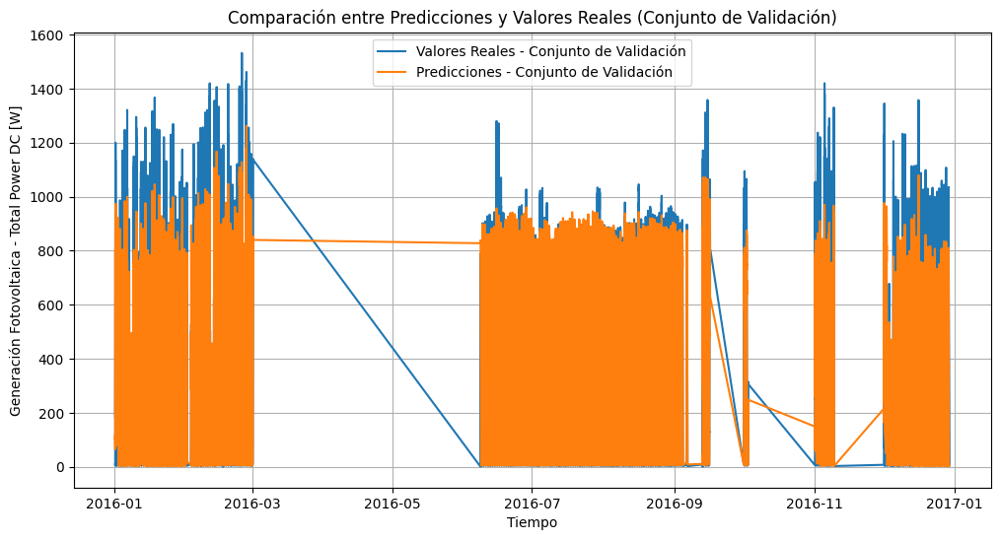

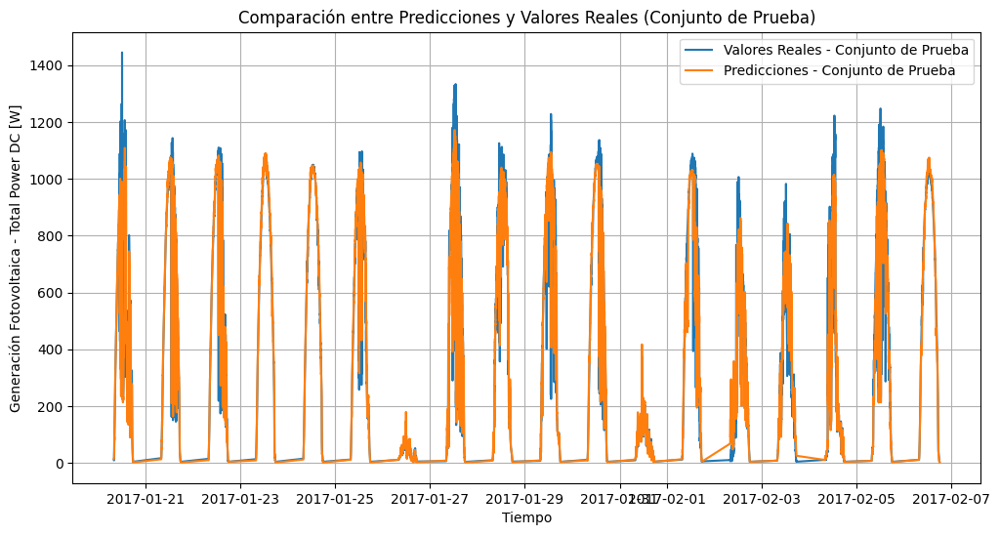

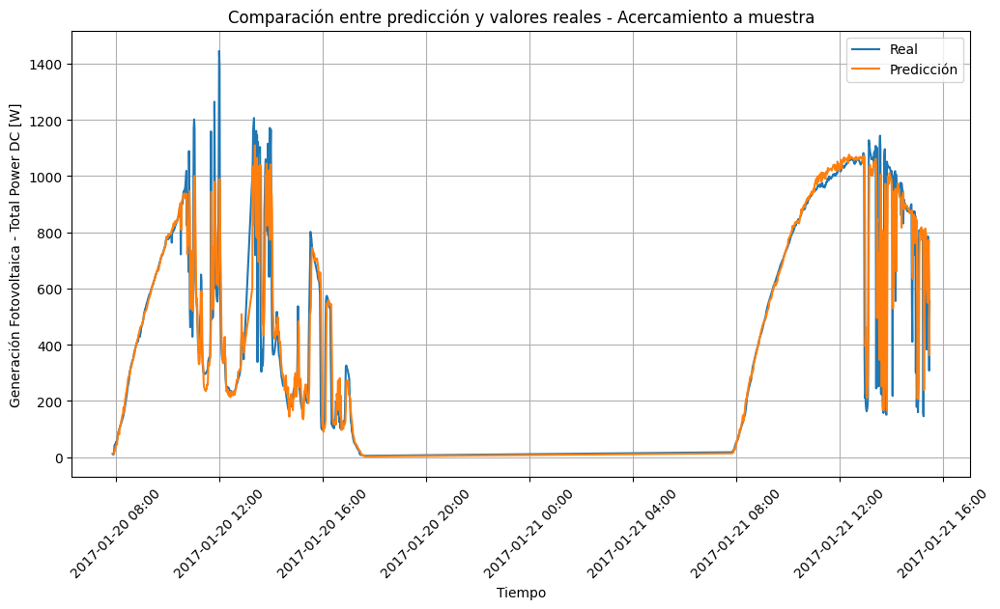

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates


X_train.columns = X_train.columns.str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8')
X_val.columns = X_val.columns.str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8')
X_test2017_s2.columns = X_test2017_s2.columns.str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8')

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017_s2)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017_s2.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

random_forest = RandomForestRegressor(random_state=42,
                                  bootstrap= True,
                                  max_depth= 30,
                                  min_samples_leaf= 10,
                                  min_samples_split= 15,
                                  n_estimators = 210)

random_forest.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_RF_train_esc = random_forest.predict(X=X_train_esc)
y_pred_RF_val_esc = random_forest.predict(X=X_val_esc)
y_pred_RF_test_esc = random_forest.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_RF_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_RF_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_RF_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_RF = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_RF = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_RF = mean_absolute_error(y_test2017_s2, y_test_pred2017_rev)
r2_train_RF = r2_score(y_train, y_train_pred_rev)
r2_val_RF = r2_score(y_val, y_val_pred_rev)
r2_test_RF = r2_score(y_test2017_s2, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO RANDOM FOREST', mae_train_RF)
print ('R2 ENTRENAMIENTO RANDOM FOREST', r2_train_RF)
print ('MAE VALIDACION RANDOM FOREST', mae_val_RF)
print ('R2 VALIDACION RANDOM FOREST', r2_val_RF)
print ('MAE TEST RANDOM RANDOM FOREST', mae_test_RF)
print ('R2 TEST RANDOM RANDOM FOREST', r2_test_RF)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017_s2.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s2, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s2[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.3 Algoritmo Arbol de decisión**

**Random Search**

In [ ]:
from sklearn.tree import DecisionTreeRegressor

model_tree = DecisionTreeRegressor(random_state=42)
param_dist2 = {
    'max_depth': [None, 20,30,40],
    'min_samples_split': randint(9, 15),
    'min_samples_leaf': randint(4, 15),
    'criterion': ['squared_error', 'friedman_mse', 'absolute_error']
}
tscv = TimeSeriesSplit(n_splits=5)

rnd_regres2 = RandomizedSearchCV(model_tree, param_distributions=param_dist2, n_iter=50, cv=tscv, scoring='neg_mean_squared_error', random_state=42, n_jobs=-1)

rnd_regres2.fit(X_train_recent, y_train_recent)
print("Mejores hiperparámetros encontrados:", rnd_regres2.best_params_)

Mejores hiperparámetros encontrados: {'criterion': 'absolute_error', 'max_depth': 40, 'min_samples_leaf': 14, 'min_samples_split': 13}


MAE ENTRENAMIENTO DECISION TREE 30.053778037013473
R2 ENTRENAMIENTO DECISION TREE 0.9404015849004078
MAE VALIDACION DECISION TREE 124.69384295725447
R2 VALIDACION DECISION TREE 0.6878317276453803
MAE TEST DECISION TREE 99.61908645891855
R2 TEST DECISION TREE 0.7920263854729809


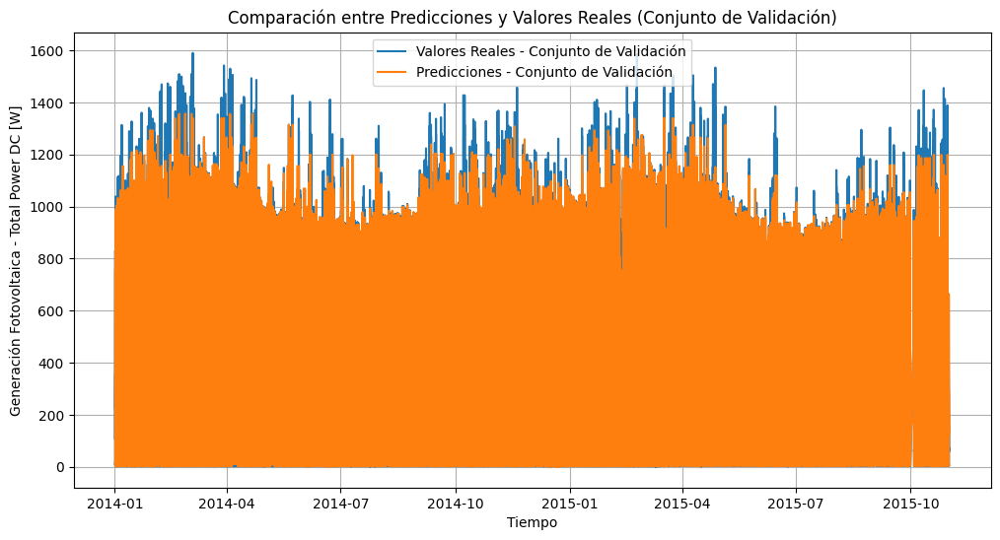

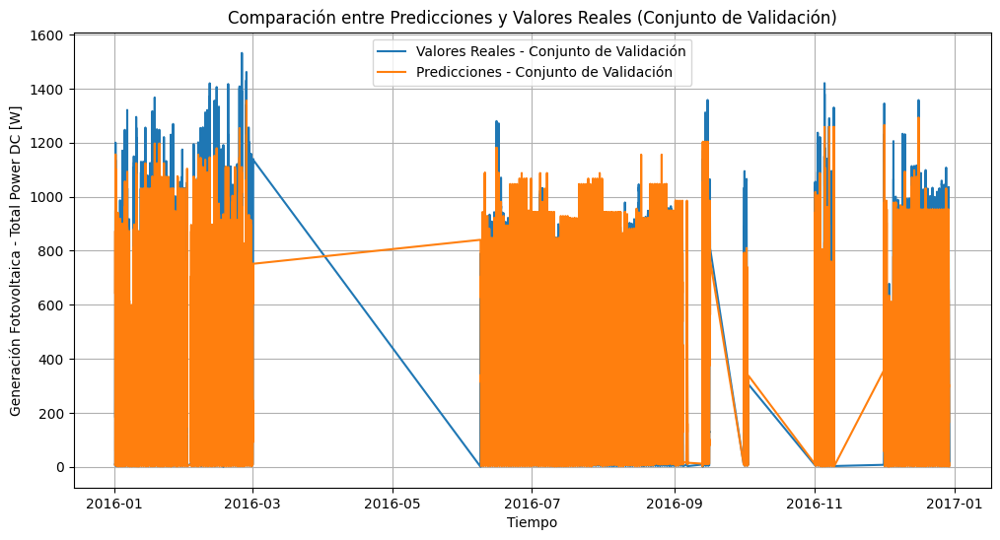

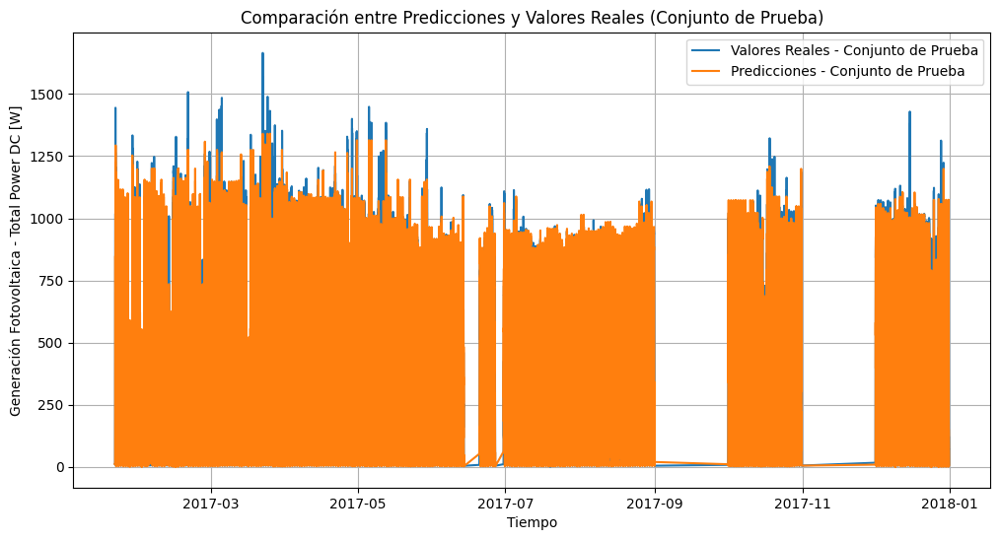

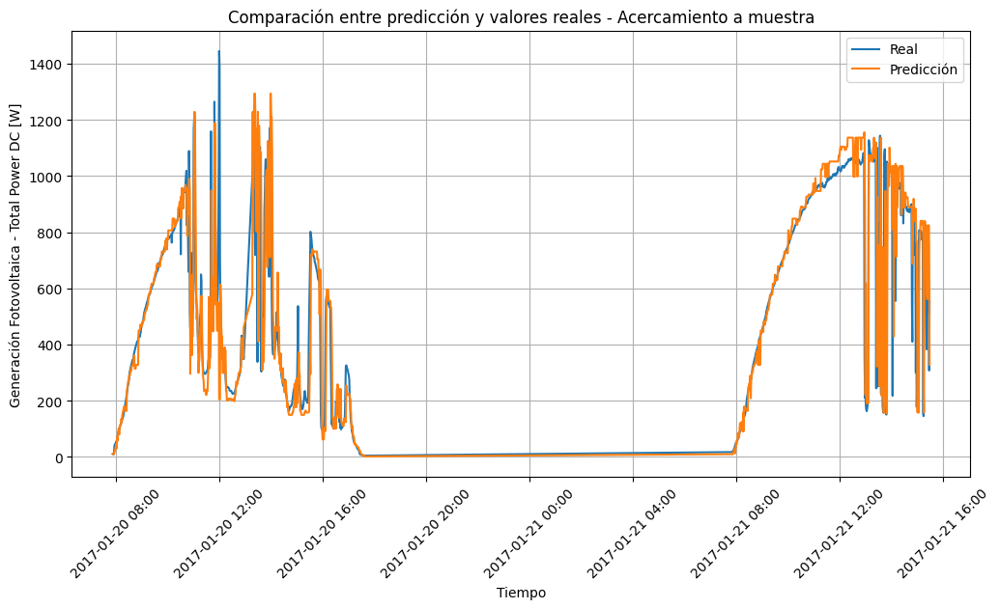

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.stats import randint
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjuto de entrenamiento al modelo

model_dt = DecisionTreeRegressor(random_state=42,
                                  criterion= 'absolute_error',
                                  max_depth= 40,
                                  min_samples_leaf= 14,
                                  min_samples_split= 13,
                                  )

model_dt.fit(X_train_esc, y_train_esc.ravel())

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_DT_train_esc = model_dt.predict(X=X_train_esc)
y_pred_DT_val_esc = model_dt.predict(X=X_val_esc)
y_pred_DT_test_esc = model_dt.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_train_pred_rev = std_y.inverse_transform(y_pred_DT_train_esc.reshape(-1, 1))
y_val_pred_rev = std_y.inverse_transform(y_pred_DT_val_esc.reshape(-1, 1))
y_test_pred2017_rev = std_y.inverse_transform(y_pred_DT_test_esc.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento, validación y prueba

mae_train_DT = mean_absolute_error(y_train, y_train_pred_rev)
mae_val_DT = mean_absolute_error(y_val, y_val_pred_rev)
mae_test_DT = mean_absolute_error(y_test2017, y_test_pred2017_rev)
r2_train_DT = r2_score(y_train, y_train_pred_rev)
r2_val_DT = r2_score(y_val, y_val_pred_rev)
r2_test_DT = r2_score(y_test2017, y_test_pred2017_rev)

print ('MAE ENTRENAMIENTO DECISION TREE', mae_train_DT)
print ('R2 ENTRENAMIENTO DECISION TREE', r2_train_DT)
print ('MAE VALIDACION DECISION TREE', mae_val_DT)
print ('R2 VALIDACION DECISION TREE', r2_val_DT)
print ('MAE TEST DECISION TREE', mae_test_DT)
print ('R2 TEST DECISION TREE', r2_test_DT)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_train_pred_rev, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_val_pred_rev, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_test_pred2017_rev, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.4 Algoritmo XGBoost**

**Random Search**

In [ ]:
import xgboost as xgb

X_train_recent2=X_train_recent

X_train_recent2.columns = X_train_recent2.columns.str.replace('[\[\]<]', '', regex=True)

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)

model_xgboost = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

param_dist = {
    'n_estimators': np.arange(100, 500, 50),
    'max_depth': np.arange(3, 10, 1),
    'learning_rate': np.linspace(0.01, 0.3, 10),
    'subsample': np.linspace(0.7, 1.0, 5),
    'colsample_bytree': np.linspace(0.7, 1.0, 5),
    'gamma': np.linspace(0, 0.5, 5)
}

tscv = TimeSeriesSplit(n_splits=5)

random_xgboost = RandomizedSearchCV(model_xgboost, param_distributions=param_dist, cv=tscv, scoring='neg_mean_squared_error', n_jobs=-1)

random_xgboost.fit(X_train2, y_train)
print("Mejores hiperparámetros encontrados:", random_xgboost.best_params_)


Mejores hiperparámetros encontrados: {'subsample': 0.7749999999999999, 'n_estimators': 300, 'max_depth': 8, 'learning_rate': 0.10666666666666666, 'gamma': 0.125, 'colsample_bytree': 0.7}


In [ ]:
import xgboost as xgb

X_train_recent2=X_train_recent

X_train_recent2.columns = X_train_recent2.columns.str.replace('[\[\]<]', '', regex=True)

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)

model_xgboost = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

param_dist = {
    'n_estimators': np.arange(100, 550, 70),
    'max_depth': np.arange(3, 10, 1),
    'learning_rate': np.linspace(0.01, 0.3, 10),
    'subsample': np.linspace(0.7, 1.0, 5),
    'colsample_bytree': np.linspace(0.7, 1.0, 5),
    'gamma': np.linspace(0, 0.5, 5)
    }

tscv = TimeSeriesSplit(n_splits=5)

random_xgboost = RandomizedSearchCV(model_xgboost, param_distributions=param_dist, n_iter=20, cv=tscv, scoring='neg_mean_squared_error', n_jobs=-1)

random_xgboost.fit(X_train2, y_train)
print("Mejores hiperparámetros encontrados:", random_xgboost.best_params_)


Mejores hiperparámetros encontrados: {'subsample': 0.925, 'n_estimators': 450, 'max_depth': 9, 'learning_rate': 0.07444444444444444, 'gamma': 0.5, 'colsample_bytree': 0.7749999999999999}


In [ ]:
import xgboost as xgb

X_train_recent2=X_train_recent

X_train_recent2.columns = X_train_recent2.columns.str.replace('[\[\]<]', '', regex=True)

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)

model_xgboost = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

param_dist = {
    'n_estimators': np.arange(100, 1000, 100),
    'max_depth': np.arange(3, 20, 2),
    'learning_rate': np.linspace(0.01, 0.1, 10),
    'subsample': np.linspace(0.7, 1.0, 5),
    'colsample_bytree': np.linspace(0.7, 1.0, 5),
    'gamma': np.linspace(0, 0.5, 5),
    'reg_alpha': np.logspace(-4, 1, 6),
    'reg_lambda': np.logspace(-4, 1, 6)
    }

tscv = TimeSeriesSplit(n_splits=5)

random_xgboost = RandomizedSearchCV(model_xgboost, param_distributions=param_dist, n_iter=50, cv=tscv, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)

random_xgboost.fit(X_train_recent2, y_train_recent)
print("Mejores hiperparámetros encontrados:", random_xgboost.best_params_)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Mejores hiperparámetros encontrados: {'subsample': 0.925, 'reg_lambda': 10.0, 'reg_alpha': 0.09999999999999999, 'n_estimators': 400, 'max_depth': 5, 'learning_rate': 0.06000000000000001, 'gamma': 0.125, 'colsample_bytree': 0.7749999999999999}


**4.4.1. Algoritmo XGBoost - Modelo 1**

MAE ENTRENAMIENTO XGBOOST 50.504112060815125
R2 ENTRENAMIENTO XGBOOST 0.92629623013459
MAE VALIDACION XGBOOST 101.07874153714931
R2 VALIDACION XGBOOST 0.8007217728152416
MAE TEST XGBOOST 85.57285862878119
R2 TEST XGBOOST 0.8634146437605054


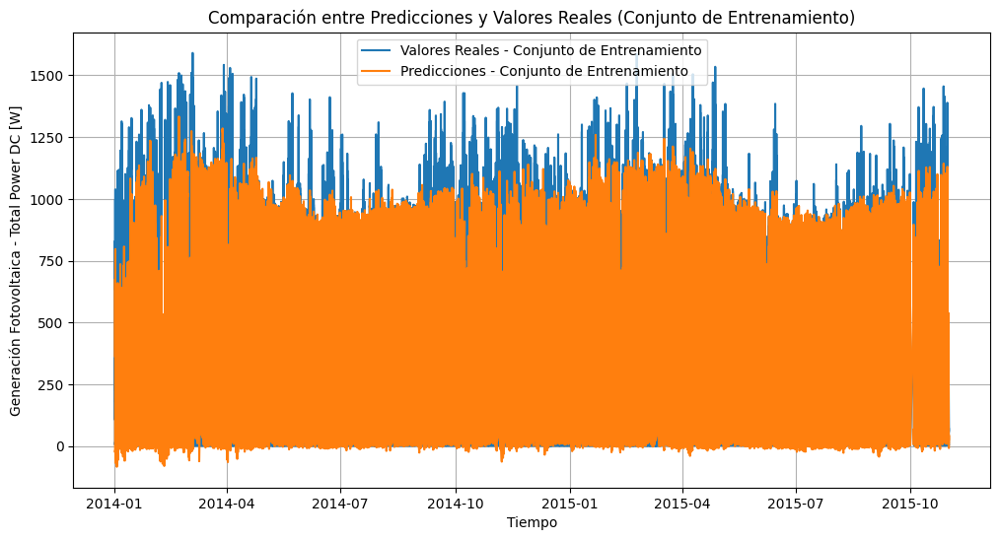

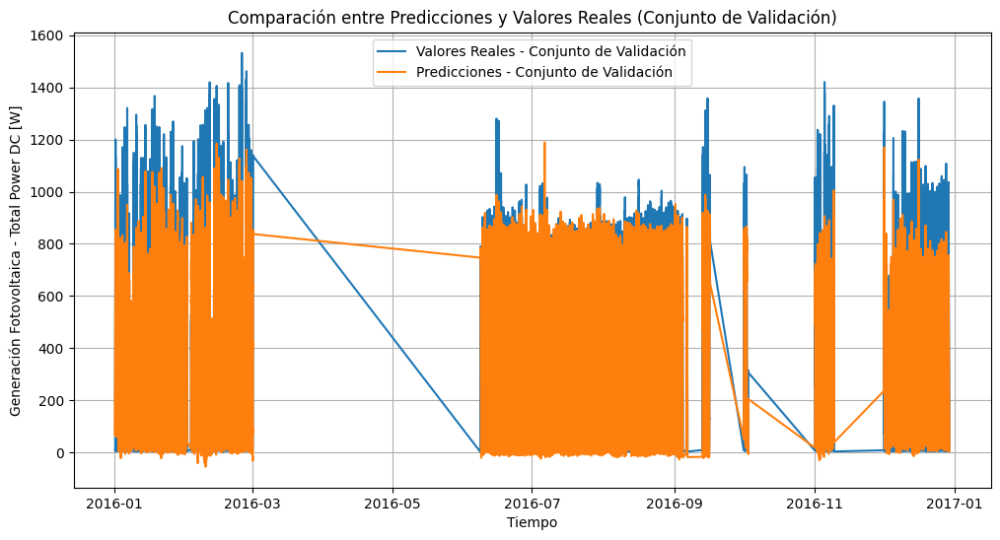

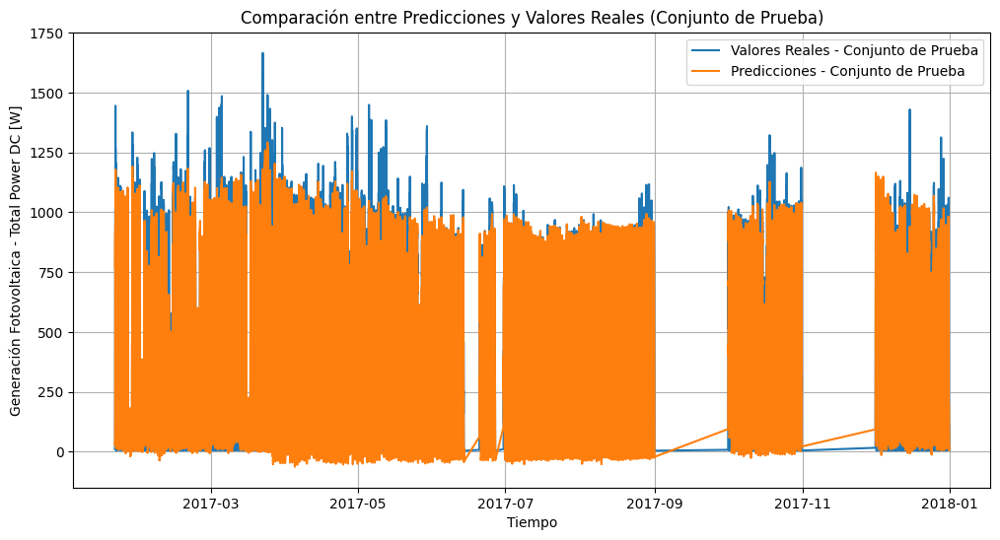

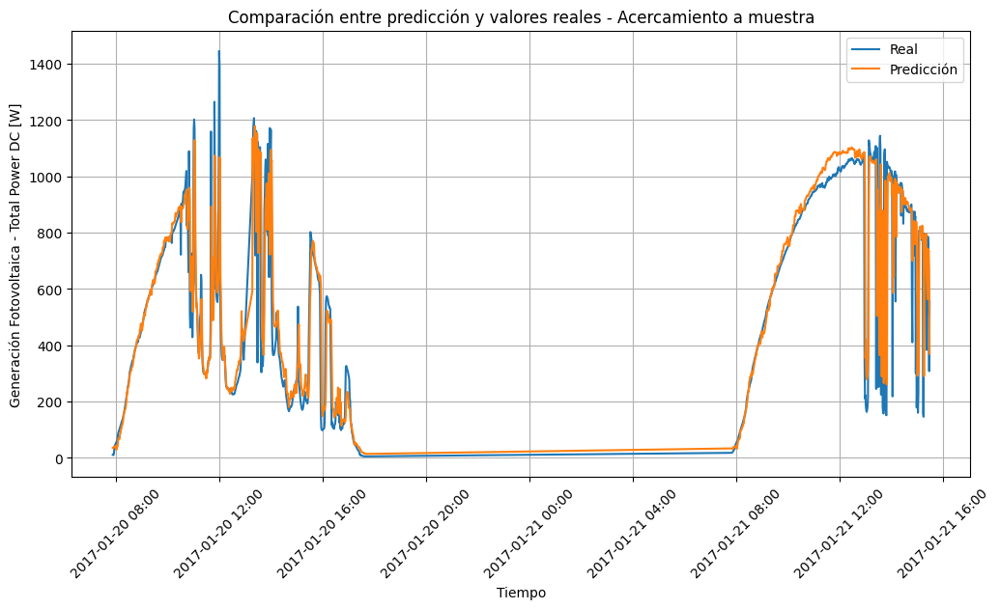

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.925,
                                  reg_lambda=10,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 5,
                                  learning_rate= 0.06,
                                  gamma= 0.125,
                                  colsample_bytree= 0.775)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)

random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
import xgboost as xgb

# Agrupar cada 5 minutos

X_train_resampled = X_train.resample('5min').mean()
y_train_resampled = y_train.resample('5min').mean()


X_train_recent2=X_train
y_train_recent = y_train


X_train_recent2.columns = X_train_recent2.columns.str.replace('[\[\]<]', '', regex=True)

model_xgboost = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

param_dist = {

    'n_estimators': [380, 400, 420],
    'max_depth': [4, 5, 6],
    'learning_rate': [0.05, 0.06, 0.07],
    'subsample': [0.9, 0.925, 0.95],
    'colsample_bytree': [0.75, 0.775, 0.8],
    'gamma': [0.1, 0.125, 0.15],
    'reg_alpha': [0.09, 0.1, 0.11],
    'reg_lambda': [9.5, 10, 10.5]
}
tscv = TimeSeriesSplit(n_splits=5)

random_xgboost = RandomizedSearchCV(model_xgboost, param_distributions=param_dist, n_iter=40, cv=tscv, scoring='neg_mean_squared_error', n_jobs=1, verbose=1)

random_xgboost.fit(X_train_recent2, y_train_recent)
print("Mejores hiperparámetros encontrados:", random_xgboost.best_params_)



Fitting 5 folds for each of 40 candidates, totalling 200 fits
Mejores hiperparámetros encontrados: {'subsample': 0.9, 'reg_lambda': 10.5, 'reg_alpha': 0.1, 'n_estimators': 400, 'max_depth': 4, 'learning_rate': 0.05, 'gamma': 0.1, 'colsample_bytree': 0.775}


Busqueda de hiperparametros Sin considerar la variable Ultraviolet [W/m2]

In [ ]:
import xgboost as xgb


X_train_recent2=X_train_su
y_train_recent = y_train


X_train_recent2.columns = X_train_recent2.columns.str.replace('[\[\]<]', '', regex=True)

model_xgboost = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

param_dist = {

    'n_estimators': [380, 400, 420],
    'max_depth': [4, 5, 6],
    'learning_rate': [0.05, 0.06, 0.07],
    'subsample': [0.9, 0.925, 0.95],
    'colsample_bytree': [0.75, 0.775, 0.8],
    'gamma': [0.1, 0.125, 0.15],
    'reg_alpha': [0.09, 0.1, 0.11],
    'reg_lambda': [9.5, 10, 10.5]
}
tscv = TimeSeriesSplit(n_splits=5)

random_xgboost = RandomizedSearchCV(model_xgboost, param_distributions=param_dist, n_iter=40, cv=tscv, scoring='neg_mean_squared_error', n_jobs=1, verbose=1)

random_xgboost.fit(X_train_recent2, y_train_recent)
print("Mejores hiperparámetros encontrados:", random_xgboost.best_params_)

Fitting 5 folds for each of 40 candidates, totalling 200 fits
Mejores hiperparámetros encontrados: {'subsample': 0.9, 'reg_lambda': 10, 'reg_alpha': 0.09, 'n_estimators': 380, 'max_depth': 4, 'learning_rate': 0.05, 'gamma': 0.125, 'colsample_bytree': 0.75}


**4.4.2. Algoritmo XGBoost - Modelo 2**

MAE ENTRENAMIENTO XGBOOST 60.599773070208535
R2 ENTRENAMIENTO XGBOOST 0.9059970986378453
MAE VALIDACION XGBOOST 104.07026084327177
R2 VALIDACION XGBOOST 0.8051310178197465
MAE TEST XGBOOST 84.68370793425719
R2 TEST XGBOOST 0.8678128377690044


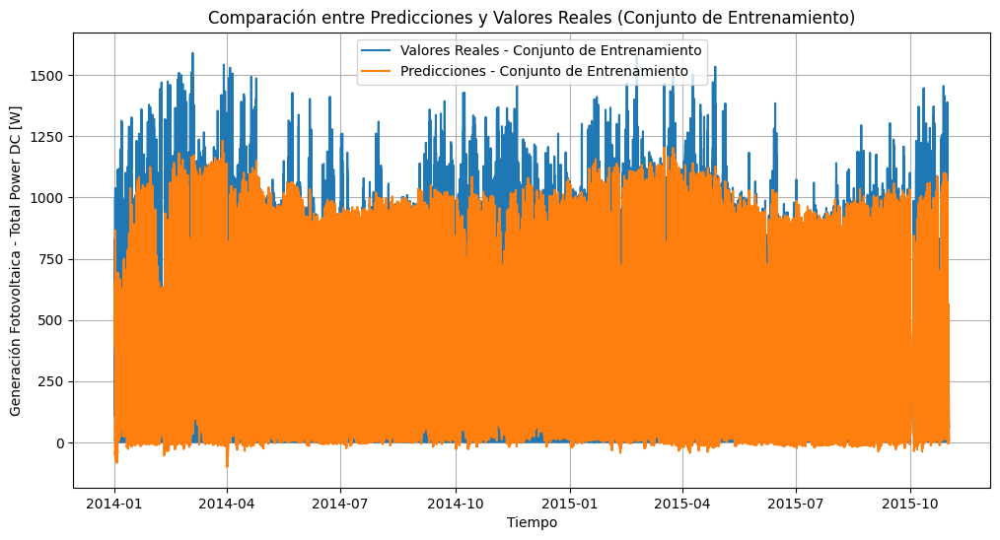

MAE ENTRENAMIENTO XGBOOST 60.599773070208535
R2 ENTRENAMIENTO XGBOOST 0.9059970986378453
MAE VALIDACION XGBOOST 104.07026084327177
R2 VALIDACION XGBOOST 0.8051310178197465
MAE TEST XGBOOST 84.68370793425719
R2 TEST XGBOOST 0.8678128377690044


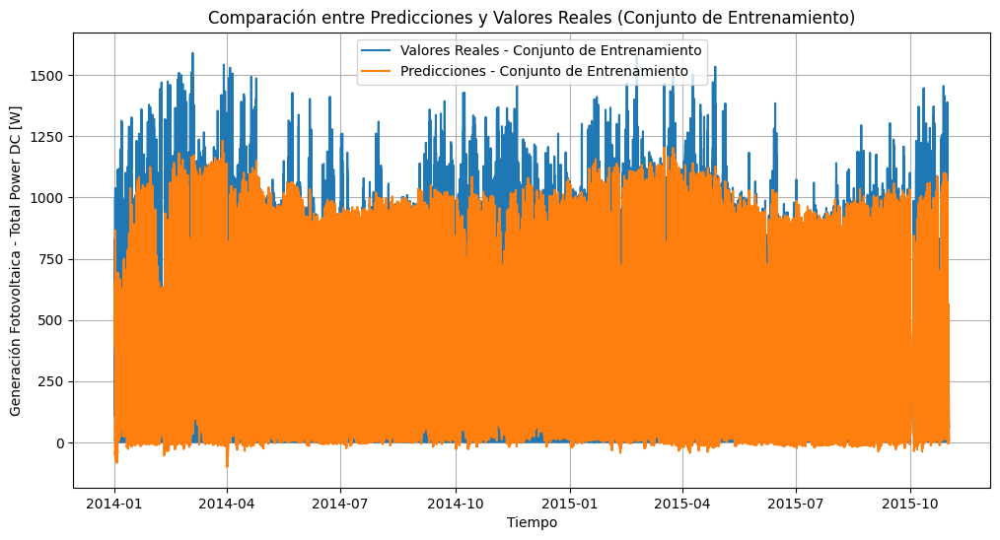

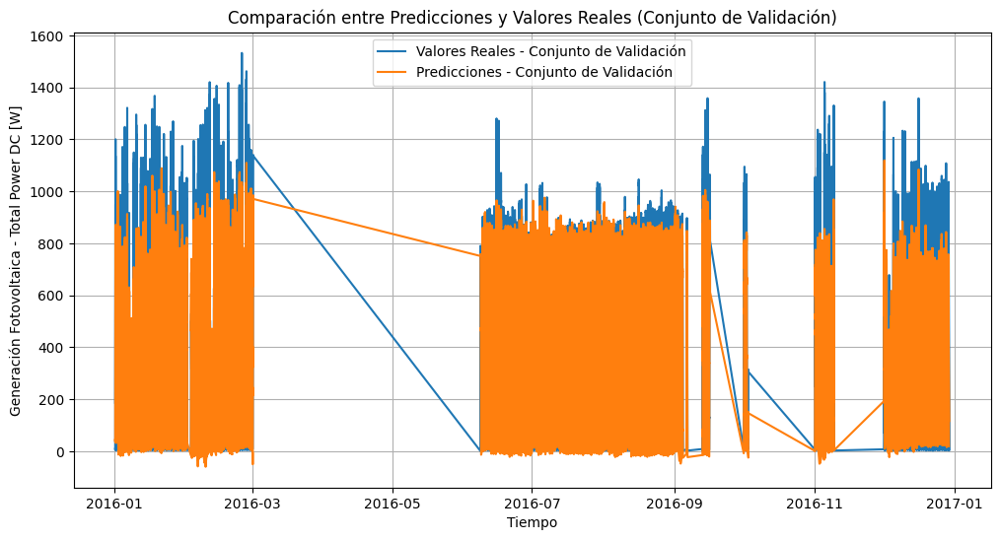

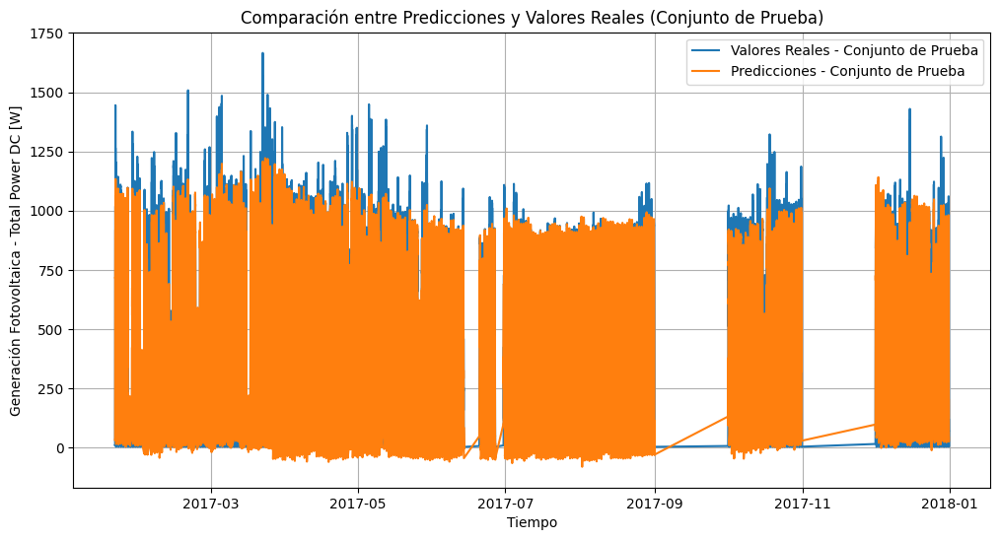

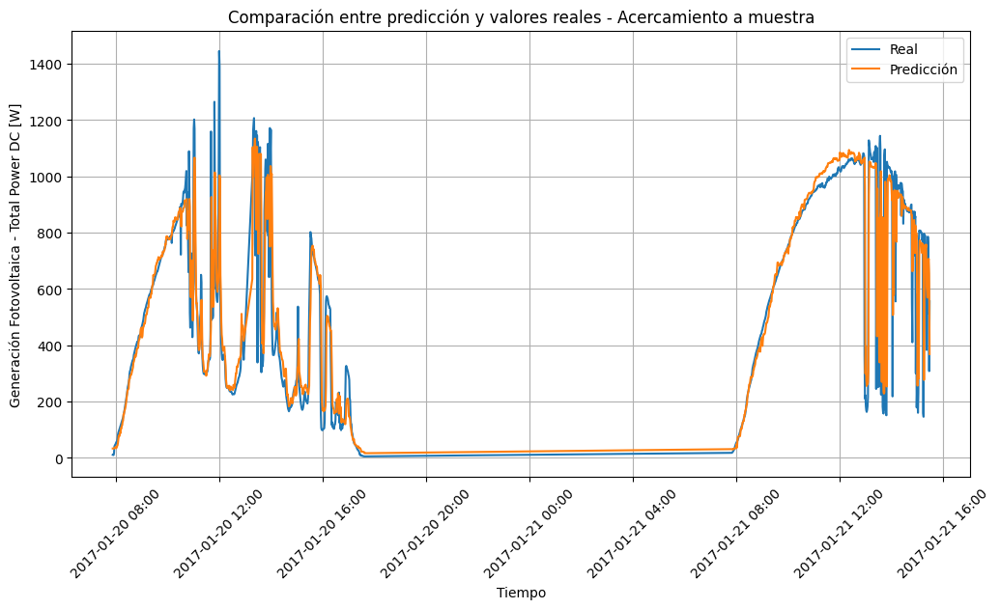

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10.5,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.1,
                                  colsample_bytree= 0.775)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Modelo 2 ejecutado sin la variable de Ultraviolet [W/m2]

MAE ENTRENAMIENTO XGBOOST 60.1458390427544
R2 ENTRENAMIENTO XGBOOST 0.9057145859395784
MAE VALIDACION XGBOOST 100.79951850337285
R2 VALIDACION XGBOOST 0.8214177322749907
MAE TEST XGBOOST 82.48161543630412
R2 TEST XGBOOST 0.8738481998736185


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


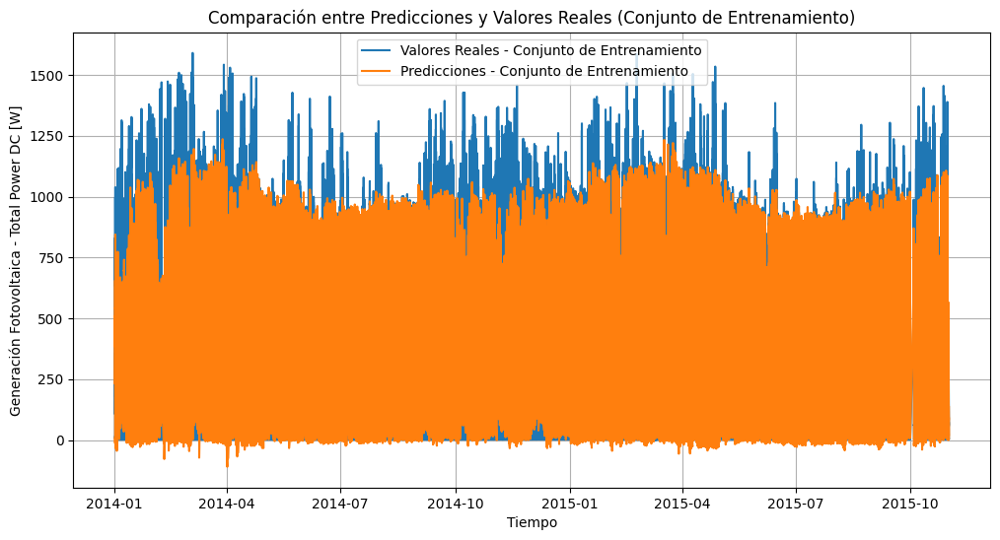

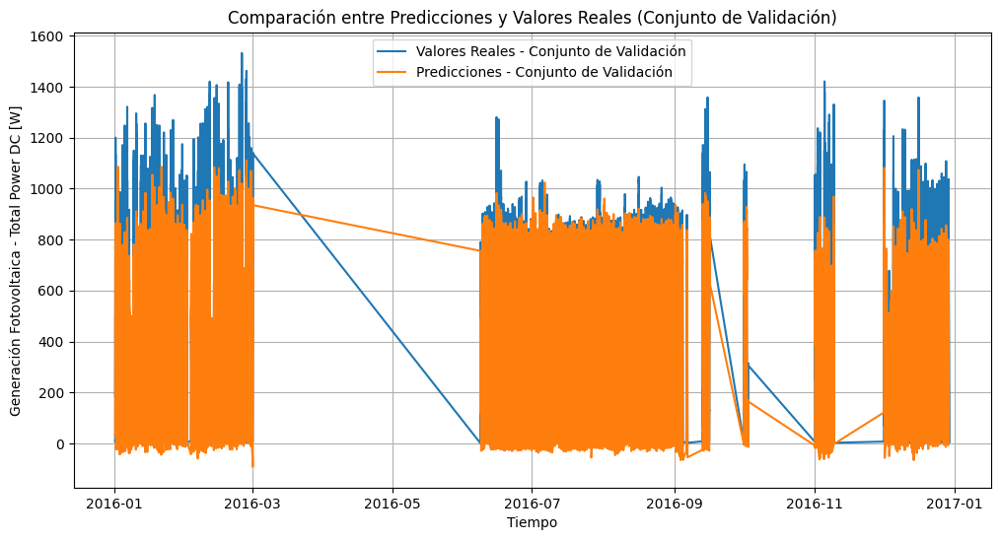

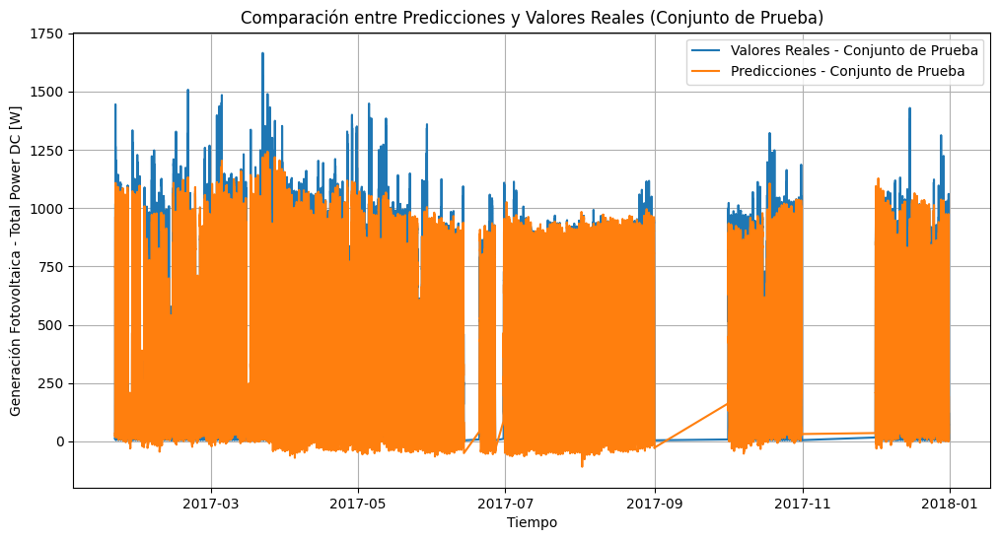

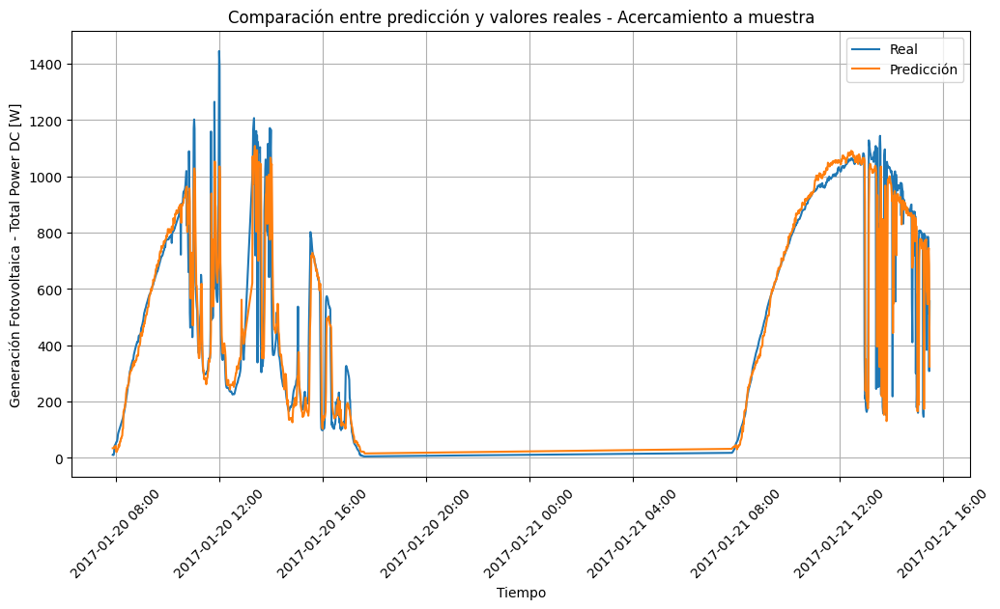

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10.5,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.1,
                                  colsample_bytree= 0.775)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train_su
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val_su
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017_su
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

MAE ENTRENAMIENTO XGBOOST 60.98131096936238
R2 ENTRENAMIENTO XGBOOST 0.9051276954583825
MAE VALIDACION XGBOOST 101.31218733552846
R2 VALIDACION XGBOOST 0.8179264708860265
MAE TEST XGBOOST 83.2452888596718
R2 TEST XGBOOST 0.8721561655876318


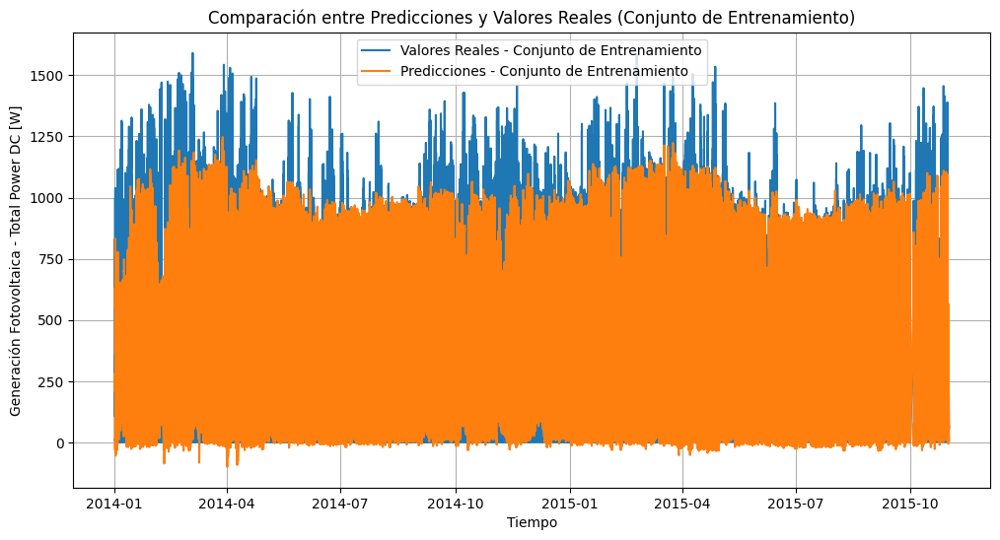

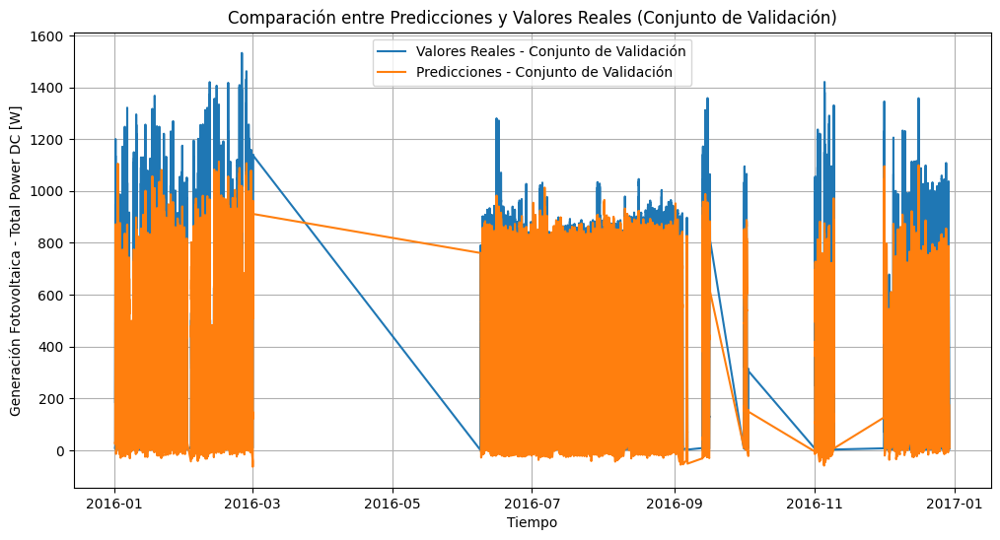

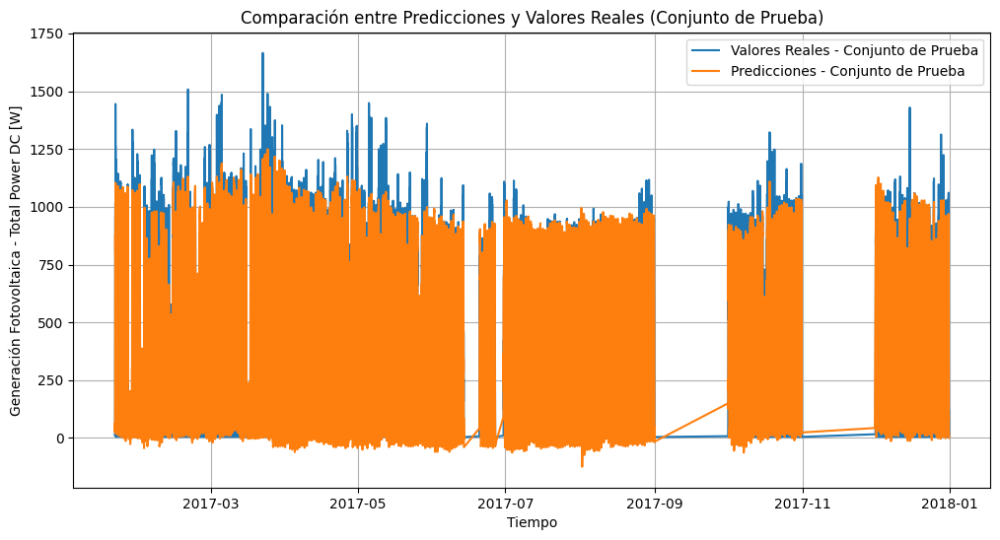

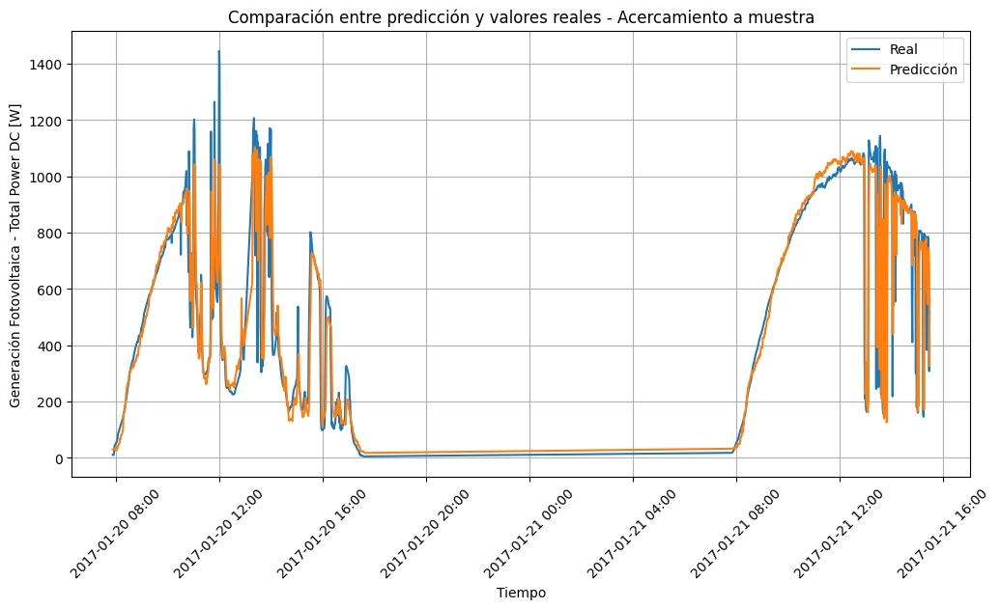

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10,
                                  reg_alpha=0.09,
                                  n_estimators= 380,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.125,
                                  colsample_bytree= 0.75)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train_su
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val_su
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017_su
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Modelo 2 ejecutado sin la variable de Ultraviolet [W/m2] y Wind Velocity [m/s]

MAE ENTRENAMIENTO XGBOOST 59.55597969475035
R2 ENTRENAMIENTO XGBOOST 0.9069713228744035
MAE VALIDACION XGBOOST 98.20136023559468
R2 VALIDACION XGBOOST 0.8237596791630413
MAE TEST XGBOOST 83.9538137912798
R2 TEST XGBOOST 0.8702655074399935


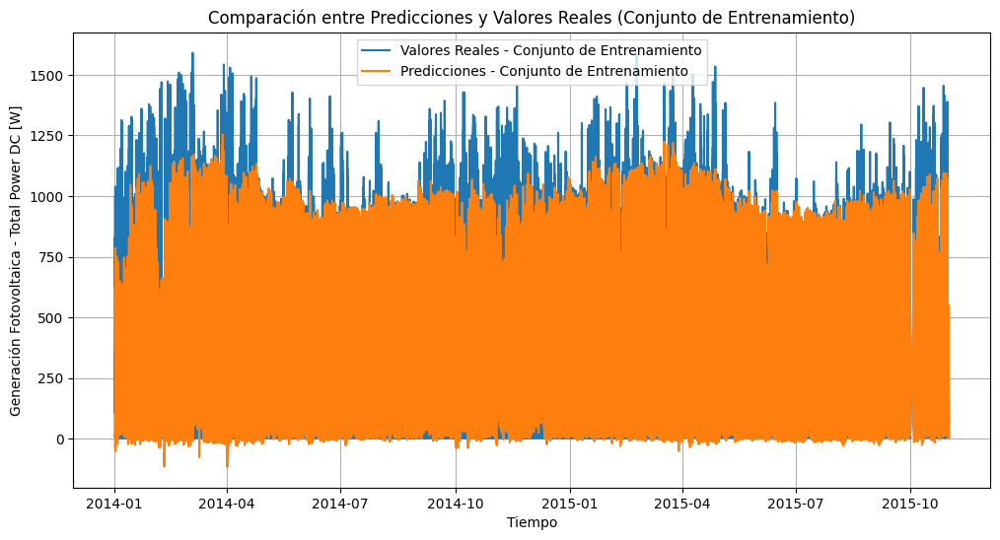

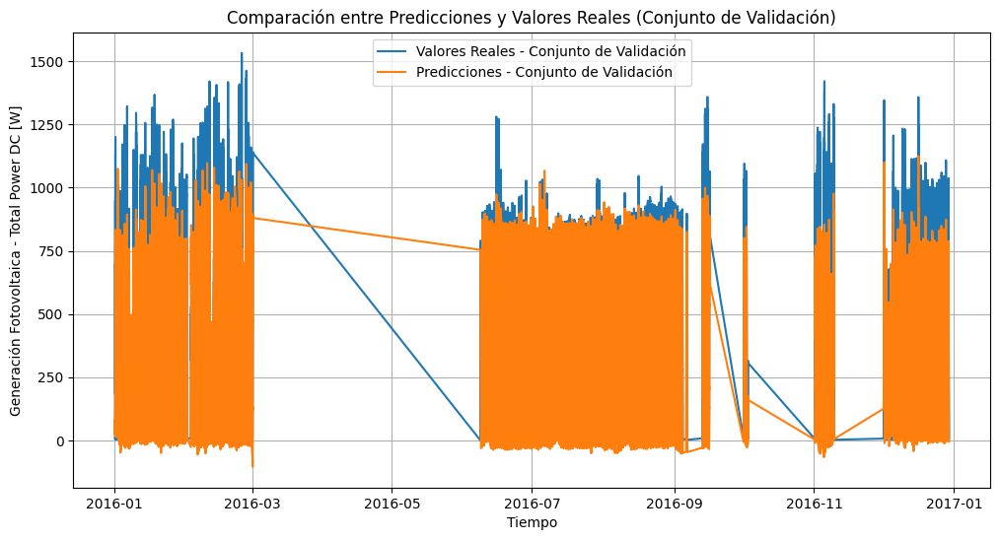

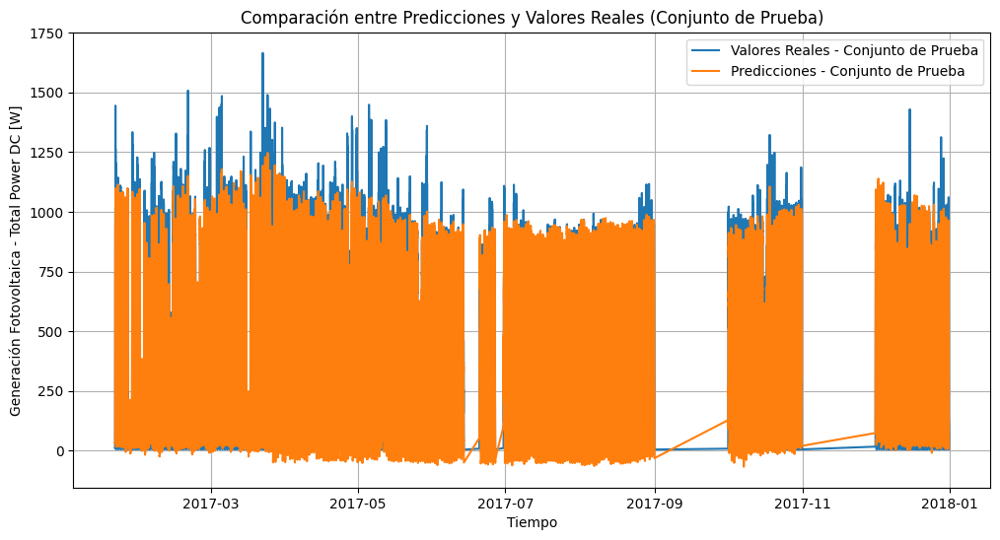

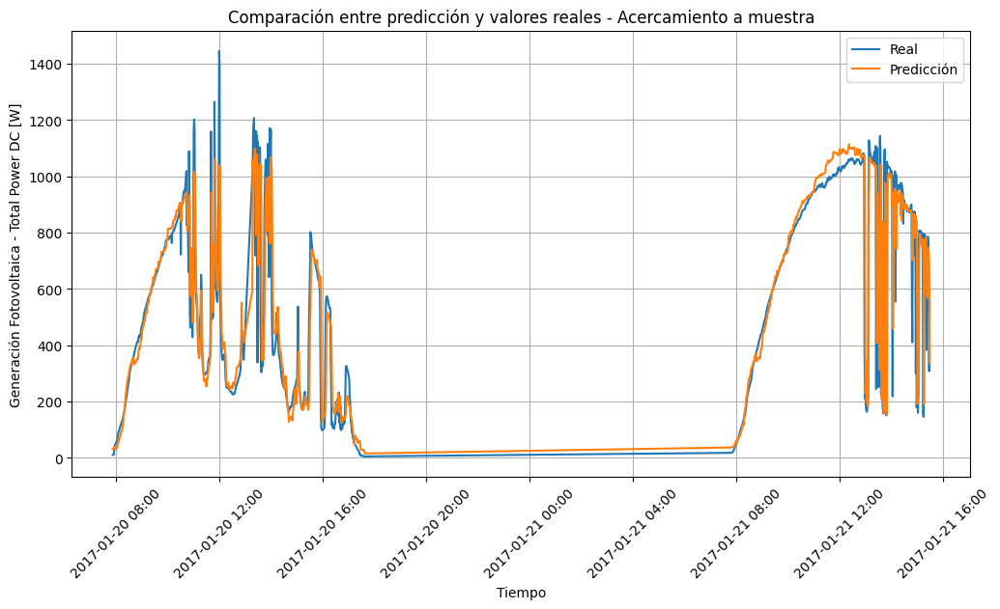

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10.5,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.1,
                                  colsample_bytree= 0.775)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train_swu
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val_swu
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017_swu
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Considerando la prediccion solo en la primera semana del 2017

MAE ENTRENAMIENTO XGBOOST 60.1458390427544
R2 ENTRENAMIENTO XGBOOST 0.9057145859395784
MAE VALIDACION XGBOOST 100.79951850337285
R2 VALIDACION XGBOOST 0.8214177322749907
MAE TEST XGBOOST 53.30499582247067
R2 TEST XGBOOST 0.921672919384723


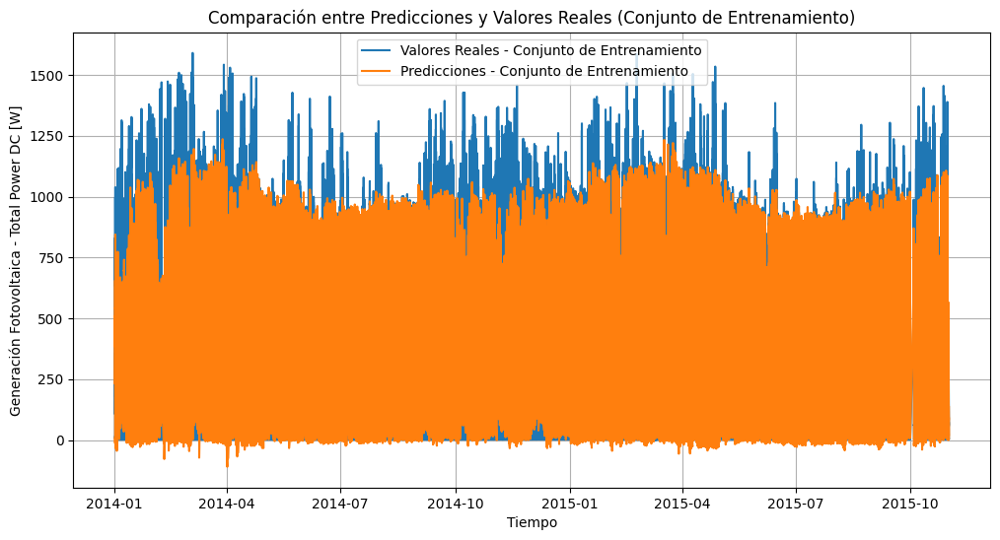

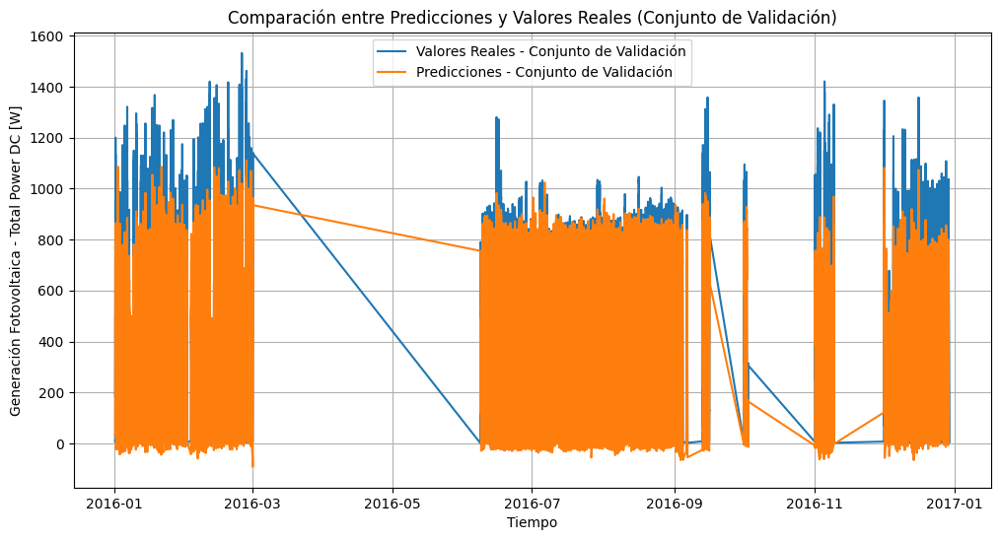

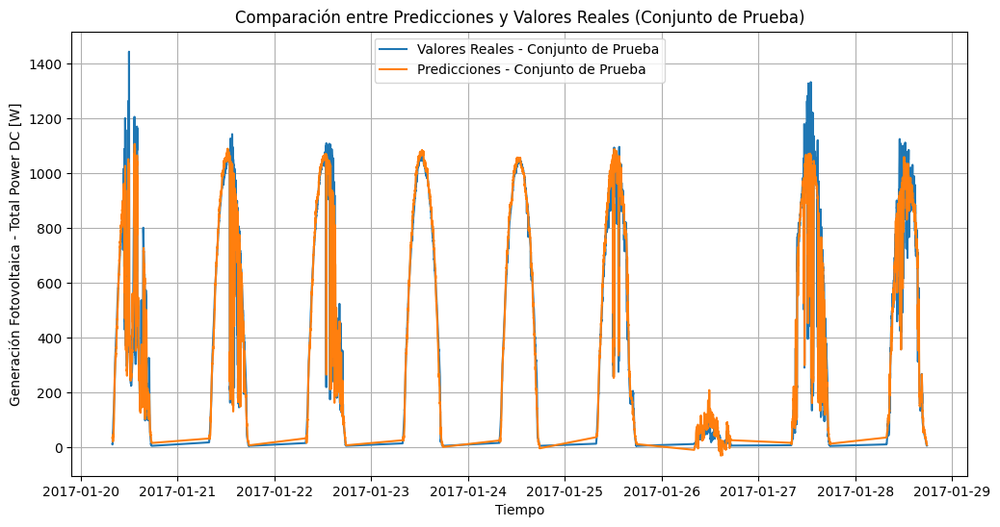

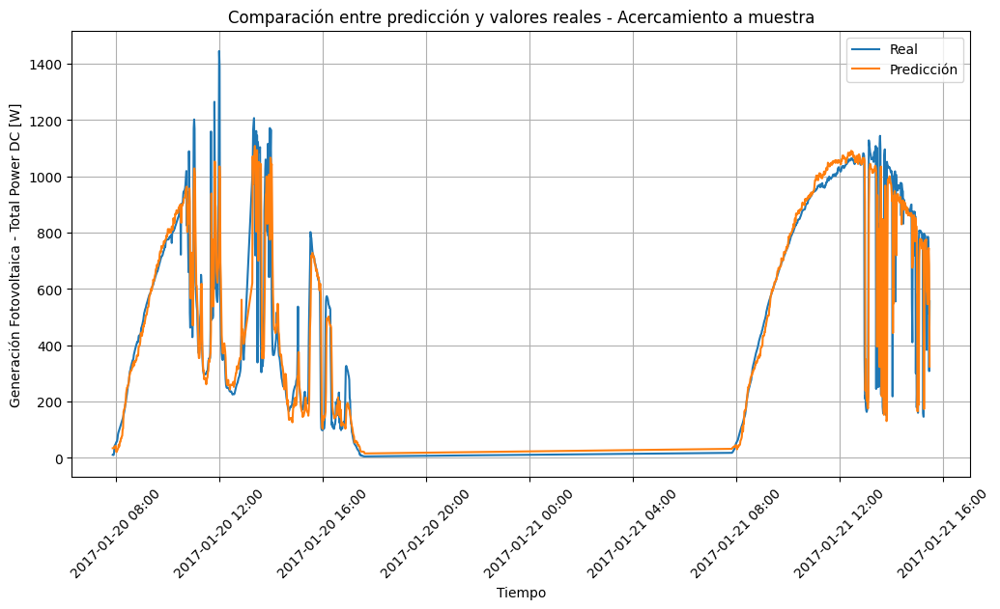

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10.5,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.1,
                                  colsample_bytree= 0.775)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train_su
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val_su
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017_sus1
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017_s1, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017_s1, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017_s1.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

MAE ENTRENAMIENTO XGBOOST 60.599773070208535
R2 ENTRENAMIENTO XGBOOST 0.9059970986378453
MAE VALIDACION XGBOOST 104.07026084327177
R2 VALIDACION XGBOOST 0.8051310178197465
MAE TEST XGBOOST 53.91820150188882
R2 TEST XGBOOST 0.9243009248834142


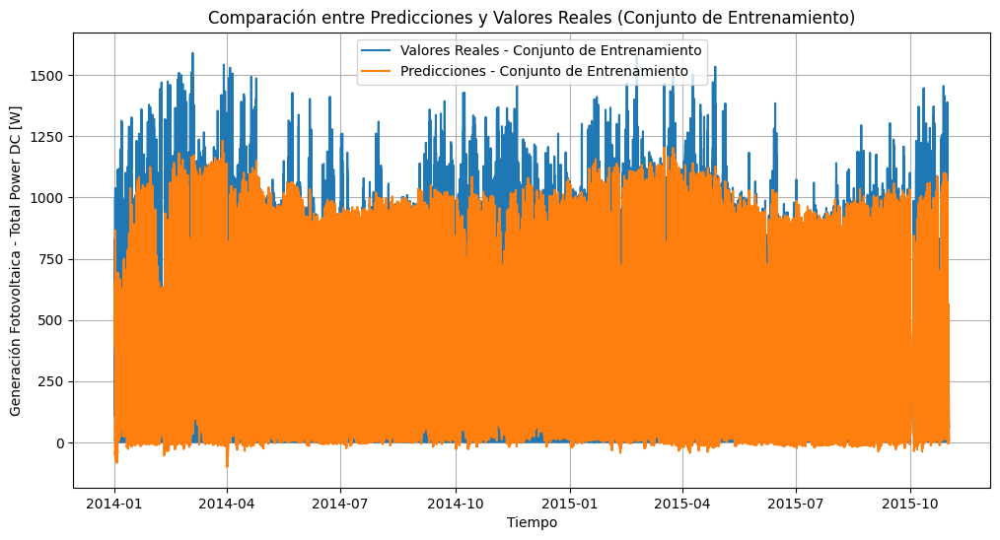

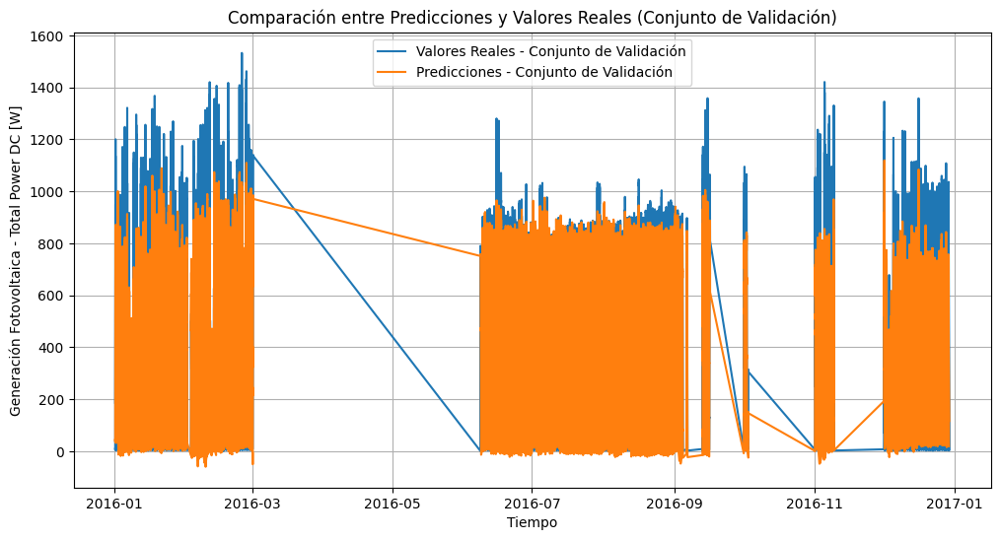

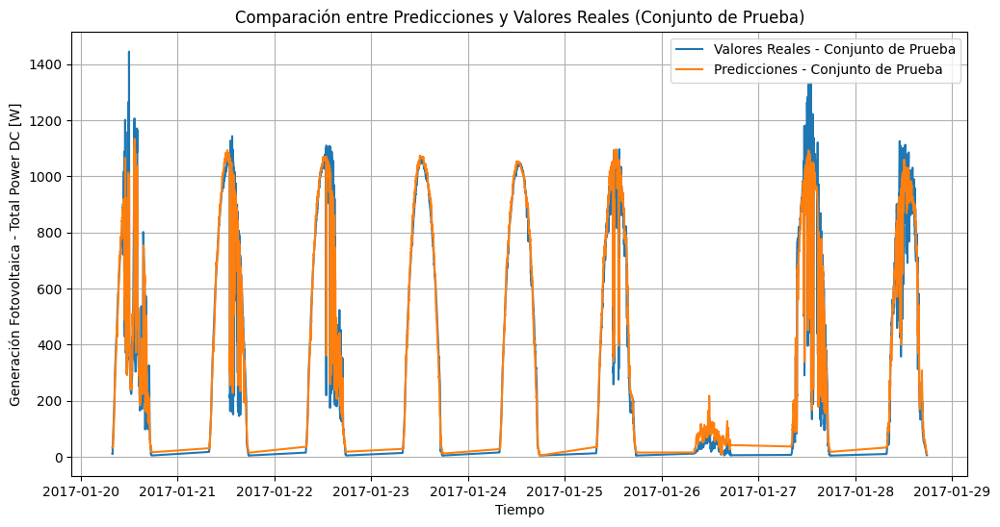

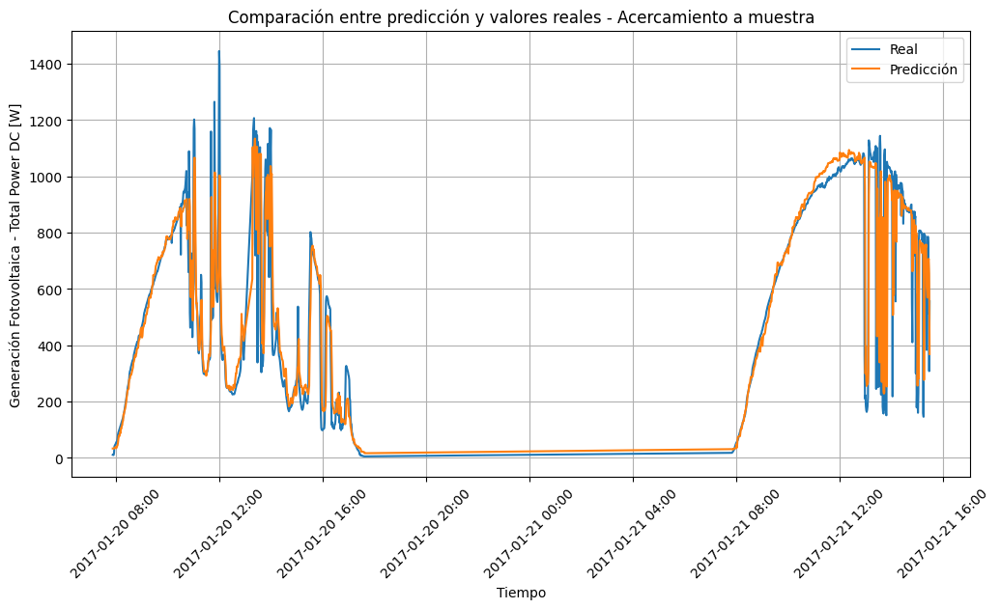

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10.5,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.1,
                                  colsample_bytree= 0.775)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017_s1
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017_s1, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017_s1, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017_s1.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s1[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

MAE ENTRENAMIENTO XGBOOST 60.599773070208535
R2 ENTRENAMIENTO XGBOOST 0.9059970986378453
MAE VALIDACION XGBOOST 104.07026084327177
R2 VALIDACION XGBOOST 0.8051310178197465
MAE TEST XGBOOST 67.044674625176
R2 TEST XGBOOST 0.9118024010365069


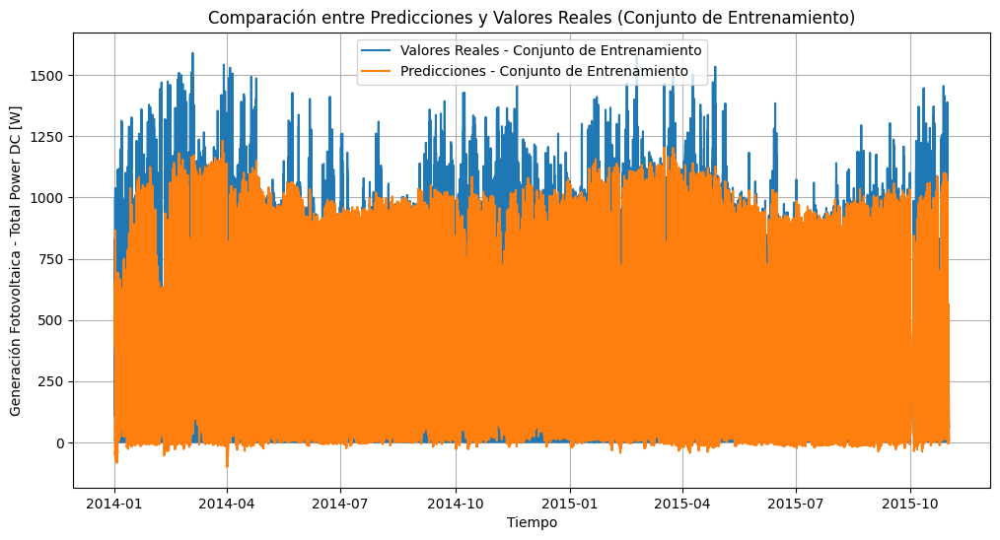

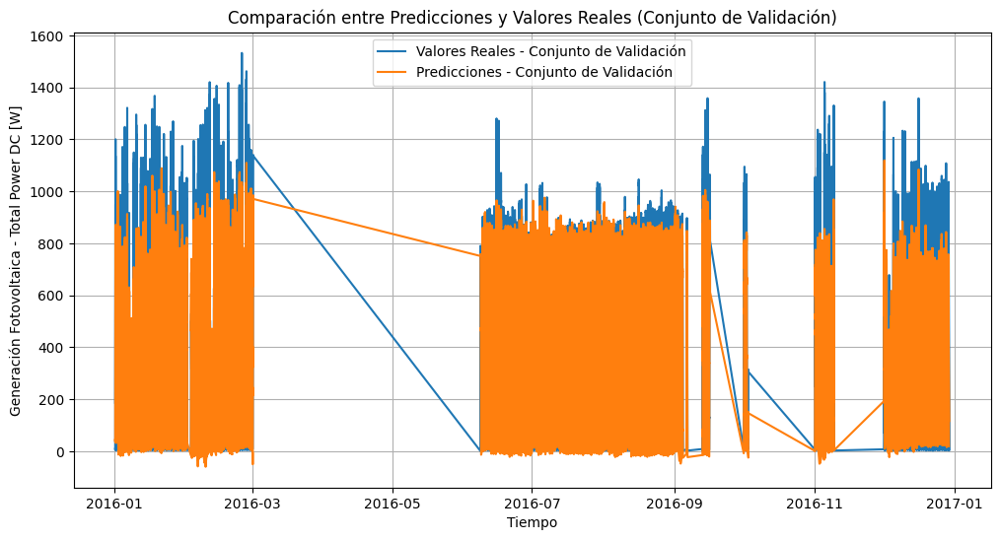

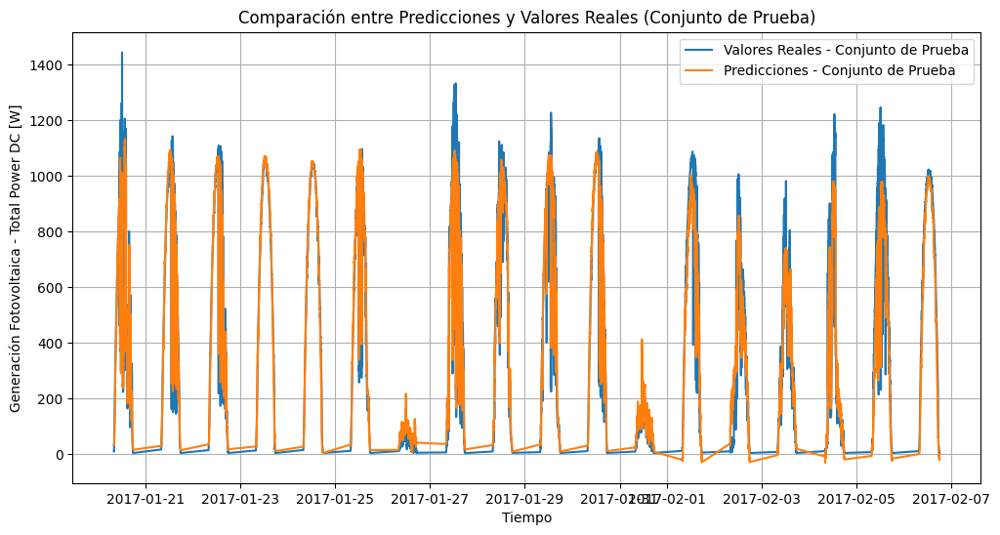

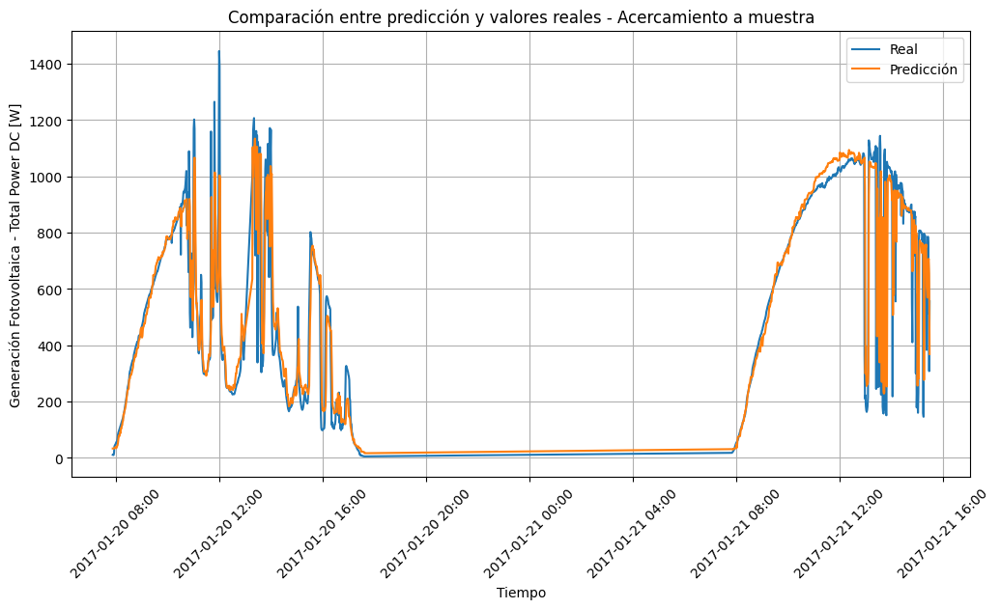

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10.5,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.1,
                                  colsample_bytree= 0.775)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017_s2
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017_s2, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017_s2, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017_s2.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s2, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017_s2[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
y_test2017_s1.info()

<class 'pandas.core.series.Series'>
DatetimeIndex: 5101 entries, 2017-01-20 07:52:00 to 2017-01-28 17:43:00
Series name: Total Power DC [W]
Non-Null Count  Dtype  
--------------  -----  
5101 non-null   float64
dtypes: float64(1)
memory usage: 79.7 KB


In [ ]:
import xgboost as xgb
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingRandomSearchCV

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

model_xgboost = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

param_dist = {
    'n_estimators': np.arange(100, 550, 100),
    'max_depth': np.arange(3, 10, 2),
    'learning_rate': np.linspace(0.01, 0.05, 5),
    'subsample': np.linspace(0.7, 1.0, 5),
    'colsample_bytree': np.linspace(0.7, 1.0, 5),
    'gamma': np.linspace(0, 0.5, 5),
    'reg_alpha': np.logspace(-4, 0, 3),
    'reg_lambda': np.logspace(-4, 1, 6)
    }

tscv = TimeSeriesSplit(n_splits=5)

halving_xgboost = HalvingRandomSearchCV(
    model_xgboost,
    param_distributions=param_dist,
    factor=2,
    resource='n_samples',
    max_resources=300000,
    min_resources=500,
    cv=tscv,
    scoring='neg_mean_squared_error',
    n_jobs=1,
    verbose=1,

)

# Entrenar el modelo usando HalvingRandomSearchCV
halving_xgboost.fit(X_train2, y_train)

# Imprimir los mejores hiperparámetros encontrados
print("Mejores hiperparámetros encontrados:", halving_xgboost.best_params_)


n_iterations: 10
n_required_iterations: 10
n_possible_iterations: 10
min_resources_: 500
max_resources_: 300000
aggressive_elimination: False
factor: 2
----------
iter: 0
n_candidates: 600
n_resources: 500
Fitting 5 folds for each of 600 candidates, totalling 3000 fits
----------
iter: 1
n_candidates: 300
n_resources: 1000
Fitting 5 folds for each of 300 candidates, totalling 1500 fits
----------
iter: 2
n_candidates: 150
n_resources: 2000
Fitting 5 folds for each of 150 candidates, totalling 750 fits
----------
iter: 3
n_candidates: 75
n_resources: 4000
Fitting 5 folds for each of 75 candidates, totalling 375 fits
----------
iter: 4
n_candidates: 38
n_resources: 8000
Fitting 5 folds for each of 38 candidates, totalling 190 fits
----------
iter: 5
n_candidates: 19
n_resources: 16000
Fitting 5 folds for each of 19 candidates, totalling 95 fits
----------
iter: 6
n_candidates: 10
n_resources: 32000
Fitting 5 folds for each of 10 candidates, totalling 50 fits
----------
iter: 7
n_candidat

**4.4.3. Algoritmo XGBoost - Modelo 3**

MAE ENTRENAMIENTO XGBOOST 69.74265653584436
R2 ENTRENAMIENTO XGBOOST 0.8880875141097023
MAE VALIDACION XGBOOST 93.65599151292476
R2 VALIDACION XGBOOST 0.8275481638086624
MAE TEST XGBOOST 87.6474295075396
R2 TEST XGBOOST 0.8641099950400446


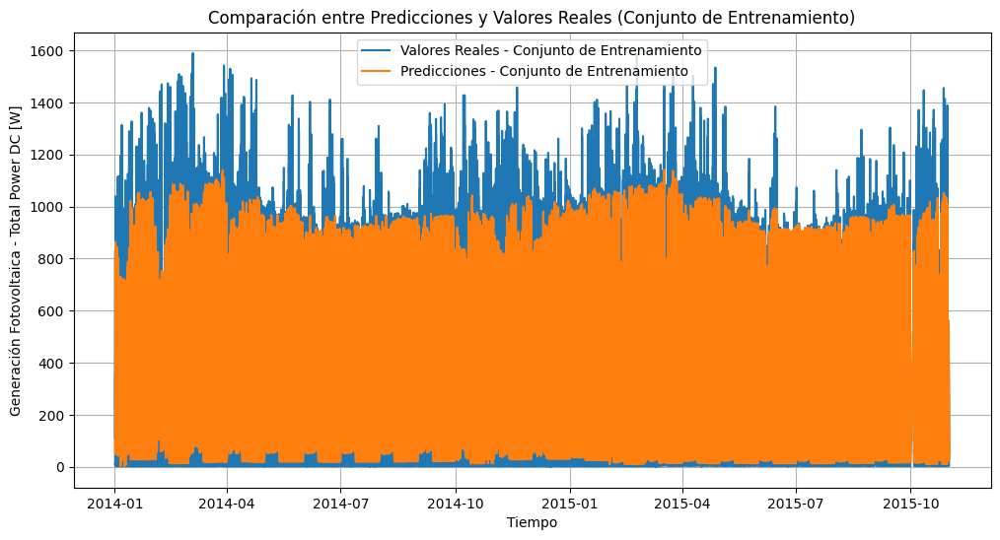

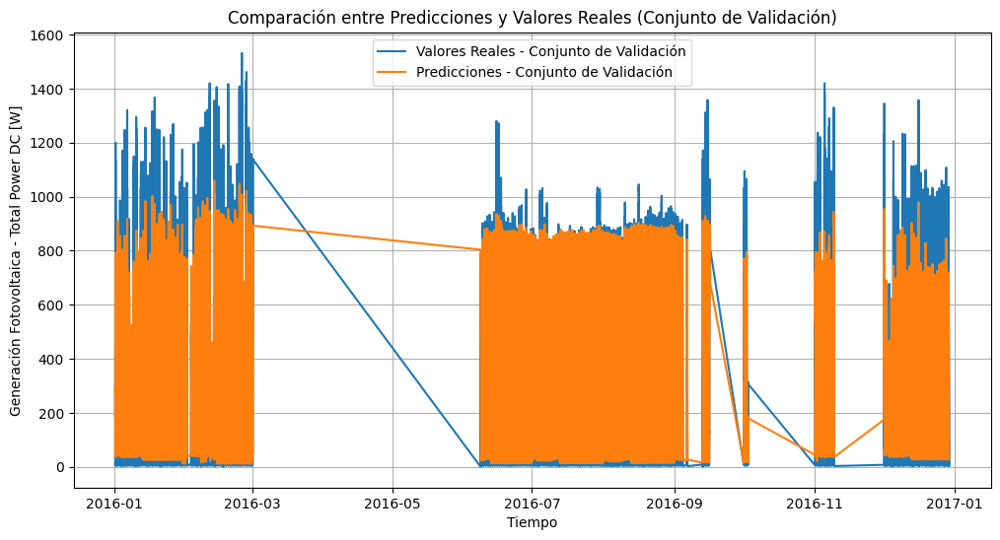

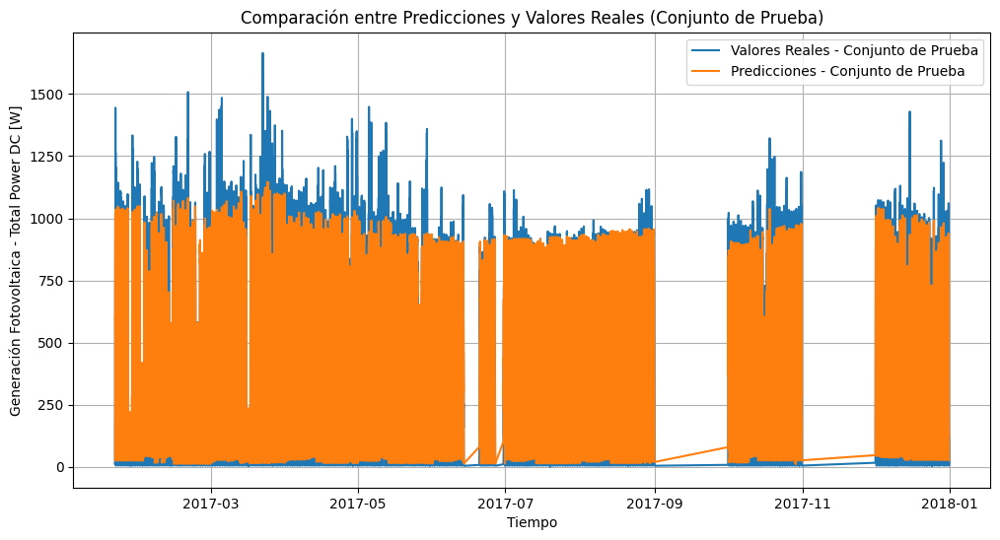

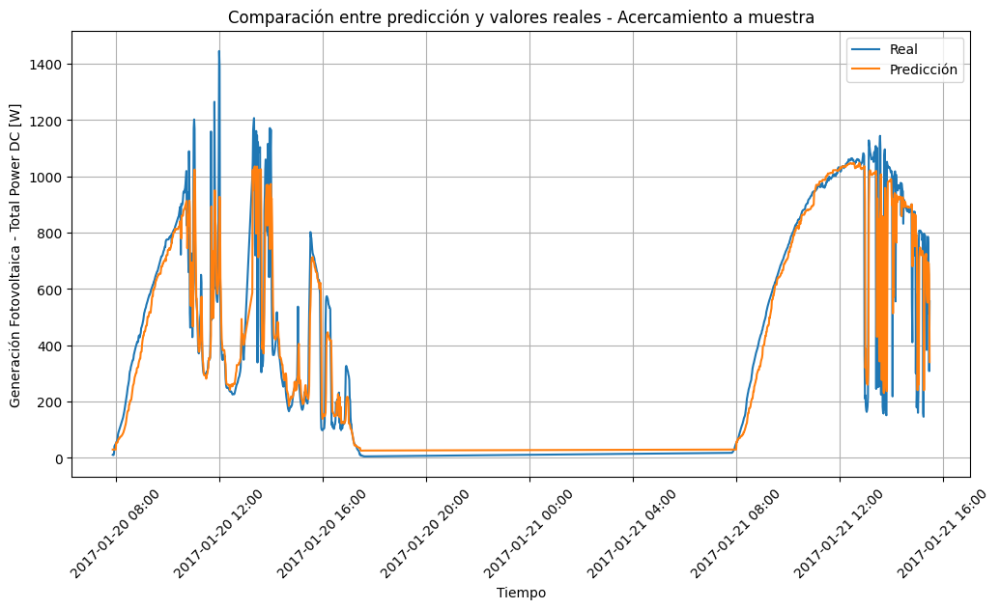

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.7,
                                  reg_lambda=1,
                                  reg_alpha=0.0001,
                                  n_estimators= 200,
                                  max_depth= 5,
                                  learning_rate= 0.02,
                                  gamma= 0.25,
                                  colsample_bytree= 0.85)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)

random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.4.4. Algoritmo XGBoost - Modelo 4**

MAE ENTRENAMIENTO XGBOOST 71.18973095126559
R2 ENTRENAMIENTO XGBOOST 0.8863371335955064
MAE VALIDACION XGBOOST 92.6127496704439
R2 VALIDACION XGBOOST 0.8306490755639376
MAE TEST XGBOOST 88.8066107339
R2 TEST XGBOOST 0.8639317931884413


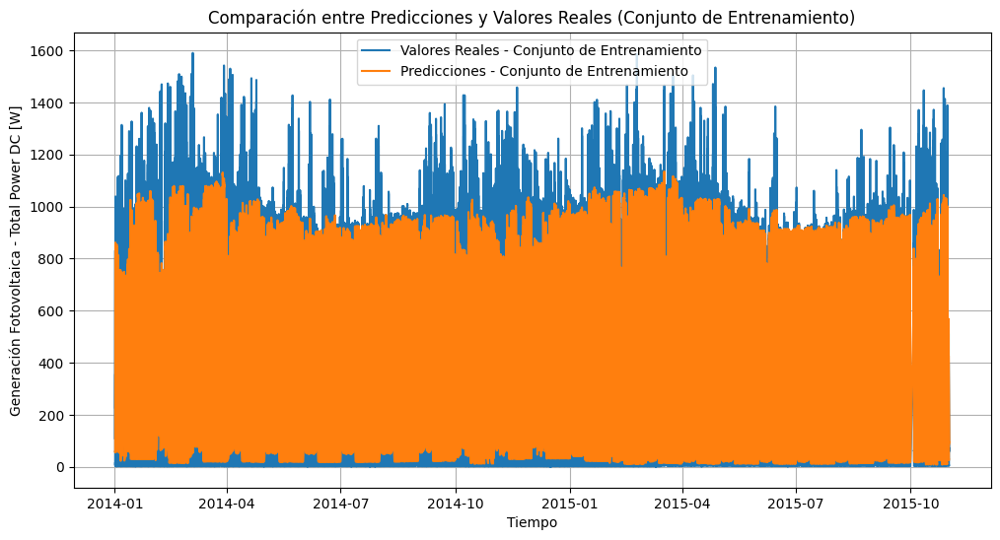

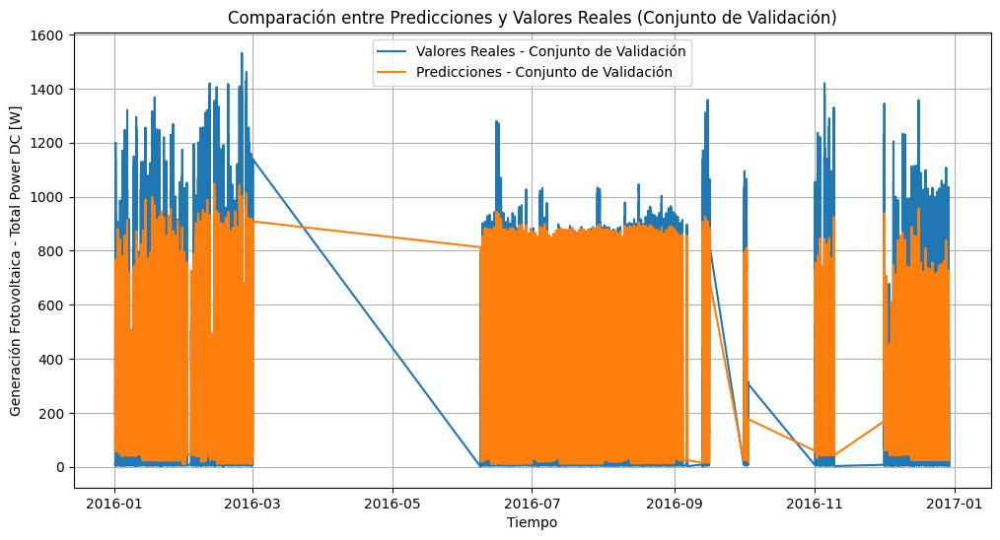

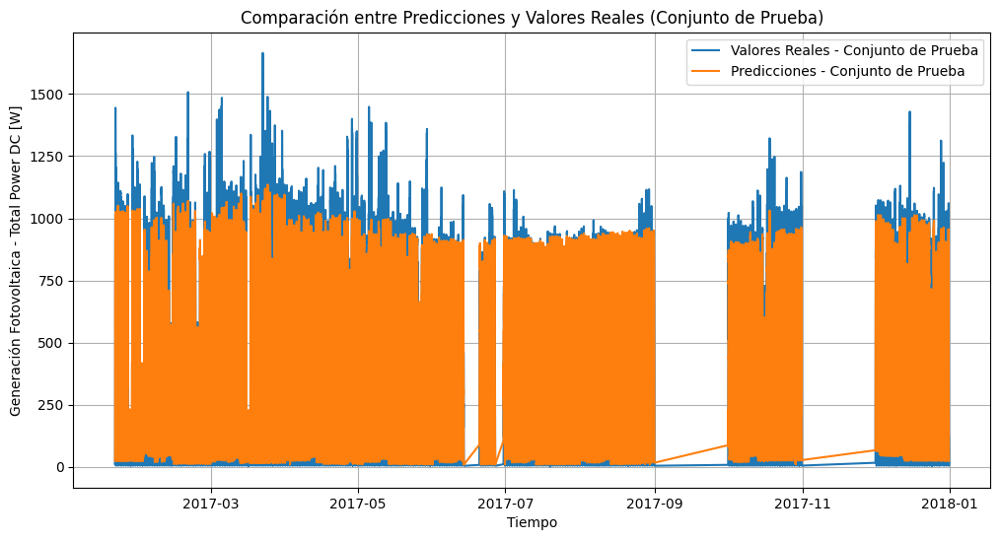

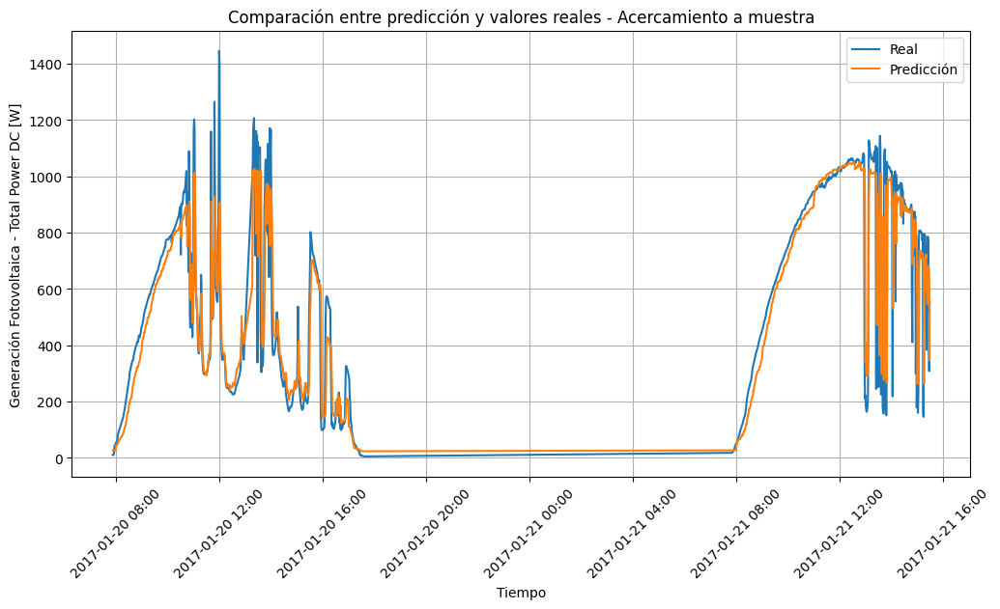

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.775,
                                  reg_lambda=0.0001,
                                  reg_alpha=0.0001,
                                  n_estimators= 400,
                                  max_depth= 5,
                                  learning_rate= 0.01,
                                  gamma= 0.25,
                                  colsample_bytree= 0.7)

# Ajuste de los conjuntos al formato requerido por XGBOOST

X_train2=X_train
X_train2.columns = X_train2.columns.str.replace('[\[\]<]', '', regex=True)

X_val2=X_val
X_val2.columns = X_val2.columns.str.replace('[\[\]<]', '', regex=True)

X_test20172=X_test2017
X_test20172.columns = X_test20172.columns.str.replace('[\[\]<]', '', regex=True)


random_xgboost.fit(X=X_train2, y=y_train)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de entrenamiento, validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train2)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val2)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test20172)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_xgboost_rantrain)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_xgboost_ran)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_xgboost_rantest)
r2_train_xgboost_ran = r2_score(y_train, y_pred_xgboost_rantrain)
r2_val_xgboost_ran = r2_score(y_val, y_pred_xgboost_ran)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_xgboost_rantest)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dftrain = pd.DataFrame(y_pred_xgboost_rantrain, index=y_train.index, columns=['Predicción'])
y_pred_dfval = pd.DataFrame(y_pred_xgboost_ran, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_xgboost_rantest, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Entrenamiento

plt.figure(figsize=(12, 6))
plt.plot(y_train, label='Valores Reales - Conjunto de Entrenamiento')
plt.plot(y_pred_dftrain, label='Predicciones - Conjunto de Entrenamiento')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Entrenamiento)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.4.5. Algoritmo XGBoost - Modelo 5**

MAE ENTRENAMIENTO XGBOOST 61.10700752060102
R2 ENTRENAMIENTO XGBOOST 0.9053471416017145
MAE VALIDACION XGBOOST 104.34826978995928
R2 VALIDACION XGBOOST 0.7993597038014912
MAE TEST XGBOOST 85.33428293213053
R2 TEST XGBOOST 0.8672552743551185


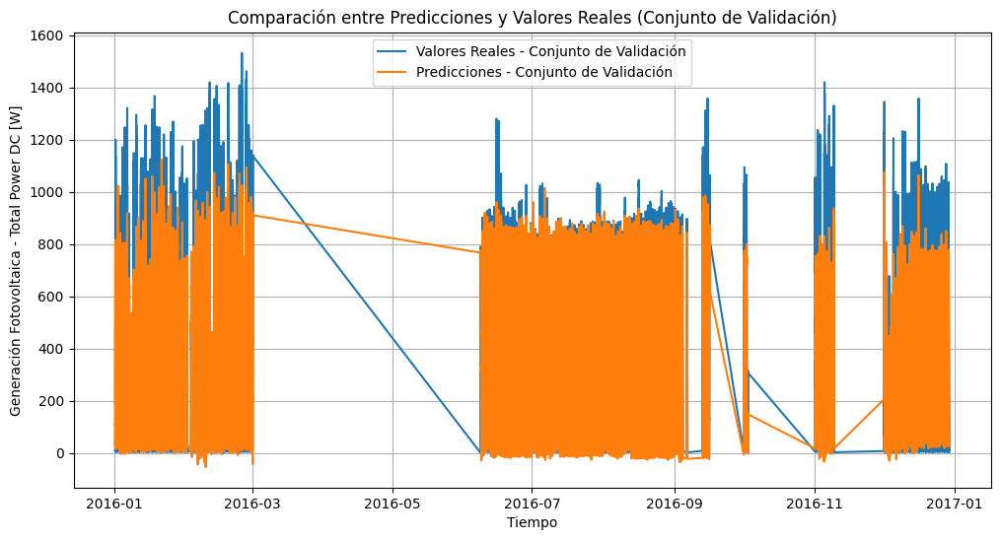

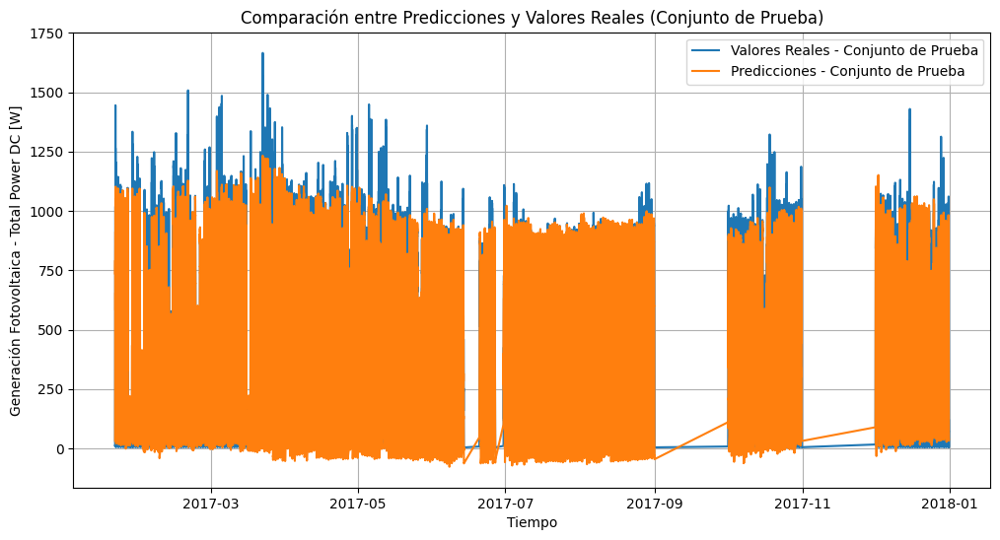

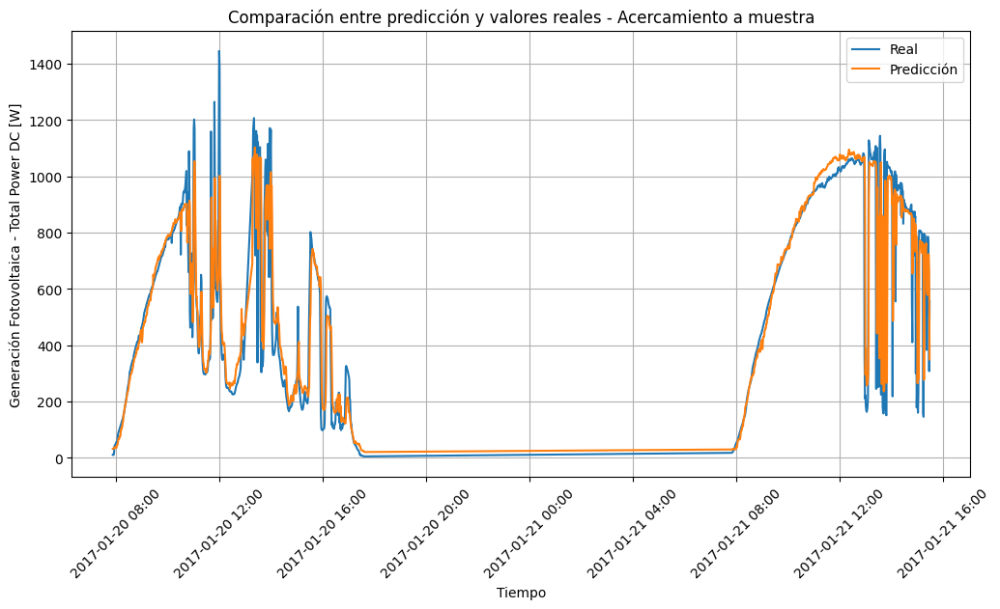

In [ ]:
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import matplotlib.dates as mdates

# Normalizamos las variables de los conjuntos de entrenamiento, validacion y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Ajuste del conjunto de entrenamiento al modelo de regresión

random_xgboost = xgb.XGBRegressor(random_state=42,
                                  subsample= 0.9,
                                  reg_lambda=10.5,
                                  reg_alpha=0.1,
                                  n_estimators= 400,
                                  max_depth= 4,
                                  learning_rate= 0.05,
                                  gamma= 0.1,
                                  colsample_bytree= 0.775)

random_xgboost.fit(X=X_train_esc, y=y_train_esc)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_xgboost_rantrain = random_xgboost.predict(X=X_train_esc)
y_pred_xgboost_ran = random_xgboost.predict(X=X_val_esc)
y_pred_xgboost_rantest = random_xgboost.predict(X=X_test2017_esc)

# Reversión de la normalización en las predicciones

y_pred_train_inv = std_y.inverse_transform(y_pred_xgboost_rantrain.reshape(-1, 1))
y_pred_val_inv = std_y.inverse_transform(y_pred_xgboost_ran.reshape(-1, 1))
y_pred_test_inv = std_y.inverse_transform(y_pred_xgboost_rantest.reshape(-1, 1))

# Evaluación del modelo en el conjunto de entrenamiento, validación y prueba

mae_train_xgboost_ran = mean_absolute_error(y_train, y_pred_train_inv)
mae_val_xgboost_ran = mean_absolute_error(y_val, y_pred_val_inv)
mae_test_xgboost_ran = mean_absolute_error(y_test2017, y_pred_test_inv)
r2_train_xgboost_ran = r2_score(y_train, y_pred_train_inv)
r2_val_xgboost_ran = r2_score(y_val, y_pred_val_inv)
r2_test_xgboost_ran = r2_score(y_test2017, y_pred_test_inv)

print ('MAE ENTRENAMIENTO XGBOOST', mae_train_xgboost_ran)
print ('R2 ENTRENAMIENTO XGBOOST', r2_train_xgboost_ran)
print ('MAE VALIDACION XGBOOST', mae_val_xgboost_ran)
print ('R2 VALIDACION XGBOOST', r2_val_xgboost_ran)
print ('MAE TEST XGBOOST', mae_test_xgboost_ran)
print ('R2 TEST XGBOOST', r2_test_xgboost_ran)

# Graficas de las predicciones vs valores reales

y_pred_dfval = pd.DataFrame(y_pred_val_inv, index=y_val.index, columns=['Predicción'])
y_pred_dftest = pd.DataFrame(y_pred_test_inv, index=y_test2017.index, columns=['Predicción'])

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_dfval, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_dftest, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test2017[:1000], label='Real')
plt.plot(y_pred_dftest[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.5. Red LSTM**

**4.5.1. Red LSTM - Modelo 1**

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 165s 10ms/step - loss: 0.0780 - val_loss: 0.0803
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 196s 10ms/step - loss: 0.0601 - val_loss: 0.0788
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 200s 10ms/step - loss: 0.0576 - val_loss: 0.0819
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 10ms/step - loss: 0.0571 - val_loss: 0.0804
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 201s 10ms/step - loss: 0.0560 - val_loss: 0.0745
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 205s 10ms/step - loss: 0.0547 - val_loss: 0.0742
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 200s 10ms/step - loss: 0.0542 - val_loss: 0.0732
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 10ms/step - loss: 0.0535 - val_loss: 0.0740
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 10ms/step - loss: 0.0537 - val_loss: 0.0736
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 10ms/step - loss: 0.0530 - val_loss: 0.0757
Epoch 11/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 10ms/ste

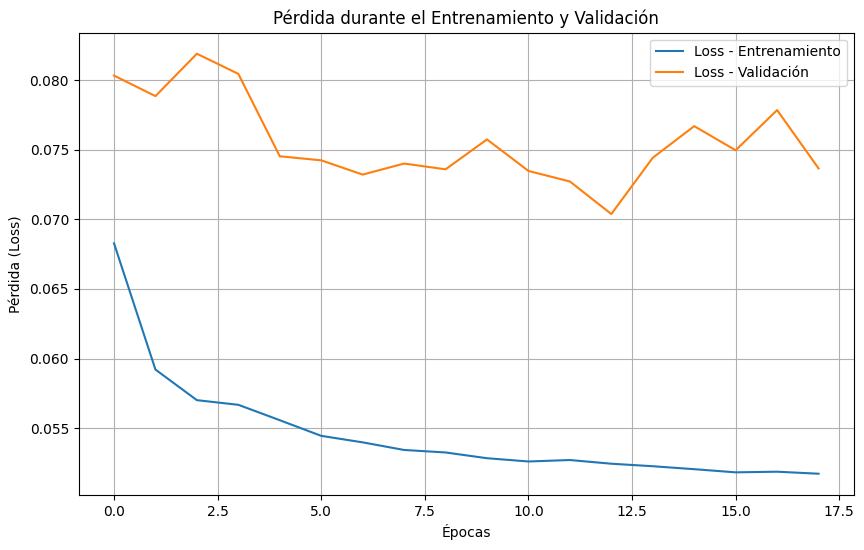

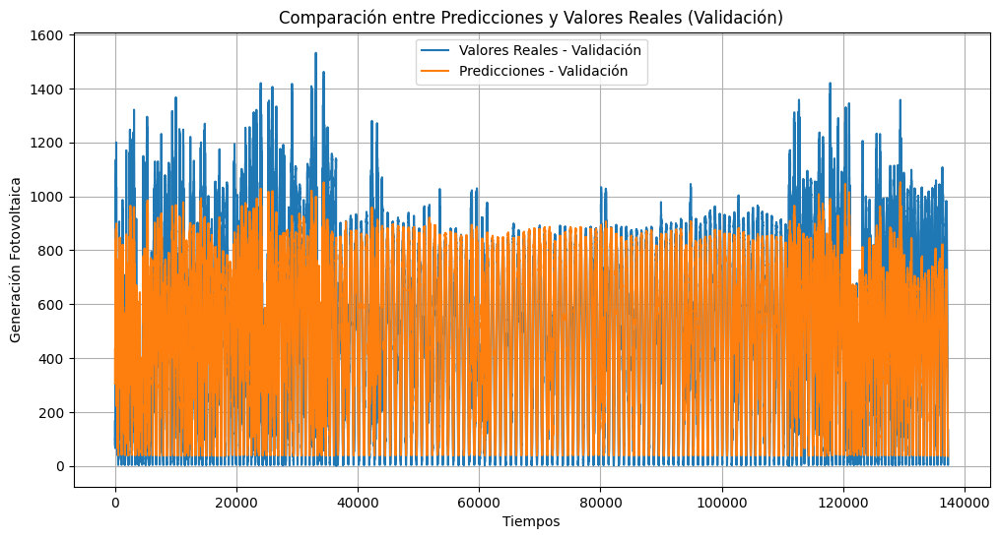

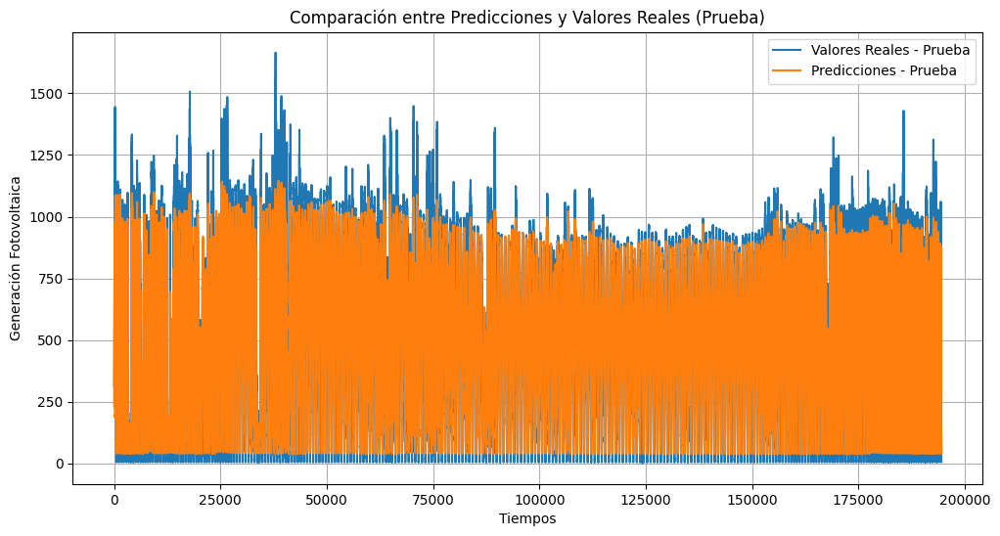

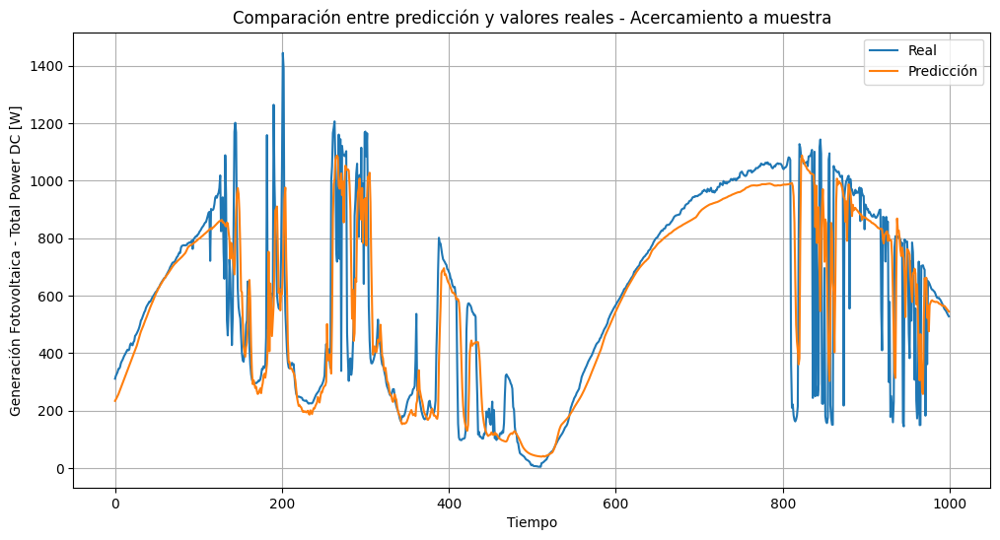

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import numpy as np
import random

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True))
LSTM_model.add(Dropout(0.3))
LSTM_model.add(LSTM(16, return_sequences=True))
LSTM_model.add(Dropout(0.3))
LSTM_model.add(LSTM(8, return_sequences=False))
LSTM_model.add(Dropout(0.3))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo LSTM

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validacion

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdida durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Validación)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Prueba)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.5.2. Red LSTM - Modelo 2**

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 188s 12ms/step - loss: 0.0669 - val_loss: 0.0891
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 196s 12ms/step - loss: 0.0384 - val_loss: 0.0895
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 188s 11ms/step - loss: 0.0347 - val_loss: 0.0876
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 11ms/step - loss: 0.0332 - val_loss: 0.0923
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 166s 11ms/step - loss: 0.0320 - val_loss: 0.0896
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 11ms/step - loss: 0.0310 - val_loss: 0.0889
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 11ms/step - loss: 0.0305 - val_loss: 0.0943
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/step - loss: 0.0302 - val_loss: 0.0882
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 167s 11ms/step - loss: 0.0298 - val_loss: 0.0914
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 201s 11ms/step - loss: 0.0292 - val_loss: 0.0874
Epoch 11/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/ste

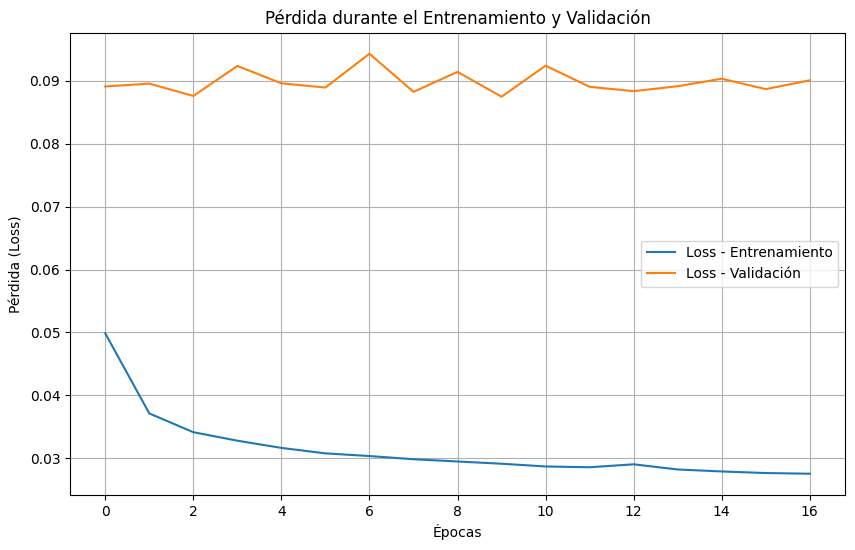

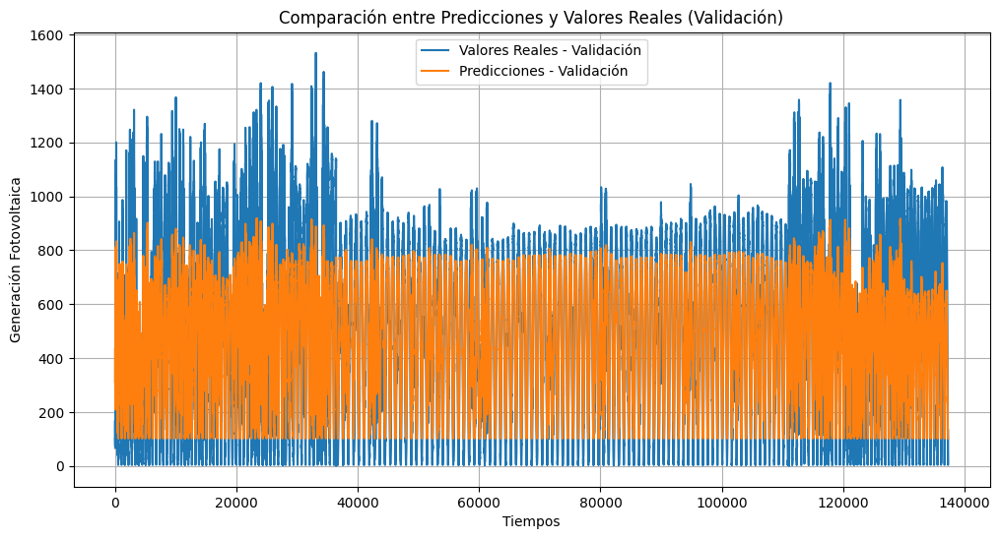

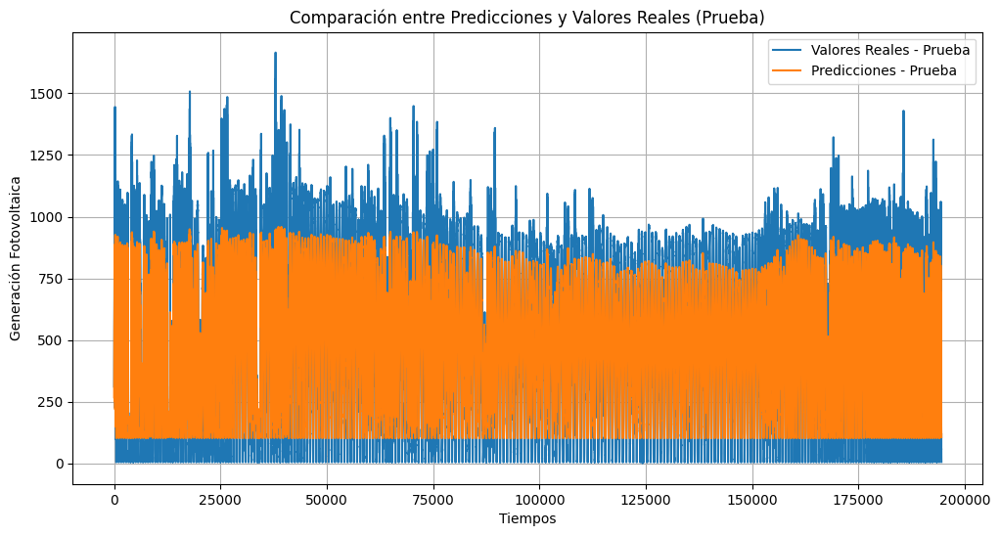

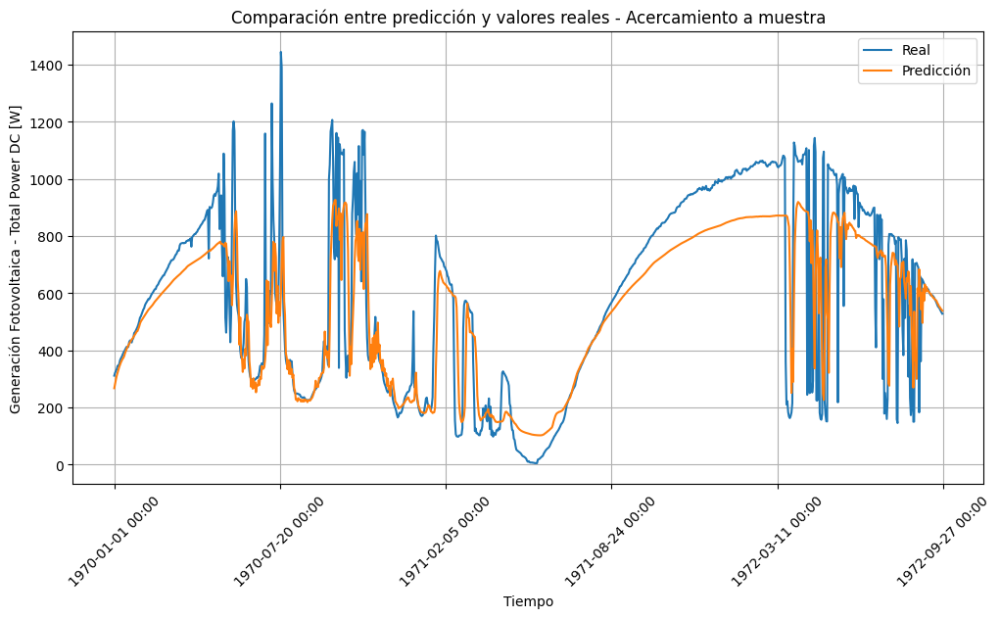

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]
def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True))
LSTM_model.add(Dropout(0.3))
LSTM_model.add(LSTM(16, return_sequences=True))
LSTM_model.add(Dropout(0.3))
LSTM_model.add(LSTM(8, return_sequences=False))
LSTM_model.add(Dropout(0.3))
LSTM_model.add(Dense(16, activation='relu'))
LSTM_model.add(Dense(8, activation='relu'))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)
LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdida durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Validación)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Prueba)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.5.3. Red LSTM - Modelo 3**

Epoch 1/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 381s 12ms/step - loss: 0.0946 - val_loss: 0.1432
Epoch 2/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 382s 12ms/step - loss: 0.0541 - val_loss: 0.1385
Epoch 3/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 344s 11ms/step - loss: 0.0515 - val_loss: 0.1418
Epoch 4/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 382s 11ms/step - loss: 0.0503 - val_loss: 0.1403
Epoch 5/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 382s 11ms/step - loss: 0.0490 - val_loss: 0.1411
Epoch 6/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 382s 11ms/step - loss: 0.0479 - val_loss: 0.1440
Epoch 7/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 382s 11ms/step - loss: 0.0480 - val_loss: 0.1374
Epoch 8/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 382s 11ms/step - loss: 0.0468 - val_loss: 0.1417
Epoch 9/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 391s 12ms/step - loss: 0.0462 - val_loss: 0.1407
Epoch 10/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 372s 11ms/step - loss: 0.0461 - val_loss: 0.1395
Epoch 11/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 383s 11ms/ste

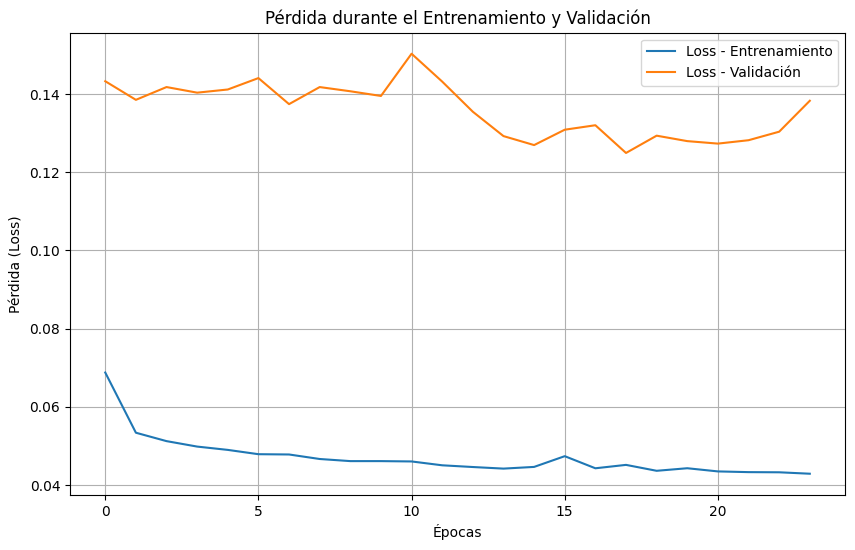

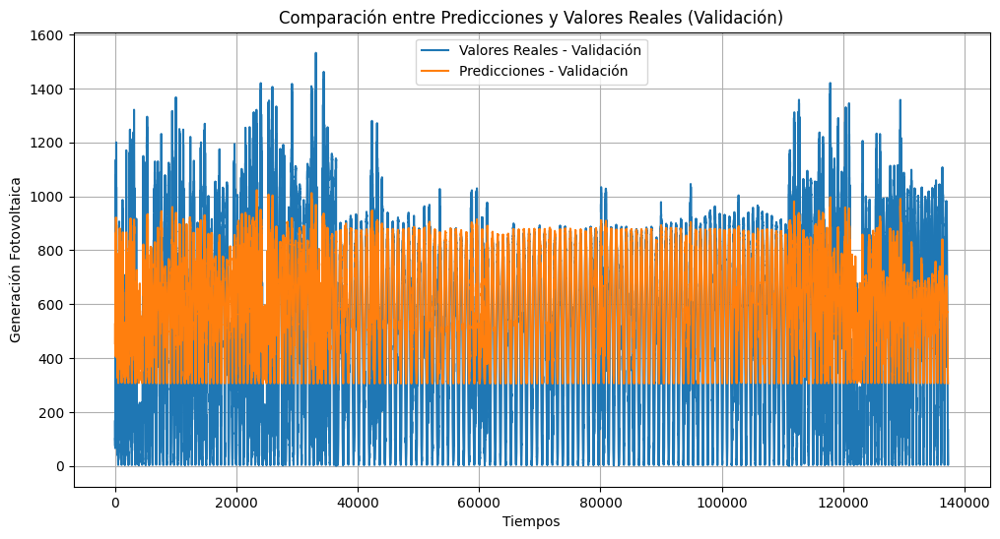

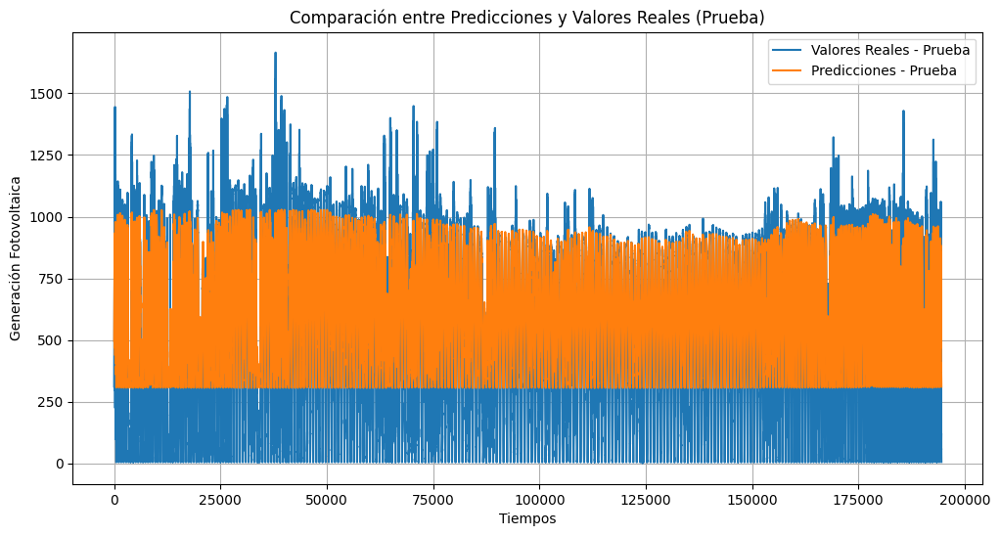

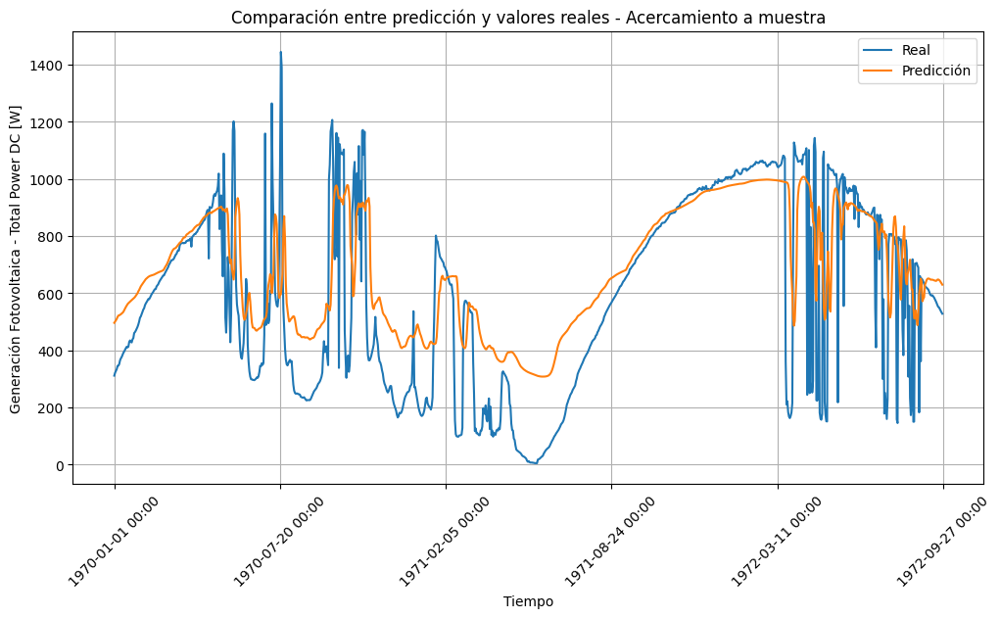

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]
def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(16, activation='relu', kernel_regularizer=l2(0.001)))
LSTM_model.add(Dense(8, activation='relu', kernel_regularizer=l2(0.001)))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.0005)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=16, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdida durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Validación)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Prueba)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.5.4. Red LSTM - Modelo 4**

Epoch 1/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 293s 9ms/step - loss: 0.1483 - val_loss: 0.1078
Epoch 2/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 288s 10ms/step - loss: 0.0696 - val_loss: 0.0791
Epoch 3/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 288s 10ms/step - loss: 0.0660 - val_loss: 0.0805
Epoch 4/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 322s 9ms/step - loss: 0.0638 - val_loss: 0.0928
Epoch 5/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 303s 10ms/step - loss: 0.0624 - val_loss: 0.1063
Epoch 6/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 303s 10ms/step - loss: 0.0618 - val_loss: 0.0885
Epoch 7/100
30280/30280 ━━━━━━━━━━━━━━━━━━━━ 306s 9ms/step - loss: 0.0609 - val_loss: 0.0893
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 13s 3ms/step
6080/6080 ━━━━━━━━━━━━━━━━━━━━ 17s 3ms/step
MAE VALIDACION LSTM: 114.10625942596606
R2 VALIDACION LSTM: 0.7489169028685128
MAE TEST LSTM: 101.16030892876017
R2 TEST LSTM: 0.837413773161626


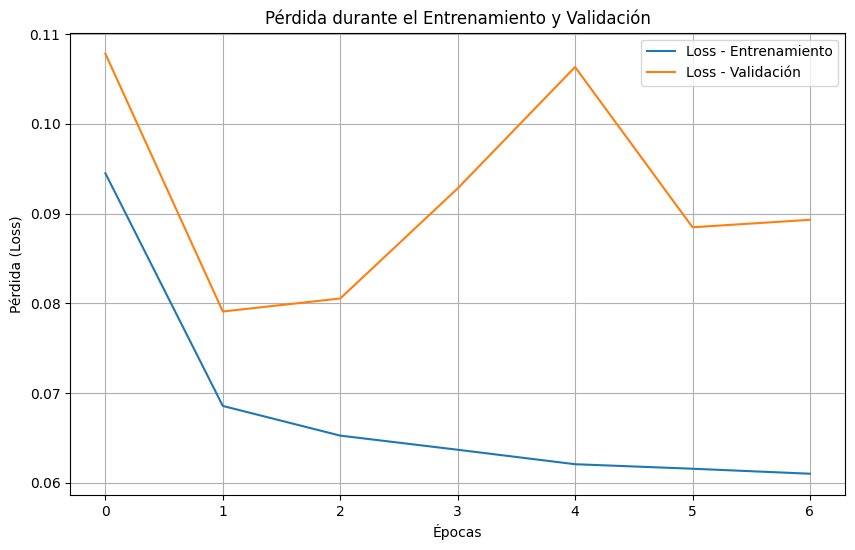

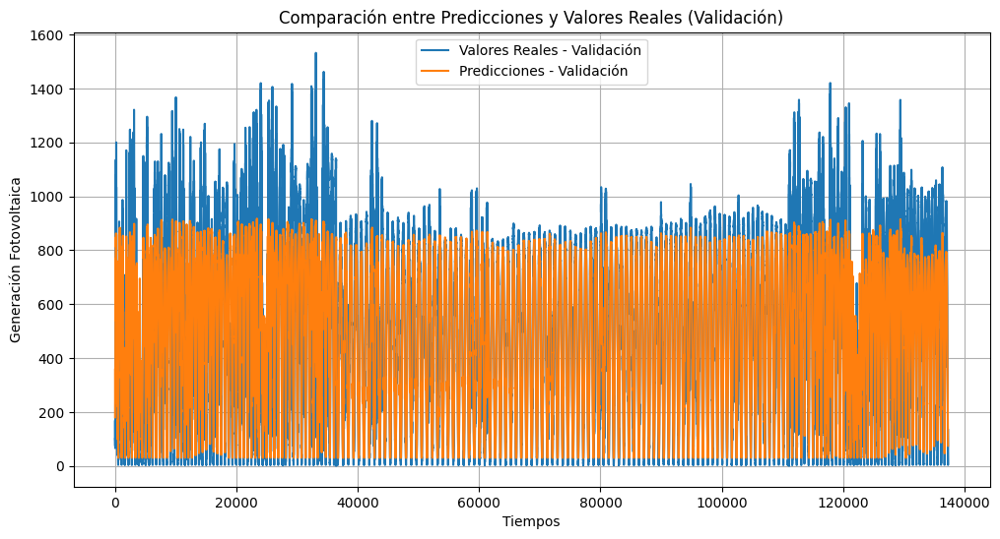

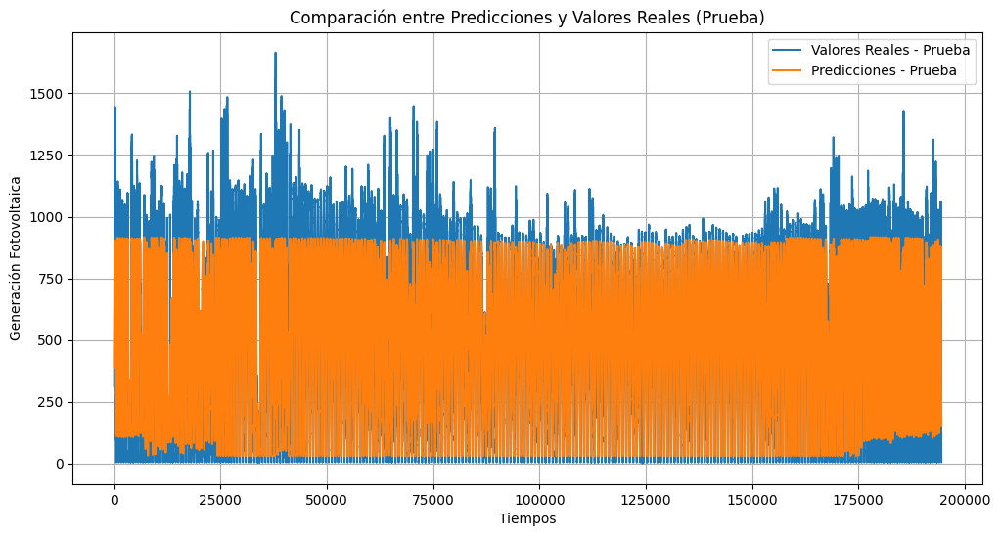

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))


# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]
def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.01)))
LSTM_model.add(Dropout(0.5))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.01)))
LSTM_model.add(Dropout(0.5))
LSTM_model.add(Dense(16, activation='relu', kernel_regularizer=l2(0.01)))
LSTM_model.add(Dense(8, activation='relu', kernel_regularizer=l2(0.01)))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.0005)
LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=16, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdida durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Validación)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Prueba)')
plt.xlabel('Tiempos')
plt.ylabel('Generación Fotovoltaica')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
df_Generacion_fil3 = df_Generacion_fil2.loc['2014-01-01':'2015-12-31']

train_longitud = int (len(df_Generacion_fil3)*0.80)
df_train, df_validacion = df_Generacion_fil3[:train_longitud], df_Generacion_fil3[train_longitud:]

X_train = df_train.drop('Total Power DC [W]', axis=1)
X_val = df_validacion.drop('Total Power DC [W]', axis=1)
y_train = df_train ['Total Power DC [W]']
y_val = df_validacion ['Total Power DC [W]']

X_train

,Ambient Temperature [ÂºC],Global Radiation [W/m2],Diffuse Radiation [W/m2],Ultraviolet [W/m2],Wind Velocity [m/s],Year,Day,Minute,Month_Sen,Month_Cos,Hour_Sen,Hour_Cos,Day of Week_Sen,Day of Week_Cos,Wind_Dir_Sen,Wind_Dir_Cos
Datetime,,,,,,,,,,,,,,,,
2014-01-01 07:41:00,9.700000,7.131149,6.929149,0.751824,0.700000,2014,1,41,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.995670,0.092959
2014-01-01 07:42:00,9.700000,7.040442,6.847878,0.781930,0.666667,2014,1,42,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.989008,0.147862
2014-01-01 07:43:00,9.700000,6.594407,6.672844,0.813929,0.616667,2014,1,43,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.967413,0.253203
2014-01-01 07:44:00,9.700000,7.358729,6.752742,0.849919,0.666667,2014,1,44,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.988582,0.150686
2014-01-01 07:45:00,9.700000,7.470711,7.181158,0.886891,0.633333,2014,1,45,5.000000e-01,0.866025,0.965926,-0.258819,0.974928,-0.222521,-0.998917,0.046520
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-06-24 11:28:00,22.916666,979.199920,95.971200,62.713140,3.033334,2015,24,28,1.224647e-16,-1.000000,0.258819,-0.965926,0.974928,-0.222521,-0.752745,-0.658312
2015-06-24 11:29:00,22.949998,980.007840,97.355352,62.757992,4.183334,2015,24,29,1.224647e-16,-1.000000,0.258819,-0.965926,0.974928,-0.222521,-0.904739,-0.425966
2015-06-24 11:30:00,22.900000,984.907440,99.829784,62.912168,3.133333,2015,24,30,1.224647e-16,-1.000000,0.258819,-0.965926,0.974928,-0.222521,-0.903483,-0.428623


**4.5.5. Red LSTM - Modelo 5**

Epoch 1/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 143s 12ms/step - loss: 0.1117 - val_loss: 0.0364
Epoch 2/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 145s 12ms/step - loss: 0.0806 - val_loss: 0.0393
Epoch 3/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 197s 11ms/step - loss: 0.0797 - val_loss: 0.0508
Epoch 4/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 141s 11ms/step - loss: 0.0789 - val_loss: 0.0417
Epoch 5/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 141s 11ms/step - loss: 0.0774 - val_loss: 0.0426
Epoch 6/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 143s 11ms/step - loss: 0.0776 - val_loss: 0.0332
Epoch 7/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 138s 11ms/step - loss: 0.0769 - val_loss: 0.0364
Epoch 8/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 138s 11ms/step - loss: 0.0762 - val_loss: 0.0344
Epoch 9/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 143s 11ms/step - loss: 0.0765 - val_loss: 0.0351
Epoch 10/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 141s 11ms/step - loss: 0.0767 - val_loss: 0.0328
Epoch 11/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 142s 11ms/ste

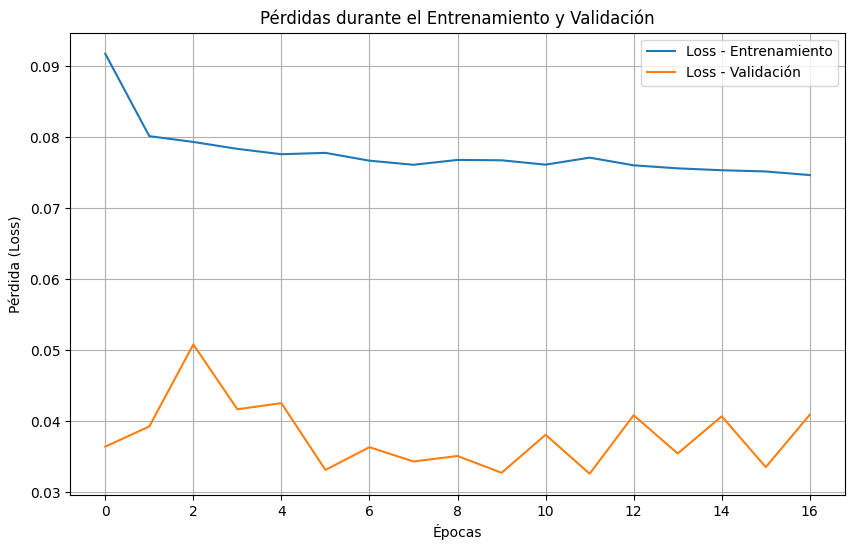

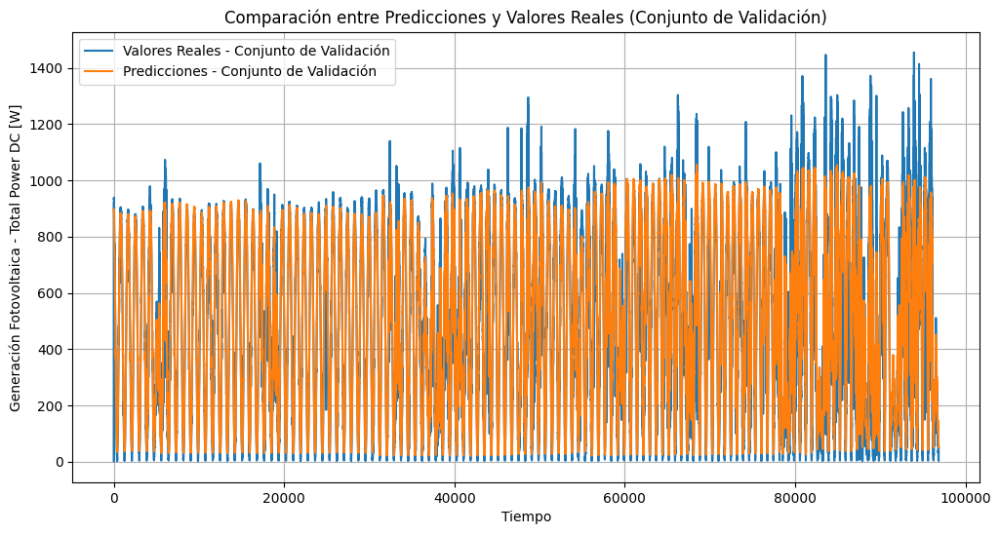

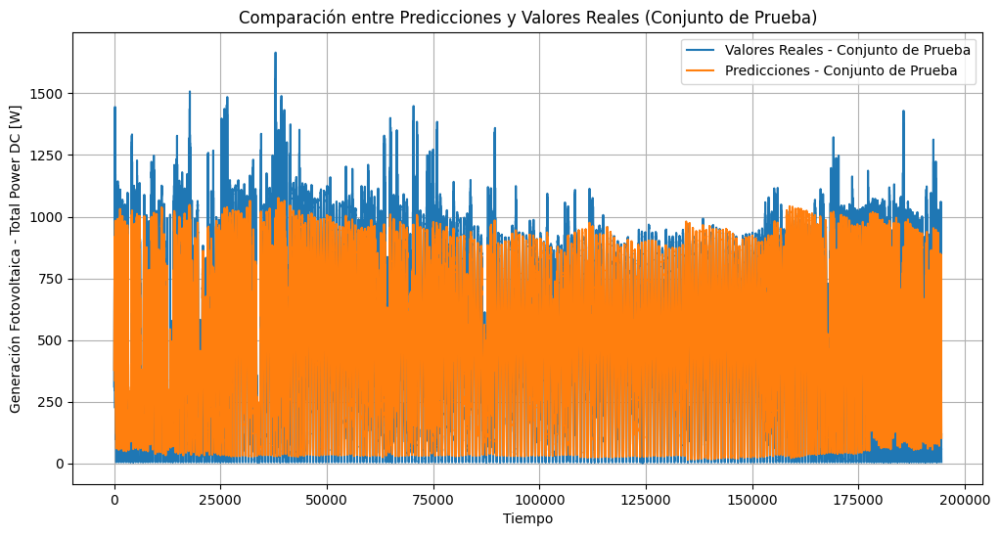

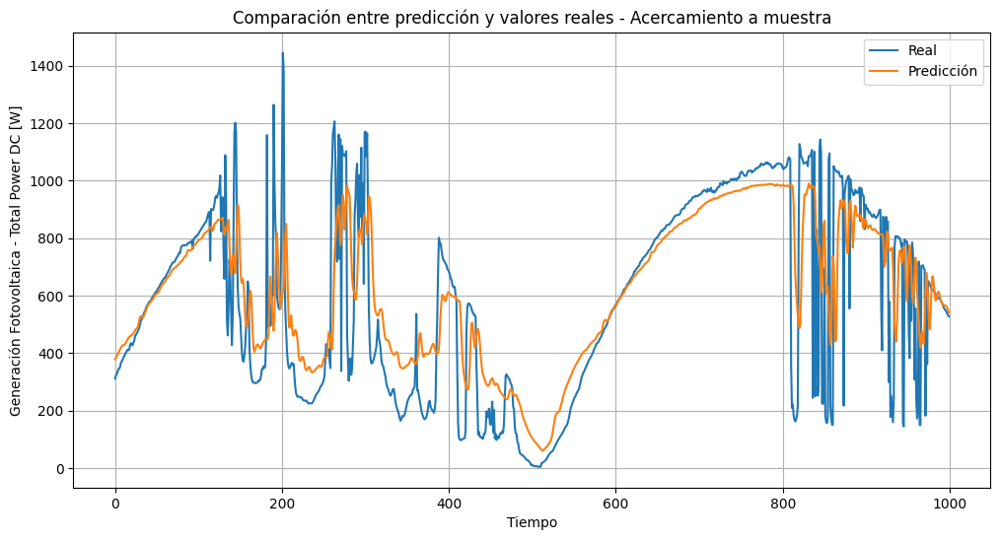

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear la arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

La red aplicada sin la variable de Ultraviolet [W/m2]

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 191s 12ms/step - loss: 0.1024 - val_loss: 0.0898
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 172s 10ms/step - loss: 0.0769 - val_loss: 0.0886
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 10ms/step - loss: 0.0754 - val_loss: 0.0886
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 207s 11ms/step - loss: 0.0744 - val_loss: 0.0861
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 197s 10ms/step - loss: 0.0735 - val_loss: 0.0882
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 10ms/step - loss: 0.0730 - val_loss: 0.0702
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 161s 11ms/step - loss: 0.0757 - val_loss: 0.0809
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 200s 11ms/step - loss: 0.0727 - val_loss: 0.0920
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 201s 11ms/step - loss: 0.0728 - val_loss: 0.0766
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 11ms/step - loss: 0.0723 - val_loss: 0.0815
Epoch 11/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/ste

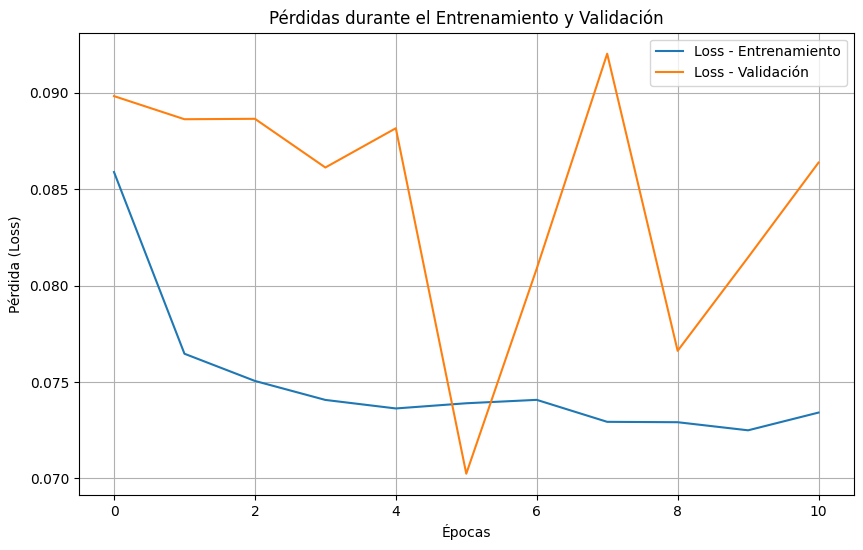

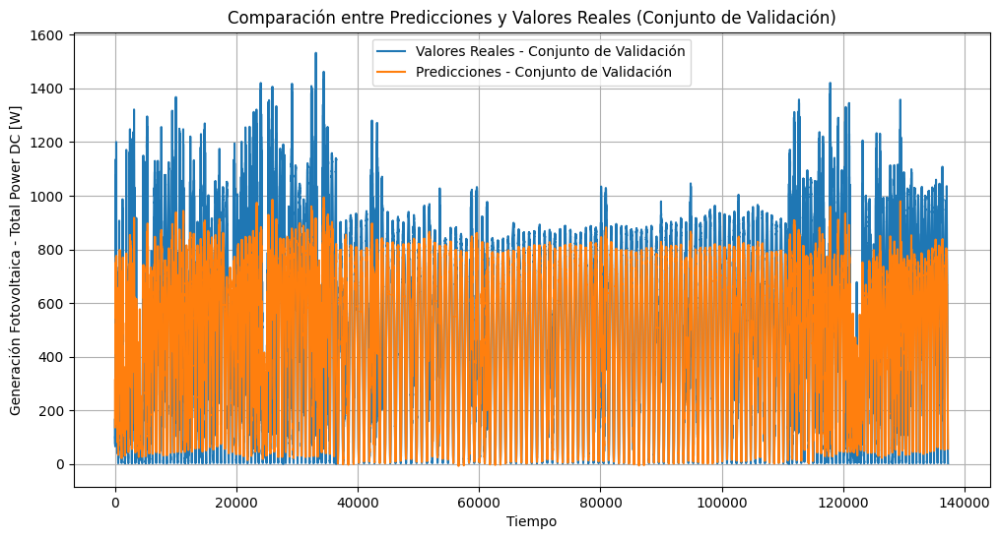

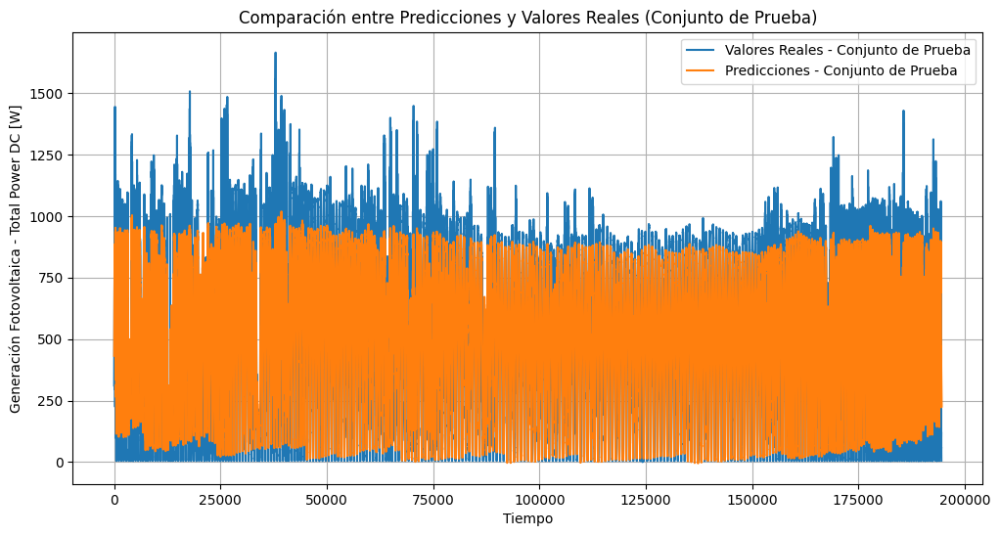

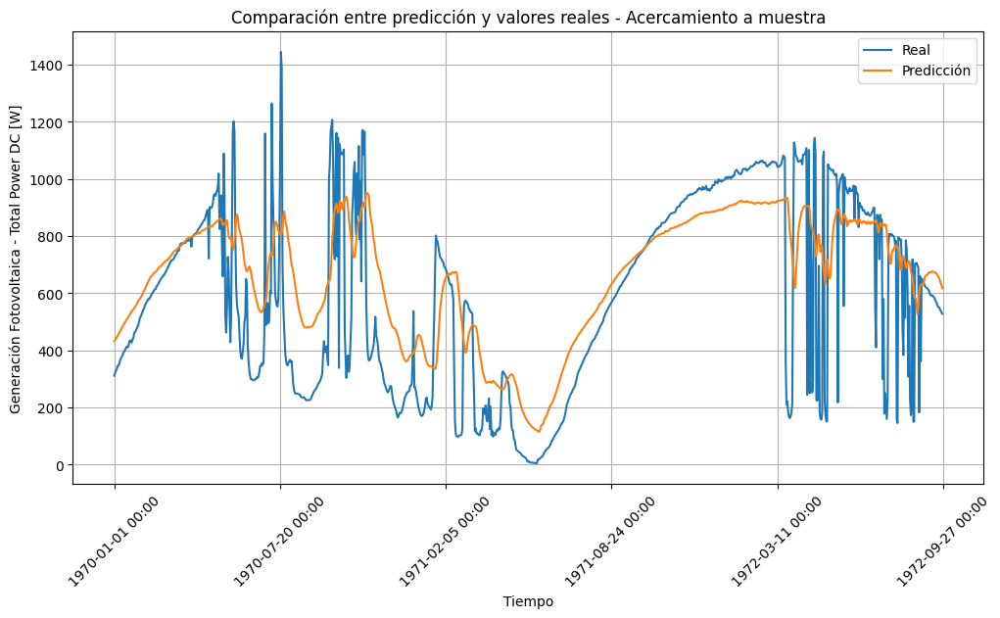

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_su)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear la arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 171s 11ms/step - loss: 0.1005 - val_loss: 0.0868
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 11ms/step - loss: 0.0772 - val_loss: 0.0969
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 11ms/step - loss: 0.0765 - val_loss: 0.1151
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 201s 11ms/step - loss: 0.0762 - val_loss: 0.0990
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/step - loss: 0.0760 - val_loss: 0.0913
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/step - loss: 0.0746 - val_loss: 0.1066
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 15s 3ms/step
6080/6080 ━━━━━━━━━━━━━━━━━━━━ 21s 3ms/step
MAE VALIDACION LSTM: 132.21098413800246
R2 VALIDACION LSTM: 0.7159085631682058
MAE TEST LSTM: 93.63407662012841
R2 TEST LSTM: 0.8455681228102354


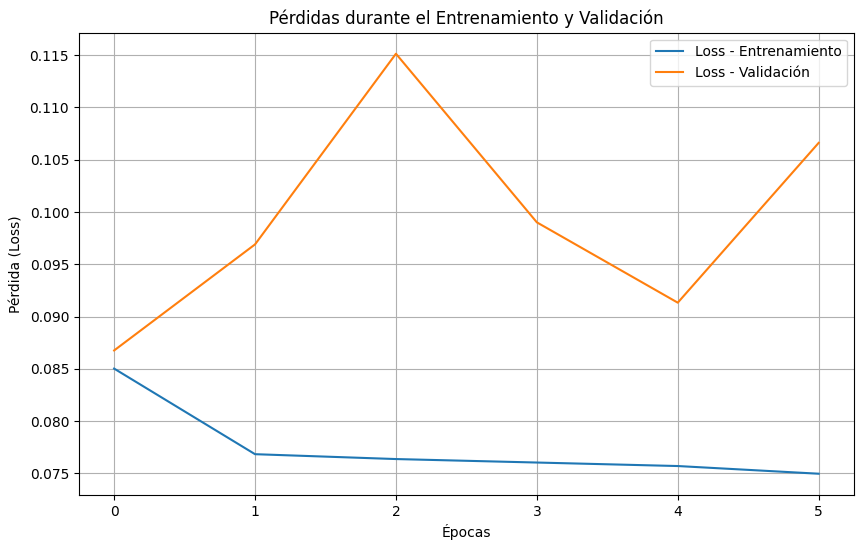

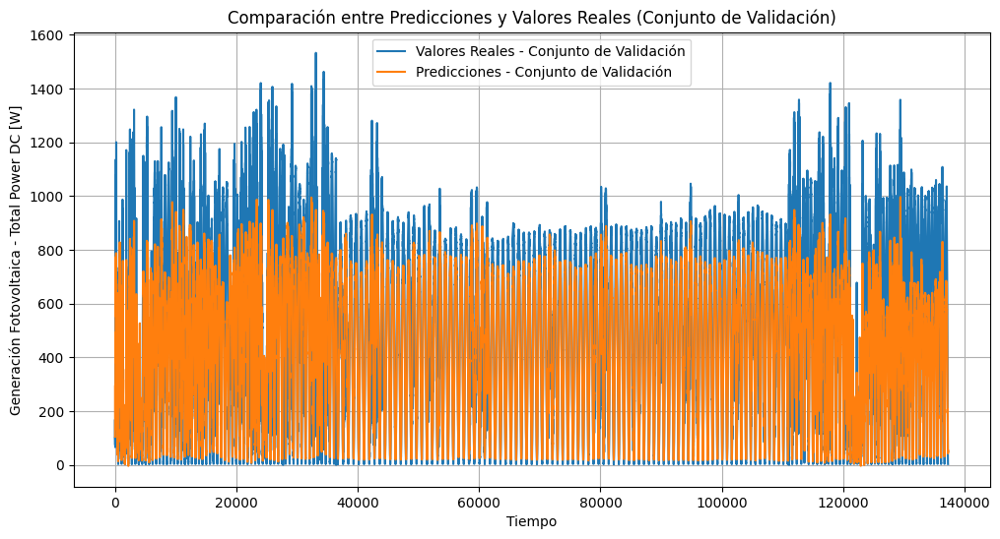

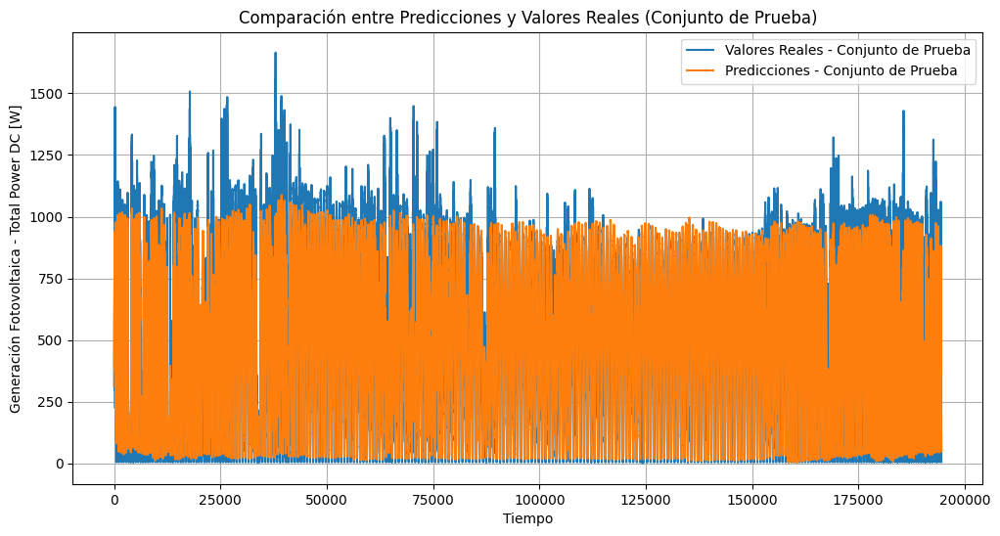

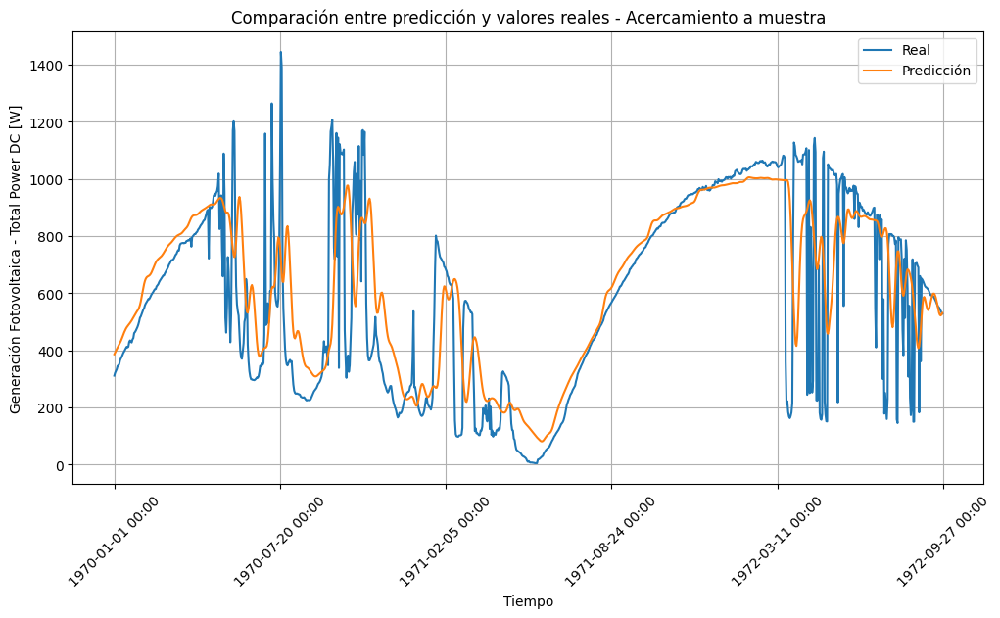

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_su)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear la arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 175s 11ms/step - loss: 0.1015 - val_loss: 0.0967
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 196s 11ms/step - loss: 0.0770 - val_loss: 0.0984
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 167s 11ms/step - loss: 0.0754 - val_loss: 0.0969
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 202s 11ms/step - loss: 0.0746 - val_loss: 0.0894
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 201s 11ms/step - loss: 0.0737 - val_loss: 0.0884
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/step - loss: 0.0735 - val_loss: 0.0930
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 207s 11ms/step - loss: 0.0742 - val_loss: 0.0897
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 197s 11ms/step - loss: 0.0748 - val_loss: 0.0835
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 167s 11ms/step - loss: 0.0735 - val_loss: 0.0995
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/step - loss: 0.0728 - val_loss: 0.0925
Epoch 11/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 201s 11ms/ste

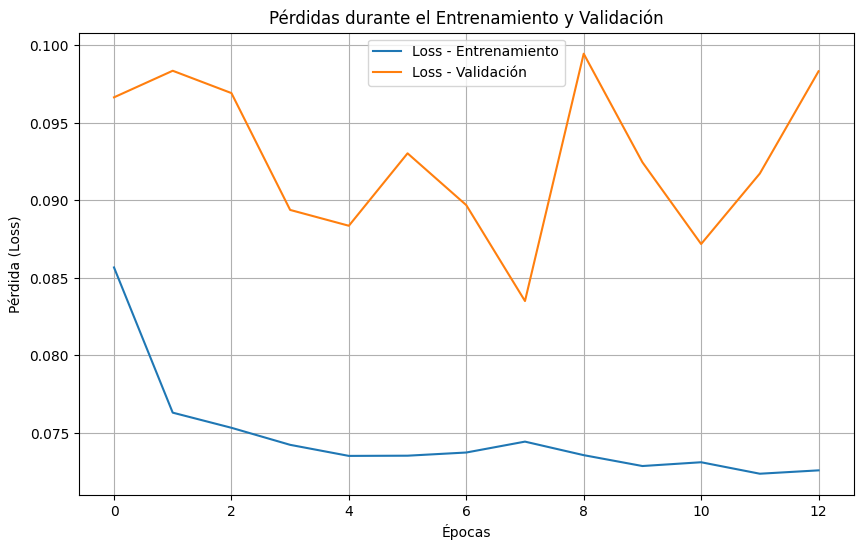

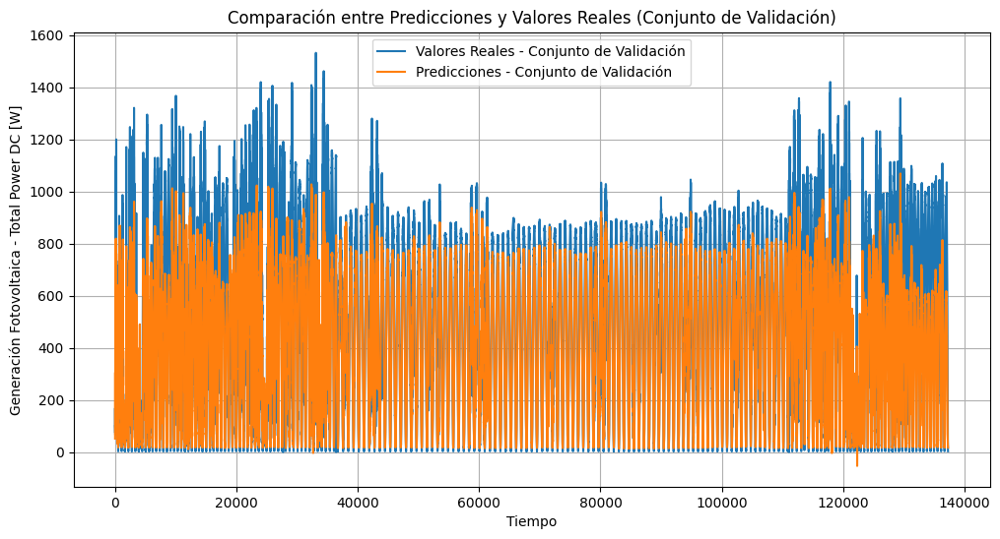

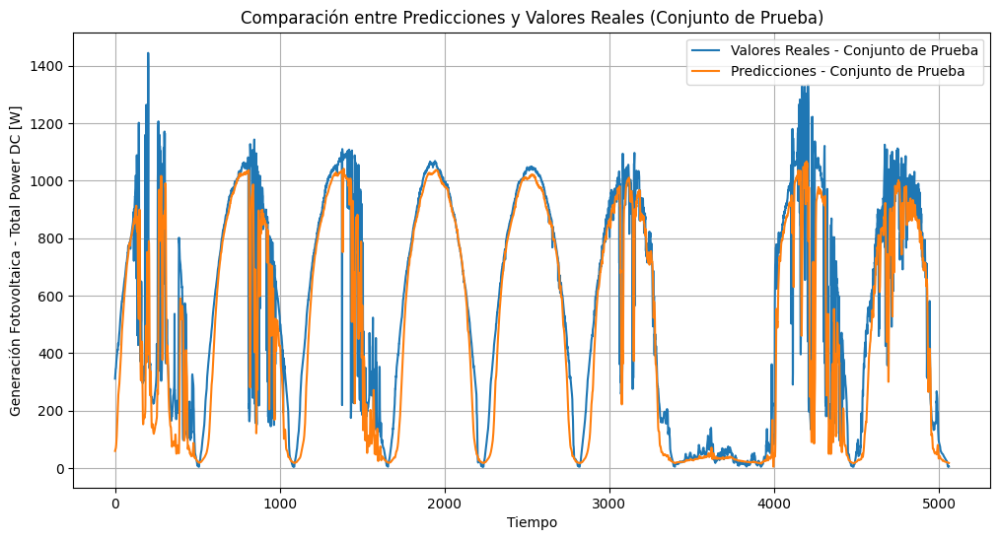

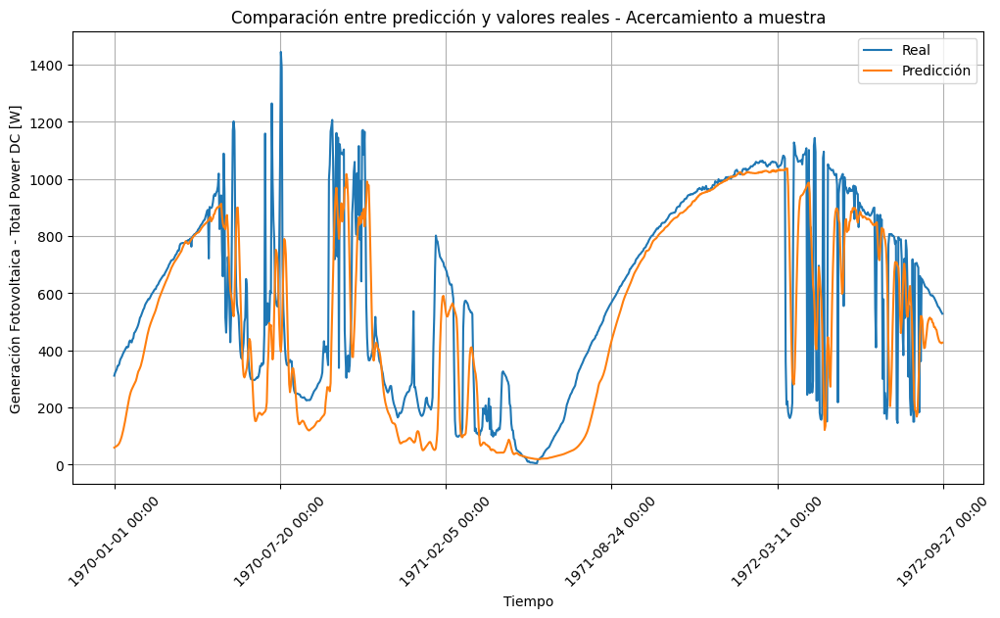

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_sus1)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017_s1.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear la arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 174s 11ms/step - loss: 0.1013 - val_loss: 0.0846
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 198s 11ms/step - loss: 0.0772 - val_loss: 0.0834
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 169s 11ms/step - loss: 0.0757 - val_loss: 0.0925
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 201s 11ms/step - loss: 0.0745 - val_loss: 0.1057
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/step - loss: 0.0740 - val_loss: 0.0985
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 203s 11ms/step - loss: 0.0739 - val_loss: 0.0821
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 216s 12ms/step - loss: 0.0732 - val_loss: 0.0878
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 321s 20ms/step - loss: 0.0737 - val_loss: 0.0858
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 221s 13ms/step - loss: 0.0731 - val_loss: 0.1062
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 364s 20ms/step - loss: 0.0732 - val_loss: 0.0815
Epoch 11/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 187s 11ms/ste

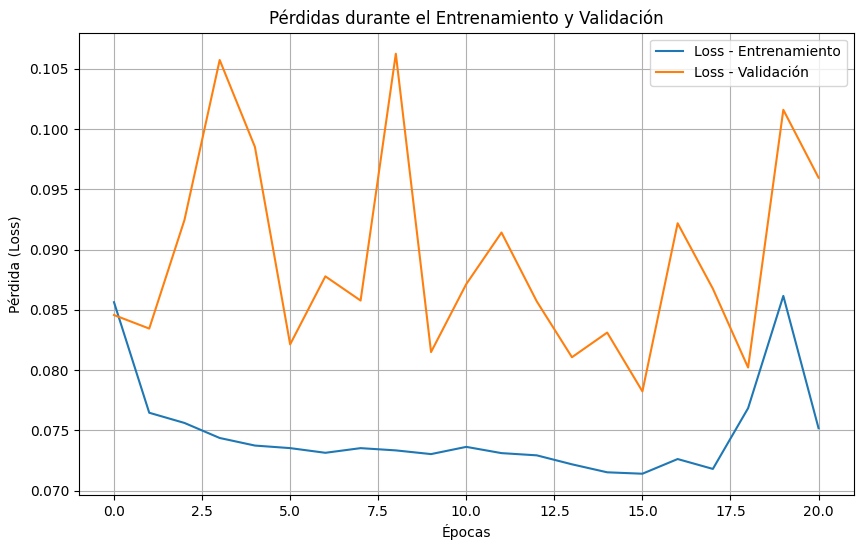

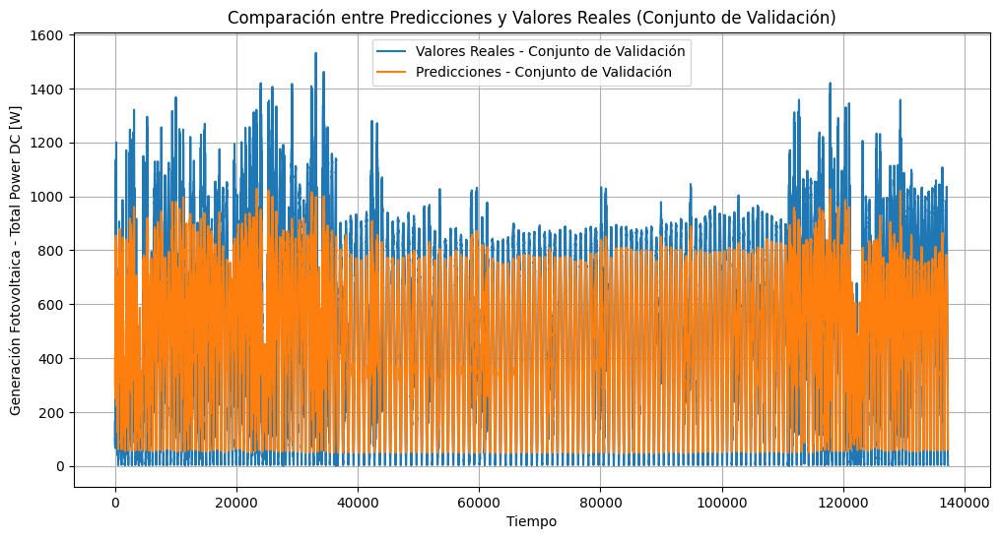

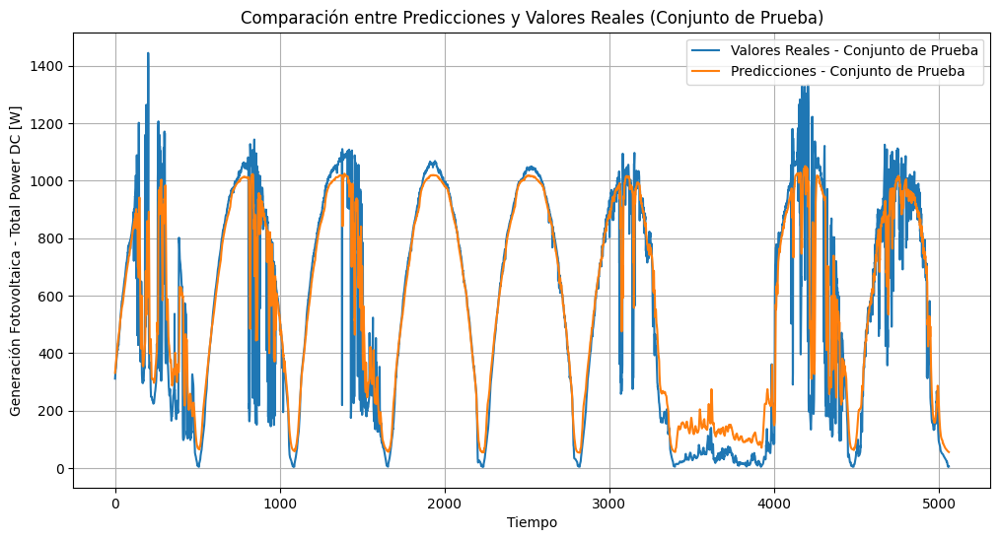

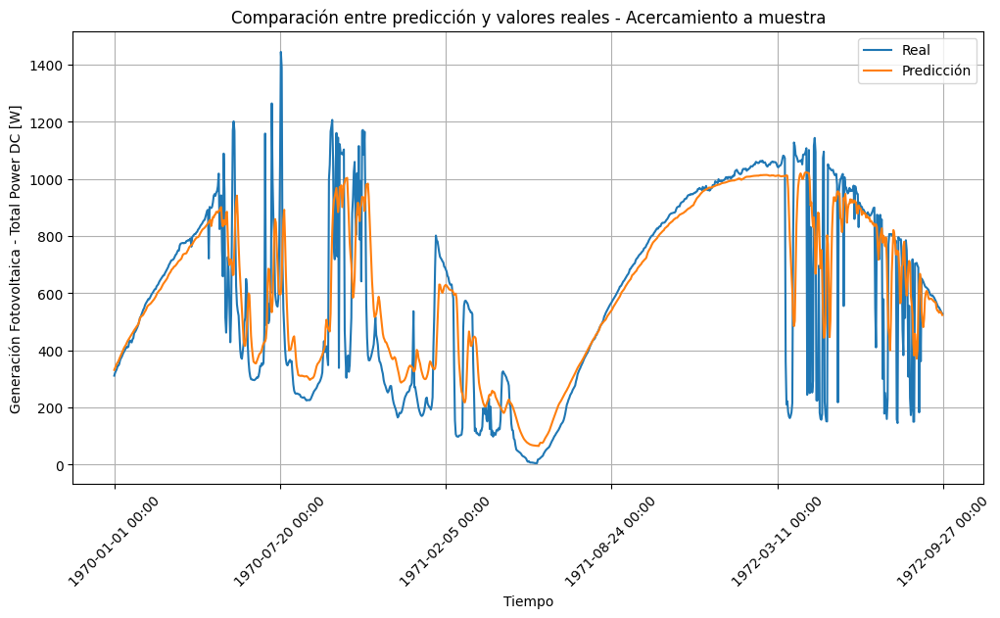

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random
import matplotlib.dates as mdates

tf.keras.backend.clear_session()

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017_s1)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017_s1.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear la arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show()

**4.5.6. Red LSTM - Modelo 6**

Epoch 1/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 256s 10ms/step - loss: 0.1017 - val_loss: 0.0854
Epoch 2/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 275s 11ms/step - loss: 0.0601 - val_loss: 0.0736
Epoch 3/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 300s 10ms/step - loss: 0.0571 - val_loss: 0.0749
Epoch 4/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 264s 10ms/step - loss: 0.0550 - val_loss: 0.0804
Epoch 5/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 267s 10ms/step - loss: 0.0551 - val_loss: 0.0769
Epoch 6/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 249s 10ms/step - loss: 0.0534 - val_loss: 0.0778
Epoch 7/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 259s 10ms/step - loss: 0.0526 - val_loss: 0.0791
Epoch 8/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 247s 10ms/step - loss: 0.0516 - val_loss: 0.0846
Epoch 9/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 263s 10ms/step - loss: 0.0511 - val_loss: 0.0797
Epoch 10/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 262s 10ms/step - loss: 0.0516 - val_loss: 0.0790
Epoch 11/100
24223/24223 ━━━━━━━━━━━━━━━━━━━━ 247s 10ms/ste

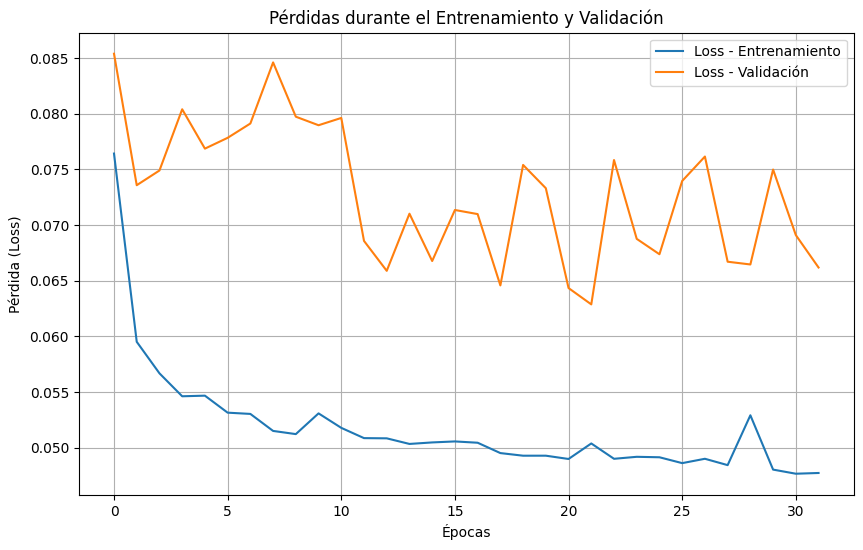

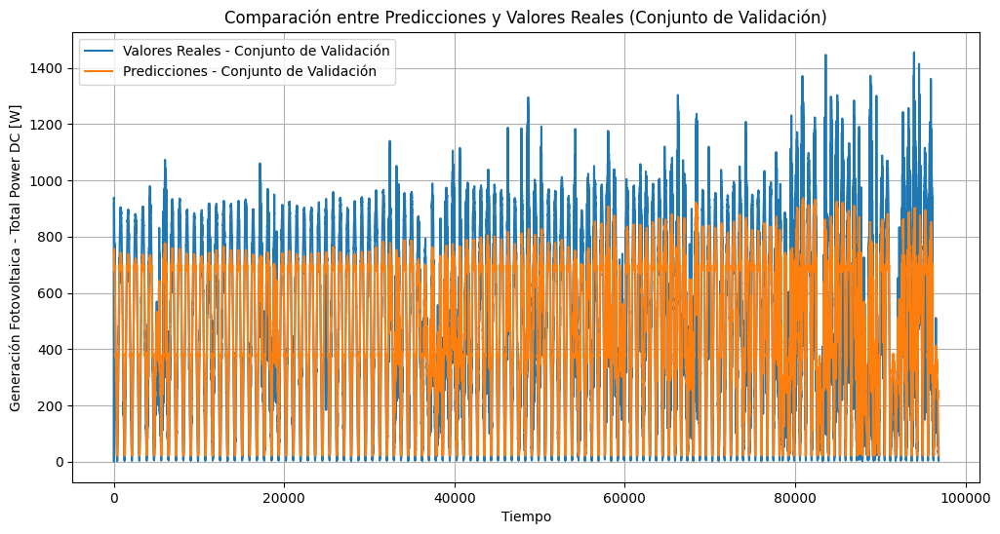

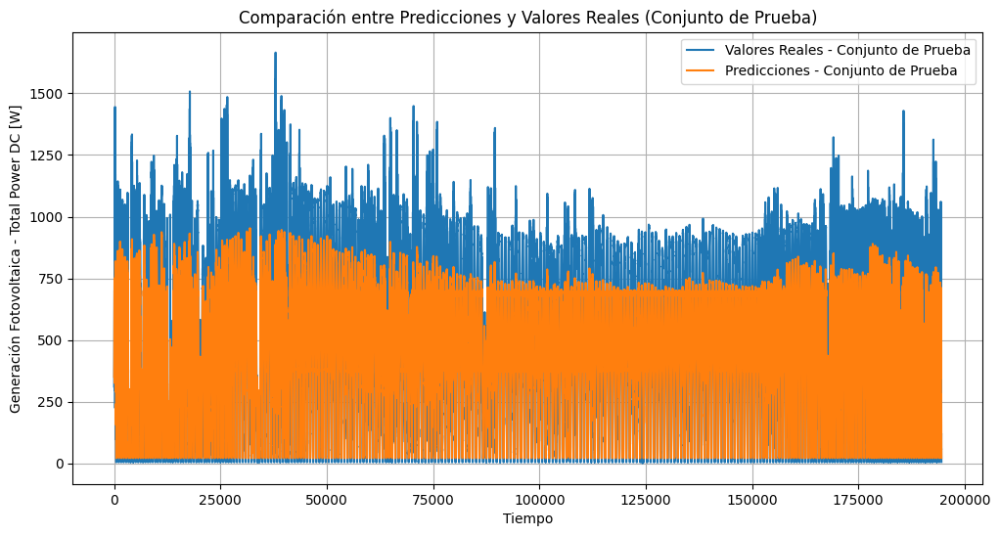

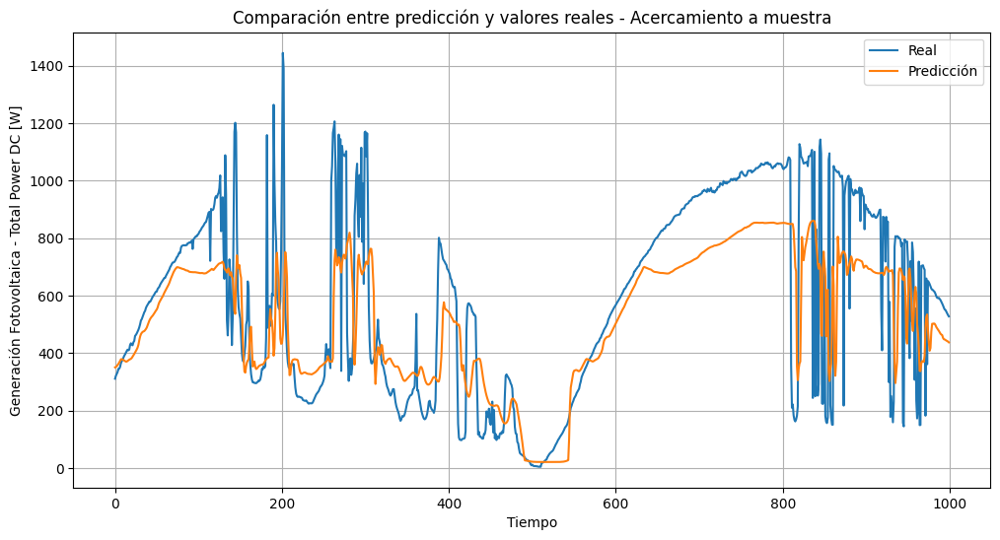

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]
def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(32, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.5))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(8, activation='relu', kernel_regularizer=l2(0.001)))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.0005)
LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=16, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.5.7. Red LSTM - Modelo 7**

Epoch 1/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 104s 8ms/step - loss: 0.1127 - val_loss: 0.0404
Epoch 2/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 140s 8ms/step - loss: 0.0797 - val_loss: 0.0366
Epoch 3/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 141s 8ms/step - loss: 0.0778 - val_loss: 0.0358
Epoch 4/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0777 - val_loss: 0.0462
Epoch 5/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 97s 8ms/step - loss: 0.0768 - val_loss: 0.0384
Epoch 6/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0765 - val_loss: 0.0382
Epoch 7/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 145s 8ms/step - loss: 0.0756 - val_loss: 0.0432
Epoch 8/100
12112/12112 ━━━━━━━━━━━━━━━━━━━━ 145s 9ms/step - loss: 0.0760 - val_loss: 0.0457
3027/3027 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step
6080/6080 ━━━━━━━━━━━━━━━━━━━━ 16s 3ms/step
MAE VALIDACION LSTM: 52.2104797511066
R2 VALIDACION LSTM: 0.9362275998736079
MAE TEST LSTM: 103.62076964016988
R2 TEST LSTM: 0.8409326423133219


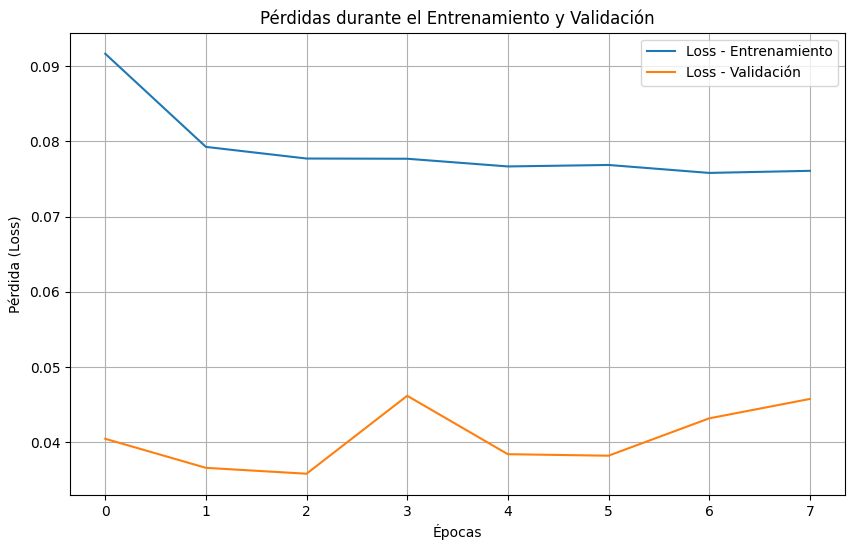

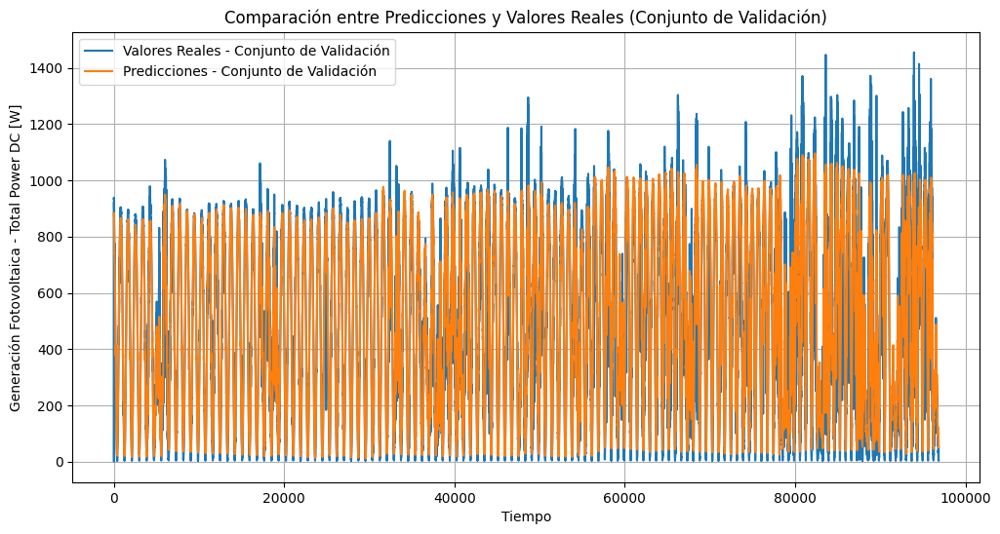

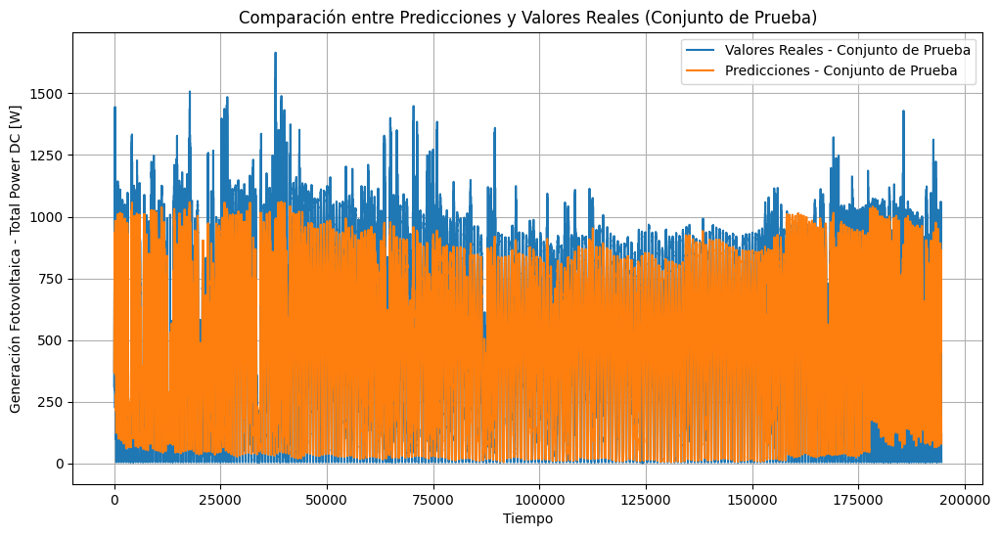

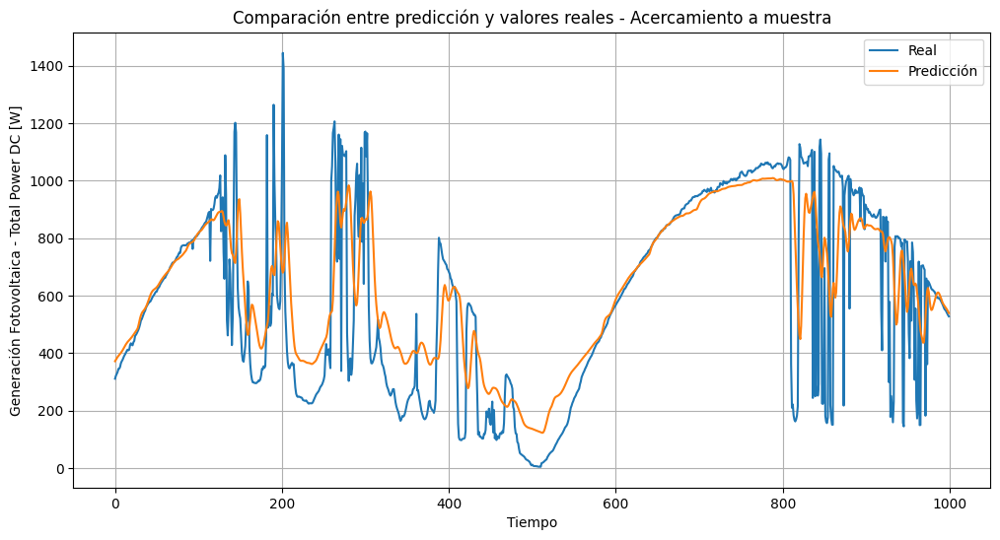

In [ ]:
from keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))


# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo LSTM

LSTM_model = Sequential()
LSTM_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
LSTM_model.add(LSTM(16, return_sequences=True, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(LSTM(8, return_sequences=False, kernel_regularizer=l2(0.001)))
LSTM_model.add(Dropout(0.4))
LSTM_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)

LSTM_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = LSTM_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = LSTM_model.predict(X_val_seq)
y_pred_test = LSTM_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION LSTM: {mae_val}')
print(f'R2 VALIDACION LSTM: {r2_val}')
print(f'MAE TEST LSTM: {mae_test}')
print(f'R2 TEST LSTM: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.6. Modelos Red GRU**

**4.6.1. Red GRU - Modelo 1**

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 123s 8ms/step - loss: 0.0702 - val_loss: 0.0824
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 139s 8ms/step - loss: 0.0465 - val_loss: 0.0776
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 141s 8ms/step - loss: 0.0439 - val_loss: 0.0805
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 143s 8ms/step - loss: 0.0420 - val_loss: 0.0752
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0407 - val_loss: 0.0776
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 117s 8ms/step - loss: 0.0398 - val_loss: 0.0739
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 117s 8ms/step - loss: 0.0396 - val_loss: 0.0720
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 145s 8ms/step - loss: 0.0390 - val_loss: 0.0728
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 141s 8ms/step - loss: 0.0384 - val_loss: 0.0777
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 141s 8ms/step - loss: 0.0383 - val_loss: 0.0736
Epoch 11/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 143s 8ms/step - loss: 0

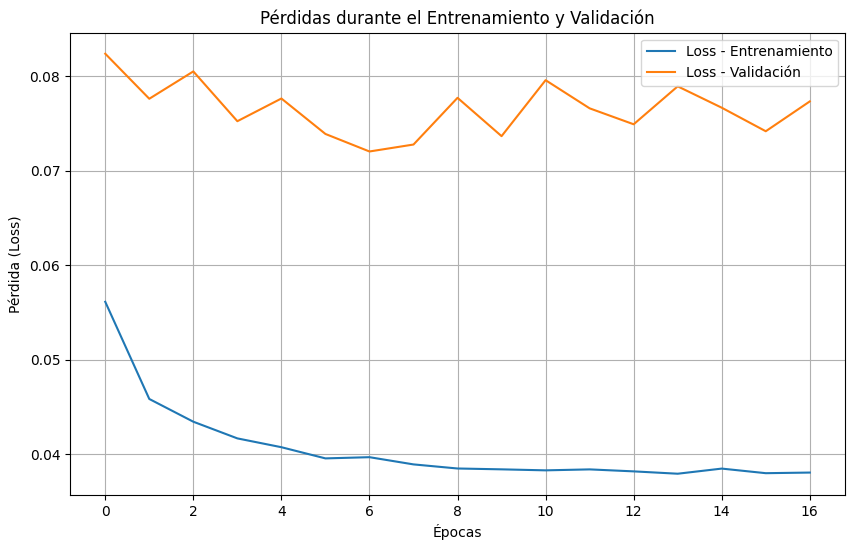

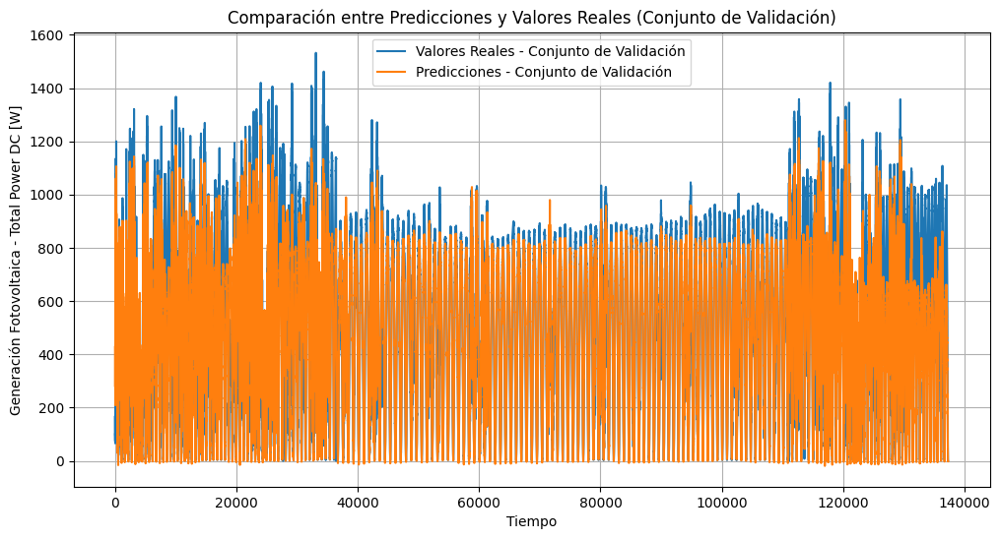

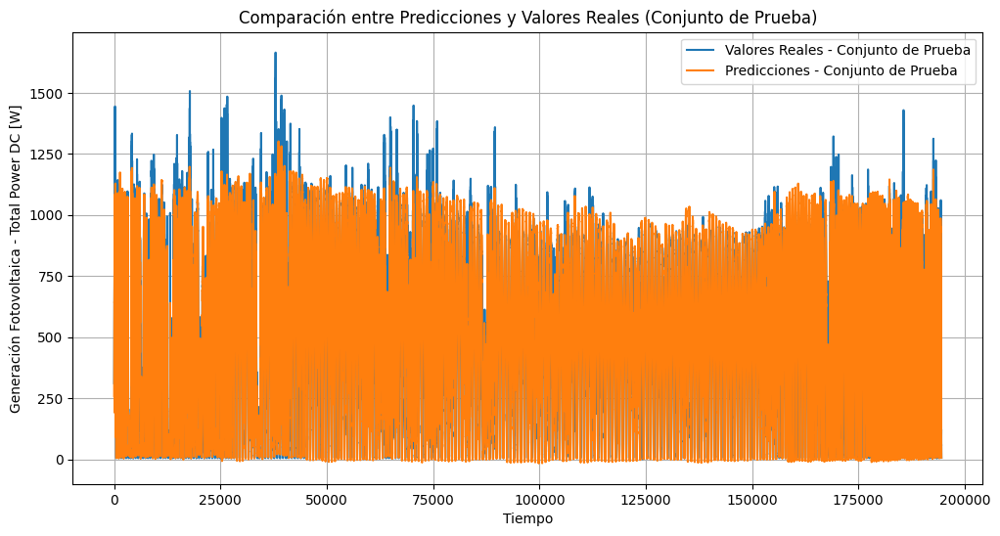

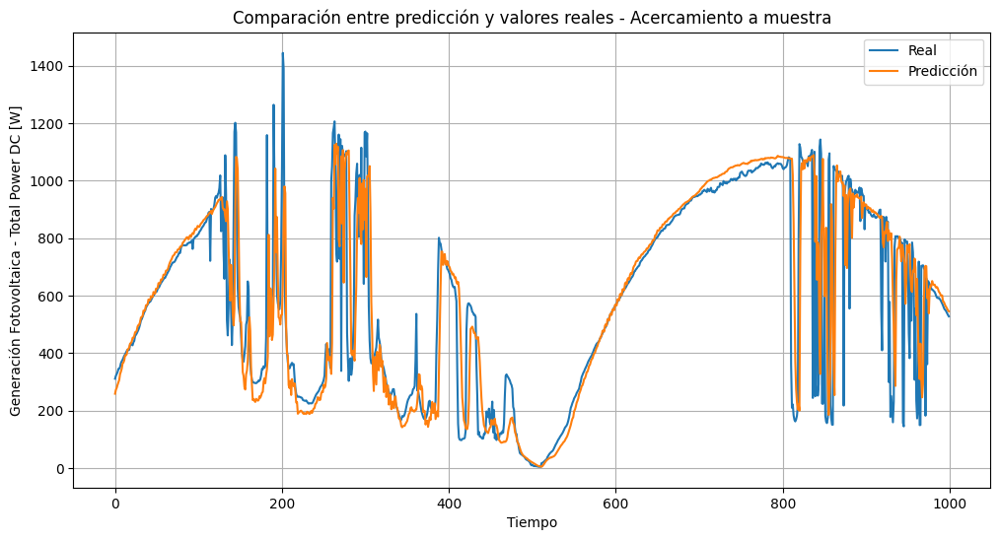

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import random
import tensorflow as tf
import numpy as np

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo GRU

GRU_model = Sequential()
GRU_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
GRU_model.add(GRU(64, return_sequences=True))
GRU_model.add(Dropout(0.3))
GRU_model.add(GRU(32, return_sequences=False))
GRU_model.add(Dropout(0.3))
GRU_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)
GRU_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = GRU_model.fit(X_train_seq, y_train_seq, epochs=100, batch_size=32,
                        validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = GRU_model.predict(X_val_seq)
y_pred_test = GRU_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION GRU: {mae_val}')
print(f'R2 VALIDACION GRU: {r2_val}')
print(f'MAE TEST GRU: {mae_test}')
print(f'R2 TEST GRU: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.6.2. Red GRU - Modelo 2**

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 169s 11ms/step - loss: 0.0693 - val_loss: 0.0707
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 164s 11ms/step - loss: 0.0465 - val_loss: 0.0746
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 160s 11ms/step - loss: 0.0442 - val_loss: 0.0763
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 218s 12ms/step - loss: 0.0417 - val_loss: 0.0840
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 158s 10ms/step - loss: 0.0408 - val_loss: 0.0930
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 171s 8ms/step - loss: 0.0402 - val_loss: 0.0870
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step
6080/6080 ━━━━━━━━━━━━━━━━━━━━ 16s 3ms/step
MAE VALIDACION GRU: 112.46783988534013
R2 VALIDACION GRU: 0.7524110826449169
MAE TEST GRU: 98.86223179095148
R2 TEST GRU: 0.8401009442946361


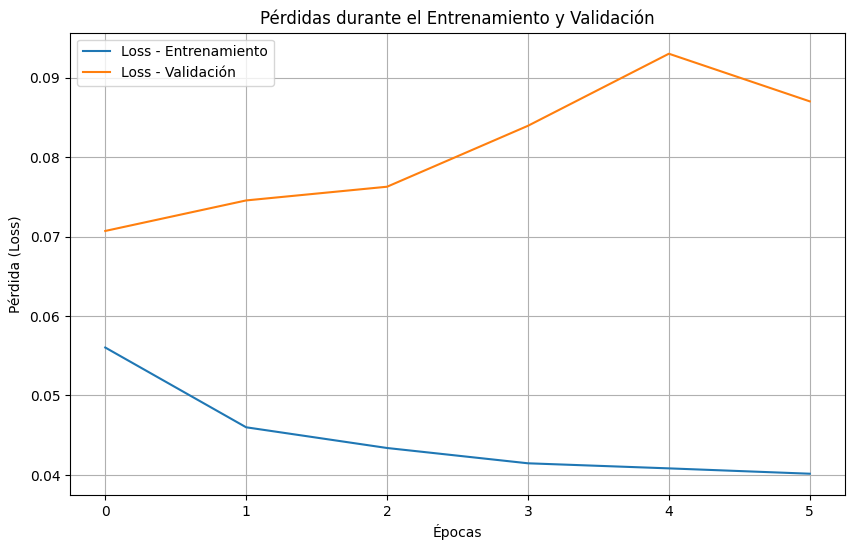

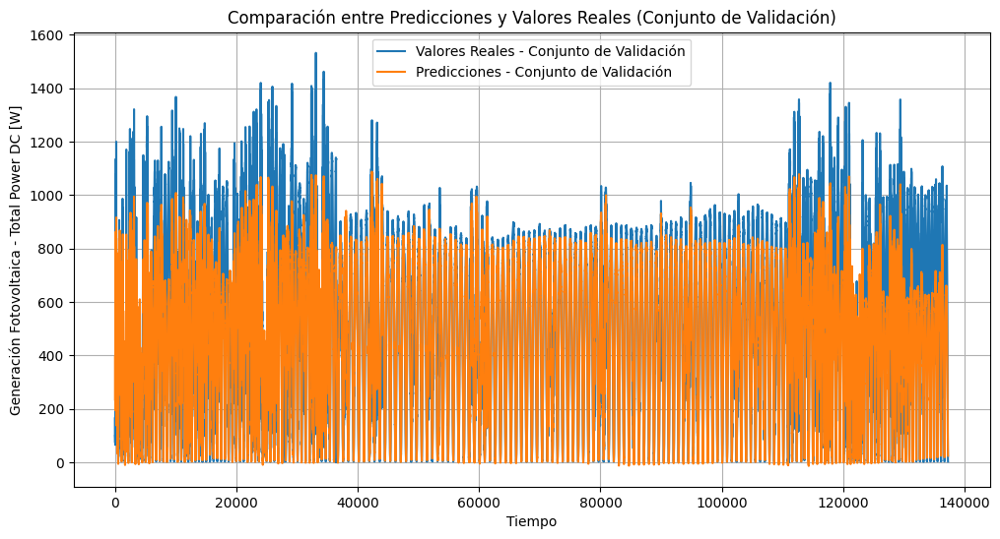

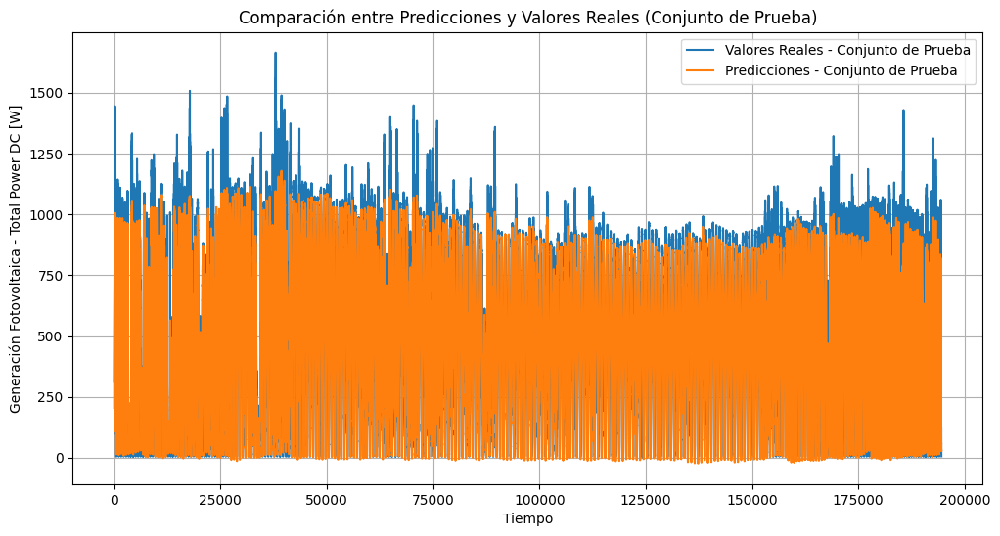

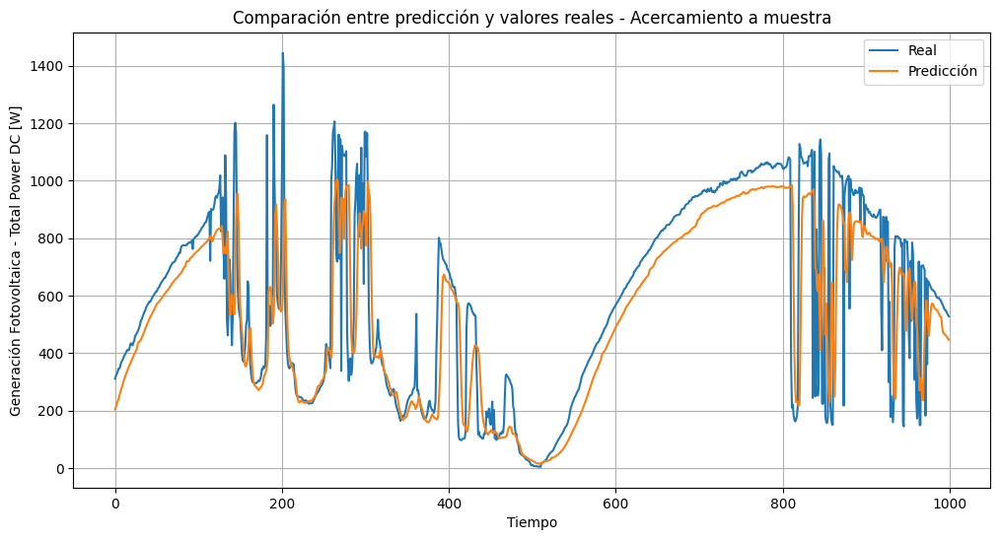

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import random
import tensorflow as tf
import numpy as np

tf.keras.backend.clear_session()


# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo GRU

GRU_model = Sequential()
GRU_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
GRU_model.add(GRU(64, return_sequences=True))
GRU_model.add(Dropout(0.3))
GRU_model.add(GRU(32, return_sequences=False))
GRU_model.add(Dropout(0.3))
GRU_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)
GRU_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = GRU_model.fit(X_train_seq, y_train_seq, epochs=100, batch_size=32,
                        validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = GRU_model.predict(X_val_seq)
y_pred_test = GRU_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION GRU: {mae_val}')
print(f'R2 VALIDACION GRU: {r2_val}')
print(f'MAE TEST GRU: {mae_test}')
print(f'R2 TEST GRU: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.6.3. Red GRU - Modelo 3**

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 143s 9ms/step - loss: 0.0891 - val_loss: 0.0971
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 118s 8ms/step - loss: 0.0642 - val_loss: 0.0941
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0618 - val_loss: 0.0924
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 143s 8ms/step - loss: 0.0609 - val_loss: 0.0867
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 146s 8ms/step - loss: 0.0594 - val_loss: 0.0817
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 121s 8ms/step - loss: 0.0583 - val_loss: 0.0861
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 145s 8ms/step - loss: 0.0578 - val_loss: 0.0836
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0574 - val_loss: 0.0885
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 140s 8ms/step - loss: 0.0573 - val_loss: 0.0839
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 141s 8ms/step - loss: 0.0569 - val_loss: 0.0864
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 12s 3ms/step
6080/6080 ━━━━━━━━━━━━━━━

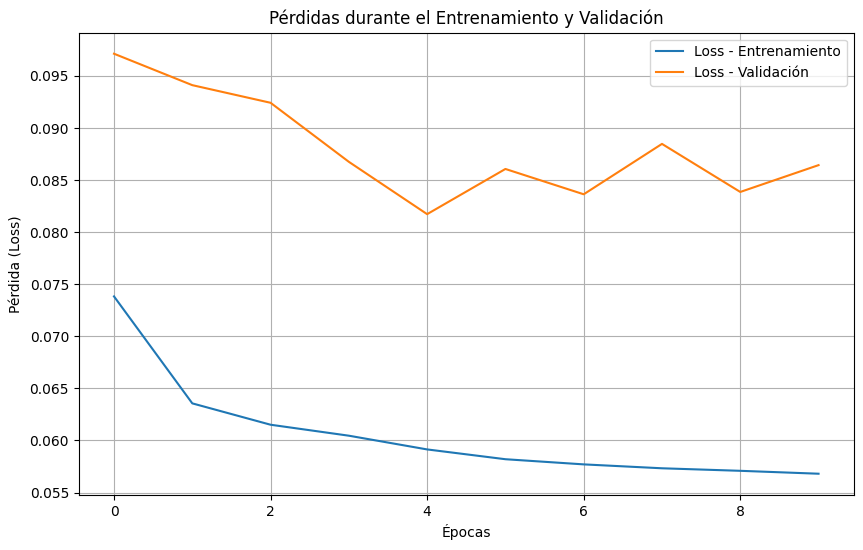

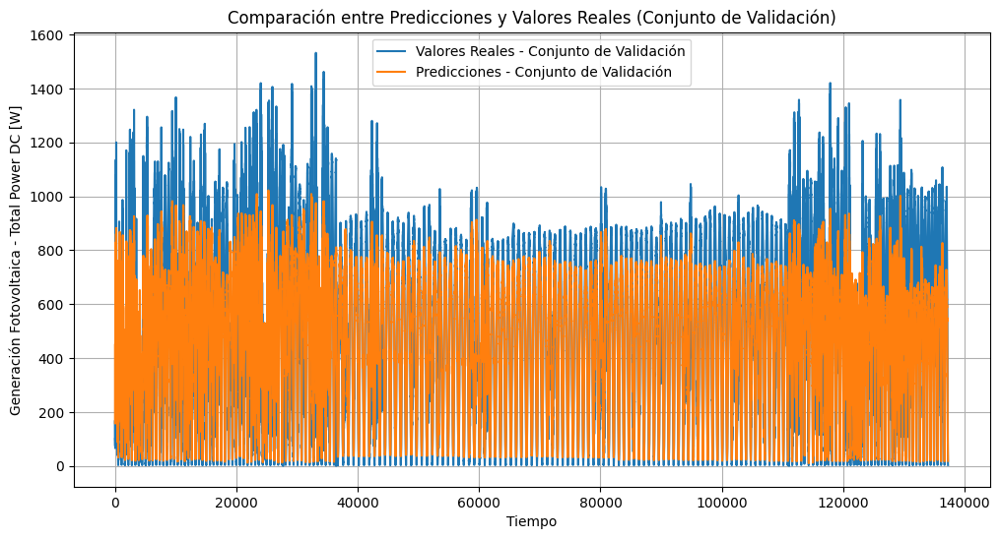

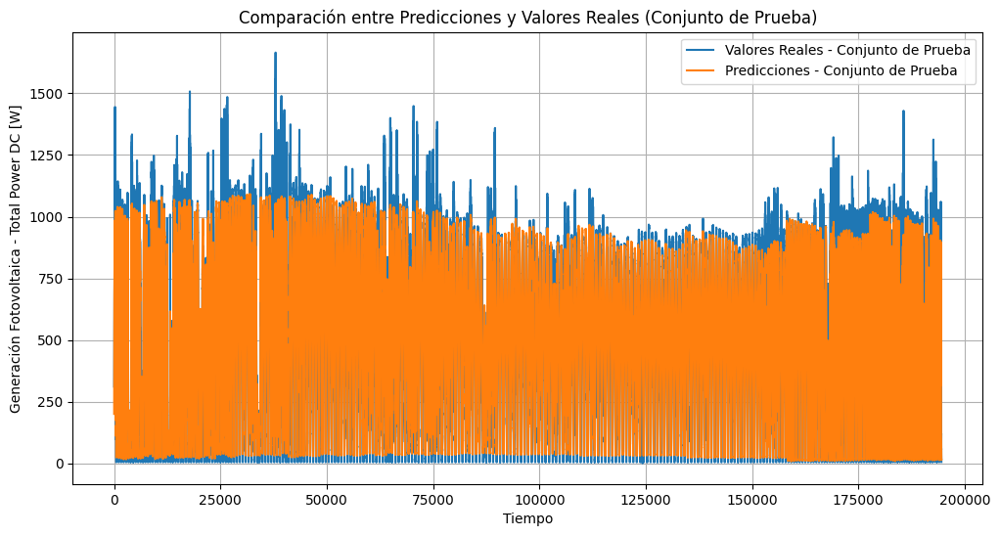

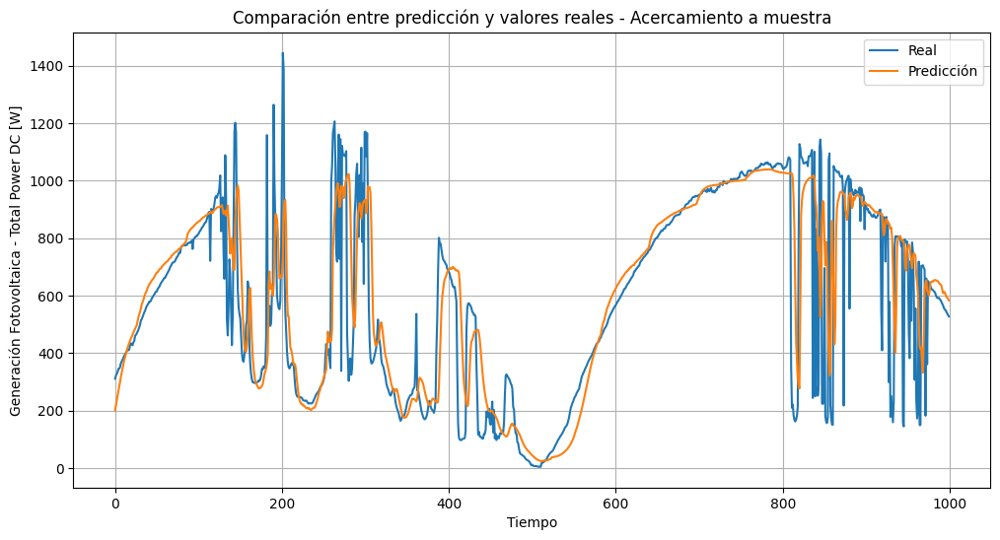

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import random
import tensorflow as tf
import numpy as np

tf.keras.backend.clear_session()


# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo GRU

GRU_model = Sequential()
GRU_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
GRU_model.add(GRU(16, return_sequences=True))
GRU_model.add(Dropout(0.3))
GRU_model.add(GRU(8, return_sequences=False))
GRU_model.add(Dropout(0.3))
GRU_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)
GRU_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = GRU_model.fit(X_train_seq, y_train_seq, epochs=100, batch_size=32,
                        validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = GRU_model.predict(X_val_seq)
y_pred_test = GRU_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION GRU: {mae_val}')
print(f'R2 VALIDACION GRU: {r2_val}')
print(f'MAE TEST GRU: {mae_test}')
print(f'R2 TEST GRU: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

Modelo GRU sin la variable Ultraviolet [W/m2]

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 123s 8ms/step - loss: 0.0881 - val_loss: 0.0917
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 118s 8ms/step - loss: 0.0638 - val_loss: 0.0831
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0614 - val_loss: 0.0801
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 119s 8ms/step - loss: 0.0601 - val_loss: 0.0779
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 127s 8ms/step - loss: 0.0597 - val_loss: 0.0848
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 133s 8ms/step - loss: 0.0603 - val_loss: 0.0850
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 119s 8ms/step - loss: 0.0588 - val_loss: 0.0861
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 127s 8ms/step - loss: 0.0582 - val_loss: 0.0856
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 133s 8ms/step - loss: 0.0579 - val_loss: 0.0818
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step
6080/6080 ━━━━━━━━━━━━━━━━━━━━ 15s 2ms/step
MAE VALIDACION GRU: 123.90089997088063
R2 VALIDACION GRU: 0.745185767138766

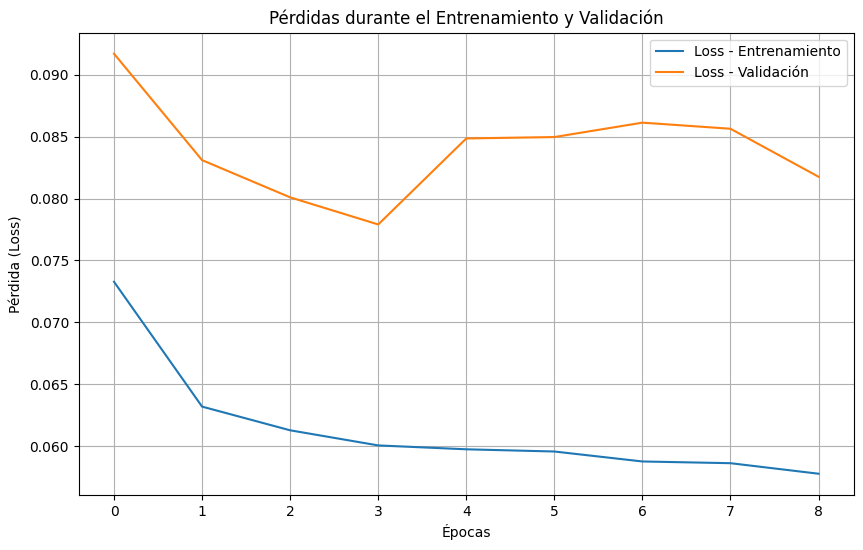

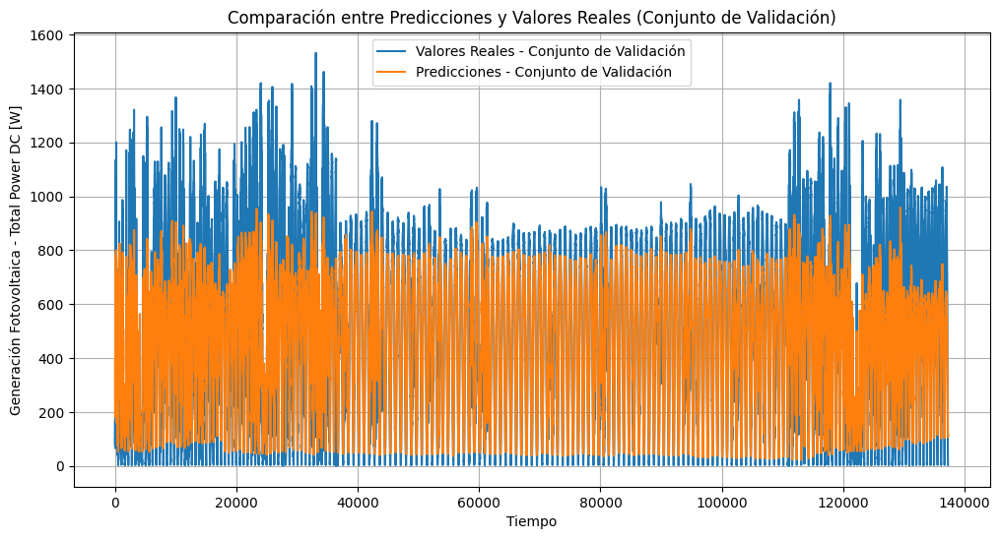

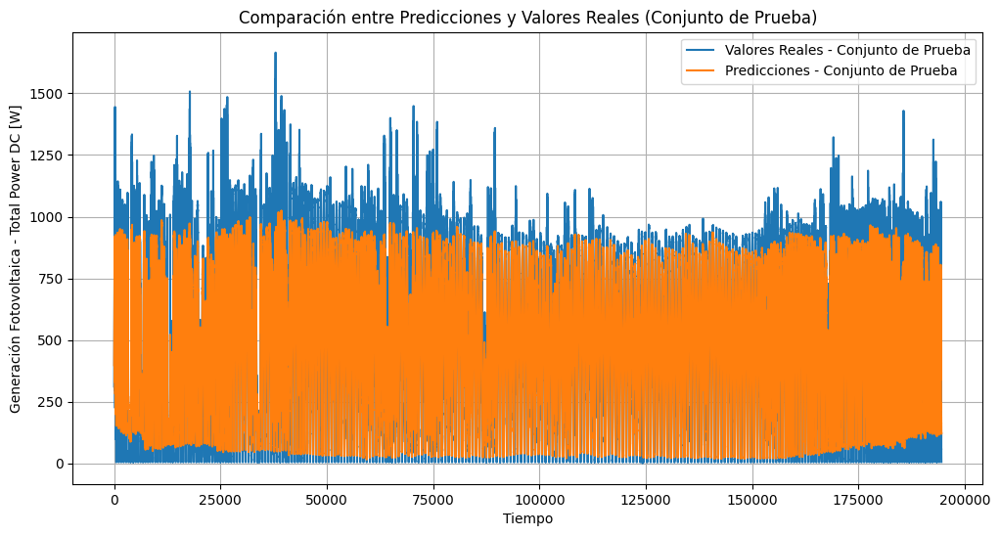

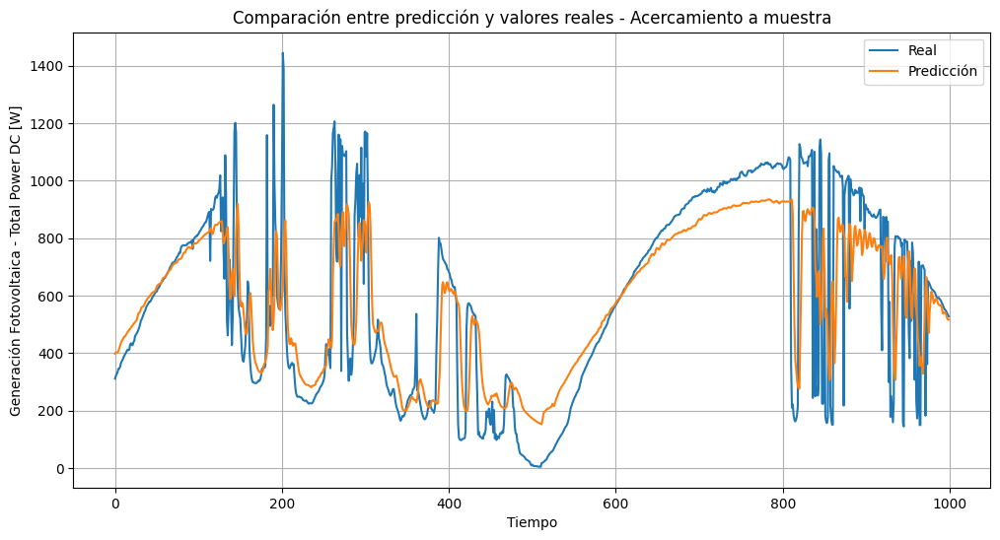

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import random
import tensorflow as tf
import numpy as np

tf.keras.backend.clear_session()


# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_su)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo GRU

GRU_model = Sequential()
GRU_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
GRU_model.add(GRU(16, return_sequences=True))
GRU_model.add(Dropout(0.3))
GRU_model.add(GRU(8, return_sequences=False))
GRU_model.add(Dropout(0.3))
GRU_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)
GRU_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = GRU_model.fit(X_train_seq, y_train_seq, epochs=100, batch_size=32,
                        validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = GRU_model.predict(X_val_seq)
y_pred_test = GRU_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION GRU: {mae_val}')
print(f'R2 VALIDACION GRU: {r2_val}')
print(f'MAE TEST GRU: {mae_test}')
print(f'R2 TEST GRU: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

Modelo 3 GRU evaluado con la prediccion de la primera semana del 2017

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 128s 8ms/step - loss: 0.0880 - val_loss: 0.0772
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 130s 8ms/step - loss: 0.0636 - val_loss: 0.0835
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 115s 8ms/step - loss: 0.0611 - val_loss: 0.0763
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0599 - val_loss: 0.0915
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 117s 8ms/step - loss: 0.0589 - val_loss: 0.0879
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 140s 8ms/step - loss: 0.0583 - val_loss: 0.0827
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 143s 8ms/step - loss: 0.0578 - val_loss: 0.0815
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 142s 8ms/step - loss: 0.0572 - val_loss: 0.0891
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step
159/159 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
MAE VALIDACION GRU: 121.37185804768623
R2 VALIDACION GRU: 0.7260376338785479
MAE TEST GRU: 77.3354503403328
R2 TEST GRU: 0.8753356948630204


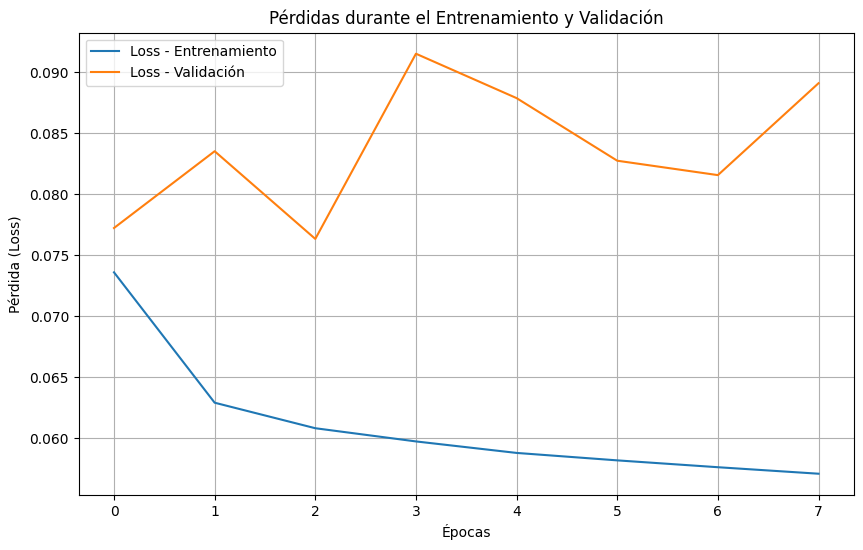

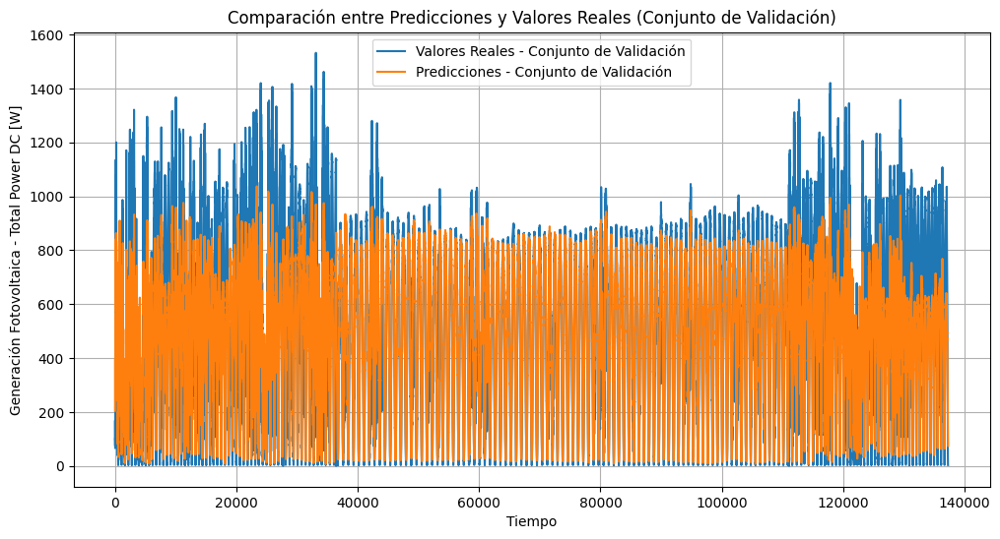

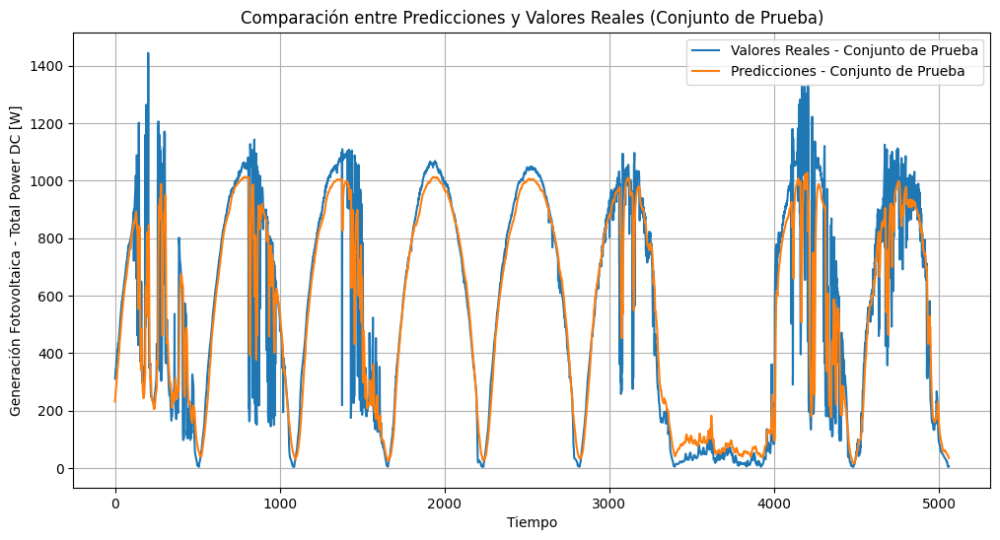

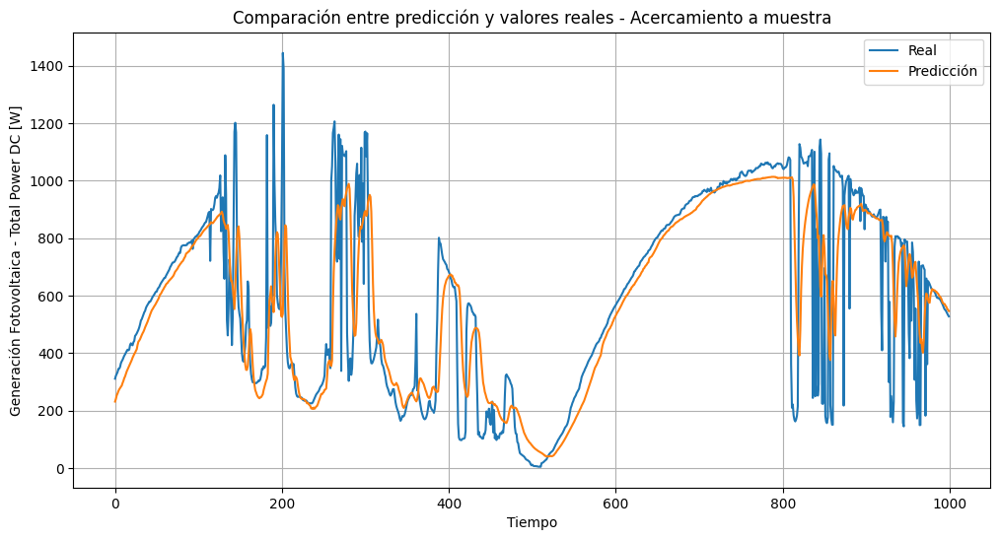

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import random
import tensorflow as tf
import numpy as np

tf.keras.backend.clear_session()


# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017_s1)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017_s1.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 40
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo GRU

GRU_model = Sequential()
GRU_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
GRU_model.add(GRU(16, return_sequences=True))
GRU_model.add(Dropout(0.3))
GRU_model.add(GRU(8, return_sequences=False))
GRU_model.add(Dropout(0.3))
GRU_model.add(Dense(1))

optimizer = Adam(learning_rate=0.001)
GRU_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = GRU_model.fit(X_train_seq, y_train_seq, epochs=100, batch_size=32,
                        validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = GRU_model.predict(X_val_seq)
y_pred_test = GRU_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION GRU: {mae_val}')
print(f'R2 VALIDACION GRU: {r2_val}')
print(f'MAE TEST GRU: {mae_test}')
print(f'R2 TEST GRU: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
df_Generacion_fil3 = df_Generacion_fil2.loc['2014-01-01':'2015-12-31']

train_longitud = int (len(df_Generacion_fil2)*0.9)
df_train, df_validacion = df_Generacion_fil2[:train_longitud], df_Generacion_fil2[train_longitud:]

X_train = df_train.drop('Total Power DC [W]', axis=1)
X_val = df_validacion.drop('Total Power DC [W]', axis=1)
y_train = df_train ['Total Power DC [W]']
y_val = df_validacion ['Total Power DC [W]']

X_train

**4.7. Red Híbrido (CNN + GRU) - Modelo 1**

Epoch 1/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 194s 6ms/step - loss: 0.0556 - val_loss: 0.1078
Epoch 2/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 194s 6ms/step - loss: 0.0392 - val_loss: 0.1103
Epoch 3/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 202s 6ms/step - loss: 0.0359 - val_loss: 0.1059
Epoch 4/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 203s 6ms/step - loss: 0.0349 - val_loss: 0.0922
Epoch 5/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 183s 6ms/step - loss: 0.0339 - val_loss: 0.0962
Epoch 6/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 201s 6ms/step - loss: 0.0327 - val_loss: 0.1095
Epoch 7/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 207s 6ms/step - loss: 0.0319 - val_loss: 0.1103
Epoch 8/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 198s 6ms/step - loss: 0.0318 - val_loss: 0.1008
Epoch 9/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 202s 6ms/step - loss: 0.0313 - val_loss: 0.1059
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step
6079/6079 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step
MAE VALIDACION LSTM: 146.6316168076377
R2 VALIDACION LSTM: 0.654824903466478

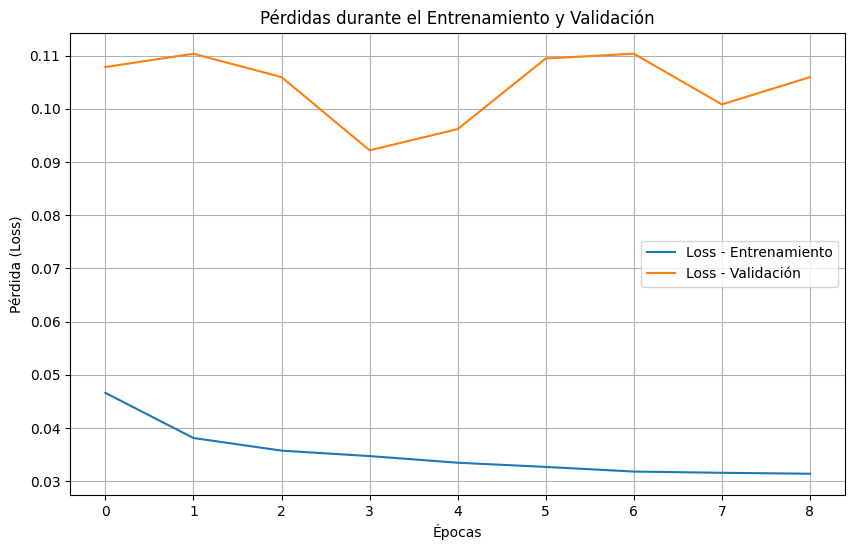

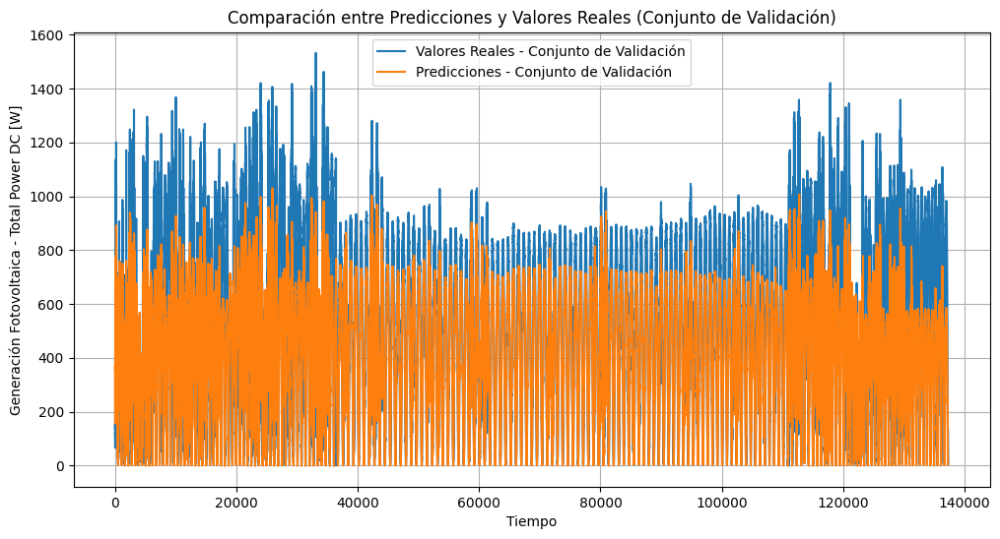

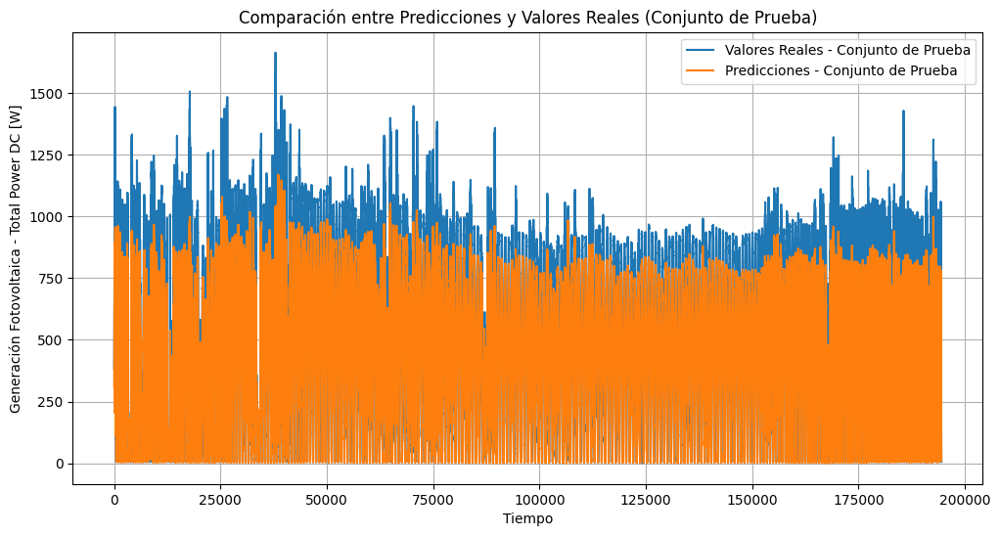

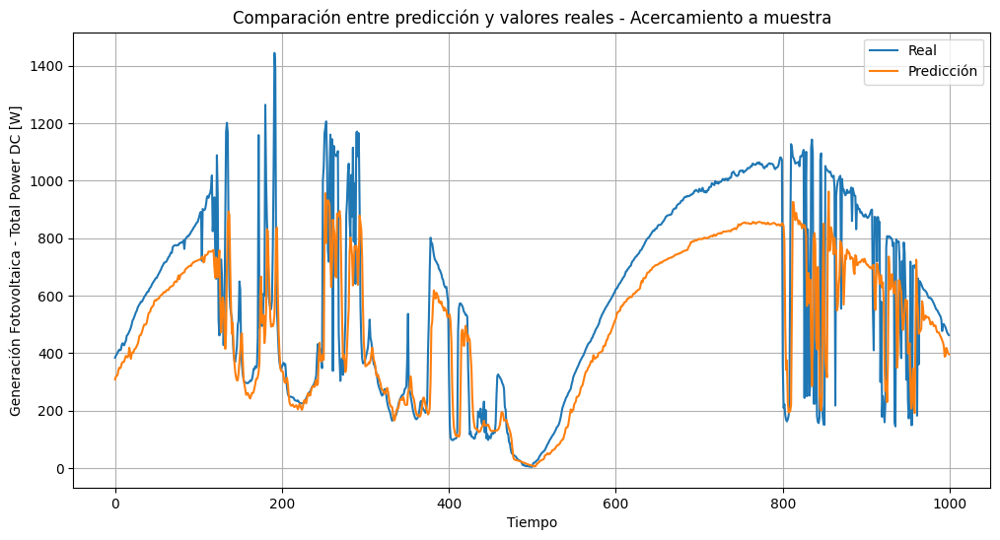

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=40):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo CNN + GRU

mix_model = Sequential()
mix_model.add(Input(shape=(time_steps, X_train_seq.shape[2])))
mix_model.add(Conv1D(filters=64, kernel_size=3, activation='relu'))
mix_model.add(MaxPooling1D(pool_size=2))
mix_model.add(GRU(32, return_sequences=False))
mix_model.add(Dropout(0.3))
mix_model.add(Flatten())
mix_model.add(Dense(16,activation='relu'))
mix_model.add(Dense(1))

mix_model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_absolute_error')

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Entrenar el modelo

history = mix_model.fit(X_train_seq, y_train_seq, epochs=100, batch_size=16,
                                  validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = mix_model.predict(X_val_seq)
y_pred_test = mix_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION MIX MODEL (CNN + GRU): {mae_val}')
print(f'R2 VALIDACION MIX MODEL (CNN + GRU): {r2_val}')
print(f'MAE TEST MIX MODEL (CNN + GRU): {mae_test}')
print(f'R2 TEST MIX MODEL (CNN + GRU): {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Loss - Entrenamiento')
plt.plot(history.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.8. Transformer**

**4.8.1. Transformer - Modelo 1**

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 16)         │            552 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 800)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         51,264 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 64)             │              0 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dropout_1[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 51,881 (202.66 KB)

 Trainable params: 51,881 (202.66 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 48s 3ms/step - loss: 0.0789 - val_loss: 0.1206
Epoch 2/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0654 - val_loss: 0.1233
Epoch 3/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0619 - val_loss: 0.0837
Epoch 4/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 45s 3ms/step - loss: 0.0599 - val_loss: 0.0990
Epoch 5/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - loss: 0.0586 - val_loss: 0.0977
Epoch 6/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 46s 3ms/step - loss: 0.0576 - val_loss: 0.1008
Epoch 7/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 78s 3ms/step - loss: 0.0571 - val_loss: 0.0892
Epoch 8/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 44s 3ms/step - loss: 0.0564 - val_loss: 0.0833
Epoch 9/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 44s 3ms/step - loss: 0.0562 - val_loss: 0.0926
Epoch 10/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 45s 3ms/step - loss: 0.0561 - val_loss: 0.0894
Epoch 11/100
15140/15140 ━━━━━━━━━━━━━━━━━━━━ 44s 3ms/step - loss: 0.0559 - val

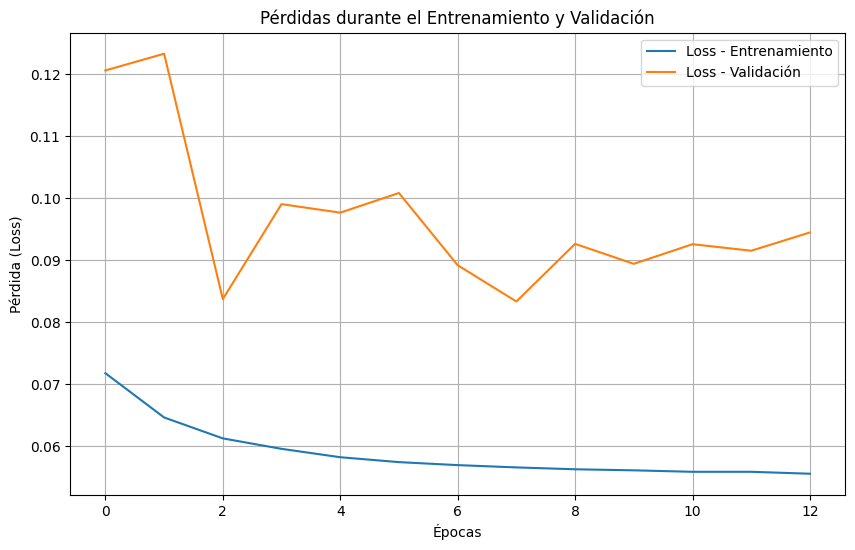

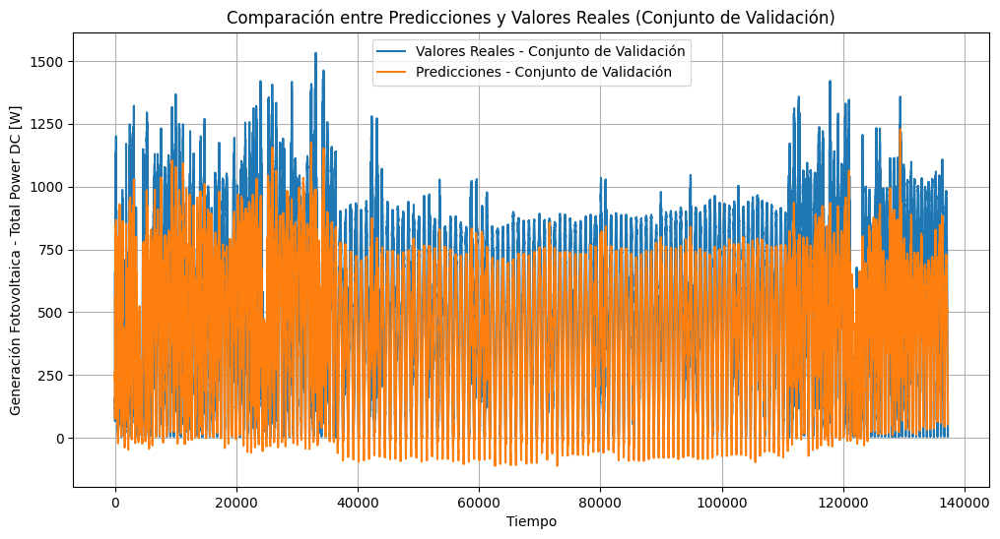

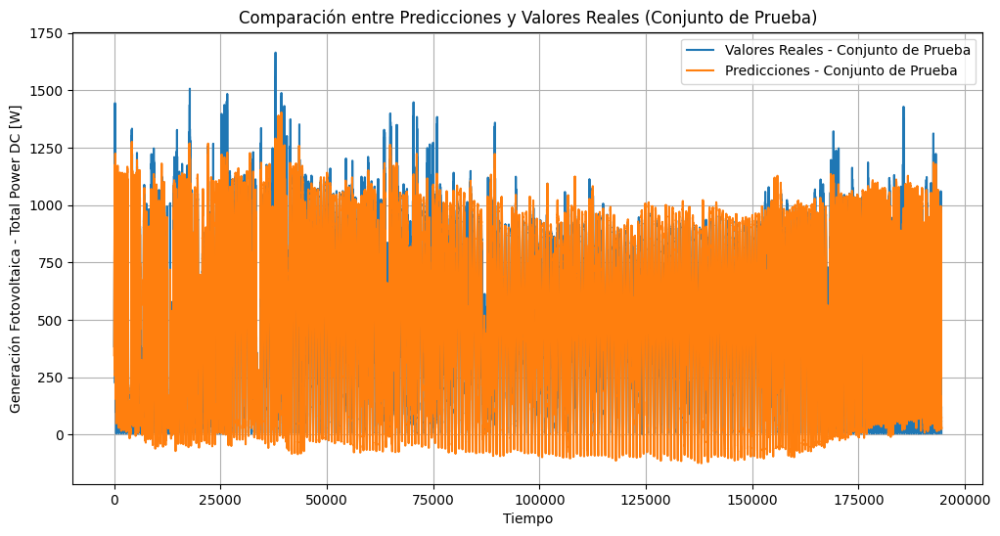

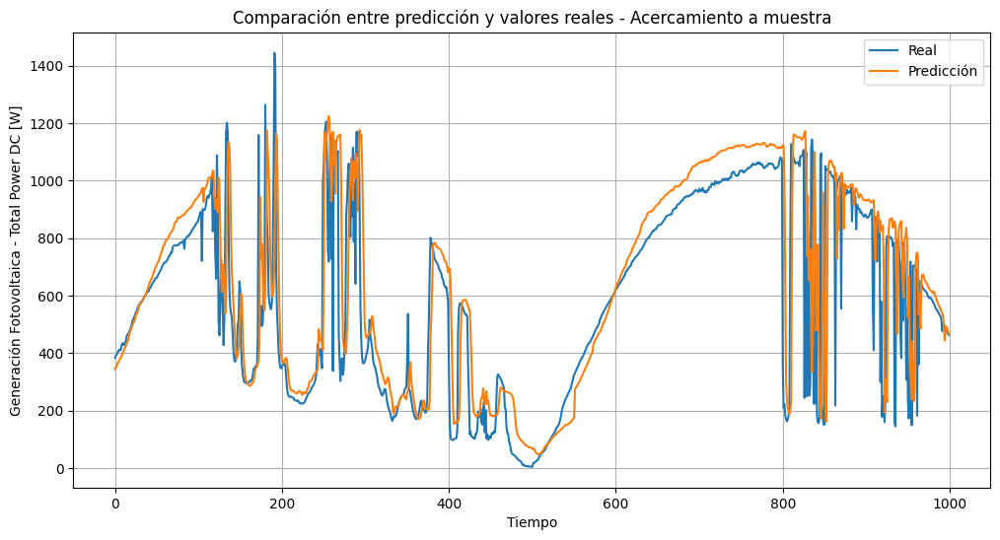

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))


# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))

attention_output = MultiHeadAttention(num_heads=4, key_dim=2)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(64, activation='relu')(x)
x = Dropout(0.3)(x)
outputs = Dense(1)(x)

Transformer_model = Model(inputs=inputs, outputs=outputs)
optimizer = Adam(learning_rate=0.001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')
Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=32, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización de las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.8.2. Transformer - Modelo 2**

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 16)         │          2,160 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 800)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 128)            │        102,528 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 128)            │              0 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 64)             │          8,256 │ dropout_1[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_2 (Dropout)       │ (None, 64)             │              0 │ dense_1[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_2 (Dense)           │ (None, 1)              │             65 │ dropout_2[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 113,009 (441.44 KB)

 Trainable params: 113,009 (441.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 91s 3ms/step - loss: 0.1744 - val_loss: 0.1344
Epoch 2/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 134s 3ms/step - loss: 0.0719 - val_loss: 0.1215
Epoch 3/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 92s 3ms/step - loss: 0.0701 - val_loss: 0.1221
Epoch 4/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 142s 3ms/step - loss: 0.0695 - val_loss: 0.1218
Epoch 5/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 80s 3ms/step - loss: 0.0692 - val_loss: 0.1281
Epoch 6/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 126s 4ms/step - loss: 0.0681 - val_loss: 0.1204
Epoch 7/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 117s 4ms/step - loss: 0.0668 - val_loss: 0.1091
Epoch 8/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 109s 3ms/step - loss: 0.0656 - val_loss: 0.1107
Epoch 9/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 81s 3ms/step - loss: 0.0649 - val_loss: 0.0994
Epoch 10/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 83s 3ms/step - loss: 0.0643 - val_loss: 0.1084
Epoch 11/100
30279/30279 ━━━━━━━━━━━━━━━━━━━━ 81s 3ms/step - loss: 0.0638 

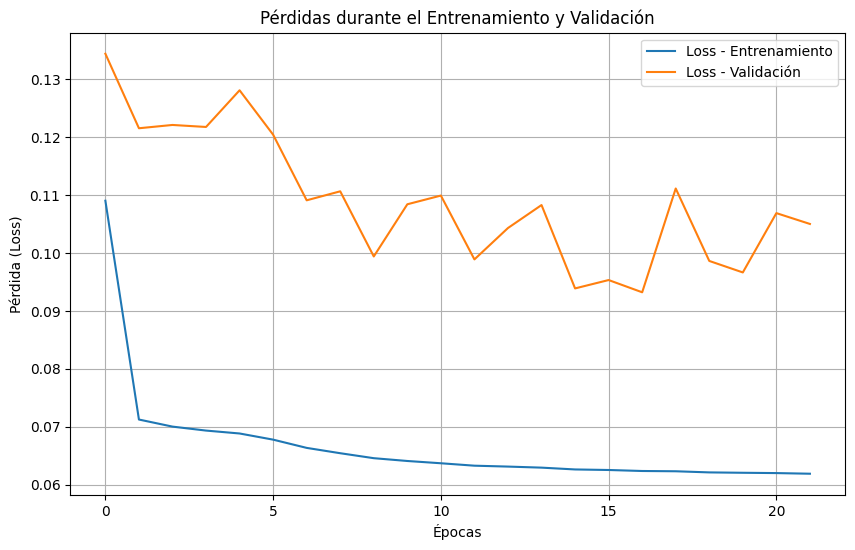

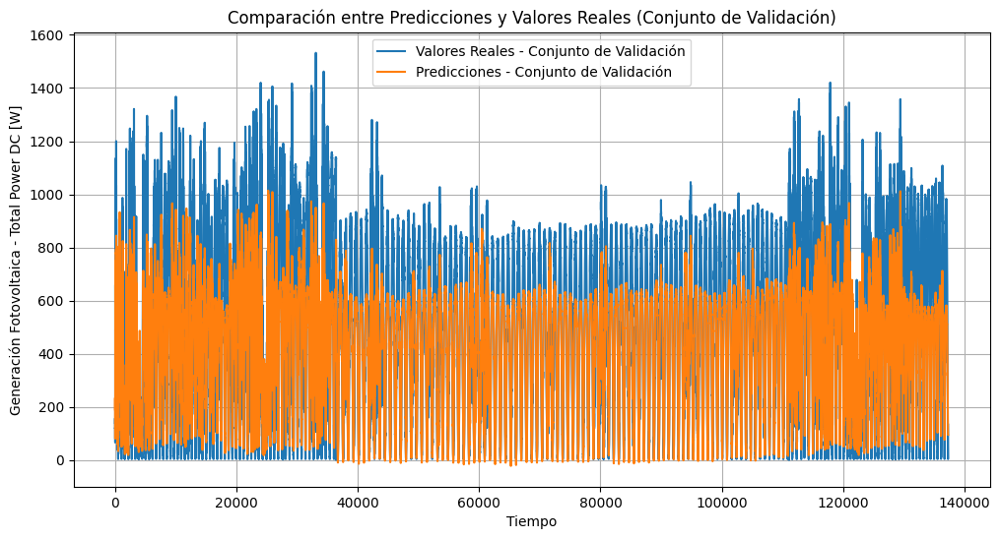

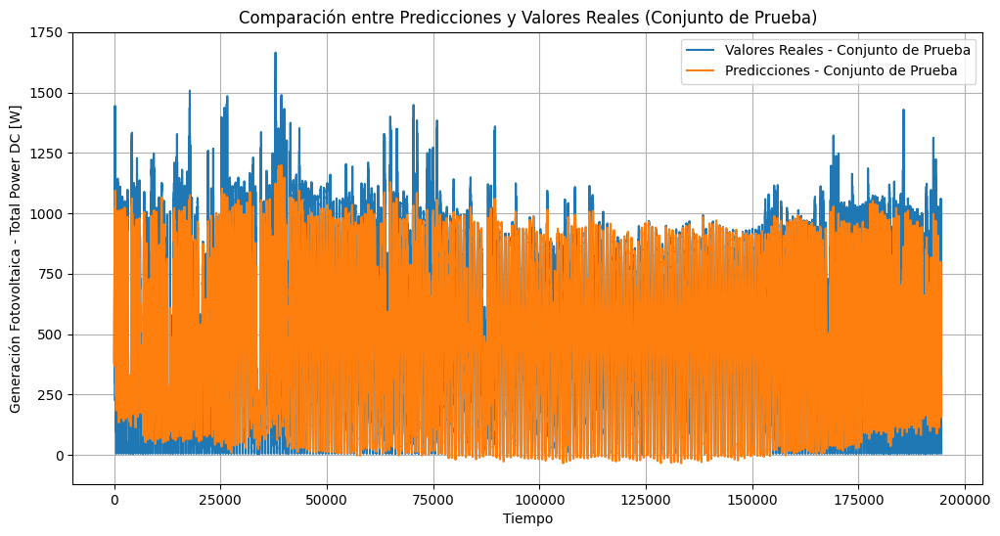

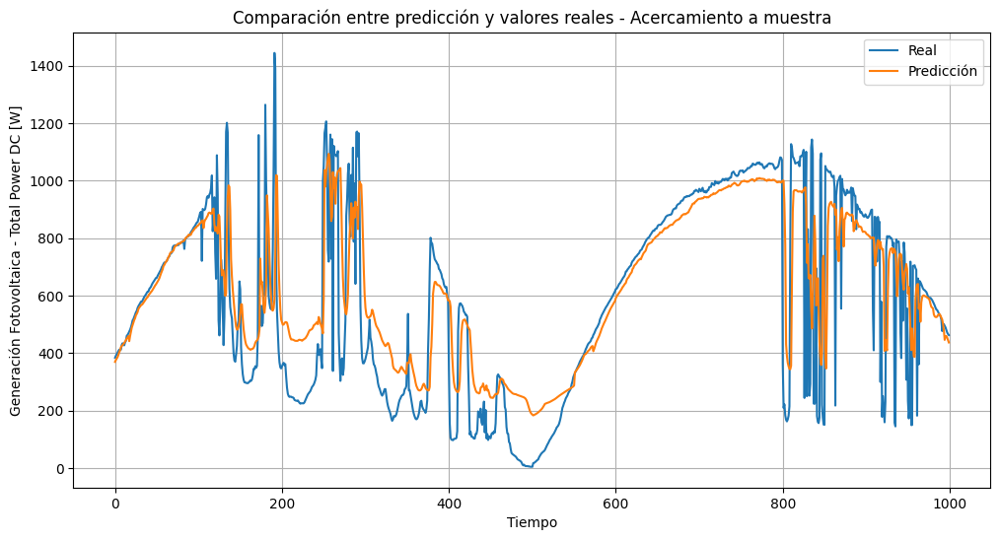

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(128, activation='relu', kernel_regularizer=l2(0.001))(x)
x = Dropout(0.4)(x)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
x = Dropout(0.4)(x)
outputs = Dense(1)(x)

Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=16, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.8.3. Transformer - Modelo 3**

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 16)         │          2,160 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 800)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         51,264 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dense[0][0]            │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 53,489 (208.94 KB)

 Trainable params: 53,489 (208.94 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 32s 3ms/step - loss: 0.1394 - val_loss: 0.1671
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 33s 3ms/step - loss: 0.0658 - val_loss: 0.1491
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - loss: 0.0535 - val_loss: 0.1663
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - loss: 0.0498 - val_loss: 0.1329
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - loss: 0.0481 - val_loss: 0.1415
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - loss: 0.0475 - val_loss: 0.1228
Epoch 7/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 35s 5ms/step - loss: 0.0467 - val_loss: 0.1146
Epoch 8/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 29s 3ms/step - loss: 0.0462 - val_loss: 0.1265
Epoch 9/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0456 - val_loss: 0.1164
Epoch 10/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - loss: 0.0452 - val_loss: 0.1075
Epoch 11/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - loss: 0.0449 - val_loss: 0.1185
Epoch 12

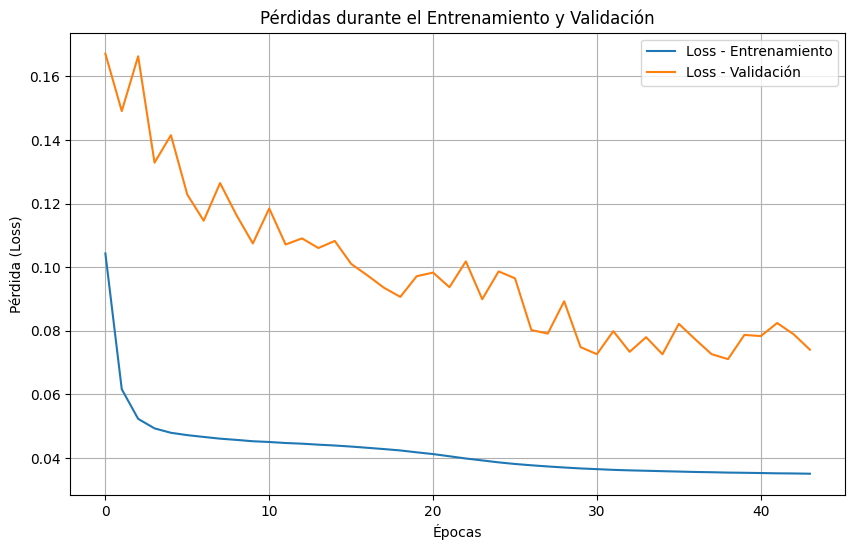

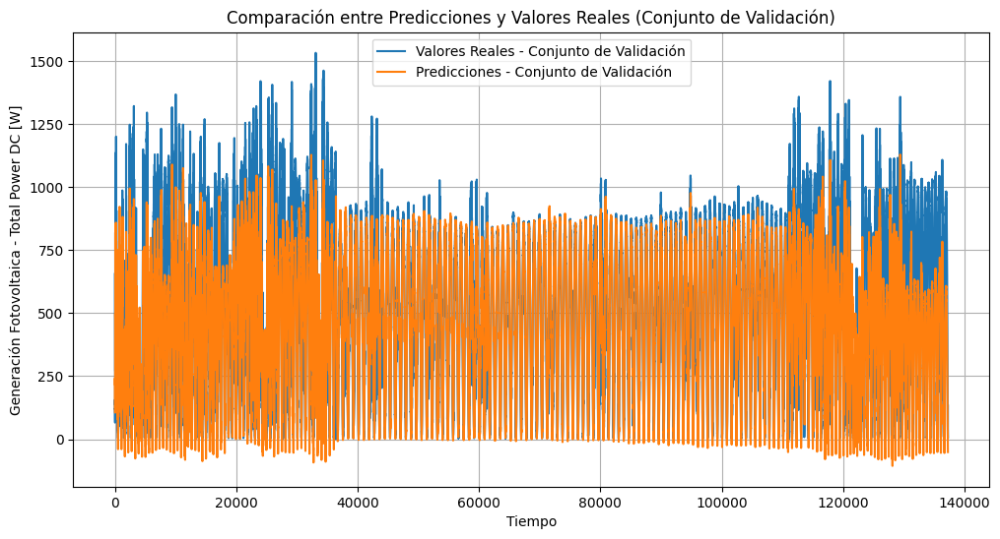

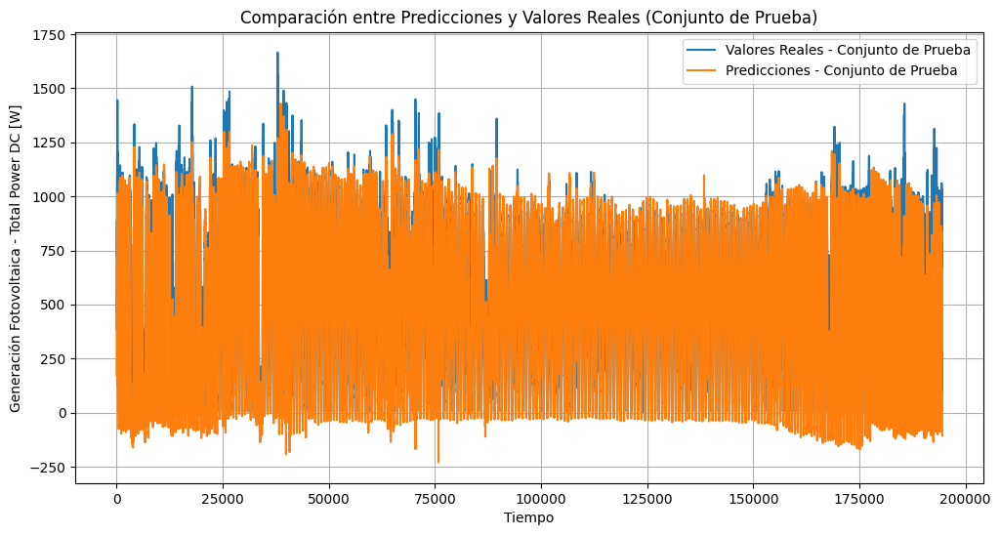

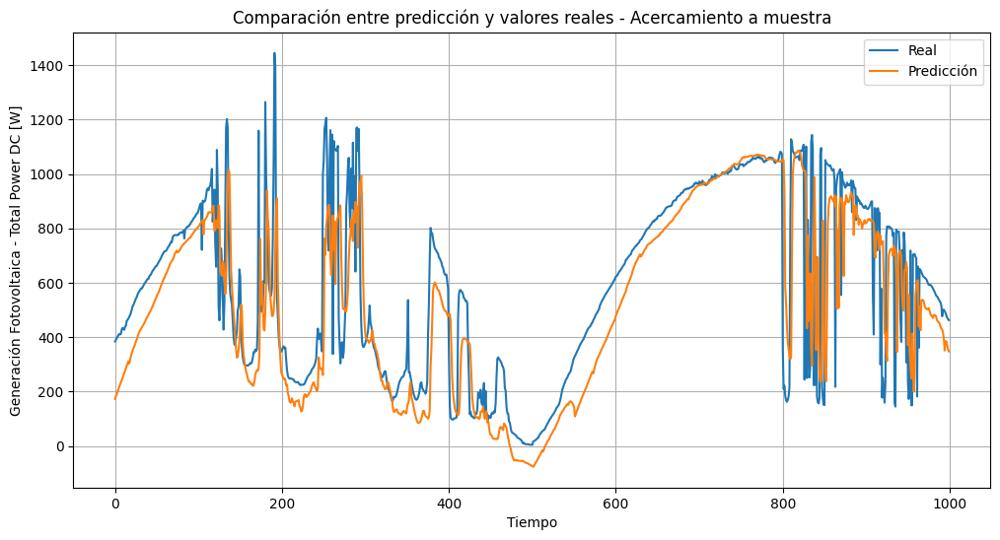

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
outputs = Dense(1)(x)

Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.8.4. Transformer - Modelo 4**

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 16)         │          2,160 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 800)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         51,264 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dense[0][0]            │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 53,489 (208.94 KB)

 Trainable params: 53,489 (208.94 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 30s 4ms/step - loss: 0.1374 - val_loss: 0.1458
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step - loss: 0.0653 - val_loss: 0.1252
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - loss: 0.0537 - val_loss: 0.1003
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - loss: 0.0500 - val_loss: 0.0959
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0485 - val_loss: 0.1022
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 43s 3ms/step - loss: 0.0476 - val_loss: 0.0975
Epoch 7/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 4ms/step - loss: 0.0470 - val_loss: 0.0878
Epoch 8/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0462 - val_loss: 0.0973
Epoch 9/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - loss: 0.0456 - val_loss: 0.1154
Epoch 10/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - loss: 0.0454 - val_loss: 0.0988
Epoch 11/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 43s 4ms/step - loss: 0.0452 - val_loss: 0.1012
Epoch 12

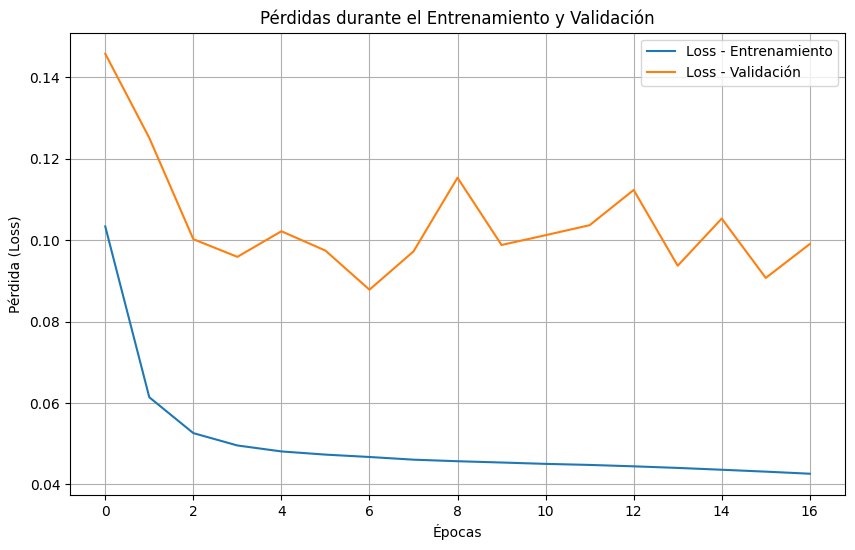

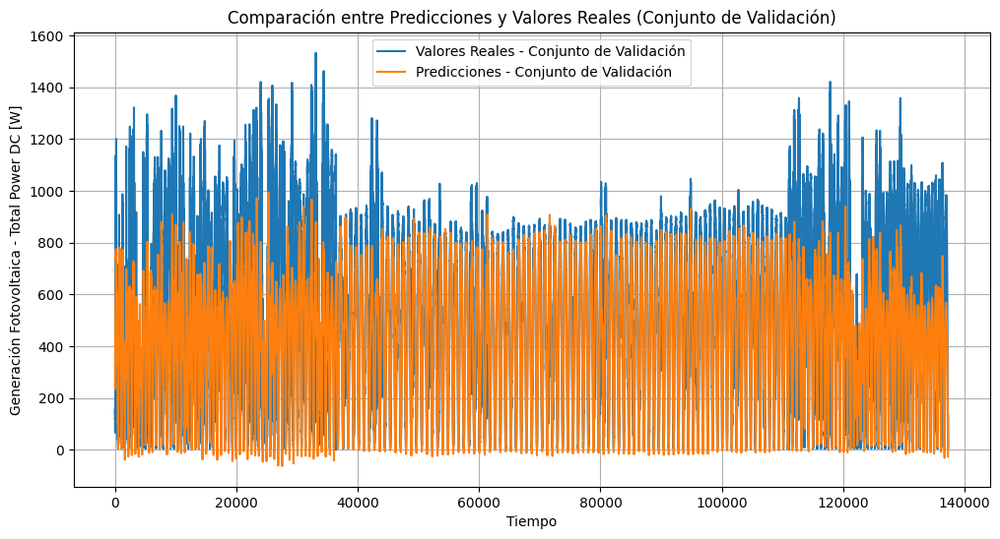

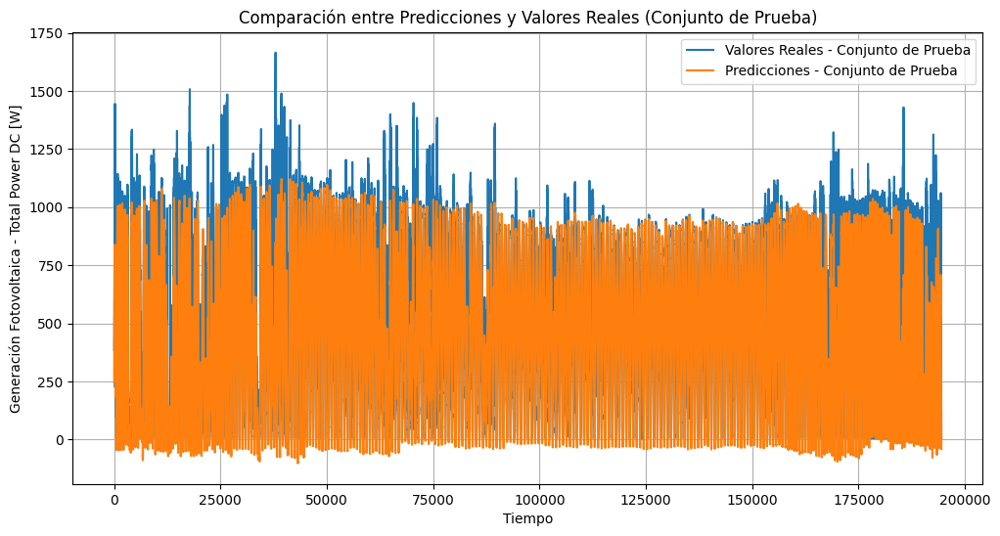

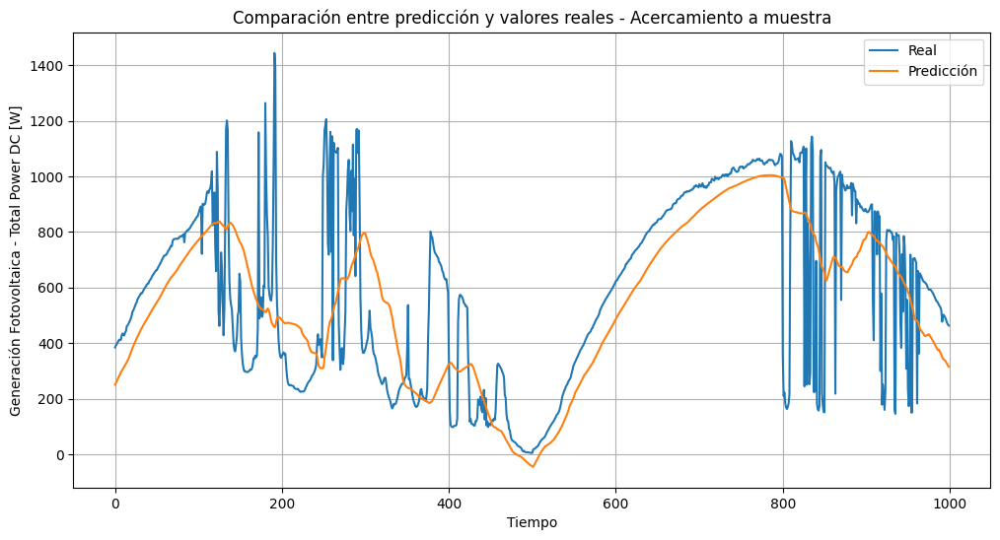

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
outputs = Dense(1)(x)
Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

Modelo 4 sin considerar la variable Ultraviolet [W/m2]

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 16)         │          2,160 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 800)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         51,264 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dense[0][0]            │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 53,489 (208.94 KB)

 Trainable params: 53,489 (208.94 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 31s 3ms/step - loss: 0.1324 - val_loss: 0.1143
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - loss: 0.0640 - val_loss: 0.1043
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0533 - val_loss: 0.0993
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - loss: 0.0496 - val_loss: 0.0980
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - loss: 0.0479 - val_loss: 0.0978
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0469 - val_loss: 0.1004
Epoch 7/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0461 - val_loss: 0.1024
Epoch 8/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step - loss: 0.0455 - val_loss: 0.0975
Epoch 9/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - loss: 0.0450 - val_loss: 0.0924
Epoch 10/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0446 - val_loss: 0.0958
Epoch 11/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - loss: 0.0441 - val_loss: 0.0964
Epoch 12

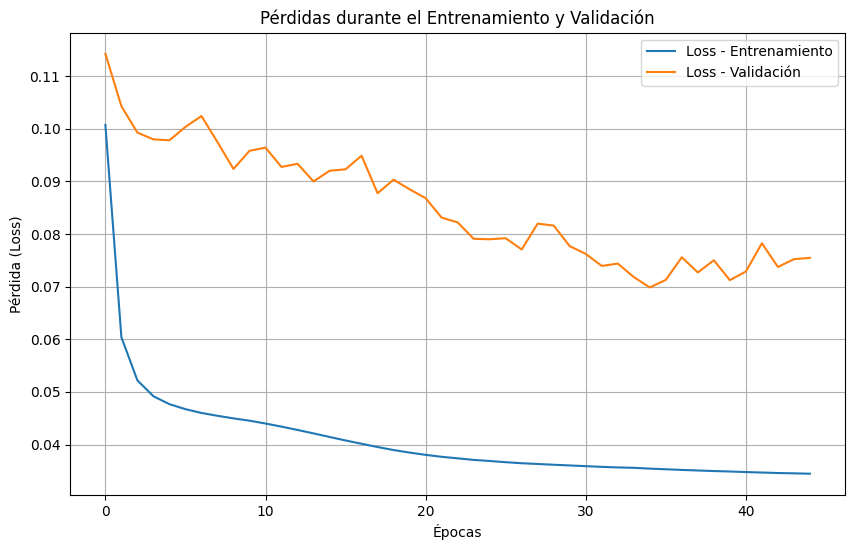

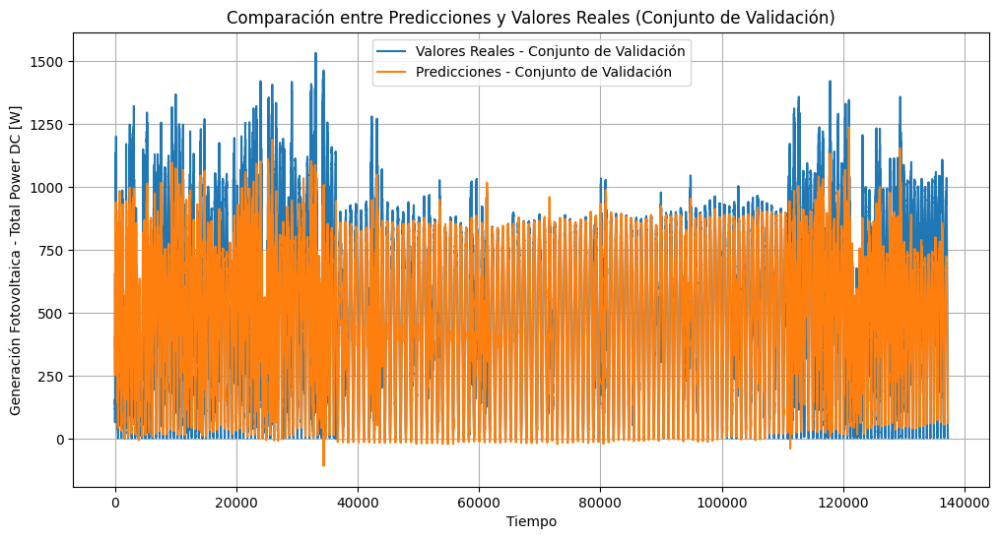

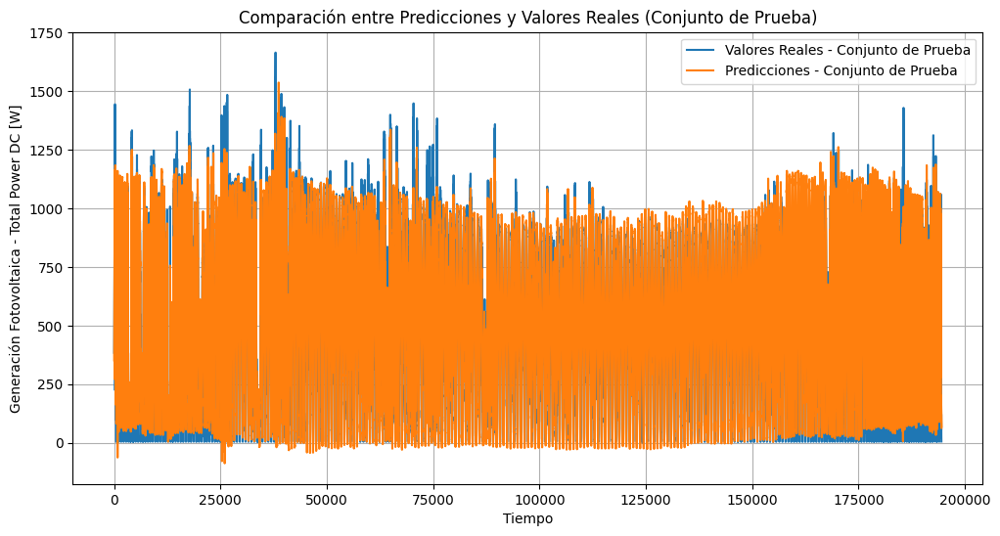

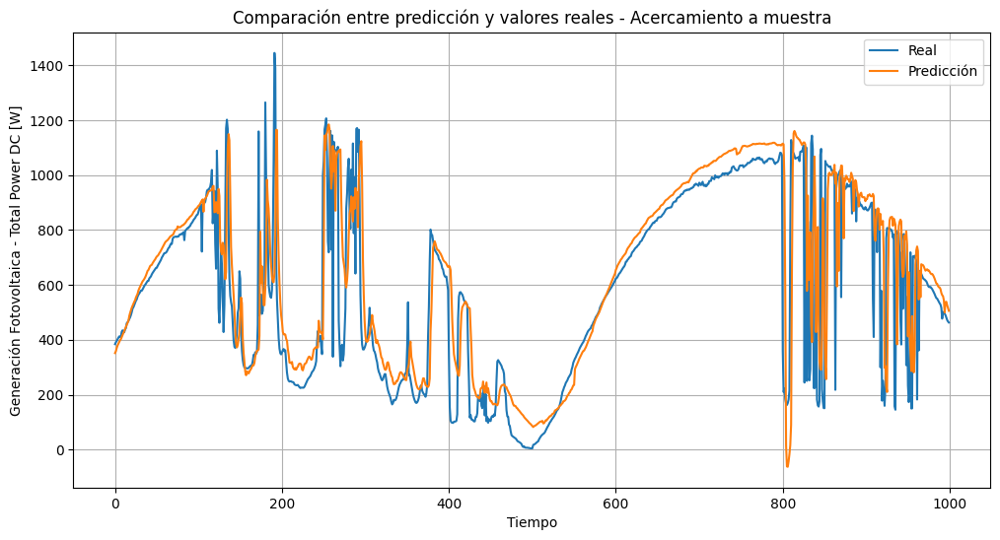

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
outputs = Dense(1)(x)
Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 15)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 15)         │          2,031 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 750)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         48,064 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dense[0][0]            │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 50,160 (195.94 KB)

 Trainable params: 50,160 (195.94 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 31s 3ms/step - loss: 0.1410 - val_loss: 0.1675
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - loss: 0.0629 - val_loss: 0.1457
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 43s 3ms/step - loss: 0.0520 - val_loss: 0.1372
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0488 - val_loss: 0.1273
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0476 - val_loss: 0.1206
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0467 - val_loss: 0.1246
Epoch 7/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0460 - val_loss: 0.1242
Epoch 8/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - loss: 0.0458 - val_loss: 0.1075
Epoch 9/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - loss: 0.0451 - val_loss: 0.1203
Epoch 10/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0448 - val_loss: 0.1169
Epoch 11/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0447 - val_loss: 0.0993
Epoch 12

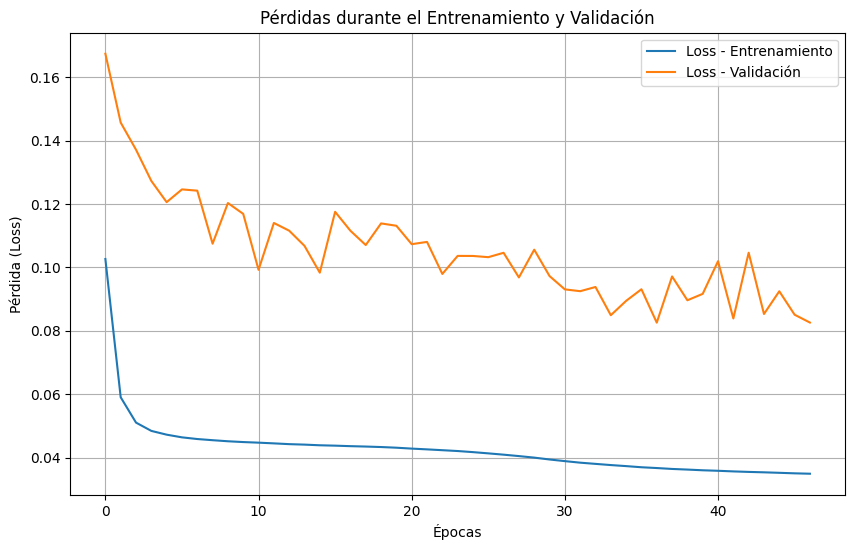

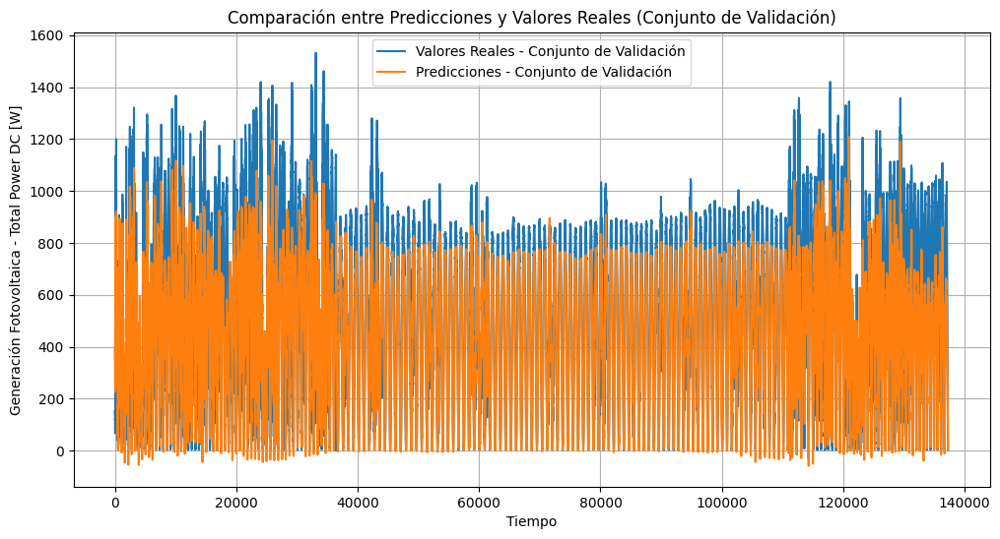

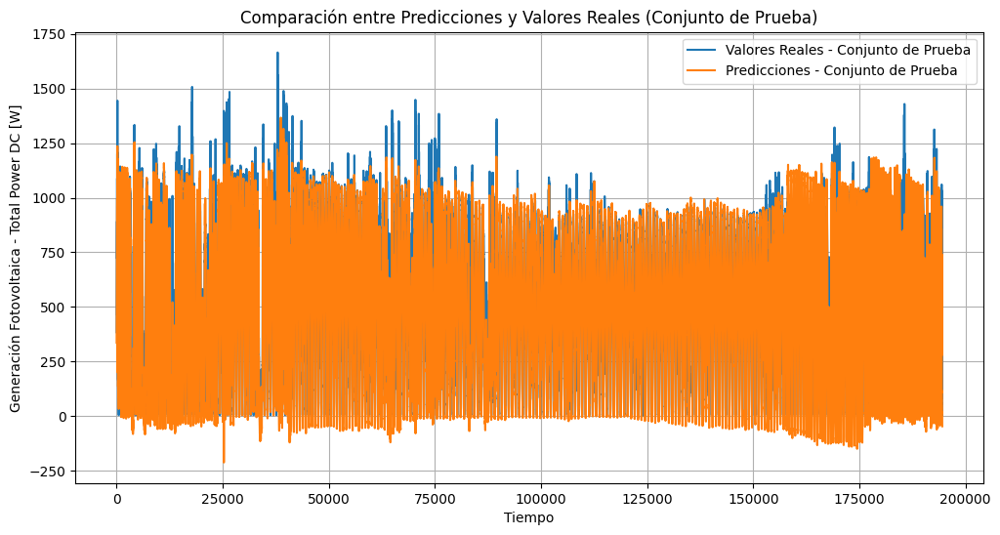

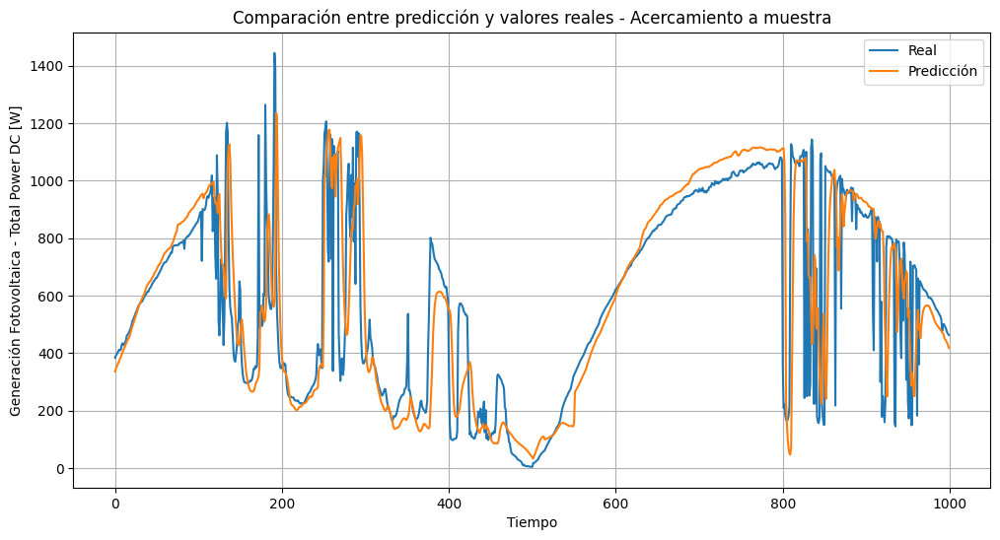

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_su)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
outputs = Dense(1)(x)
Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 15)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 15)         │          2,031 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 750)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         48,064 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dense[0][0]            │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 50,160 (195.94 KB)

 Trainable params: 50,160 (195.94 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 51s 6ms/step - loss: 0.1444 - val_loss: 0.1453
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 77s 6ms/step - loss: 0.0690 - val_loss: 0.1171
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 28s 4ms/step - loss: 0.0555 - val_loss: 0.1063
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - loss: 0.0506 - val_loss: 0.1055
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0485 - val_loss: 0.1088
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - loss: 0.0473 - val_loss: 0.1090
Epoch 7/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 22s 3ms/step - loss: 0.0465 - val_loss: 0.1084
Epoch 8/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0460 - val_loss: 0.1006
Epoch 9/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0456 - val_loss: 0.0960
Epoch 10/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0453 - val_loss: 0.0958
Epoch 11/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 43s 3ms/step - loss: 0.0450 - val_loss: 0.0980
Epoch 12

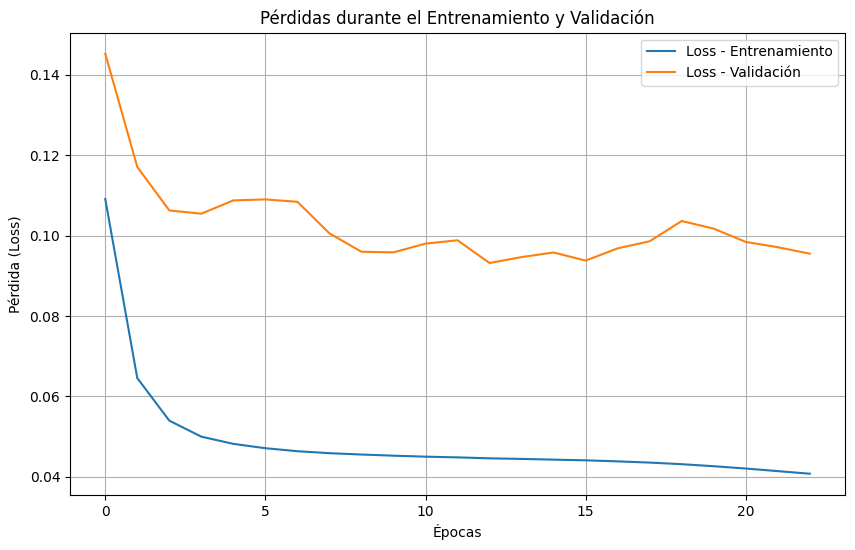

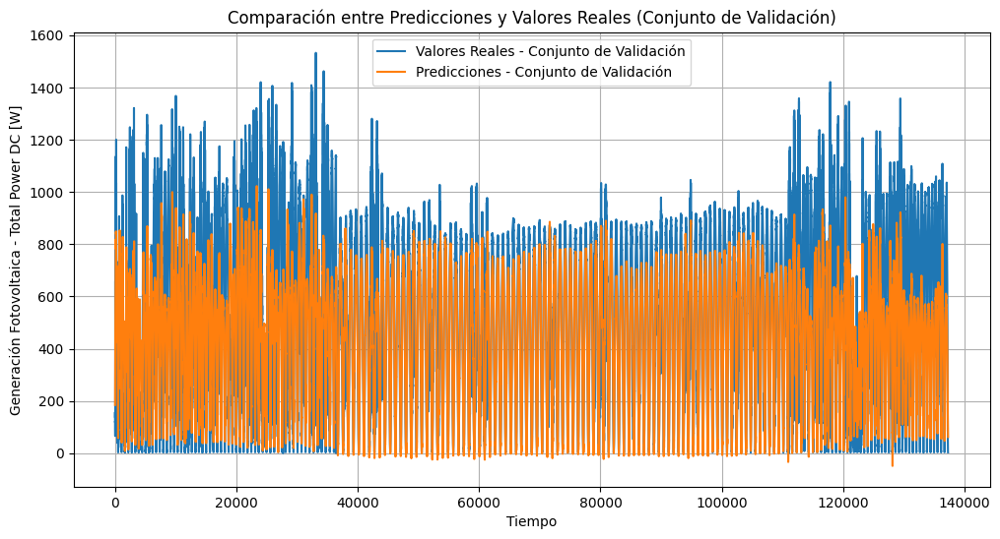

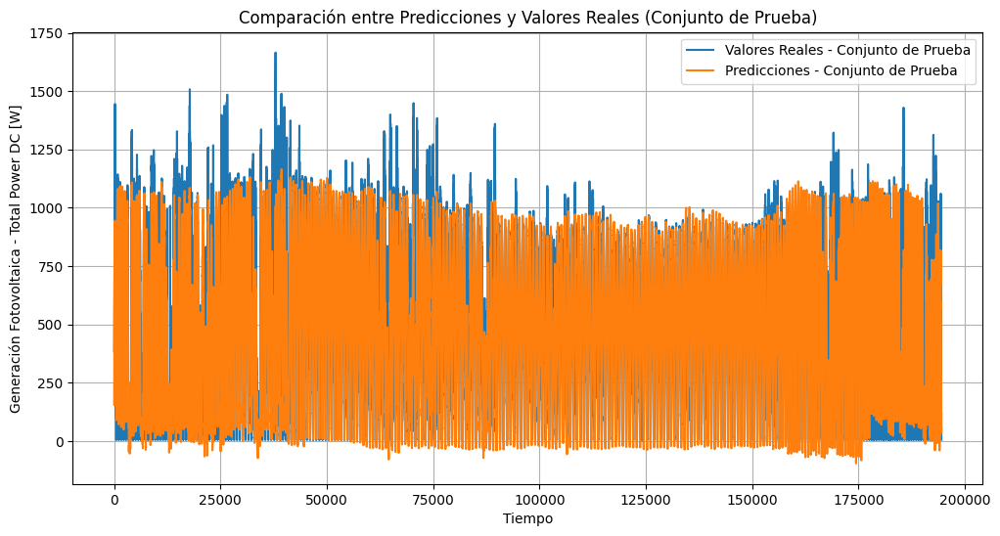

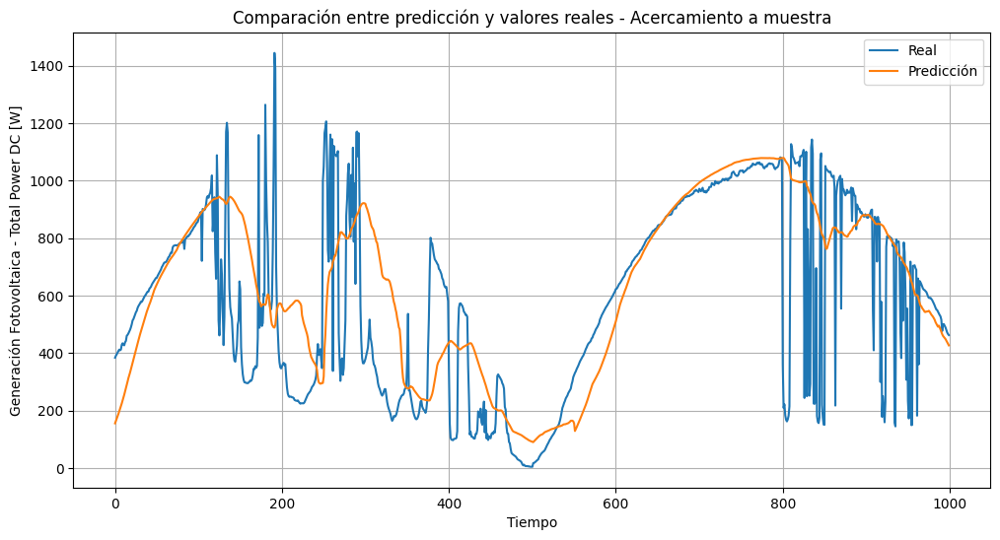

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train_su)
X_val_esc = std_X.transform(X_val_su)
X_test2017_esc = std_X.transform(X_test2017_su)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
outputs = Dense(1)(x)
Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

Prediccion con la primera semana del 2017

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 16)         │          2,160 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 800)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         51,264 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dense[0][0]            │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 53,489 (208.94 KB)

 Trainable params: 53,489 (208.94 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 30s 3ms/step - loss: 0.1324 - val_loss: 0.1228
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 34s 3ms/step - loss: 0.0640 - val_loss: 0.1003
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - loss: 0.0531 - val_loss: 0.1013
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 38s 3ms/step - loss: 0.0495 - val_loss: 0.0978
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 43s 3ms/step - loss: 0.0478 - val_loss: 0.0965
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0468 - val_loss: 0.0949
Epoch 7/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - loss: 0.0462 - val_loss: 0.0986
Epoch 8/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - loss: 0.0456 - val_loss: 0.1024
Epoch 9/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 40s 3ms/step - loss: 0.0451 - val_loss: 0.1025
Epoch 10/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 43s 3ms/step - loss: 0.0446 - val_loss: 0.1006
Epoch 11/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 38s 3ms/step - loss: 0.0440 - val_loss: 0.0996
Epoch 12

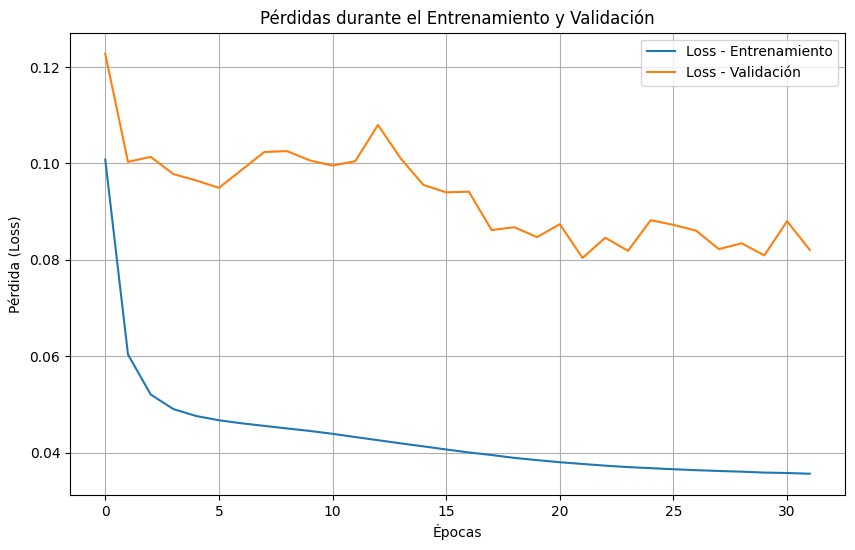

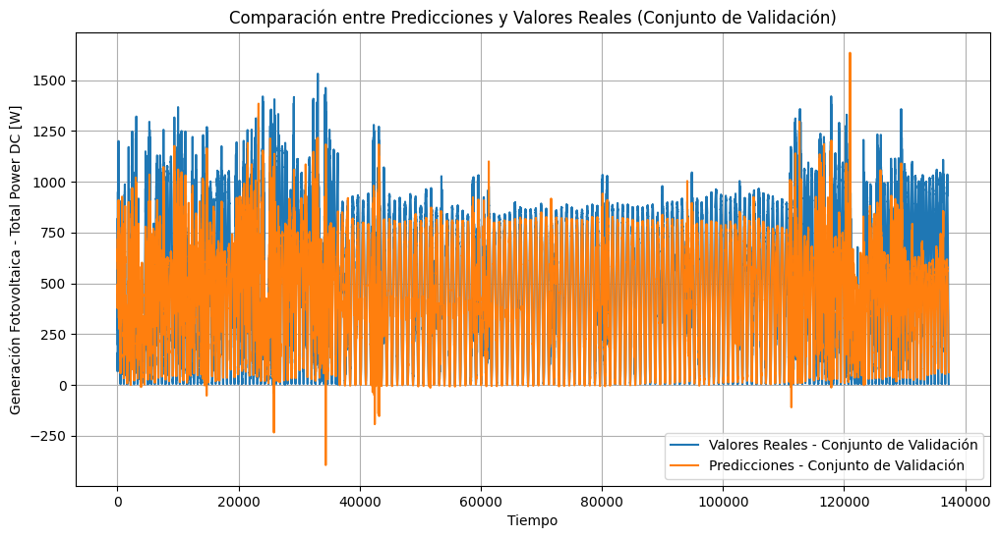

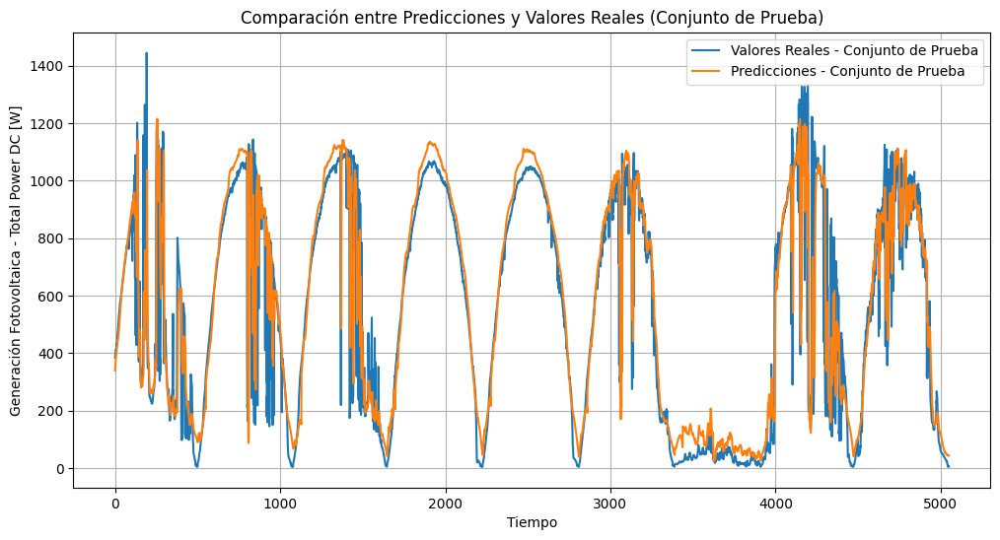

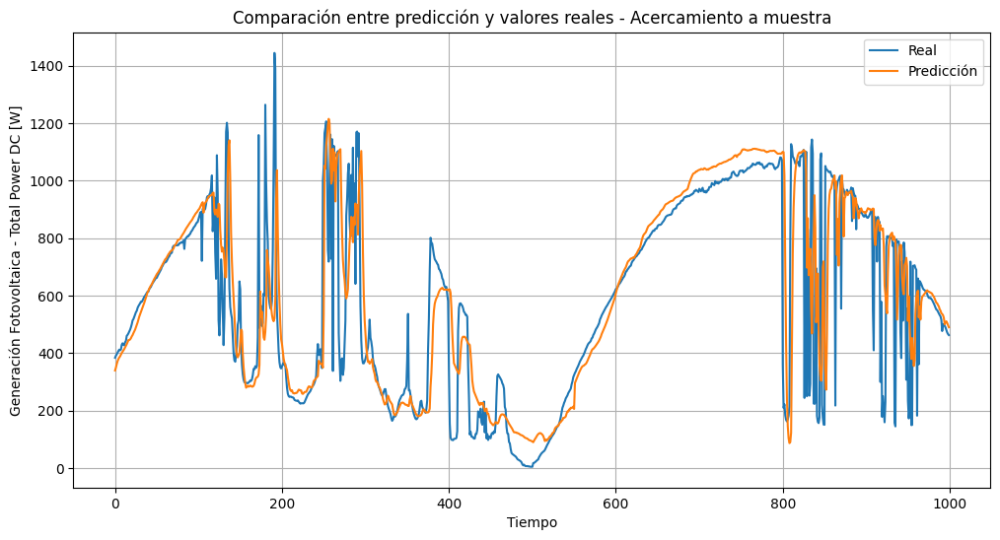

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt
import random

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017_s1)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017_s1.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
outputs = Dense(1)(x)
Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.8.5. Transformer - Modelo 5**

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 50, 16)         │          2,160 │ input_layer[0][0],     │
│ (MultiHeadAttention)      │                        │                │ input_layer[0][0],     │
│                           │                        │                │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 800)            │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 128)            │        102,528 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 128)            │              0 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 64)             │          8,256 │ dropout_1[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_2 (Dropout)       │ (None, 64)             │              0 │ dense_1[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_2 (Dense)           │ (None, 1)              │             65 │ dropout_2[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 113,009 (441.44 KB)

 Trainable params: 113,009 (441.44 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 33s 4ms/step - loss: 0.2487 - val_loss: 0.1098
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 25s 3ms/step - loss: 0.0753 - val_loss: 0.1169
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step - loss: 0.0683 - val_loss: 0.1150
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 3ms/step - loss: 0.0672 - val_loss: 0.1256
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step - loss: 0.0665 - val_loss: 0.1240
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 42s 4ms/step - loss: 0.0661 - val_loss: 0.1202
4291/4291 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step
6079/6079 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step
MAE VALIDACION LSTM: 154.82137553546377
R2 VALIDACION LSTM: 0.6479836075861465
MAE TEST LSTM: 99.7530721095693
R2 TEST LSTM: 0.8428855542109313


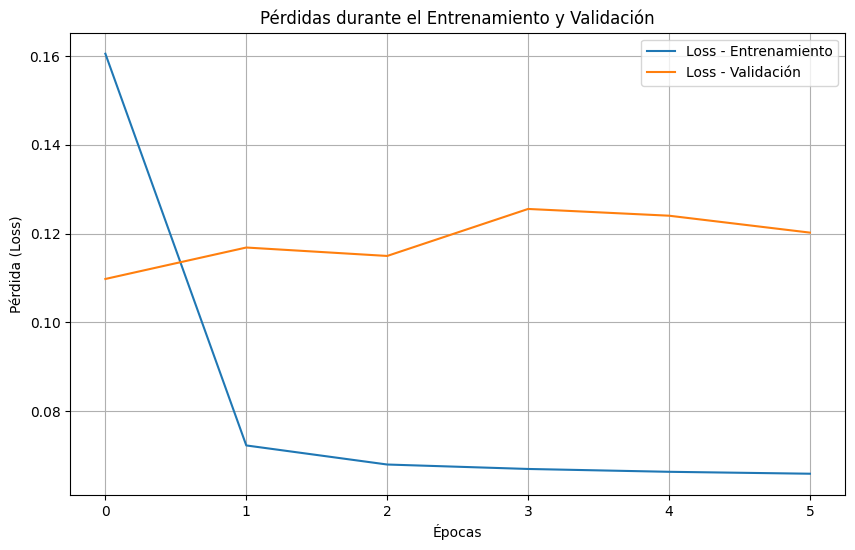

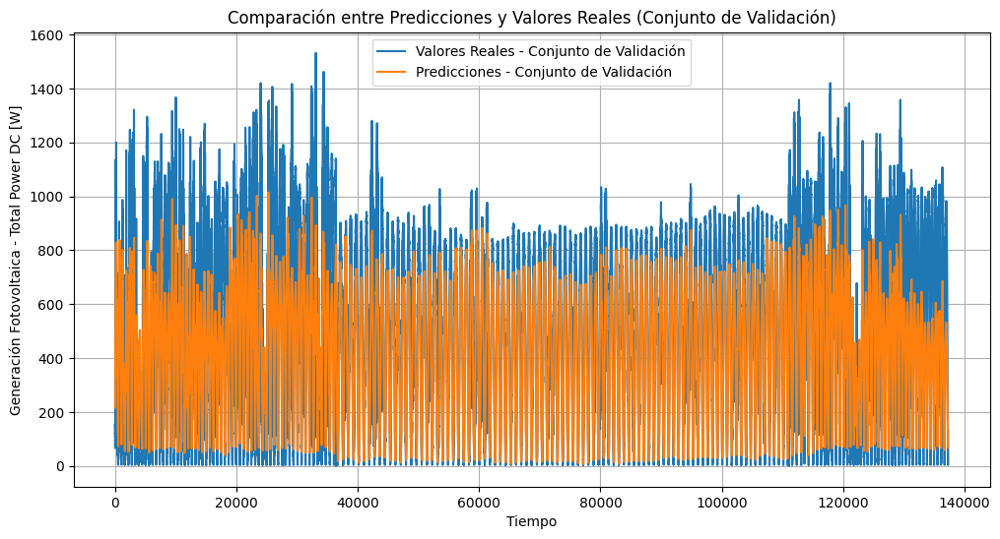

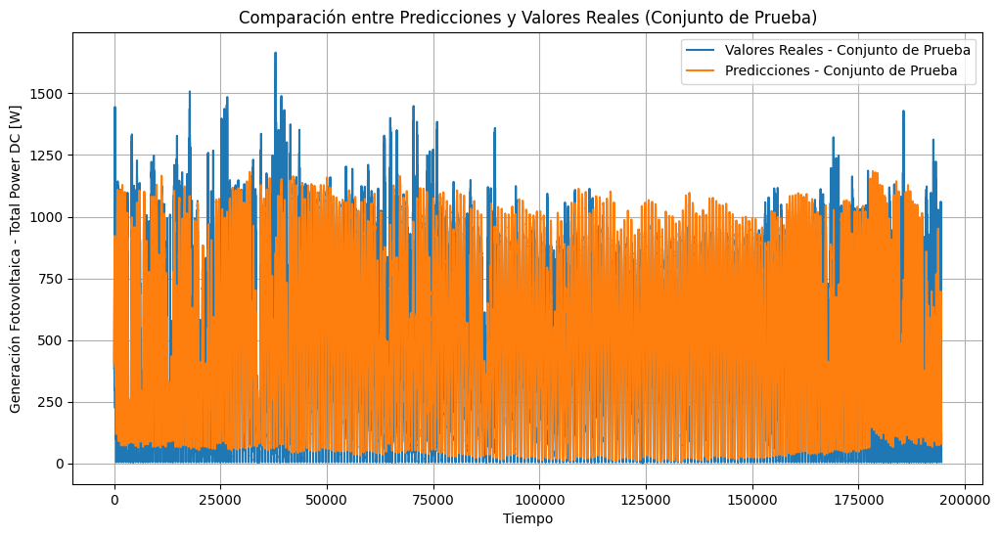

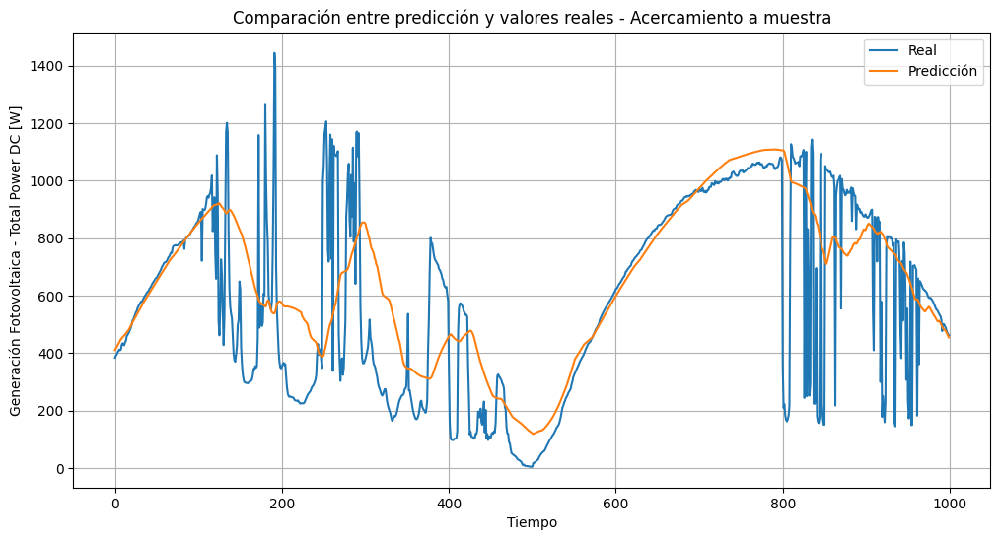

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
import matplotlib.pyplot as plt

tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))

# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(inputs, inputs, inputs)
x = Flatten()(attention_output)
x = Dense(128, activation='relu', kernel_regularizer=l2(0.001))(x)
x = Dropout(0.4)(x)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
x = Dropout(0.4)(x)
outputs = Dense(1)(x)

Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER: {mae_val}')
print(f'R2 VALIDACION TRANSFORMER: {r2_val}')
print(f'MAE TEST TRANSFORMER: {mae_test}')
print(f'R2 TEST TRANSFORMER: {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()

**4.9. Red Híbrido (Transformer + CNN) - Modelo 2**

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 50, 16)         │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d (Conv1D)           │ (None, 48, 64)         │          3,136 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling1d             │ (None, 24, 64)         │              0 │ conv1d[0][0]           │
│ (MaxPooling1D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 24, 64)         │          8,352 │ max_pooling1d[0][0],   │
│ (MultiHeadAttention)      │                        │                │ max_pooling1d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 1536)           │              0 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │         98,368 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │             65 │ dense[0][0]            │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 109,921 (429.38 KB)

 Trainable params: 109,921 (429.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 29s 3ms/step - loss: 0.1070 - val_loss: 0.1127
Epoch 2/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - loss: 0.0492 - val_loss: 0.1122
Epoch 3/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 39s 3ms/step - loss: 0.0454 - val_loss: 0.1125
Epoch 4/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0427 - val_loss: 0.1132
Epoch 5/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 24s 3ms/step - loss: 0.0409 - val_loss: 0.1084
Epoch 6/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 23s 3ms/step - loss: 0.0386 - val_loss: 0.1229
Epoch 7/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 43s 3ms/step - loss: 0.0371 - val_loss: 0.1138
Epoch 8/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - loss: 0.0358 - val_loss: 0.1039
Epoch 9/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 38s 3ms/step - loss: 0.0349 - val_loss: 0.1165
Epoch 10/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 26s 3ms/step - loss: 0.0343 - val_loss: 0.1022
Epoch 11/100
7570/7570 ━━━━━━━━━━━━━━━━━━━━ 41s 3ms/step - loss: 0.0335 - val_loss: 0.1079
Epoch 12

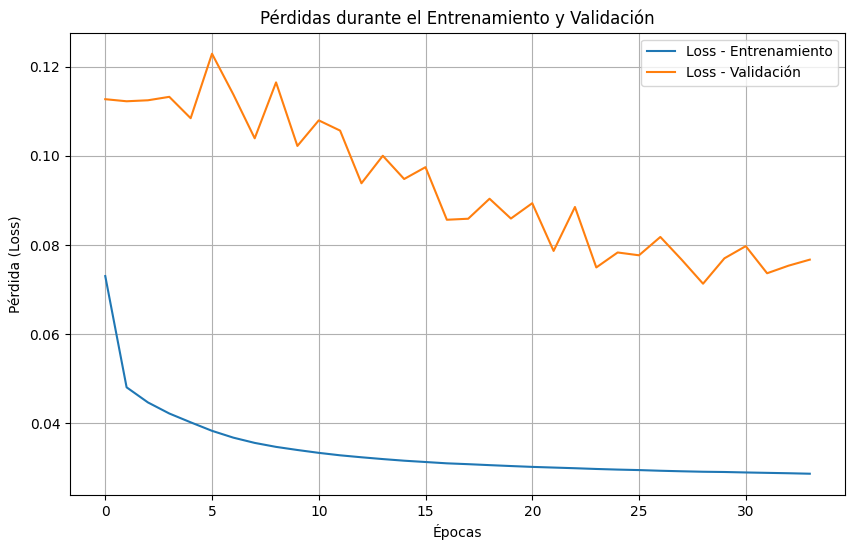

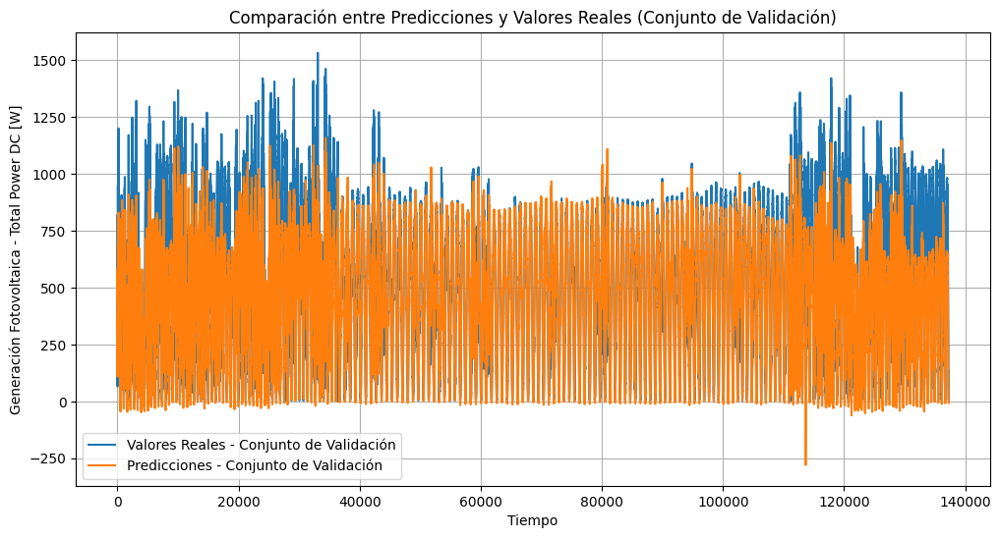

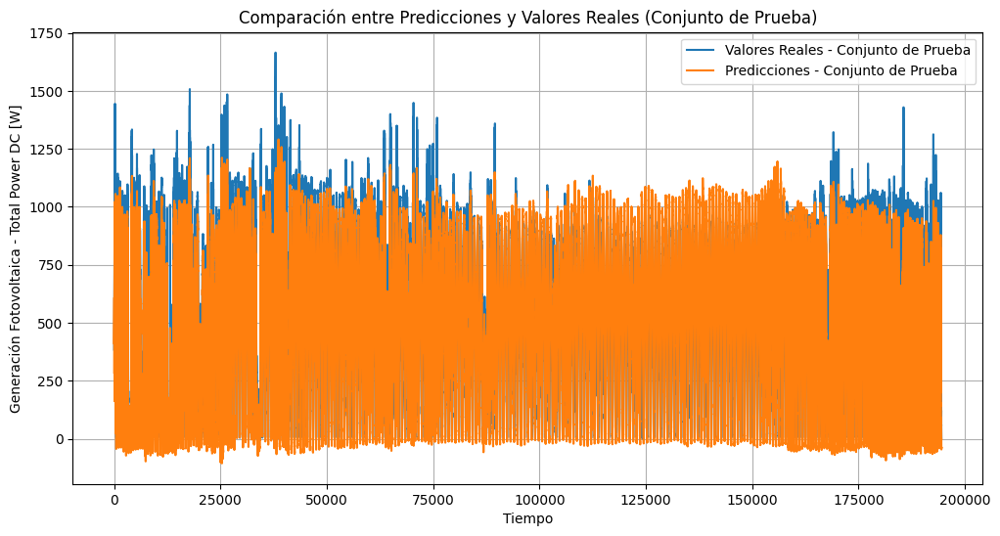

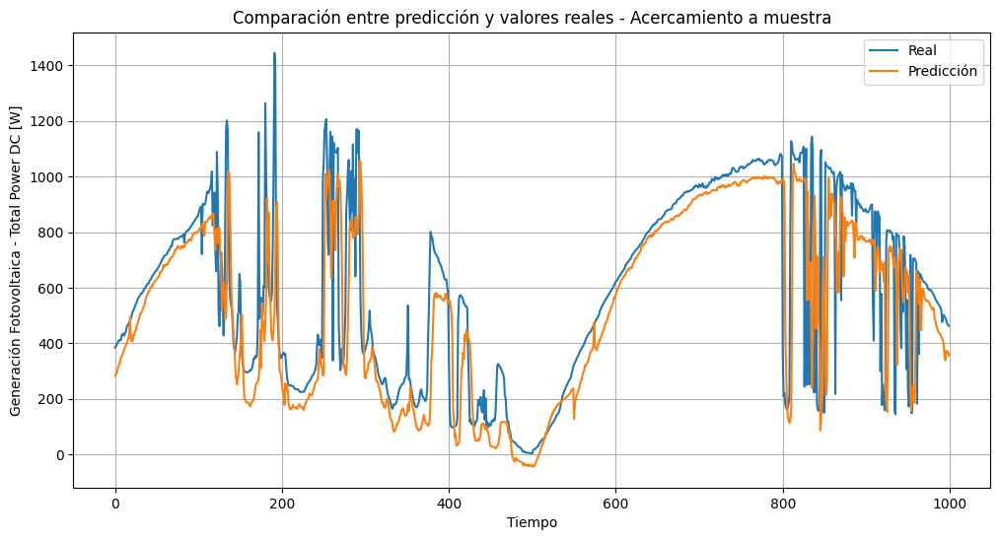

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import Conv1D, MaxPooling1D
import matplotlib.pyplot as plt


tf.keras.backend.clear_session()

# Se fija la semilla aleatoria

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

# Normalización de las variables de los conjuntos de entrenamiento, validación y prueba

std_X=MinMaxScaler(feature_range=(0, 1))
std_y=MinMaxScaler(feature_range=(0, 1))

X_train_esc = std_X.fit_transform(X_train)
X_val_esc = std_X.transform(X_val)
X_test2017_esc = std_X.transform(X_test2017)
y_train_esc = std_y.fit_transform(y_train.values.reshape(-1, 1))
y_test2017_esc = std_y.transform(y_test2017.values.reshape(-1, 1))
y_val_esc = std_y.transform(y_val.values.reshape(-1, 1))


# Convertir los datos a la forma requerida por LSTM [samples, timesteps, features]

def create_sequences(X, y, time_steps=50):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 50
X_train_seq, y_train_seq = create_sequences(X_train_esc, y_train_esc, time_steps)
X_val_seq, y_val_seq = create_sequences(X_val_esc, y_val_esc, time_steps)
X_test_seq, y_test_seq = create_sequences(X_test2017_esc, y_test2017_esc, time_steps)

# Crear arquitectura del modelo CNN + TRANSFORMER

inputs = Input(shape=(time_steps, X_train_seq.shape[2]))
x = Conv1D(filters=64, kernel_size=3, activation='relu')(inputs)
x = MaxPooling1D(pool_size=2)(x)
attention_output = MultiHeadAttention(num_heads=8, key_dim=4)(x, x)
x = Flatten()(attention_output)
x = Dense(64, activation='relu', kernel_regularizer=l2(0.001))(x)
outputs = Dense(1)(x)

Transformer_model = Model(inputs=inputs, outputs=outputs)

optimizer = Adam(learning_rate=0.0001)
Transformer_model.compile(optimizer=optimizer, loss='mean_absolute_error')

# Resumen del modelo

Transformer_model.summary()

# Entrenar el modelo

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_transformer = Transformer_model.fit (X_train_seq, y_train_seq, epochs=100, batch_size=64, validation_data=(X_val_seq, y_val_seq), callbacks=[early_stopping], verbose=1)

# Predicciones de generación eléctrica fotovoltaica para los conjuntos de validación y prueba

y_pred_val = Transformer_model.predict(X_val_seq)
y_pred_test = Transformer_model.predict(X_test_seq)

# Reversión de la normalización en las predicciones

y_pred_val_inv = std_y.inverse_transform(y_pred_val)
y_pred_test_inv = std_y.inverse_transform(y_pred_test)
y_val_seq_inv = std_y.inverse_transform(y_val_seq)
y_test_seq_inv = std_y.inverse_transform(y_test_seq)

# Evaluación del modelo en el conjunto de entrenamiento y validación

mae_val = mean_absolute_error(y_val_seq_inv, y_pred_val_inv)
mae_test = mean_absolute_error(y_test_seq_inv, y_pred_test_inv)
r2_val = r2_score(y_val_seq_inv, y_pred_val_inv)
r2_test = r2_score(y_test_seq_inv, y_pred_test_inv)

print(f'MAE VALIDACION TRANSFORMER MIX(CNN + TRANSFORMER): {mae_val}')
print(f'R2 VALIDACION TRANSFORMER MIX (CNN + TRANSFORMER): {r2_val}')
print(f'MAE TEST TRANSFORMER MIX (CNN + TRANSFORMER): {mae_test}')
print(f'R2 TEST TRANSFORMER MIX (CNN + TRANSFORMER): {r2_test}')

# Graficas de las perdidas en los conjuntos de entrenamiento y validación

plt.figure(figsize=(10, 6))
plt.plot(history_transformer.history['loss'], label='Loss - Entrenamiento')
plt.plot(history_transformer.history['val_loss'], label='Loss - Validación')
plt.title('Pérdidas durante el Entrenamiento y Validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (Loss)')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Validación

plt.figure(figsize=(12, 6))
plt.plot(y_val_seq_inv, label='Valores Reales - Conjunto de Validación')
plt.plot(y_pred_val_inv, label='Predicciones - Conjunto de Validación')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Validación)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv, label='Valores Reales - Conjunto de Prueba')
plt.plot(y_pred_test_inv, label='Predicciones - Conjunto de Prueba')
plt.title('Comparación entre Predicciones y Valores Reales (Conjunto de Prueba)')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.legend()
plt.grid(True)
plt.show()

# Grafica de las predicciones vs valores reales en las primeras 1000 predicciones del Conjunto de Prueba

plt.figure(figsize=(12, 6))
plt.plot(y_test_seq_inv[:1000], label='Real')
plt.plot(y_pred_test_inv[:1000], label='Predicción')
plt.xlabel('Tiempo')
plt.ylabel('Generación Fotovoltaica - Total Power DC [W]')
plt.title('Comparación entre predicción y valores reales - Acercamiento a muestra')
plt.legend()
plt.grid(True)
plt.show()